In [27]:
import os
import sys
import numpy as np
import matplotlib.pyplot as plt

# Add the directory where dynamics.py and utils.py are located to sys.path
module_path = os.path.abspath(os.path.join('../src'))
if module_path not in sys.path:
    sys.path.append(module_path)

from tqdm import tqdm

from scipy.optimize import fsolve
from scipy.stats import vonmises_fisher
from scipy.optimize import approx_fprime
from scipy.linalg import block_diag, solve

from dynamics import SatelliteDynamics
from utils import get_form_initial_conditions

In [28]:
# Simulation parameters
dt = 60.0  # Time step [s]
T = 395  # Duration [min]
T_RMSE = 300  # Index from which the RMSE is calculated
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6  # Number of states
n_p = 3  
n_y_1 = 3  # Number of measurements
n_y_2 = 3 + 3 * 3
n_y_3 = 3 + 3 * 3
n_y_4 = 3 + 3 * 3
K = T
W = 100 # Window size [min]

In [29]:
# Initial state vector and get the true state vectors (propagation) F
X_initial = get_form_initial_conditions(formation)
X_true = np.zeros((24, 1, T))
X_true[:, :, 0] = X_initial
for t in range(T - 1):
    X_true[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_true[:, :, t])

# Observation noise
sigma_abs = 1e-1  # [m]
R_abs = np.diag(np.concatenate([sigma_abs * np.ones(3)])) ** 2
sigma_rel = 1e0  # [m]
R_rel = np.diag(np.concatenate([sigma_rel * np.ones(3)])) ** 2
sigma_ang = np.deg2rad(0.5)
def equation(k_ang, sigma_ang):
    # return 1 - 1 / (2 * k_ang) - 1 / (8 * k_ang ** 2) - 1 / (8 * k_ang ** 3) - np.exp(-sigma_ang ** 2 / 2)
    def stable_coth(x):
        if x > 700:  # Prevent overflow
            return 1 + 2 / (np.exp(2 * x) - 1)
        else:
            return np.cosh(x) / np.sinh(x)
    return stable_coth(k_ang) - 1 / k_ang - np.exp(-sigma_ang ** 2 / 2)
k_ang = fsolve(equation, x0=1.0, args=(sigma_ang))[0]

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P = np.array([[1, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0]])

/tmp/ipykernel_12427/4007323918.py:18: RuntimeWarning: overflow encountered in exp
  return 1 + 2 / (np.exp(2 * x) - 1)


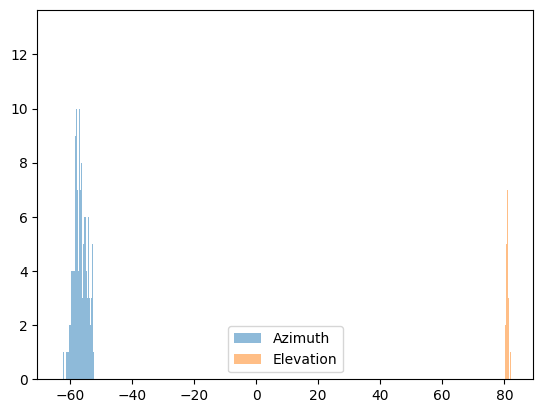

Azimuth std: 2.2176652599548454 degrees
Elevation std: 0.3481604161937345 degrees
Kappa = 1 / min(var(az), var(el)) = 27082.358276396226, kappa should be = 26262.950803314492


In [30]:
def dxdydz2azi_ele(dx, dy, dz):
    azi = np.arctan2(dy, dx)
    ele = np.arctan2(dz, np.sqrt(dx**2 + dy**2))
    return np.rad2deg(azi), np.rad2deg(ele)

def azi_ele2dxdydz(azi, ele):
    azi = np.deg2rad(azi)
    ele = np.deg2rad(ele)
    dx = np.cos(ele) * np.cos(azi)
    dy = np.cos(ele) * np.sin(azi)
    dz = np.sin(ele)
    return dx, dy, dz

a = P @ X_true[:6, :, 0]
b = P @ X_true[6:12, :, 0]
c = a - b
normalized_c = c / np.linalg.norm(c)

set_c_with_noise = vonmises_fisher(normalized_c.reshape(-1), k_ang).rvs(1000)
az = []
el = []
for c_with_noise in set_c_with_noise:
    az_i, el_i = dxdydz2azi_ele(c_with_noise[0], c_with_noise[1], c_with_noise[2])
    az.append(az_i)
    el.append(el_i)
plt.hist(az, bins=360, alpha=0.5, label='Azimuth')
plt.hist(el, bins=360, alpha=0.5, label='Elevation')
plt.legend()
plt.show()

print(f"Azimuth std: {np.std(az)} degrees")
print(f"Elevation std: {np.std(el)} degrees")
print(f"Kappa = 1 / min(var(az), var(el)) = {1 / min(np.deg2rad(np.std(az))**2, np.deg2rad(np.std(el))**2)}, kappa should be = {k_ang}")

In [31]:
# In case kappa needs to be estimated
gamma = np.mean(set_c_with_noise, axis=0)
gamma_norm = np.linalg.norm(gamma)
gamma_norm * (3 - gamma_norm**2) / (1 - gamma_norm**2), (gamma_norm * 3 - gamma_norm) / (1 - gamma_norm**2) # Wiki, Filipa's thesis

(27285.47955956738, 27284.479596217578)

In [32]:
azi, ele = dxdydz2azi_ele(normalized_c[0], normalized_c[1], normalized_c[2])
dx, dy, dz = azi_ele2dxdydz(azi, ele)
normalized_c, azi, ele, np.array([dx, dy, dz])

(array([[ 0.08591572],
        [-0.12987116],
        [ 0.98780158]]),
 array([-56.51353727]),
 array([81.0415721]),
 array([[ 0.08591572],
        [-0.12987116],
        [ 0.98780158]]))

In [33]:
def h(x_vec):
    x_1_k = x_vec[:n_x]
    x_2_k = x_vec[n_x:2*n_x]
    x_3_k = x_vec[2*n_x:3*n_x]
    x_4_k = x_vec[3*n_x:]
    
    # Self measurements
    y_1_k = P @ x_1_k 
    
    # Relative range and bearing measurements
    d_21_k_vec = P @ x_2_k - P @ x_1_k
    d_23_k_vec = P @ x_2_k - P @ x_3_k
    d_24_k_vec = P @ x_2_k - P @ x_4_k
    d_31_k_vec = P @ x_3_k - P @ x_1_k
    d_32_k_vec = P @ x_3_k - P @ x_2_k
    d_34_k_vec = P @ x_3_k - P @ x_4_k
    d_41_k_vec = P @ x_4_k - P @ x_1_k
    d_42_k_vec = P @ x_4_k - P @ x_2_k
    d_43_k_vec = P @ x_4_k - P @ x_3_k
    
    d_21_k = np.linalg.norm(d_21_k_vec)
    d_23_k = np.linalg.norm(d_23_k_vec)
    d_24_k = np.linalg.norm(d_24_k_vec)
    d_31_k = np.linalg.norm(d_31_k_vec)
    d_32_k = np.linalg.norm(d_32_k_vec)
    d_34_k = np.linalg.norm(d_34_k_vec)
    d_41_k = np.linalg.norm(d_41_k_vec)
    d_42_k = np.linalg.norm(d_42_k_vec)
    d_43_k = np.linalg.norm(d_43_k_vec)
    
    y_2_k = np.vstack([d_21_k, d_23_k, d_24_k, d_21_k_vec / d_21_k, d_23_k_vec / d_23_k, d_24_k_vec / d_24_k])
    y_3_k = np.vstack([d_31_k, d_32_k, d_34_k, d_31_k_vec / d_31_k, d_32_k_vec / d_32_k, d_34_k_vec / d_34_k])
    y_4_k = np.vstack([d_41_k, d_42_k, d_43_k, d_41_k_vec / d_41_k, d_42_k_vec / d_42_k, d_43_k_vec / d_43_k])
    
    return y_1_k.reshape(-1), y_2_k.reshape(-1), y_3_k.reshape(-1), y_4_k.reshape(-1)

def h_with_noise(x_vec):
    y_1_k, y_2_k, y_3_k, y_4_k = h(x_vec)
    abs_noise = np.random.multivariate_normal(np.zeros(3), R_abs)
    y_1_k = y_1_k + abs_noise
    y_2_k_rel = y_2_k[:3]
    y_2_k_ang = y_2_k[3:]
    y_2_k = np.concatenate((
        y_2_k_rel + np.random.multivariate_normal(np.zeros(3), R_rel), 
        vonmises_fisher.rvs(y_2_k_ang[:3], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_2_k_ang[3:6], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_2_k_ang[6:], k_ang).reshape(-1),
    ))
    y_3_k_rel = y_3_k[:3]
    y_3_k_ang = y_3_k[3:]
    y_3_k = np.concatenate((    
        y_3_k_rel + np.random.multivariate_normal(np.zeros(3), R_rel), 
        vonmises_fisher.rvs(y_3_k_ang[:3], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_3_k_ang[3:6], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_3_k_ang[6:], k_ang).reshape(-1),
    ))
    y_4_k_rel = y_4_k[:3]
    y_4_k_ang = y_4_k[3:]
    y_4_k = np.concatenate((
        y_4_k_rel + np.random.multivariate_normal(np.zeros(3), R_rel), 
        vonmises_fisher.rvs(y_4_k_ang[:3], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_4_k_ang[3:6], k_ang).reshape(-1),
        vonmises_fisher.rvs(y_4_k_ang[6:], k_ang).reshape(-1),
    ))
    return np.vstack([y_1_k.reshape(-1, 1), y_2_k.reshape(-1, 1), y_3_k.reshape(-1, 1), y_4_k.reshape(-1, 1)])

In [34]:
# Simulation setup
np.random.seed(42)
X_est = np.zeros_like(X_true)
initial_dev = np.concatenate(
    (
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
    )
)
X_est[:, :, 0] = X_initial + initial_dev
for t in range(T - 1):
    X_est[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_est[:, :, t])

# Observations
Y = np.zeros((39, 1, T))
for t in range(T):
    Y[:, :, t] = h_with_noise(X_true[:, :, t])
    
dev_chief_initial = np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).reshape(-1, 1)
dev_deputy1_initial = np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).reshape(-1, 1)
dev_deputy2_initial = np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).reshape(-1, 1)
dev_deputy3_initial = np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).reshape(-1, 1)

In [35]:
def f(x_0, y):
    f_x_0 = 0

    # Extract x_1(0), x_2(0), x_3(0), x_4(0) from flattened state vector x_0
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    
    # Iterate over all sliding window time steps
    for k in range(W):    
        # Get the observed data for each agent
        y_1_k = y[:n_y_1, :, k]
        y_2_k = y[n_y_1:n_y_1 + n_y_2, :, k]
        y_3_k = y[n_y_1 + n_y_2:n_y_1 + n_y_2 + n_y_3, :, k]
        y_4_k = y[n_y_1 + n_y_2 + n_y_3:, :, k]

        # Update the cost function with the residuals for self-measurements
        residual = y_1_k - P @ x_1_k
        f_x_0 += 1 / 2 * residual.T @ np.linalg.inv(R_abs) @ residual
        
        # Pairwise relative measurements and bearings in y_2_k, y_3_k, and y_4_k
        # y_2_k contains y_21, y_23, y_24 and u_21, u_23, u_24
        y_21_k = y_2_k[0]
        y_23_k = y_2_k[1]
        y_24_k = y_2_k[2]
        u_21_k = y_2_k[3:6]
        u_23_k = y_2_k[6:9]
        u_24_k = y_2_k[9:]

        # y_3_k contains y_31, y_32, y_34 and u_31, u_32, u_34
        y_31_k = y_3_k[0]
        y_32_k = y_3_k[1]
        y_34_k = y_3_k[2]
        u_31_k = y_3_k[3:6]
        u_32_k = y_3_k[6:9]
        u_34_k = y_3_k[9:]

        # y_4_k contains y_41, y_42, y_43 and u_41, u_42, u_43
        y_41_k = y_4_k[0]
        y_42_k = y_4_k[1]
        y_43_k = y_4_k[2]
        u_41_k = y_4_k[3:6]
        u_42_k = y_4_k[6:9]
        u_43_k = y_4_k[9:]

        # Process each pairwise measurement
        pairs = [
            (x_2_k, x_1_k, y_21_k, u_21_k),  # (2, 1)
            (x_2_k, x_3_k, y_23_k, u_23_k),  # (2, 3)
            (x_2_k, x_4_k, y_24_k, u_24_k),  # (2, 4)
            (x_3_k, x_1_k, y_31_k, u_31_k),  # (3, 1)
            (x_3_k, x_2_k, y_32_k, u_32_k),  # (3, 2)
            (x_3_k, x_4_k, y_34_k, u_34_k),  # (3, 4)
            (x_4_k, x_1_k, y_41_k, u_41_k),  # (4, 1)
            (x_4_k, x_2_k, y_42_k, u_42_k),  # (4, 2)
            (x_4_k, x_3_k, y_43_k, u_43_k)   # (4, 3)
        ]

        # Iterate over each pair and update the cost function with the residuals for pairwise measurements
        for x_i_k, x_j_k, y_ij_k, u_ij_k in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)
            
            f_x_0 += (y_ij_k - d_ij_k) ** 2 / (2 * sigma_rel**2) # Range
            
            f_x_0 -= k_ang * u_ij_k.T @ d_ij_k_vec / d_ij_k # Bearing
        
        if k < W - 1:
            # Get x_1(k), x_2(k), x_3(k), x_4(k) from the state vector x_0
            x_1_k = SatelliteDynamics().x_new(dt, x_1_k)
            x_2_k = SatelliteDynamics().x_new(dt, x_2_k)
            x_3_k = SatelliteDynamics().x_new(dt, x_3_k)
            x_4_k = SatelliteDynamics().x_new(dt, x_4_k)

    return f_x_0

def grad_f(x_0, y):
    grad_f_x_0 = np.zeros_like(x_0)

    # Extract x_1(0), x_2(0), x_3(0), x_4(0) from flattened state vector x_0
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    STM_t0_1 = np.eye(n_x)
    STM_t0_2 = np.eye(n_x)
    STM_t0_3 = np.eye(n_x)
    STM_t0_4 = np.eye(n_x)
    
    # Iterate over all sliding window time steps
    for k in range(W):
        # Get the observed data for each agent
        y_1_k = y[:n_y_1, :, k]
        y_2_k = y[n_y_1:n_y_1 + n_y_2, :, k]
        y_3_k = y[n_y_1 + n_y_2:n_y_1 + n_y_2 + n_y_3, :, k]
        y_4_k = y[n_y_1 + n_y_2 + n_y_3:, :, k]

        # Compute gradients for the absolute residual terms
        grad_f_x_0[:n_x, :] -= STM_t0_1.T @ P.T @ np.linalg.inv(R_abs) @ (y_1_k - P @ x_1_k)

        # Pairwise relative measurements and bearings in y_2_k, y_3_k, and y_4_k
        # y_2_k contains y_21, y_23, y_24 and u_21, u_23, u_24
        y_21_k = y_2_k[0]
        y_23_k = y_2_k[1]
        y_24_k = y_2_k[2]
        u_21_k = y_2_k[3:6]
        u_23_k = y_2_k[6:9]
        u_24_k = y_2_k[9:]

        # y_3_k contains y_31, y_32, y_34 and u_31, u_32, u_34
        y_31_k = y_3_k[0]
        y_32_k = y_3_k[1]
        y_34_k = y_3_k[2]
        u_31_k = y_3_k[3:6]
        u_32_k = y_3_k[6:9]
        u_34_k = y_3_k[9:]

        # y_4_k contains y_41, y_42, y_43 and u_41, u_42, u_43
        y_41_k = y_4_k[0]
        y_42_k = y_4_k[1]
        y_43_k = y_4_k[2]
        u_41_k = y_4_k[3:6]
        u_42_k = y_4_k[6:9]
        u_43_k = y_4_k[9:]

        # Process each pairwise measurement
        pairs = [
            (2, 1, x_2_k, x_1_k, y_21_k, u_21_k, STM_t0_2, STM_t0_1),  # (2, 1)
            (2, 3, x_2_k, x_3_k, y_23_k, u_23_k, STM_t0_2, STM_t0_3),  # (2, 3)
            (2, 4, x_2_k, x_4_k, y_24_k, u_24_k, STM_t0_2, STM_t0_4),  # (2, 4)
            (3, 1, x_3_k, x_1_k, y_31_k, u_31_k, STM_t0_3, STM_t0_1),  # (3, 1)
            (3, 2, x_3_k, x_2_k, y_32_k, u_32_k, STM_t0_3, STM_t0_2),  # (3, 2)
            (3, 4, x_3_k, x_4_k, y_34_k, u_34_k, STM_t0_3, STM_t0_4),  # (3, 4)
            (4, 1, x_4_k, x_1_k, y_41_k, u_41_k, STM_t0_4, STM_t0_1),  # (4, 1)
            (4, 2, x_4_k, x_2_k, y_42_k, u_42_k, STM_t0_4, STM_t0_2),  # (4, 2)
            (4, 3, x_4_k, x_3_k, y_43_k, u_43_k, STM_t0_4, STM_t0_3)   # (4, 3)
        ]
        
        # Iterate over each pair and compute gradients
        for i, j, x_i_k, x_j_k, y_ij_k, u_ij_k, STM_t0_i, STM_t0_j in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)

            # Range
            grad_f_x_0[(i - 1) * n_x:i * n_x, :] -= (y_ij_k - d_ij_k) / sigma_rel**2 * (STM_t0_i.T @ P.T @ d_ij_k_vec) / d_ij_k
            grad_f_x_0[(j - 1) * n_x:j * n_x, :] += (y_ij_k - d_ij_k) / sigma_rel**2 * (STM_t0_j.T @ P.T @ d_ij_k_vec) / d_ij_k
            
            # Bearing
            grad_f_x_0[(i - 1) * n_x:i * n_x, :] -= k_ang * STM_t0_i.T @ (P.T / d_ij_k - P.T @ d_ij_k_vec @ d_ij_k_vec.T / d_ij_k**3) @ u_ij_k
            grad_f_x_0[(j - 1) * n_x:j * n_x, :] += k_ang * STM_t0_j.T @ (P.T / d_ij_k - P.T @ d_ij_k_vec @ d_ij_k_vec.T / d_ij_k**3) @ u_ij_k
        
        if k < W - 1:
            # Get x_1(k), x_2(k), x_3(k), x_4(k) from the state vector x_0
            STM_t0_1_old = STM_t0_1
            STM_t0_2_old = STM_t0_2
            STM_t0_3_old = STM_t0_3
            STM_t0_4_old = STM_t0_4
            x_1_k, STM_t0_1 = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, STM_t0_2 = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, STM_t0_3 = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, STM_t0_4 = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            STM_t0_1 = STM_t0_1 @ STM_t0_1_old
            STM_t0_2 = STM_t0_2 @ STM_t0_2_old
            STM_t0_3 = STM_t0_3 @ STM_t0_3_old
            STM_t0_4 = STM_t0_4 @ STM_t0_4_old

    return grad_f_x_0

def hessian_f(x_0, y):
    hessian_f_x_0 = np.zeros((x_0.shape[0], x_0.shape[0]))  # Initialize Hessian matrix
    
    # Extract x_1(0), x_2(0), x_3(0), x_4(0) from flattened state vector x_0
    x_1_k = x_0[:n_x, :]
    x_2_k = x_0[n_x:2*n_x, :]
    x_3_k = x_0[2*n_x:3*n_x, :]
    x_4_k = x_0[3*n_x:4*n_x, :]
    STM_t0_1 = np.eye(n_x)
    STM_t0_2 = np.eye(n_x)
    STM_t0_3 = np.eye(n_x)
    STM_t0_4 = np.eye(n_x)

    # Iterate over all sliding window time steps
    for k in range(W):
        # Get the observed data for each agent
        y_1_k = y[:n_y_1, :, k]
        y_2_k = y[n_y_1:n_y_1 + n_y_2, :, k]
        y_3_k = y[n_y_1 + n_y_2:n_y_1 + n_y_2 + n_y_3, :, k]
        y_4_k = y[n_y_1 + n_y_2 + n_y_3:, :, k]

        # Absolute measurement residuals' Hessian
        hessian_f_x_0[:n_x, :n_x] += STM_t0_1.T @ P.T @ np.linalg.inv(R_abs) @ P @ STM_t0_1 

        # Pairwise relative measurements and bearings in y_2_k, y_3_k, and y_4_k
        # y_2_k contains y_21, y_23, y_24 and u_21, u_23, u_24
        y_21_k = y_2_k[0]
        y_23_k = y_2_k[1]
        y_24_k = y_2_k[2]
        u_21_k = y_2_k[3:6]
        u_23_k = y_2_k[6:9]
        u_24_k = y_2_k[9:]

        # y_3_k contains y_31, y_32, y_34 and u_31, u_32, u_34
        y_31_k = y_3_k[0]
        y_32_k = y_3_k[1]
        y_34_k = y_3_k[2]
        u_31_k = y_3_k[3:6]
        u_32_k = y_3_k[6:9]
        u_34_k = y_3_k[9:]

        # y_4_k contains y_41, y_42, y_43 and u_41, u_42, u_43
        y_41_k = y_4_k[0]
        y_42_k = y_4_k[1]
        y_43_k = y_4_k[2]
        u_41_k = y_4_k[3:6]
        u_42_k = y_4_k[6:9]
        u_43_k = y_4_k[9:]

        # Process each pairwise measurement
        pairs = [
            (2, 1, x_2_k, x_1_k, y_21_k, u_21_k, STM_t0_2, STM_t0_1),  # (2, 1)
            (2, 3, x_2_k, x_3_k, y_23_k, u_23_k, STM_t0_2, STM_t0_3),  # (2, 3)
            (2, 4, x_2_k, x_4_k, y_24_k, u_24_k, STM_t0_2, STM_t0_4),  # (2, 4)
            (3, 1, x_3_k, x_1_k, y_31_k, u_31_k, STM_t0_3, STM_t0_1),  # (3, 1)
            (3, 2, x_3_k, x_2_k, y_32_k, u_32_k, STM_t0_3, STM_t0_2),  # (3, 2)
            (3, 4, x_3_k, x_4_k, y_34_k, u_34_k, STM_t0_3, STM_t0_4),  # (3, 4)
            (4, 1, x_4_k, x_1_k, y_41_k, u_41_k, STM_t0_4, STM_t0_1),  # (4, 1)
            (4, 2, x_4_k, x_2_k, y_42_k, u_42_k, STM_t0_4, STM_t0_2),  # (4, 2)
            (4, 3, x_4_k, x_3_k, y_43_k, u_43_k, STM_t0_4, STM_t0_3)   # (4, 3)
        ]

        # Iterate over each pair and compute gradients
        for i, j, x_i_k, x_j_k, y_ij_k, u_ij_k, STM_t0_i, STM_t0_j in pairs:
            d_ij_k_vec = P @ x_i_k - P @ x_j_k
            d_ij_k = np.linalg.norm(d_ij_k_vec)

            # Update the Hessian for x_i(k) and x_j(k)
            idx_i = n_x * (i - 1)
            idx_j = n_x * (j - 1)
            
            # Range
            hessian_range_common = (y_ij_k - d_ij_k) / d_ij_k * P.T @ P - y_ij_k / d_ij_k**3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ P
            hessian_f_x_0[idx_i:idx_i + n_x, idx_i:idx_i + n_x] -= 1 / (sigma_rel ** 2) * (STM_t0_i.T @ hessian_range_common @ STM_t0_i)
            hessian_f_x_0[idx_i:idx_i + n_x, idx_j:idx_j + n_x] += 1 / (sigma_rel ** 2) * (STM_t0_i.T @ hessian_range_common @ STM_t0_j)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_i:idx_i + n_x] += 1 / (sigma_rel ** 2) * (STM_t0_j.T @ hessian_range_common @ STM_t0_i)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_j:idx_j + n_x] -= 1 / (sigma_rel ** 2) * (STM_t0_j.T @ hessian_range_common @ STM_t0_j)
            
            # Bearing
            hessian_ang_common = 3 * P.T @ d_ij_k_vec @ d_ij_k_vec.T @ u_ij_k @ d_ij_k_vec.T @ P / d_ij_k**5 - P.T @ (u_ij_k @ d_ij_k_vec.T + d_ij_k_vec.T @ u_ij_k * np.eye(3) + d_ij_k_vec @ u_ij_k.T) @ P / d_ij_k**3
            hessian_f_x_0[idx_i:idx_i + n_x, idx_i:idx_i + n_x] -= k_ang * (STM_t0_i.T @ hessian_ang_common @ STM_t0_i)
            hessian_f_x_0[idx_i:idx_i + n_x, idx_j:idx_j + n_x] += k_ang * (STM_t0_i.T @ hessian_ang_common @ STM_t0_j)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_i:idx_i + n_x] += k_ang * (STM_t0_j.T @ hessian_ang_common @ STM_t0_i)
            hessian_f_x_0[idx_j:idx_j + n_x, idx_j:idx_j + n_x] -= k_ang * (STM_t0_j.T @ hessian_ang_common @ STM_t0_j)

        if k < W - 1:
            # Get x_1(k), x_2(k), x_3(k), x_4(k) from the state vector x_0
            STM_t0_1_old = STM_t0_1
            STM_t0_2_old = STM_t0_2
            STM_t0_3_old = STM_t0_3
            STM_t0_4_old = STM_t0_4
            x_1_k, STM_t0_1 = SatelliteDynamics().x_new_and_F(dt, x_1_k)
            x_2_k, STM_t0_2 = SatelliteDynamics().x_new_and_F(dt, x_2_k)
            x_3_k, STM_t0_3 = SatelliteDynamics().x_new_and_F(dt, x_3_k)
            x_4_k, STM_t0_4 = SatelliteDynamics().x_new_and_F(dt, x_4_k)
            STM_t0_1 = STM_t0_1 @ STM_t0_1_old
            STM_t0_2 = STM_t0_2 @ STM_t0_2_old
            STM_t0_3 = STM_t0_3 @ STM_t0_3_old
            STM_t0_4 = STM_t0_4 @ STM_t0_4_old

    return hessian_f_x_0

In [36]:
def L(x_0, y):
    return f(x_0, y)
    
def grad_L(x_0, y):
    return grad_f(x_0, y)

def hessian_L(x_0, y):
    return hessian_f(x_0, y)

In [37]:
class approxH_Newton:
    def __init__(self, grad_tol=1e0, max_iter=20):
        self.grad_tol = grad_tol
        self.max_iter = max_iter
        
        # Storage for results
        self.cost_function_values = []
        self.grad_norm_values = []

    def solve(self, x_init, Y, X_true):
        x = x_init
            
        prev_cost_function_value = None
        prev_grad_norm_value = None
        prev_global_error = None
        
        for iteration in range(self.max_iter):
            # Compute the cost function, gradient and approximated Hessian
            L_x = L(x, Y)
            grad_L_x = grad_L(x, Y)
            hessian_L_x = hessian_L(x, Y)

            # Convergence tracking
            cost_function_value = L_x[0][0]
            grad_norm_value = np.linalg.norm(grad_L_x)

            # Store the norms
            self.cost_function_values.append(cost_function_value)
            self.grad_norm_values.append(grad_norm_value)
            
            if prev_cost_function_value is not None:
                cost_function_change = (cost_function_value - prev_cost_function_value) / abs(prev_cost_function_value) * 100
                grad_norm_change = (grad_norm_value - prev_grad_norm_value) / abs(prev_grad_norm_value) * 100
                global_error_change = (np.linalg.norm(x - X_true) - prev_global_error) / abs(prev_global_error) * 100
            prev_cost_function_value = cost_function_value
            prev_grad_norm_value = grad_norm_value
            prev_global_error = np.linalg.norm(x - X_true)

            # Check convergence and print metrics
            if grad_norm_value < self.grad_tol or iteration + 1 == self.max_iter:
                print(f"STOP on Iteration {iteration}\nCost function = {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm = {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error = {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                print(f"Final position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
                break
            else:
                if iteration == 0:
                    print(f"Before applying the algorithm\nCost function: {cost_function_value}\nGradient norm: {grad_norm_value}\nGlobal relative error: {np.linalg.norm(x - X_true)}")
                else:
                    print(f"Iteration {iteration}\nCost function: {cost_function_value} ({cost_function_change:.2f}%)\nGradient norm: {grad_norm_value} ({grad_norm_change:.2f}%)\nGlobal relative error: {np.linalg.norm(x - X_true)} ({global_error_change:.2f}%)")
                    
            # Print relative errors 
            print(f"Position relative errors: {np.linalg.norm(x[0:3, :] - X_true[0:3, :])} m, {np.linalg.norm(x[6:9, :] - X_true[6:9, :])} m, {np.linalg.norm(x[12:15, :] - X_true[12:15, :])} m, {np.linalg.norm(x[18:21, :] - X_true[18:21, :])} m\n")
            
            # Solve for the Newton step
            delta_x = solve(hessian_L_x, -grad_L_x)
            x += delta_x

        return x

In [38]:
def give_me_the_plots(cost_function_values, grad_norm_values):
    iterations = np.arange(0, len(cost_function_values))

    # Plot 1
    plt.semilogy(iterations, cost_function_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$L(x^{(m)})$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()
    
    # Plot 2
    plt.semilogy(iterations, grad_norm_values, '.-')
    plt.xlabel(r'$m$')
    plt.ylabel(r'$||\nabla L(x^{(m)})||_2$')
    plt.grid(True)
    plt.grid(True, which="minor", linestyle='--')
    plt.show()

Windows:   0%|          | 0/296 [00:00<?, ?it/s]

Before applying the algorithm
Cost function: 3123863036.4245157
Gradient norm: 76230430094.28401
Global relative error: 395.60563949432424
Position relative errors: 82.78540989608044 m, 181.7491507333766 m, 258.73787052498585 m, 222.8729633755392 m

Iteration 1
Cost function: 1152201470.5438623 (-63.12%)
Gradient norm: 2045132737.307242 (-97.32%)
Global relative error: 11954.682072893997 (2921.87%)
Position relative errors: 0.019259593270254362 m, 7652.267793515575 m, 6293.521192936684 m, 6689.45235642816 m

Iteration 2
Cost function: 51499135.59745613 (-95.53%)
Gradient norm: 756368572.8863803 (-63.02%)
Global relative error: 4903.087452817341 (-58.99%)
Position relative errors: 0.03146774999030099 m, 3094.911273070662 m, 2695.20549329163 m, 2682.8430721709665 m

Iteration 3
Cost function: -14388706.80822878 (-127.94%)
Gradient norm: 151609857.13589984 (-79.96%)
Global relative error: 2911.136552905632 (-40.63%)
Position relative errors: 0.019351448284153857 m, 1844.1486133733445 m, 1

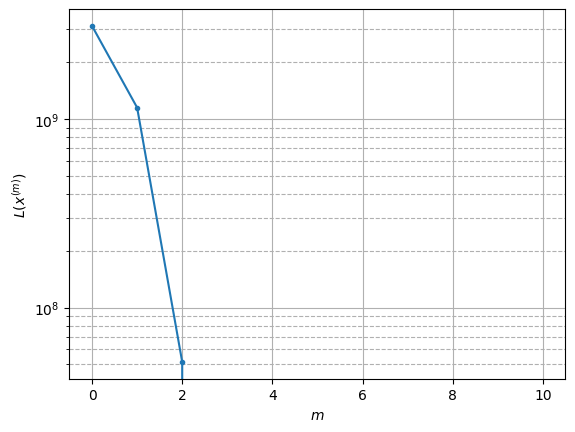

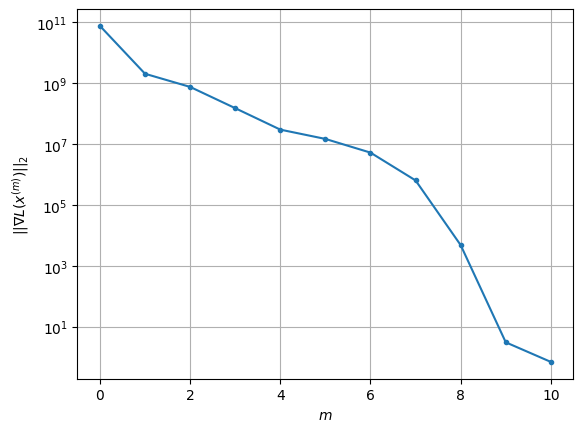

Windows:   0%|          | 1/296 [00:17<1:24:46, 17.24s/it]

Before applying the algorithm
Cost function: -23635137.81290778
Gradient norm: 96760.68325550102
Global relative error: 1.5808738989997992
Position relative errors: 0.018640875075695496 m, 0.7599170403134917 m, 1.0947015791829697 m, 0.8502757865716476 m

Iteration 1
Cost function: -23635138.930351764 (-0.00%)
Gradient norm: 3.1281279638802792 (-100.00%)
Global relative error: 1.2532663144845022 (-20.72%)
Position relative errors: 0.012680314433283801 m, 0.6566321427828177 m, 0.8849819136411695 m, 0.5967885959641241 m

STOP on Iteration 2
Cost function = -23635138.930351764 (0.00%)
Gradient norm = 0.35079245030430595 (-88.79%)
Global relative error = 1.2531698519851935 (-0.01%)
Final position relative errors: 0.01268030903912387 m, 0.656554807719884 m, 0.8849355564042491 m, 0.5967398555118263 m



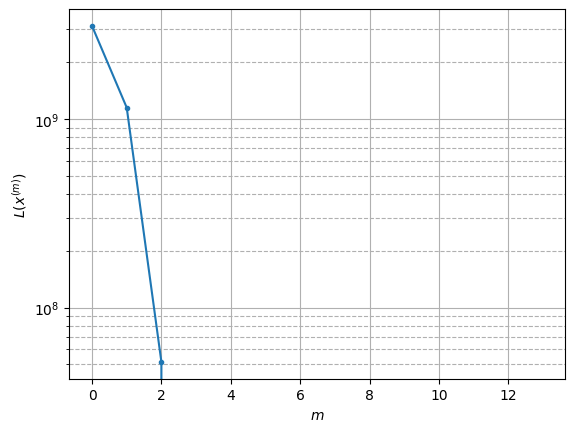

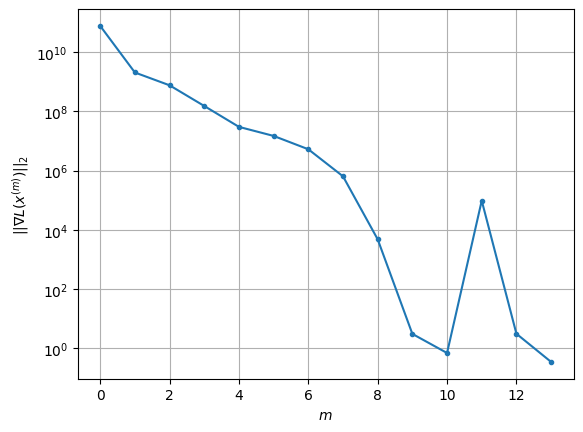

Windows:   1%|          | 2/296 [00:22<49:04, 10.02s/it]  

Before applying the algorithm
Cost function: -23635138.584513817
Gradient norm: 238828.66206474847
Global relative error: 1.2234166483764888
Position relative errors: 0.01289081131865849 m, 0.6395343399563606 m, 0.8710251454839142 m, 0.5734917544419159 m

Iteration 1
Cost function: -23635139.038592387 (-0.00%)
Gradient norm: 5.331531154902483 (-100.00%)
Global relative error: 1.2531183652203075 (2.43%)
Position relative errors: 0.01943012468236451 m, 0.8102361750548551 m, 0.8094728039619132 m, 0.508132648363277 m

Iteration 2
Cost function: -23635139.038592216 (0.00%)
Gradient norm: 1.7973526831540676 (-66.29%)
Global relative error: 1.2531447015491168 (0.00%)
Position relative errors: 0.019430132862572242 m, 0.8102386616532278 m, 0.8095001983670699 m, 0.5081499911903955 m

Iteration 3
Cost function: -23635139.03859278 (-0.00%)
Gradient norm: 2.8911583049265674 (60.86%)
Global relative error: 1.253144701187885 (-0.00%)
Position relative errors: 0.019430130808167134 m, 0.810238659836722

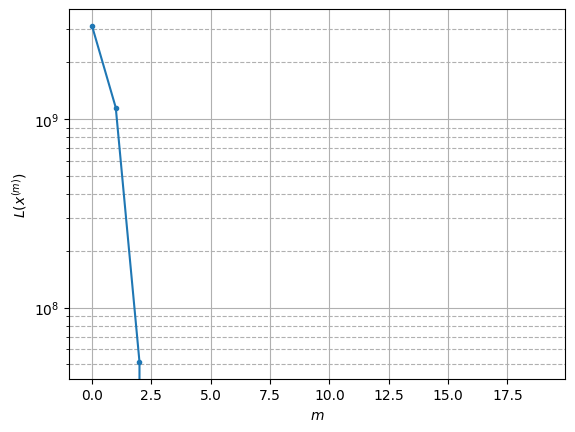

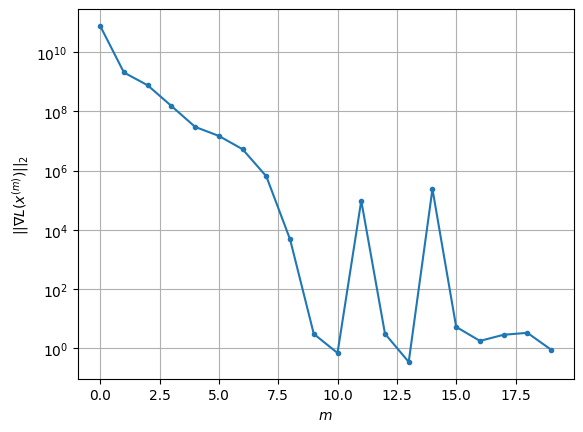

Windows:   1%|          | 3/296 [00:31<48:04,  9.84s/it]

Before applying the algorithm
Cost function: -23635140.093288645
Gradient norm: 162069.69326677895
Global relative error: 1.216419677378925
Position relative errors: 0.019555815701201372 m, 0.786026696163582 m, 0.7920986915419418 m, 0.4837722164430917 m

Iteration 1
Cost function: -23635140.652209096 (-0.00%)
Gradient norm: 9.167554497337642 (-99.99%)
Global relative error: 1.4655973720942743 (20.48%)
Position relative errors: 0.02263644167231662 m, 1.0855390834437828 m, 0.8182624764696945 m, 0.5472788574851523 m

STOP on Iteration 2
Cost function = -23635140.652209144 (-0.00%)
Gradient norm = 0.9666312930167263 (-89.46%)
Global relative error = 1.465510381679113 (-0.01%)
Final position relative errors: 0.02263644102783082 m, 1.0854664237359928 m, 0.8182300024491337 m, 0.547238574800252 m



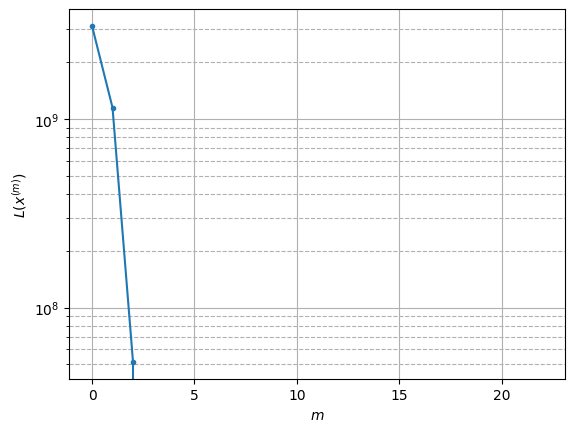

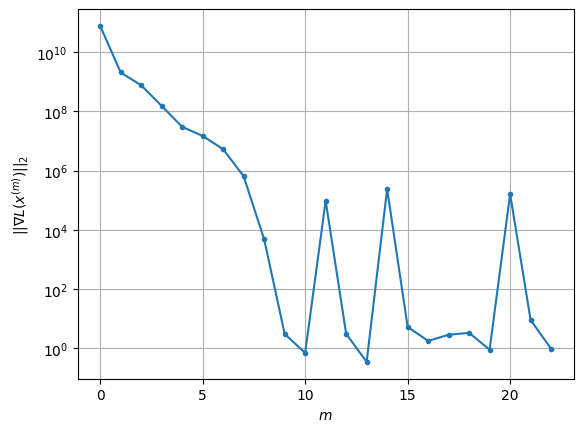

Windows:   1%|▏         | 4/296 [00:36<38:41,  7.95s/it]

Before applying the algorithm
Cost function: -23635132.21812898
Gradient norm: 98263.09179838373
Global relative error: 1.4248001840839561
Position relative errors: 0.022616918639083206 m, 1.047775030514216 m, 0.8049513697067707 m, 0.5326951927983152 m

Iteration 1
Cost function: -23635133.014666215 (-0.00%)
Gradient norm: 5.25249439728441 (-99.99%)
Global relative error: 1.1286765325678456 (-20.78%)
Position relative errors: 0.033344166741196 m, 0.8917041383776135 m, 0.6059533812270316 m, 0.33238910816642114 m

Iteration 2
Cost function: -23635133.01466659 (-0.00%)
Gradient norm: 3.7559258590494298 (-28.49%)
Global relative error: 1.1288014096059076 (0.01%)
Position relative errors: 0.033344162058096406 m, 0.8917794749497245 m, 0.6060338242988128 m, 0.33246438790346955 m

Iteration 3
Cost function: -23635133.01466625 (0.00%)
Gradient norm: 6.811770419297582 (81.36%)
Global relative error: 1.1288014242361446 (0.00%)
Position relative errors: 0.03334416892484118 m, 0.8917794867297946 m,

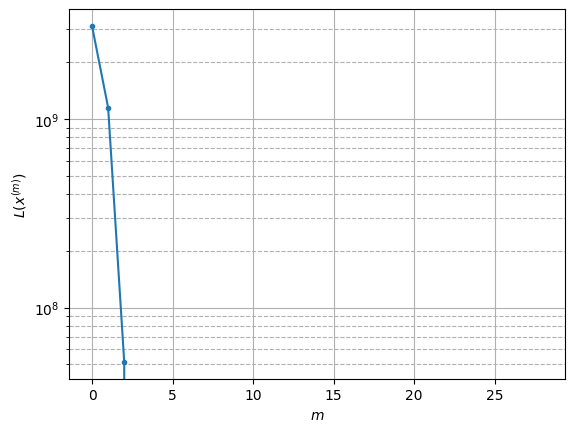

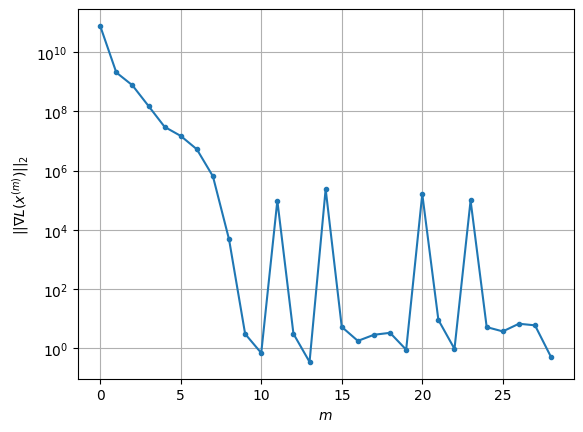

Windows:   2%|▏         | 5/296 [00:46<41:18,  8.52s/it]

Before applying the algorithm
Cost function: -23635136.409637943
Gradient norm: 255932.81080291356
Global relative error: 1.0881777765058798
Position relative errors: 0.0328073599346397 m, 0.8487649874252632 m, 0.597309270724683 m, 0.3253821310072342 m

Iteration 1
Cost function: -23635137.10935271 (-0.00%)
Gradient norm: 5.4477677595680225 (-100.00%)
Global relative error: 1.3000137600995811 (19.47%)
Position relative errors: 0.029520696800358102 m, 0.9816119809179742 m, 0.6436463737798525 m, 0.557960799352064 m

Iteration 2
Cost function: -23635137.109352916 (-0.00%)
Gradient norm: 1.267686744996786 (-76.73%)
Global relative error: 1.2999584094014014 (-0.00%)
Position relative errors: 0.029520687165085862 m, 0.9815887853712078 m, 0.6436187320347982 m, 0.5579045292989764 m

Iteration 3
Cost function: -23635137.10935298 (-0.00%)
Gradient norm: 2.15405929696891 (69.92%)
Global relative error: 1.2999584088800256 (-0.00%)
Position relative errors: 0.029520690115874746 m, 0.981588789648705

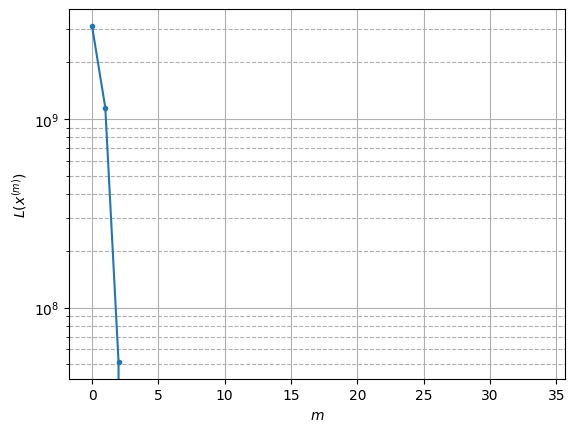

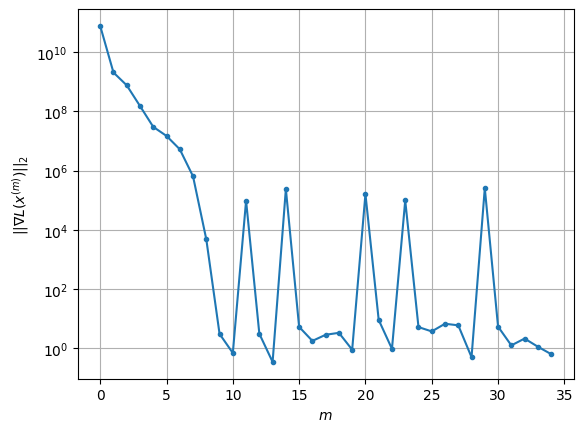

Windows:   2%|▏         | 6/296 [00:56<43:08,  8.93s/it]

Before applying the algorithm
Cost function: -23635127.796950527
Gradient norm: 98449.03389663069
Global relative error: 1.236646676555435
Position relative errors: 0.029135517808018596 m, 0.9325897459053526 m, 0.619563874093177 m, 0.524272554524865 m

Iteration 1
Cost function: -23635128.334850904 (-0.00%)
Gradient norm: 1.2067445834307202 (-100.00%)
Global relative error: 1.2087264274615896 (-2.26%)
Position relative errors: 0.022989302571162523 m, 0.8576587044739098 m, 0.7291914236653654 m, 0.4395353607895476 m

Iteration 2
Cost function: -23635128.334850952 (-0.00%)
Gradient norm: 1.4666636067537189 (21.54%)
Global relative error: 1.2086908190418286 (-0.00%)
Position relative errors: 0.022989301413998953 m, 0.8576460843243682 m, 0.7291535350222366 m, 0.4395249198288124 m

STOP on Iteration 3
Cost function = -23635128.3348511 (-0.00%)
Gradient norm = 0.258175380415714 (-82.40%)
Global relative error = 1.2086908182072884 (-0.00%)
Final position relative errors: 0.02298930471643177 m,

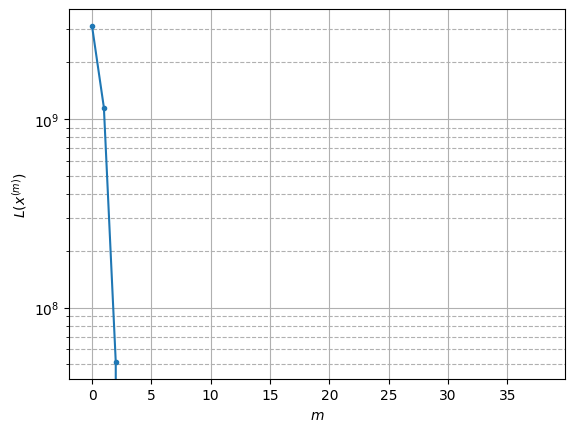

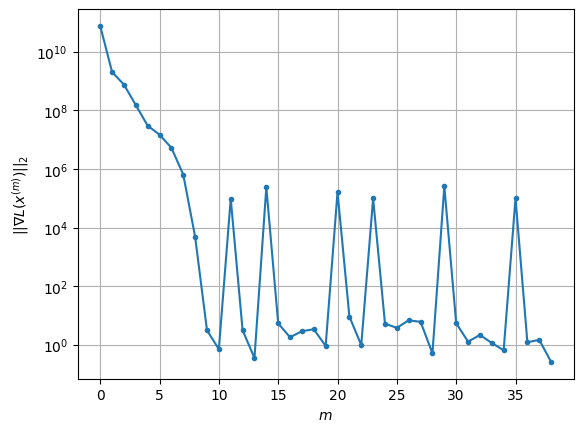

Windows:   2%|▏         | 7/296 [01:02<39:25,  8.18s/it]

Before applying the algorithm
Cost function: -23635130.28361923
Gradient norm: 164399.54352097833
Global relative error: 1.1479471219567086
Position relative errors: 0.022693464216241133 m, 0.8091456824953174 m, 0.7026221395240039 m, 0.4109401049929899 m

Iteration 1
Cost function: -23635130.76052209 (-0.00%)
Gradient norm: 6.368642059074579 (-100.00%)
Global relative error: 1.5824162441909173 (37.85%)
Position relative errors: 0.016890231548232555 m, 1.1566368476377793 m, 0.8951518844002532 m, 0.603861031501904 m

Iteration 2
Cost function: -23635130.760522235 (-0.00%)
Gradient norm: 3.6022010783284952 (-43.44%)
Global relative error: 1.5822587206439769 (-0.01%)
Position relative errors: 0.01689023039918483 m, 1.1565248927148197 m, 0.8950668039393957 m, 0.6037888019031319 m

STOP on Iteration 3
Cost function = -23635130.760522097 (0.00%)
Gradient norm = 0.32024280550944256 (-91.11%)
Global relative error = 1.5822587033151865 (-0.00%)
Final position relative errors: 0.01689023315527963

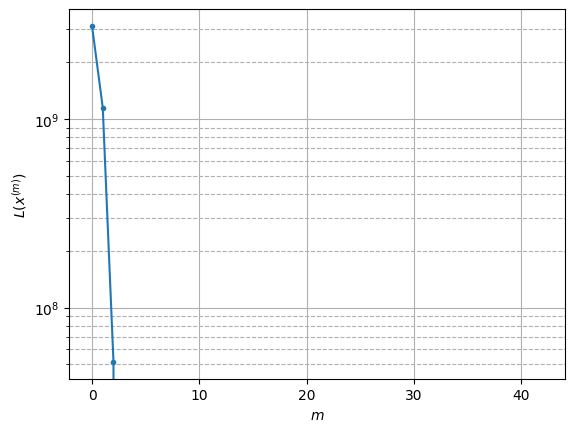

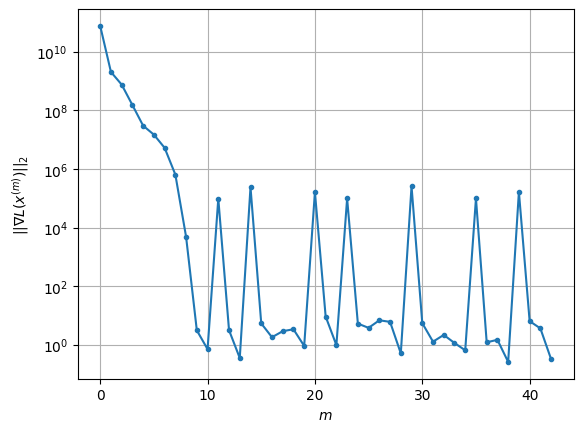

Windows:   3%|▎         | 8/296 [01:09<36:46,  7.66s/it]

Before applying the algorithm
Cost function: -23635122.79675039
Gradient norm: 337277.25593640306
Global relative error: 1.504155345808842
Position relative errors: 0.016845478921946096 m, 1.0934527373799712 m, 0.86164760553859 m, 0.569317041661426 m

Iteration 1
Cost function: -23635123.41728265 (-0.00%)
Gradient norm: 6.844815688388788 (-100.00%)
Global relative error: 1.8945234052964766 (25.95%)
Position relative errors: 0.007315939309827326 m, 1.3553876324379168 m, 1.130012488337979 m, 0.6893178132242643 m

Iteration 2
Cost function: -23635123.417282857 (-0.00%)
Gradient norm: 6.110340365577635 (-10.73%)
Global relative error: 1.8945155354757783 (-0.00%)
Position relative errors: 0.007315941044910315 m, 1.3553644093821573 m, 1.1300256445359347 m, 0.6893202791057327 m

Iteration 3
Cost function: -23635123.417282768 (0.00%)
Gradient norm: 1.3024062868288298 (-78.69%)
Global relative error: 1.8945155313166018 (-0.00%)
Position relative errors: 0.007315941685186802 m, 1.355364408885191

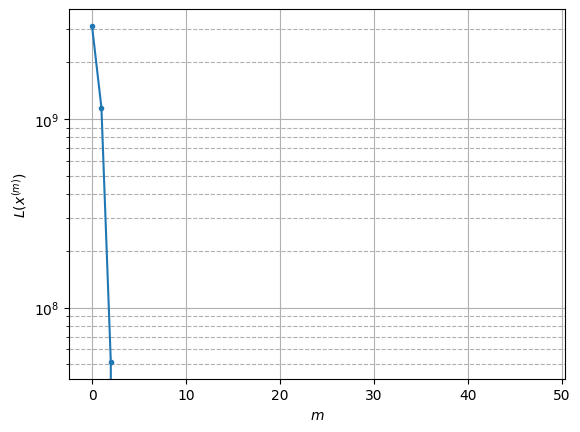

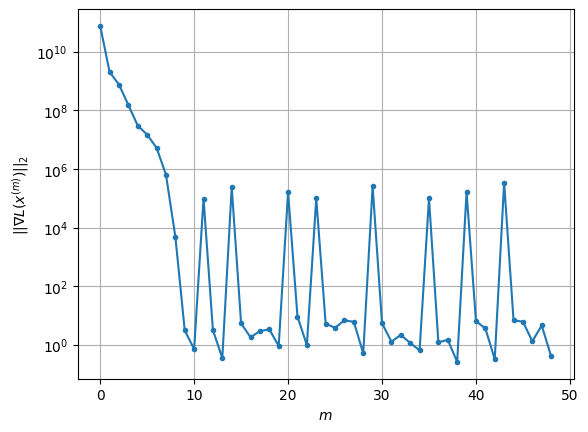

Windows:   3%|▎         | 9/296 [01:19<39:44,  8.31s/it]

Before applying the algorithm
Cost function: -23635123.68997842
Gradient norm: 74603.51923840753
Global relative error: 1.804482875133681
Position relative errors: 0.0072090658099157046 m, 1.2784595600045952 m, 1.090581513760248 m, 0.6574776278990708 m

Iteration 1
Cost function: -23635123.960125234 (-0.00%)
Gradient norm: 2.566642459612126 (-100.00%)
Global relative error: 1.6222636178953638 (-10.10%)
Position relative errors: 0.009605254132521073 m, 1.1525460776433316 m, 0.9978341928569513 m, 0.5546249731965085 m

Iteration 2
Cost function: -23635123.960125394 (-0.00%)
Gradient norm: 5.783527289925398 (125.33%)
Global relative error: 1.6222751361686216 (0.00%)
Position relative errors: 0.00960525096833028 m, 1.1525531717471895 m, 0.9978397067040881 m, 0.5546340018511074 m

STOP on Iteration 3
Cost function = -23635123.960125476 (-0.00%)
Gradient norm = 0.3288186442914662 (-94.31%)
Global relative error = 1.6222751577644898 (0.00%)
Final position relative errors: 0.009605249459929186 

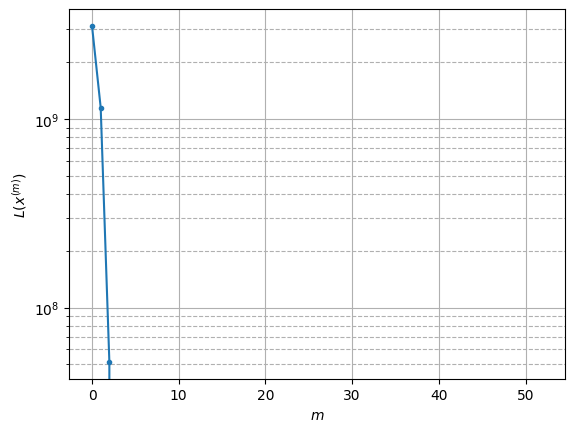

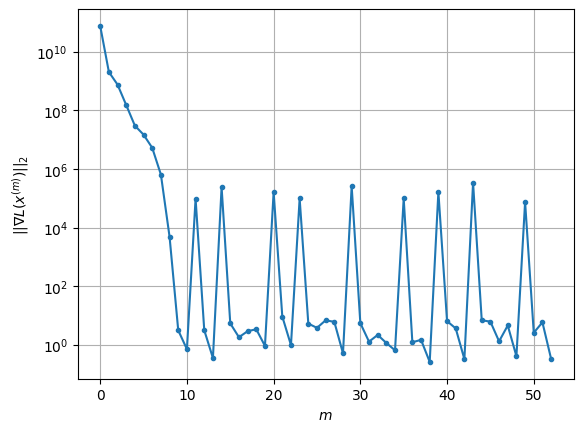

Windows:   3%|▎         | 10/296 [01:25<37:08,  7.79s/it]

Before applying the algorithm
Cost function: -23635130.43831918
Gradient norm: 232597.67706902107
Global relative error: 1.534874652343167
Position relative errors: 0.009394627469767611 m, 1.0788622582072669 m, 0.9582459511489645 m, 0.5230393112047887 m

Iteration 1
Cost function: -23635131.113114927 (-0.00%)
Gradient norm: 10.715527086792862 (-100.00%)
Global relative error: 2.1026102415140873 (36.99%)
Position relative errors: 0.022959330433177213 m, 1.475206173172195 m, 1.227869403806262 m, 0.8582200780372492 m

STOP on Iteration 2
Cost function = -23635131.113115 (-0.00%)
Gradient norm = 0.684534577085144 (-93.61%)
Global relative error = 2.102511189130997 (-0.00%)
Final position relative errors: 0.02295932471538866 m, 1.4751342287790066 m, 1.2278212478383992 m, 0.8581699670467309 m



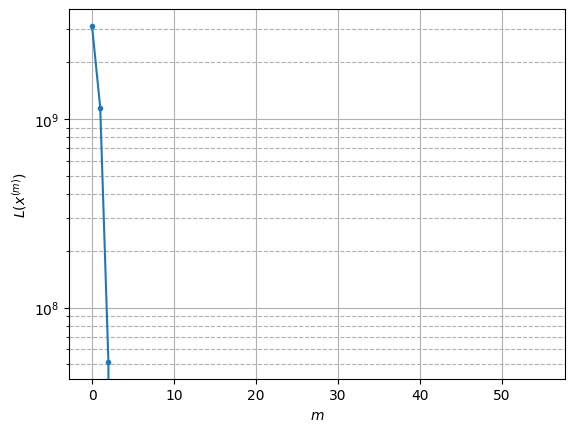

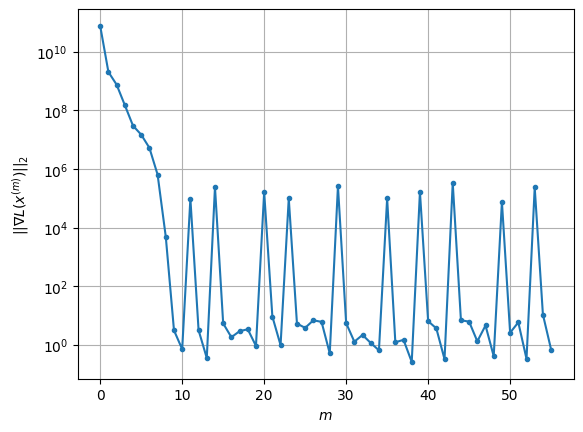

Windows:   4%|▎         | 11/296 [01:30<32:54,  6.93s/it]

Before applying the algorithm
Cost function: -23635134.751816522
Gradient norm: 86249.53816265326
Global relative error: 1.9839702492623232
Position relative errors: 0.022264504956951883 m, 1.3846022259027515 m, 1.1701578637151895 m, 0.8057572399927126 m

Iteration 1
Cost function: -23635135.760018118 (-0.00%)
Gradient norm: 13.181428324404198 (-99.98%)
Global relative error: 1.6570121607827666 (-16.48%)
Position relative errors: 0.004958838337698555 m, 1.1935018330780527 m, 1.0732467254166307 m, 0.411528770825938 m

Iteration 2
Cost function: -23635135.760018244 (-0.00%)
Gradient norm: 1.009510572403369 (-92.34%)
Global relative error: 1.6570071770357644 (-0.00%)
Position relative errors: 0.004958845351104399 m, 1.1934846920617515 m, 1.0732628827225672 m, 0.4115162774538526 m

Iteration 3
Cost function: -23635135.76001822 (0.00%)
Gradient norm: 4.125476622261271 (308.66%)
Global relative error: 1.6570071737964795 (-0.00%)
Position relative errors: 0.004958842275384608 m, 1.19348469190

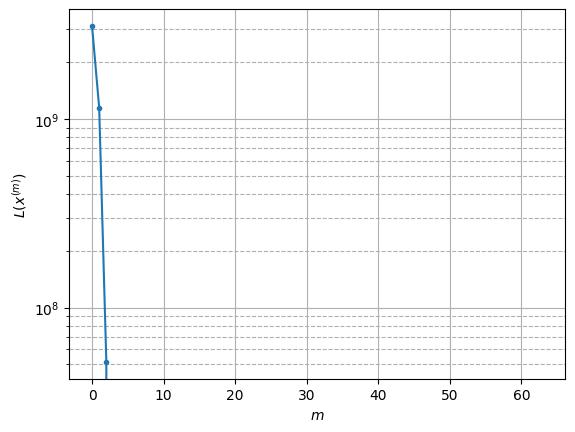

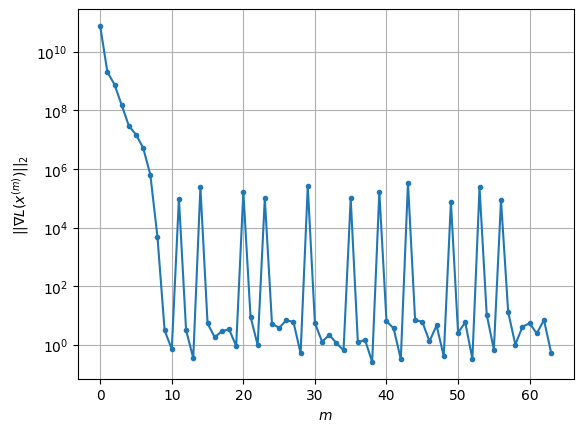

Windows:   4%|▍         | 12/296 [01:43<41:09,  8.70s/it]

Before applying the algorithm
Cost function: -23635120.451460034
Gradient norm: 200743.42865199904
Global relative error: 1.5570617736632986
Position relative errors: 0.004758633043865728 m, 1.108179818144043 m, 1.0246459843745002 m, 0.3826918928322749 m

Iteration 1
Cost function: -23635121.94549005 (-0.00%)
Gradient norm: 13.283569995385161 (-99.99%)
Global relative error: 1.5103631143528888 (-3.00%)
Position relative errors: 0.006927738618007853 m, 1.0526170056568125 m, 0.9624279165519818 m, 0.49686533786766807 m

Iteration 2
Cost function: -23635121.945490554 (-0.00%)
Gradient norm: 1.5805674701516985 (-88.10%)
Global relative error: 1.5103644375324206 (0.00%)
Position relative errors: 0.006927744844567873 m, 1.0526031470075503 m, 0.9624478365296742 m, 0.4968601342689887 m

STOP on Iteration 3
Cost function = -23635121.945490103 (0.00%)
Gradient norm = 0.9717868167485114 (-38.52%)
Global relative error = 1.5103644237914504 (-0.00%)
Final position relative errors: 0.0069277351197140

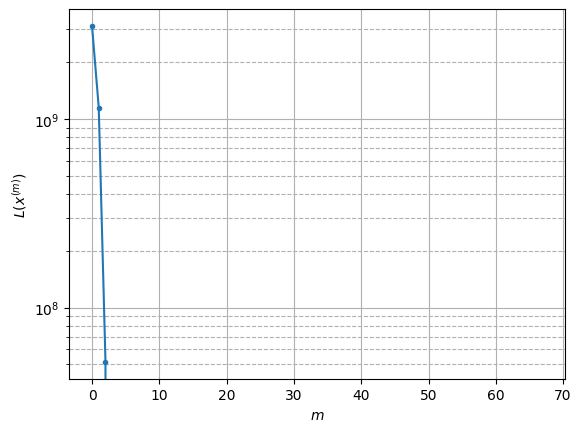

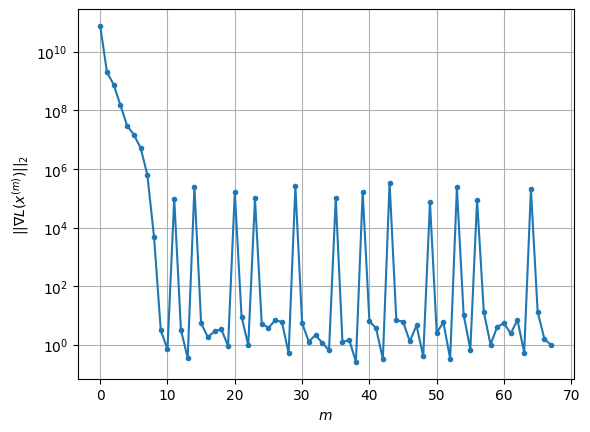

Windows:   4%|▍         | 13/296 [01:50<38:02,  8.07s/it]

Before applying the algorithm
Cost function: -23635129.861693874
Gradient norm: 127569.55328642685
Global relative error: 1.4048247520611021
Position relative errors: 0.00698890281061254 m, 0.9742467023247473 m, 0.9046858742177365 m, 0.4537255767258715 m

Iteration 1
Cost function: -23635130.05273455 (-0.00%)
Gradient norm: 2.894866897966496 (-100.00%)
Global relative error: 1.2083127087507728 (-13.99%)
Position relative errors: 0.014862923731007708 m, 0.878417310653093 m, 0.7695010390205469 m, 0.3099146799297876 m

Iteration 2
Cost function: -23635130.05273456 (-0.00%)
Gradient norm: 3.302107436610428 (14.07%)
Global relative error: 1.2083089171019763 (-0.00%)
Position relative errors: 0.014862929021061191 m, 0.8784146826849741 m, 0.7694992258447996 m, 0.30991184732875326 m

Iteration 3
Cost function: -23635130.052734945 (-0.00%)
Gradient norm: 2.6389189902063257 (-20.08%)
Global relative error: 1.2083089189425948 (0.00%)
Position relative errors: 0.01486292385871255 m, 0.878414687345

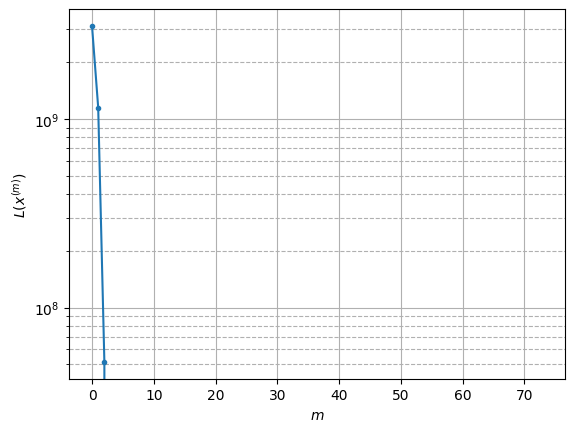

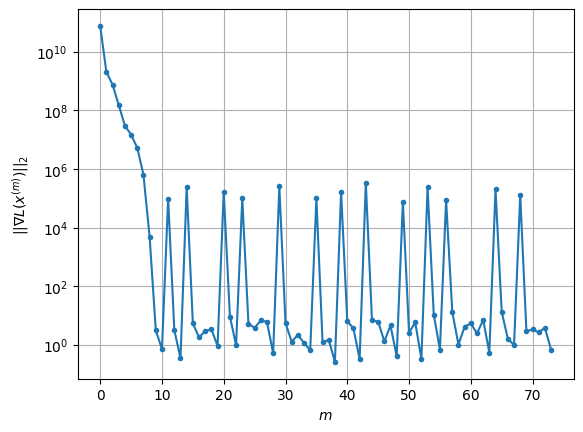

Windows:   5%|▍         | 14/296 [01:59<40:28,  8.61s/it]

Before applying the algorithm
Cost function: -23635135.21554062
Gradient norm: 88017.2430973285
Global relative error: 1.1141626411125611
Position relative errors: 0.014681155771051092 m, 0.803299604465921 m, 0.7201489513992811 m, 0.2779122390094452 m

Iteration 1
Cost function: -23635135.729414944 (-0.00%)
Gradient norm: 5.9897511545625335 (-99.99%)
Global relative error: 1.390157744891461 (24.77%)
Position relative errors: 0.01480612904933216 m, 0.8770146299183685 m, 0.9336891495673708 m, 0.5398002589483363 m

Iteration 2
Cost function: -23635135.729414795 (0.00%)
Gradient norm: 3.4296060649378313 (-42.74%)
Global relative error: 1.3901495466142053 (-0.00%)
Position relative errors: 0.014806127100229046 m, 0.8770127505392779 m, 0.9336852558062397 m, 0.5397889343335244 m

Iteration 3
Cost function: -23635135.72941476 (0.00%)
Gradient norm: 3.8168154700737387 (11.29%)
Global relative error: 1.3901495325579598 (-0.00%)
Position relative errors: 0.014806126009523187 m, 0.8770127393334147

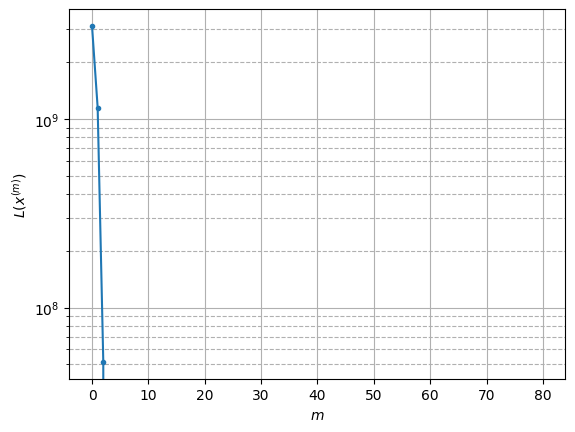

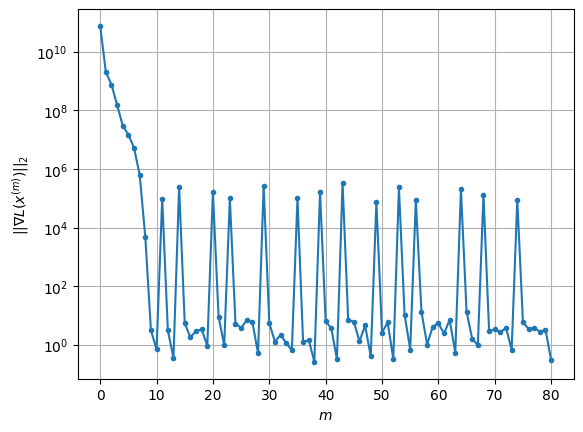

Windows:   5%|▌         | 15/296 [02:11<44:07,  9.42s/it]

Before applying the algorithm
Cost function: -23635127.525847975
Gradient norm: 308281.5483095441
Global relative error: 1.2774090843786676
Position relative errors: 0.014703071289293289 m, 0.7964679316016601 m, 0.8672989782386826 m, 0.494958704724314 m

Iteration 1
Cost function: -23635127.86539053 (-0.00%)
Gradient norm: 5.2610403999671185 (-100.00%)
Global relative error: 1.0998527642835911 (-13.90%)
Position relative errors: 0.016555586685718555 m, 0.6392837747927863 m, 0.7832512905594462 m, 0.4327022860424669 m

Iteration 2
Cost function: -23635127.865390666 (-0.00%)
Gradient norm: 2.9554696974531085 (-43.82%)
Global relative error: 1.0998675946390317 (0.00%)
Position relative errors: 0.01655558044267189 m, 0.6392962062605434 m, 0.7832599199807867 m, 0.4327059953347745 m

STOP on Iteration 3
Cost function = -23635127.8653903 (0.00%)
Gradient norm = 0.26404790163550873 (-91.07%)
Global relative error = 1.099867587962826 (-0.00%)
Final position relative errors: 0.01655558065191852 m

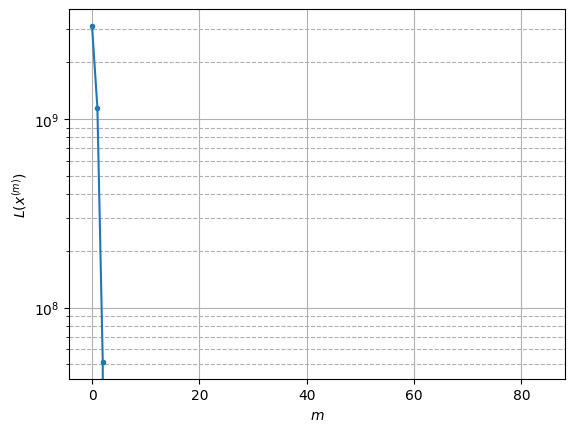

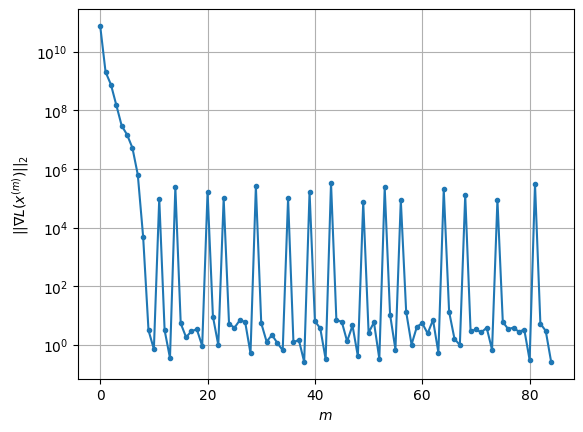

Windows:   5%|▌         | 16/296 [02:17<40:08,  8.60s/it]

Before applying the algorithm
Cost function: -23635121.89678081
Gradient norm: 113466.37915143235
Global relative error: 1.0142881158234753
Position relative errors: 0.01624375752720709 m, 0.5798449132273037 m, 0.7271218685282226 m, 0.40445741873386276 m

Iteration 1
Cost function: -23635122.214728527 (-0.00%)
Gradient norm: 2.8542107916719144 (-100.00%)
Global relative error: 1.016123409523176 (0.18%)
Position relative errors: 0.00957670272972101 m, 0.5797341347844336 m, 0.6791126965767454 m, 0.48489695654582365 m

Iteration 2
Cost function: -23635122.214728486 (0.00%)
Gradient norm: 3.3537406201815507 (17.50%)
Global relative error: 1.016125456194953 (0.00%)
Position relative errors: 0.009576702847423816 m, 0.5797358119515447 m, 0.6791137398790106 m, 0.4848977790886082 m

STOP on Iteration 3
Cost function = -23635122.21472849 (-0.00%)
Gradient norm = 0.5797434249838241 (-82.71%)
Global relative error = 1.0161254748235709 (0.00%)
Final position relative errors: 0.009576703184188674 m,

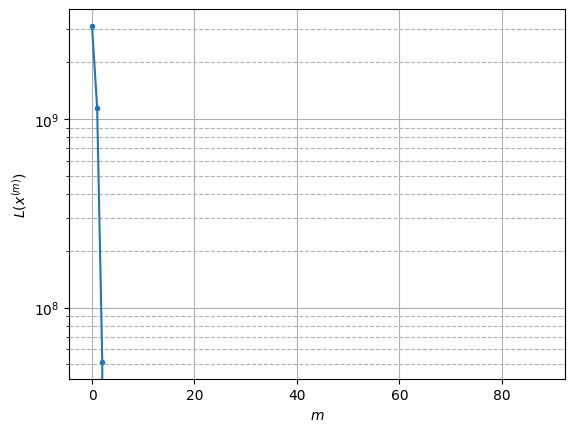

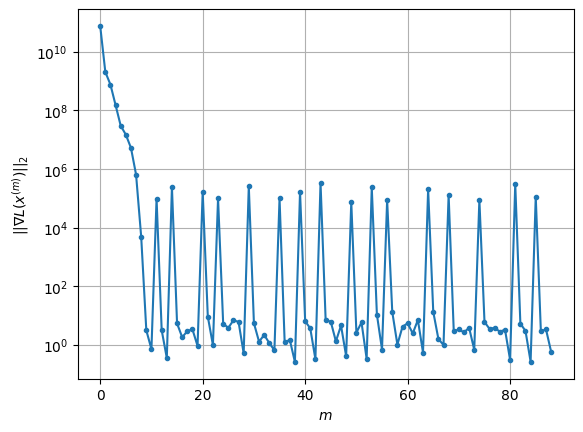

Windows:   6%|▌         | 17/296 [02:24<37:31,  8.07s/it]

Before applying the algorithm
Cost function: -23635121.93913341
Gradient norm: 113150.02075216305
Global relative error: 0.9598082535662579
Position relative errors: 0.009732311766576004 m, 0.5375820327744284 m, 0.6362953076455597 m, 0.47672510677542396 m

Iteration 1
Cost function: -23635122.7141972 (-0.00%)
Gradient norm: 8.061637693901194 (-99.99%)
Global relative error: 0.9628587077891687 (0.32%)
Position relative errors: 0.012111272984182192 m, 0.5133419512095675 m, 0.598040164954297 m, 0.5529698797293998 m

Iteration 2
Cost function: -23635122.714197468 (-0.00%)
Gradient norm: 3.4437590886539953 (-57.28%)
Global relative error: 0.9628269437929176 (-0.00%)
Position relative errors: 0.01211126804486353 m, 0.5133297038256635 m, 0.5980329133507695 m, 0.5529337825575823 m

Iteration 3
Cost function: -23635122.71419741 (0.00%)
Gradient norm: 4.9967949512288286 (45.10%)
Global relative error: 0.9628269601393562 (0.00%)
Position relative errors: 0.012111273135372615 m, 0.5133297142963503

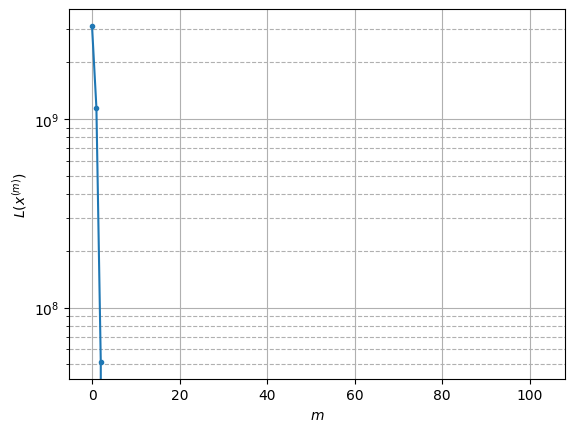

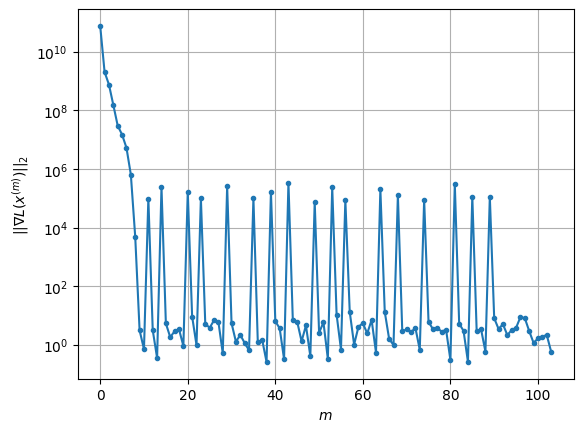

Windows:   6%|▌         | 18/296 [02:48<59:25, 12.82s/it]

Before applying the algorithm
Cost function: -23635125.007577214
Gradient norm: 140728.16837400015
Global relative error: 0.9676441425710657
Position relative errors: 0.01219784207535991 m, 0.5197638114606536 m, 0.5857595851234462 m, 0.5682563878333194 m

Iteration 1
Cost function: -23635125.430707224 (-0.00%)
Gradient norm: 8.277922678715727 (-99.99%)
Global relative error: 1.1676140482615547 (20.67%)
Position relative errors: 0.012184455564677376 m, 0.6091296728720738 m, 0.7642166254281634 m, 0.6388318290457194 m

Iteration 2
Cost function: -23635125.430707145 (0.00%)
Gradient norm: 4.540022001232164 (-45.16%)
Global relative error: 1.1676146789537305 (0.00%)
Position relative errors: 0.012184455448841287 m, 0.6091300878332055 m, 0.7642164577237399 m, 0.6388327867817507 m

Iteration 3
Cost function: -23635125.430706993 (0.00%)
Gradient norm: 2.321230181205298 (-48.87%)
Global relative error: 1.1676146537823295 (-0.00%)
Position relative errors: 0.012184455347470645 m, 0.6091300612169

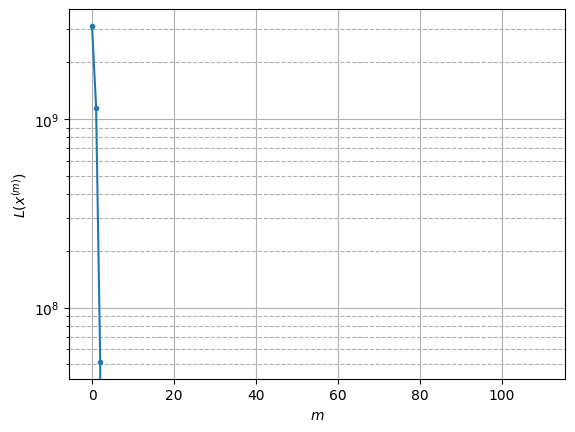

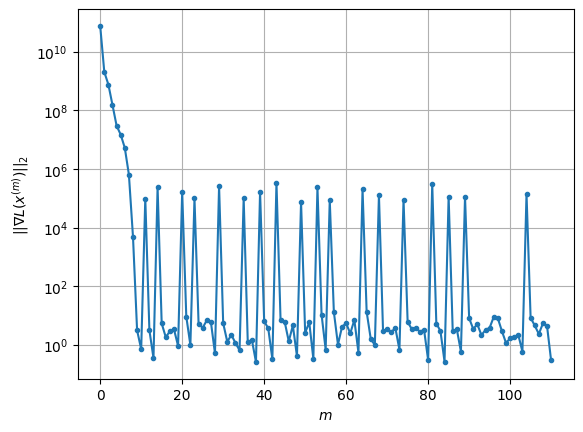

Windows:   6%|▋         | 19/296 [02:59<56:59, 12.35s/it]

Before applying the algorithm
Cost function: -23635124.141070634
Gradient norm: 131125.57606010418
Global relative error: 1.1544435889843536
Position relative errors: 0.012343109639210741 m, 0.6171785264222267 m, 0.7388211727931133 m, 0.6370398321942619 m

Iteration 1
Cost function: -23635124.54676754 (-0.00%)
Gradient norm: 4.91810365483244 (-100.00%)
Global relative error: 1.1165319890212748 (-3.28%)
Position relative errors: 0.012222407204183177 m, 0.5303807089666258 m, 0.7658525891937328 m, 0.6153520040878343 m

Iteration 2
Cost function: -23635124.546767347 (0.00%)
Gradient norm: 3.330873709958585 (-32.27%)
Global relative error: 1.116527738722764 (-0.00%)
Position relative errors: 0.012222406518402564 m, 0.5303793458824232 m, 0.7658520028281359 m, 0.615346196690196 m

Iteration 3
Cost function: -23635124.546767287 (0.00%)
Gradient norm: 2.509444667018828 (-24.66%)
Global relative error: 1.116527742326729 (0.00%)
Position relative errors: 0.012222406913362576 m, 0.5303793615363125

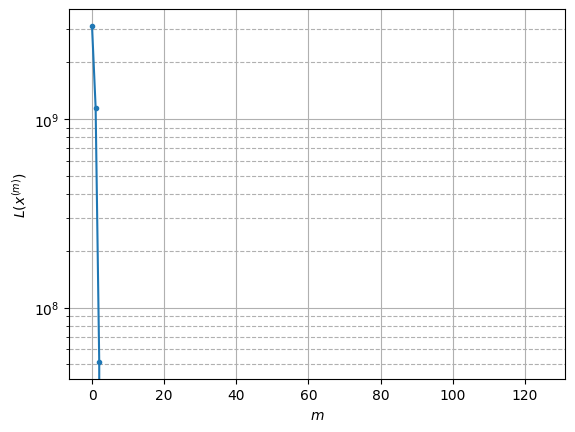

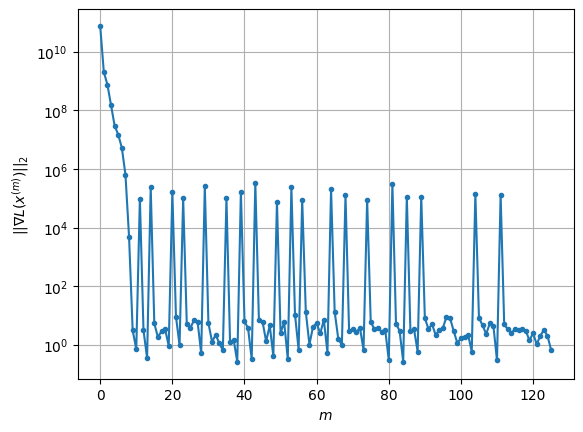

Windows:   7%|▋         | 20/296 [03:23<1:12:09, 15.69s/it]

Before applying the algorithm
Cost function: -23635122.584834184
Gradient norm: 164705.6987950333
Global relative error: 1.1015367755745324
Position relative errors: 0.012295910615509414 m, 0.5340396173696257 m, 0.7394214008449752 m, 0.6174848993305536 m

Iteration 1
Cost function: -23635123.15912532 (-0.00%)
Gradient norm: 2.6778862820643132 (-100.00%)
Global relative error: 1.1392520948041494 (3.42%)
Position relative errors: 0.019275030439670895 m, 0.5510291954399916 m, 0.8463396204615315 m, 0.5268754068397479 m

Iteration 2
Cost function: -23635123.1591253 (0.00%)
Gradient norm: 1.0818079372729712 (-59.60%)
Global relative error: 1.139248818380996 (-0.00%)
Position relative errors: 0.019275028786835822 m, 0.5510277696703967 m, 0.8463382998116352 m, 0.5268719349463985 m

Iteration 3
Cost function: -23635123.159125317 (-0.00%)
Gradient norm: 1.7375478655807566 (60.62%)
Global relative error: 1.1392488243957037 (0.00%)
Position relative errors: 0.019275028118545093 m, 0.55102777475367

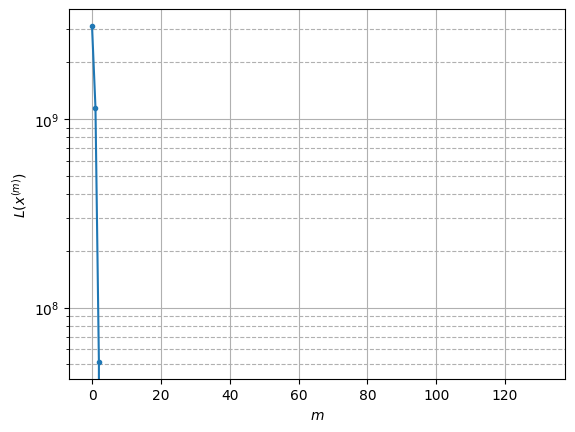

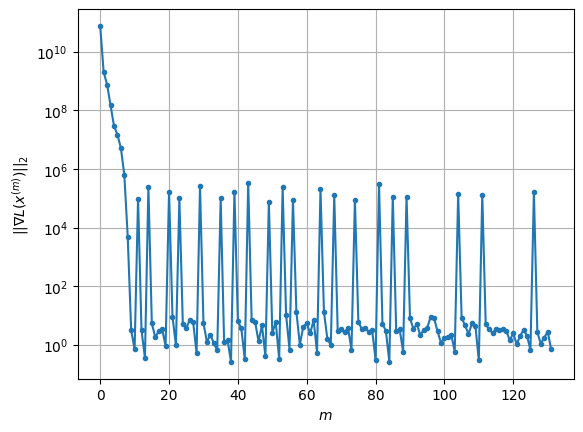

Windows:   7%|▋         | 21/296 [03:33<1:03:59, 13.96s/it]

Before applying the algorithm
Cost function: -23635119.493965283
Gradient norm: 129387.89058447092
Global relative error: 1.1108632817736697
Position relative errors: 0.0188135629116514 m, 0.5531905350438645 m, 0.8097546703179037 m, 0.5214775774104738 m

Iteration 1
Cost function: -23635119.82622297 (-0.00%)
Gradient norm: 13.99186192169587 (-99.99%)
Global relative error: 1.3225154621124857 (19.05%)
Position relative errors: 0.021608672277230057 m, 0.7627571427298003 m, 0.8447321677333712 m, 0.6732070295576064 m

Iteration 2
Cost function: -23635119.826222975 (-0.00%)
Gradient norm: 4.200410471221254 (-69.98%)
Global relative error: 1.3224799112411725 (-0.00%)
Position relative errors: 0.021608671721063764 m, 0.7627288307321648 m, 0.8447222063593169 m, 0.6731817670848814 m

Iteration 3
Cost function: -23635119.826222766 (0.00%)
Gradient norm: 2.8144279789842335 (-33.00%)
Global relative error: 1.3224798944525706 (-0.00%)
Position relative errors: 0.02160866848515703 m, 0.7627288254164

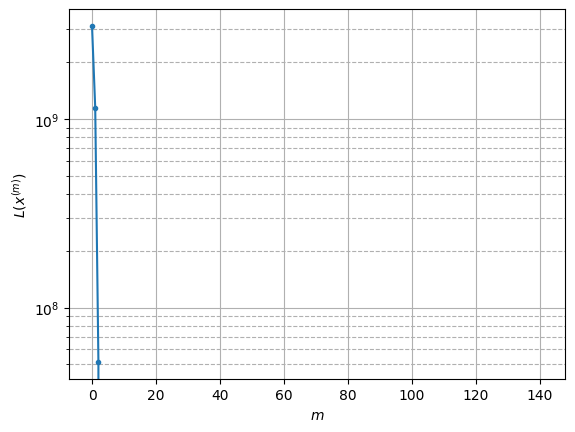

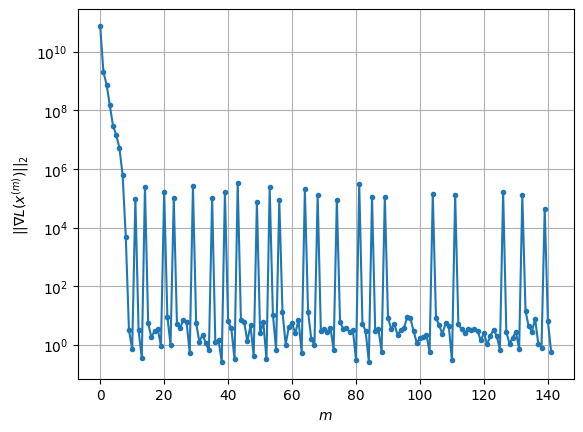

Windows:   8%|▊         | 23/296 [03:49<48:54, 10.75s/it]  

Before applying the algorithm
Cost function: -23635114.062948704
Gradient norm: 79743.06341654224
Global relative error: 1.0157243142553354
Position relative errors: 0.016883549930783334 m, 0.5257780518283969 m, 0.6651520008856989 m, 0.5590524890220149 m

Iteration 1
Cost function: -23635114.72126928 (-0.00%)
Gradient norm: 6.949377303302627 (-99.99%)
Global relative error: 1.0049899178544734 (-1.06%)
Position relative errors: 0.02233455467905336 m, 0.4640307836734695 m, 0.624976681010564 m, 0.6352830822720446 m

Iteration 2
Cost function: -23635114.721269466 (-0.00%)
Gradient norm: 1.0097581152937831 (-85.47%)
Global relative error: 1.0049896832944438 (-0.00%)
Position relative errors: 0.022334554938721694 m, 0.46402951541710846 m, 0.6249781749727152 m, 0.6352821678301159 m

Iteration 3
Cost function: -23635114.72126935 (0.00%)
Gradient norm: 4.854686329644309 (380.78%)
Global relative error: 1.0049896816281336 (-0.00%)
Position relative errors: 0.02233456151604438 m, 0.46402950848131

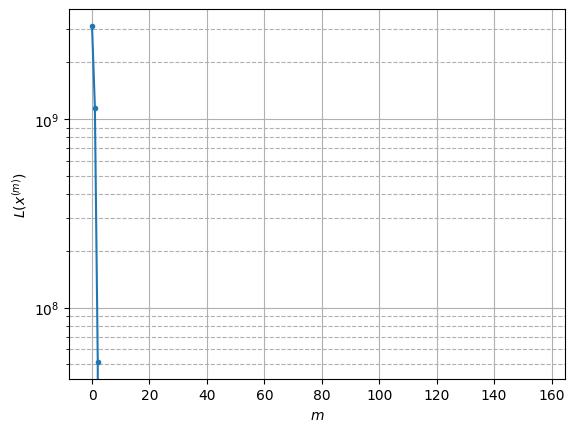

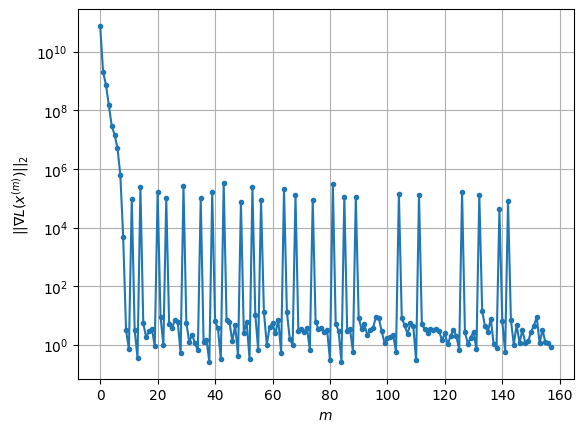

Windows:   8%|▊         | 24/296 [04:14<1:08:06, 15.02s/it]

Before applying the algorithm
Cost function: -23635123.59762569
Gradient norm: 118567.20730621365
Global relative error: 0.9988439401677665
Position relative errors: 0.021529052877252045 m, 0.4861895533035715 m, 0.6091437680202593 m, 0.6243304437201584 m

Iteration 1
Cost function: -23635123.795402236 (-0.00%)
Gradient norm: 4.2610889979389315 (-100.00%)
Global relative error: 0.8894687643916999 (-10.95%)
Position relative errors: 0.02600215362262086 m, 0.42624498732520105 m, 0.5341193143482567 m, 0.5687789711750894 m

Iteration 2
Cost function: -23635123.79540238 (-0.00%)
Gradient norm: 2.836015355161034 (-33.44%)
Global relative error: 0.8894723131319708 (0.00%)
Position relative errors: 0.02600214715760648 m, 0.42624756466533587 m, 0.5341212057429495 m, 0.5687808134546812 m

Iteration 3
Cost function: -23635123.795401946 (0.00%)
Gradient norm: 4.982658637039175 (75.69%)
Global relative error: 0.8894723207300547 (0.00%)
Position relative errors: 0.026002157764062953 m, 0.426247562639

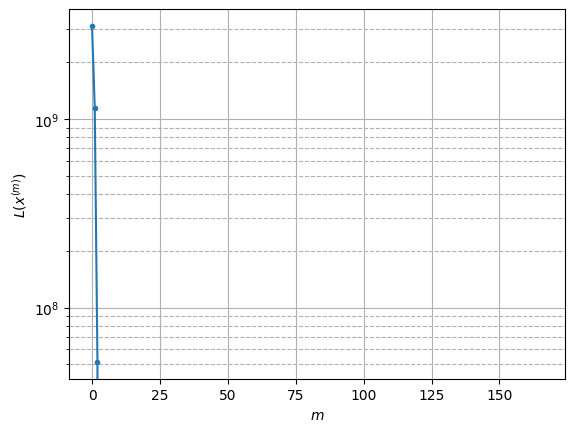

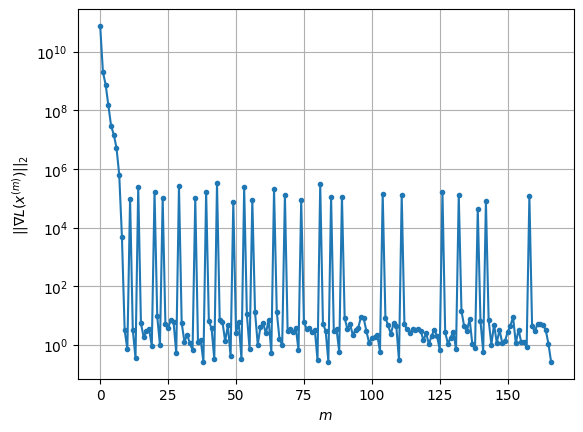

Windows:   8%|▊         | 25/296 [04:29<1:07:02, 14.84s/it]

Before applying the algorithm
Cost function: -23635123.218746692
Gradient norm: 248975.5508401081
Global relative error: 0.8934117657357162
Position relative errors: 0.025311369082371263 m, 0.4560445478575214 m, 0.5232109756645489 m, 0.5619758212985404 m

Iteration 1
Cost function: -23635123.790289715 (-0.00%)
Gradient norm: 6.588351919701573 (-100.00%)
Global relative error: 0.8205360124903043 (-8.16%)
Position relative errors: 0.02950902934083746 m, 0.4895319432848966 m, 0.43376559985481394 m, 0.49458455909936117 m

Iteration 2
Cost function: -23635123.79028987 (-0.00%)
Gradient norm: 1.6404578827374694 (-75.10%)
Global relative error: 0.8205336795118401 (-0.00%)
Position relative errors: 0.02950902269509427 m, 0.48952877921848975 m, 0.4337660287855732 m, 0.49458344454529163 m

Iteration 3
Cost function: -23635123.79028974 (0.00%)
Gradient norm: 1.63099308110543 (-0.58%)
Global relative error: 0.8205336811398312 (0.00%)
Position relative errors: 0.029509025310579258 m, 0.489528770863

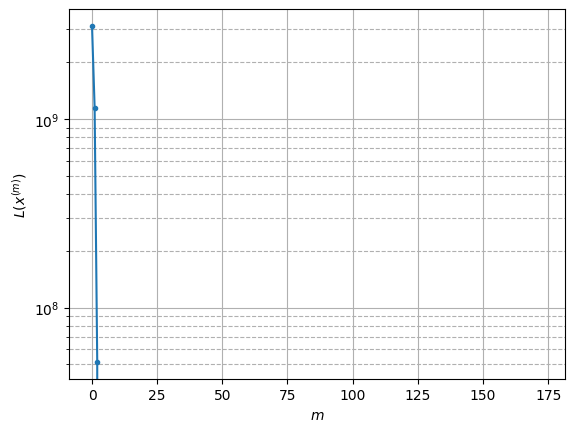

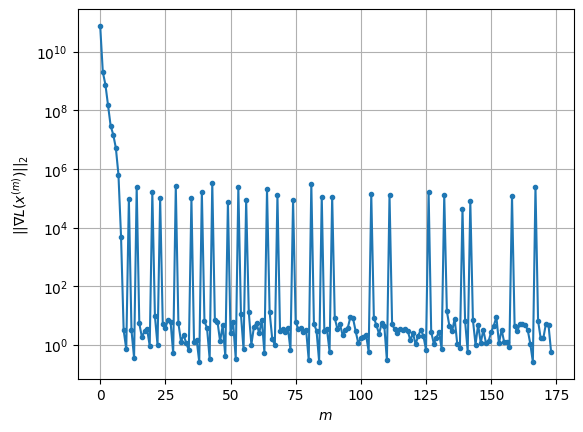

Windows:   9%|▉         | 26/296 [04:40<1:01:59, 13.77s/it]

Before applying the algorithm
Cost function: -23635114.904443067
Gradient norm: 573827.5950279196
Global relative error: 0.8330963490532015
Position relative errors: 0.028855456828977322 m, 0.5105826148853995 m, 0.436394606861933 m, 0.49201782642855496 m

Iteration 1
Cost function: -23635115.545492608 (-0.00%)
Gradient norm: 5.864822219733173 (-100.00%)
Global relative error: 1.0089957776011826 (21.11%)
Position relative errors: 0.03506816158532214 m, 0.6836824081297077 m, 0.5249566685985413 m, 0.5232978319872786 m

Iteration 2
Cost function: -23635115.545492616 (-0.00%)
Gradient norm: 3.299847923594131 (-43.73%)
Global relative error: 1.0090035415273428 (0.00%)
Position relative errors: 0.035068164131418916 m, 0.6836849684464223 m, 0.5249608936782644 m, 0.5233052183220288 m

Iteration 3
Cost function: -23635115.54549258 (0.00%)
Gradient norm: 4.787946110467905 (45.10%)
Global relative error: 1.0090035400267823 (-0.00%)
Position relative errors: 0.035068160814375055 m, 0.68368496175327

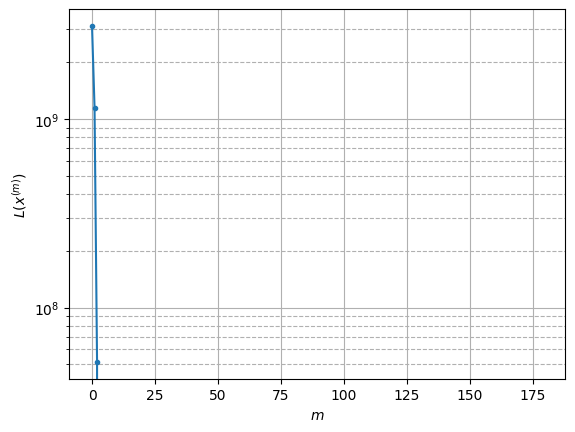

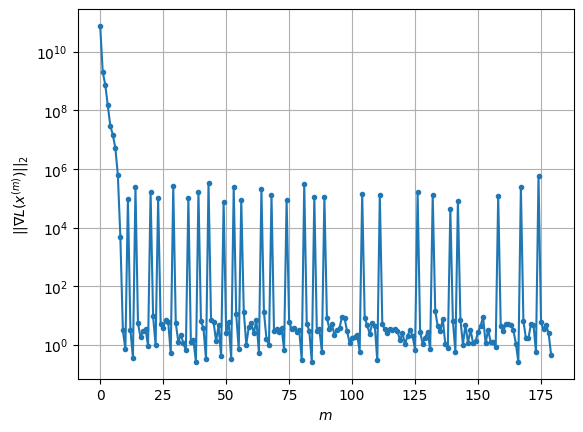

Windows:   9%|▉         | 27/296 [04:50<56:17, 12.56s/it]  

Before applying the algorithm
Cost function: -23635113.494901776
Gradient norm: 36184.26021143301
Global relative error: 1.0402349961047792
Position relative errors: 0.033714953010953244 m, 0.7149455185296342 m, 0.5385209884531349 m, 0.5289606697865314 m

Iteration 1
Cost function: -23635113.66443068 (-0.00%)
Gradient norm: 2.3953748326834345 (-99.99%)
Global relative error: 1.1972872969318002 (15.10%)
Position relative errors: 0.03856860775967337 m, 0.8161814364630374 m, 0.6121232581924146 m, 0.6254289504650997 m

Iteration 2
Cost function: -23635113.664430525 (0.00%)
Gradient norm: 1.9873019377732932 (-17.04%)
Global relative error: 1.1972944789545563 (0.00%)
Position relative errors: 0.038568601080012734 m, 0.8161865401728289 m, 0.612126628257361 m, 0.625432741041119 m

Iteration 3
Cost function: -23635113.66443052 (0.00%)
Gradient norm: 3.461134302586872 (74.16%)
Global relative error: 1.1972944761563469 (-0.00%)
Position relative errors: 0.03856859931140334 m, 0.816186538894054 m,

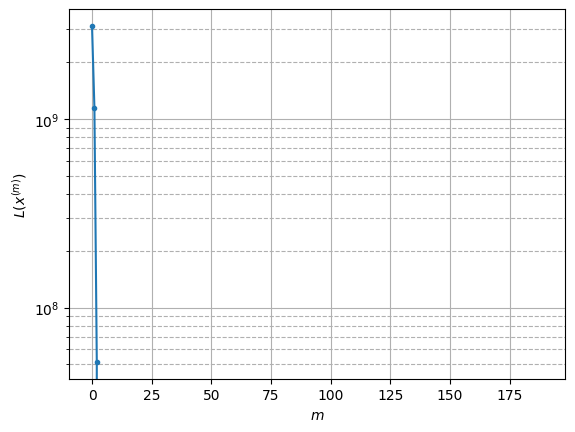

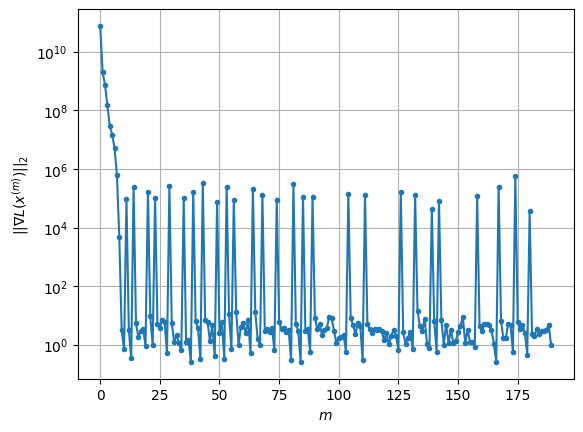

Windows:   9%|▉         | 28/296 [05:06<1:00:59, 13.65s/it]

Before applying the algorithm
Cost function: -23635117.4518572
Gradient norm: 227881.12591859483
Global relative error: 1.2288472953207537
Position relative errors: 0.03708017487165328 m, 0.8510093356080333 m, 0.6234227399581106 m, 0.6291400034450049 m

Iteration 1
Cost function: -23635117.803640086 (-0.00%)
Gradient norm: 6.4106235637400015 (-100.00%)
Global relative error: 1.0453945223799122 (-14.93%)
Position relative errors: 0.044016905268811315 m, 0.7071088196492313 m, 0.5549958620113924 m, 0.5318724089684953 m

STOP on Iteration 2
Cost function = -23635117.803640243 (-0.00%)
Gradient norm = 0.12446462581874786 (-98.06%)
Global relative error = 1.0453937017650623 (-0.00%)
Final position relative errors: 0.04401690526397057 m, 0.7071081901145668 m, 0.5549955373079688 m, 0.5318719718265951 m



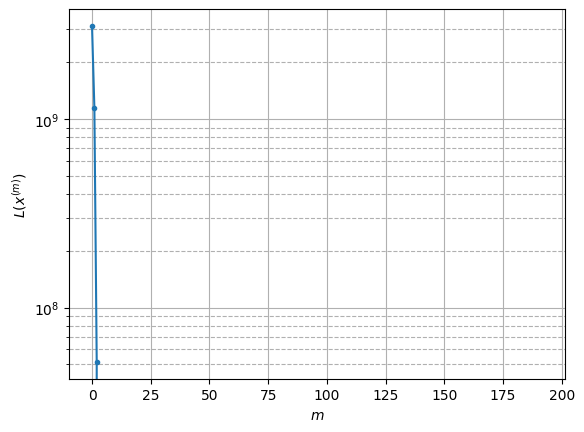

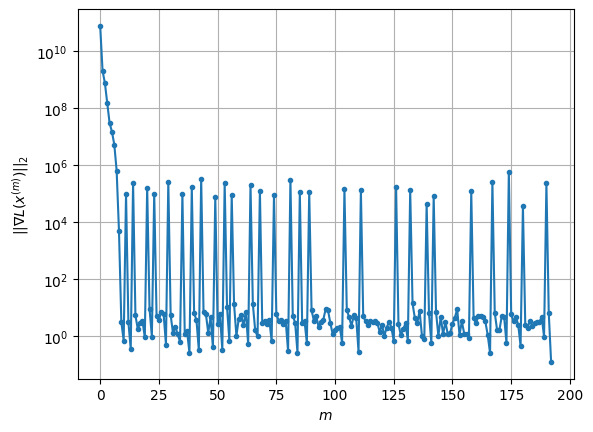

Windows:  10%|▉         | 29/296 [05:11<49:18, 11.08s/it]  

Before applying the algorithm
Cost function: -23635127.684562635
Gradient norm: 277963.9131959808
Global relative error: 1.0677947201201574
Position relative errors: 0.04240312898655962 m, 0.7304169798982887 m, 0.5649578406245414 m, 0.5345097324923814 m

Iteration 1
Cost function: -23635128.09992849 (-0.00%)
Gradient norm: 4.54660216213166 (-100.00%)
Global relative error: 1.427840491987148 (33.72%)
Position relative errors: 0.03860400109349749 m, 0.9480838733458588 m, 0.7838151691407074 m, 0.7238839783179711 m

Iteration 2
Cost function: -23635128.099928427 (0.00%)
Gradient norm: 1.4294785926139162 (-68.56%)
Global relative error: 1.4278255116342498 (-0.00%)
Position relative errors: 0.038604001896769664 m, 0.9480732860326743 m, 0.7838066759321695 m, 0.723877492727751 m

Iteration 3
Cost function: -23635128.099928517 (-0.00%)
Gradient norm: 1.3386522748964538 (-6.35%)
Global relative error: 1.4278255153882662 (0.00%)
Position relative errors: 0.03860400150294124 m, 0.9480732891969007 

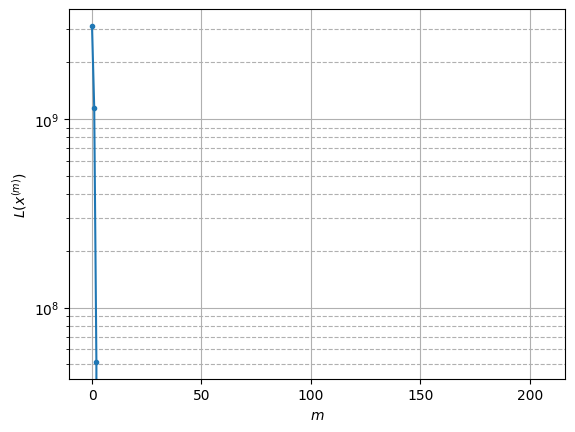

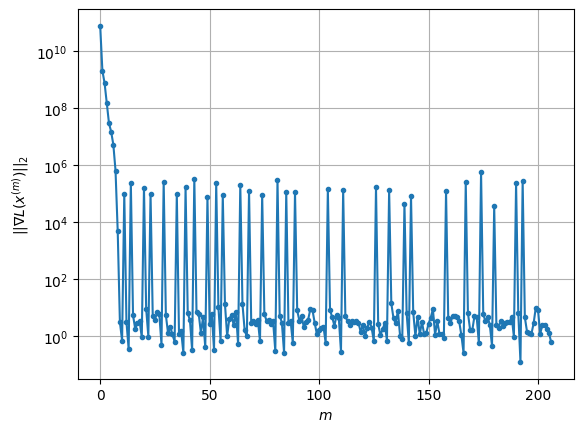

Windows:  10%|█         | 30/296 [05:33<1:04:13, 14.49s/it]

Before applying the algorithm
Cost function: -23635121.937809736
Gradient norm: 386223.04632015264
Global relative error: 1.4535800016750655
Position relative errors: 0.03746088882703842 m, 0.9734099413442255 m, 0.7960655621140293 m, 0.7281781681967995 m

Iteration 1
Cost function: -23635122.305568393 (-0.00%)
Gradient norm: 1.8598960694125017 (-100.00%)
Global relative error: 1.2575605422980176 (-13.49%)
Position relative errors: 0.031214476750689956 m, 0.8602110635769046 m, 0.7067999574134661 m, 0.583912990624818 m

Iteration 2
Cost function: -23635122.3055686 (-0.00%)
Gradient norm: 2.342484621155483 (25.95%)
Global relative error: 1.2575859671804086 (0.00%)
Position relative errors: 0.031214471921404714 m, 0.8602289137019028 m, 0.7068119550696861 m, 0.5839269287339447 m

Iteration 3
Cost function: -23635122.305568032 (0.00%)
Gradient norm: 1.6217135008639878 (-30.77%)
Global relative error: 1.2575859700829308 (0.00%)
Position relative errors: 0.031214474183573215 m, 0.8602289174797

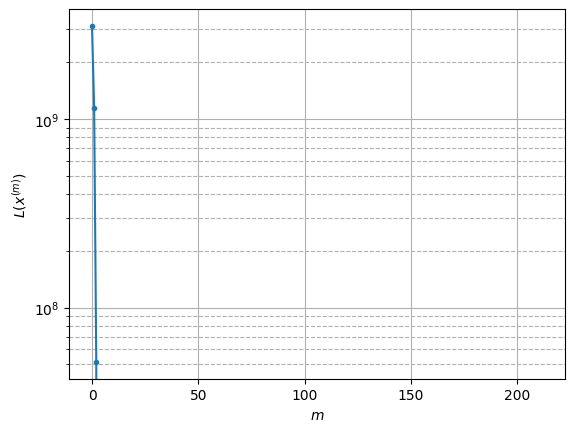

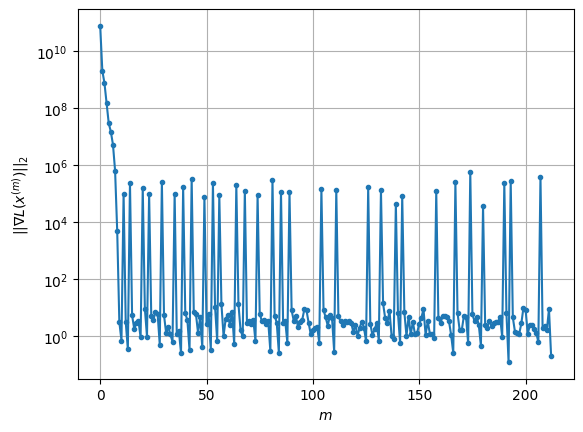

Windows:  10%|█         | 31/296 [05:43<57:43, 13.07s/it]  

Before applying the algorithm
Cost function: -23635121.03341825
Gradient norm: 207071.95229886041
Global relative error: 1.2749847344553642
Position relative errors: 0.03062888608755695 m, 0.8777195236352904 m, 0.7163403058697634 m, 0.5840483850665336 m

Iteration 1
Cost function: -23635121.265511777 (-0.00%)
Gradient norm: 5.563582452654823 (-100.00%)
Global relative error: 1.248491684609896 (-2.08%)
Position relative errors: 0.026295335224160672 m, 0.8722917140320608 m, 0.6631242996675984 m, 0.5978403314078579 m

Iteration 2
Cost function: -23635121.26551221 (-0.00%)
Gradient norm: 1.8335897921322415 (-67.04%)
Global relative error: 1.2484967981992214 (0.00%)
Position relative errors: 0.026295330014122497 m, 0.8722949451650372 m, 0.6631266171531917 m, 0.5978437255184504 m

Iteration 3
Cost function: -23635121.265512556 (-0.00%)
Gradient norm: 1.212670021833707 (-33.86%)
Global relative error: 1.2484967961268647 (-0.00%)
Position relative errors: 0.026295336514496524 m, 0.872294945213

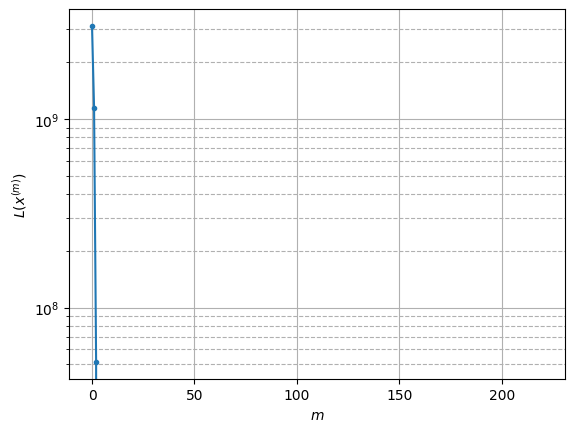

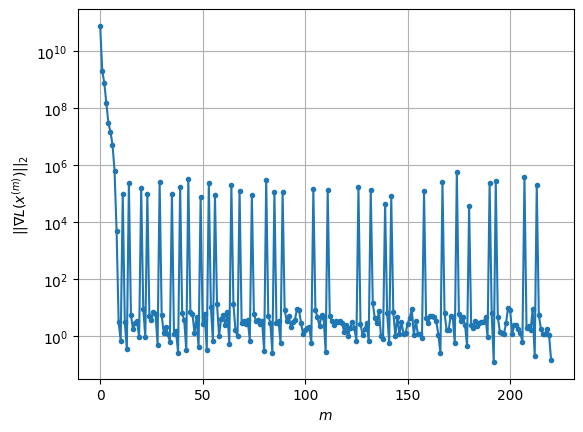

Windows:  11%|█         | 32/296 [05:56<57:21, 13.04s/it]

Before applying the algorithm
Cost function: -23635113.768372193
Gradient norm: 293567.62328247866
Global relative error: 1.2573288661066413
Position relative errors: 0.026165912870841433 m, 0.8827270326572079 m, 0.6698299369445246 m, 0.5935586053234597 m

Iteration 1
Cost function: -23635114.26191045 (-0.00%)
Gradient norm: 2.4500637758879455 (-100.00%)
Global relative error: 1.3697313914747111 (8.94%)
Position relative errors: 0.04028316110825402 m, 0.9761786221997709 m, 0.7634879789442712 m, 0.5819814434475954 m

Iteration 2
Cost function: -23635114.261910077 (0.00%)
Gradient norm: 2.287276128574508 (-6.64%)
Global relative error: 1.369728893866693 (-0.00%)
Position relative errors: 0.040283169287399646 m, 0.9761768789828178 m, 0.7634853998027049 m, 0.5819818720700182 m

Iteration 3
Cost function: -23635114.261910465 (-0.00%)
Gradient norm: 1.2566173573488246 (-45.06%)
Global relative error: 1.369728882237467 (-0.00%)
Position relative errors: 0.04028316453660761 m, 0.97617687311375

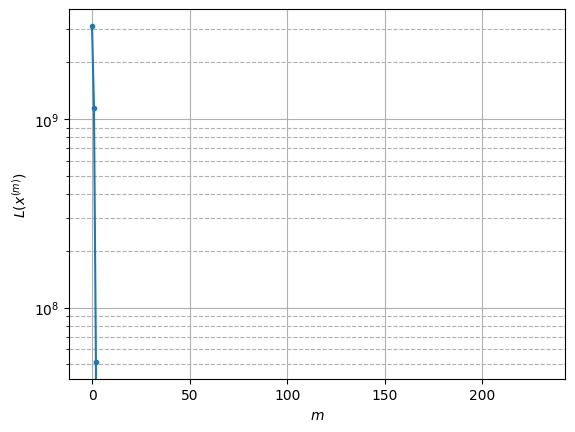

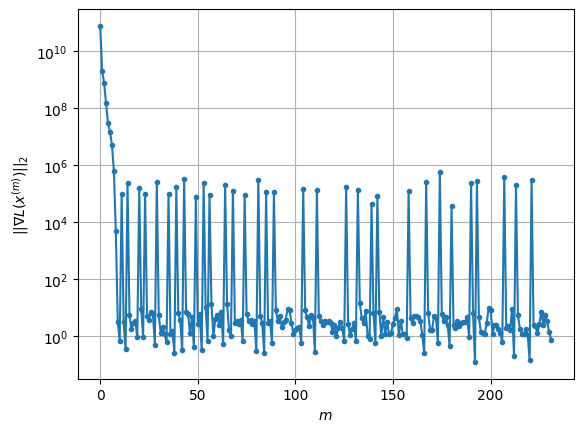

Windows:  11%|█         | 33/296 [06:14<1:03:00, 14.37s/it]

Before applying the algorithm
Cost function: -23635111.928433325
Gradient norm: 117112.49777644525
Global relative error: 1.3815635650715798
Position relative errors: 0.03926598050421905 m, 0.9858812972772594 m, 0.7720319276215576 m, 0.5823921038000512 m

Iteration 1
Cost function: -23635112.593567245 (-0.00%)
Gradient norm: 2.4327662095960867 (-100.00%)
Global relative error: 1.2090728515546714 (-12.49%)
Position relative errors: 0.029145118945536803 m, 0.9258295699384191 m, 0.6422110870559186 m, 0.4375065555562044 m

STOP on Iteration 2
Cost function = -23635112.593567118 (0.00%)
Gradient norm = 0.7953179565190175 (-67.31%)
Global relative error = 1.209071002191133 (-0.00%)
Final position relative errors: 0.029145117838638608 m, 0.925823413247752 m, 0.6422138509785086 m, 0.43751041610166175 m



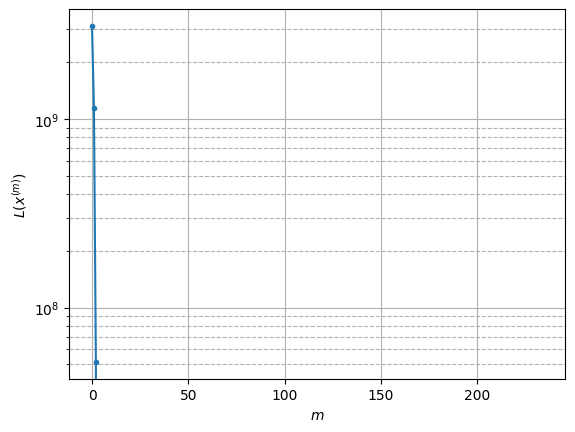

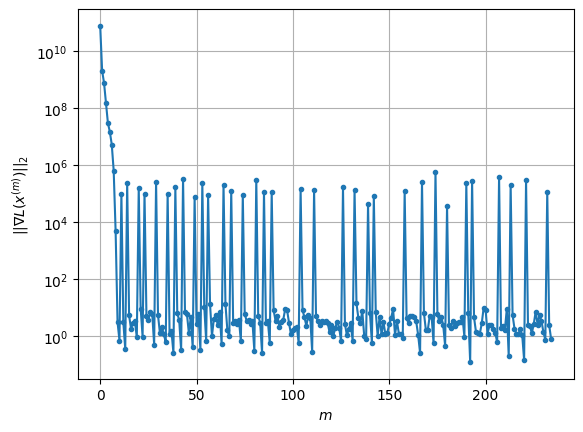

Windows:  11%|█▏        | 34/296 [06:19<50:29, 11.56s/it]  

Before applying the algorithm
Cost function: -23635106.552759014
Gradient norm: 105277.626918897
Global relative error: 1.2215706915574611
Position relative errors: 0.028526825904200834 m, 0.9332547025079401 m, 0.6524084122068471 m, 0.44138406916058737 m

Iteration 1
Cost function: -23635107.1458264 (-0.00%)
Gradient norm: 2.9624953633278532 (-100.00%)
Global relative error: 1.1603063686070643 (-5.02%)
Position relative errors: 0.046213051756578166 m, 0.9389935850440261 m, 0.5607310239636233 m, 0.3847684191829237 m

STOP on Iteration 2
Cost function = -23635107.145826276 (0.00%)
Gradient norm = 0.7889993994274466 (-73.37%)
Global relative error = 1.1603117537044918 (0.00%)
Final position relative errors: 0.046213054390768483 m, 0.938995660005707 m, 0.5607359015982212 m, 0.38477248608612813 m



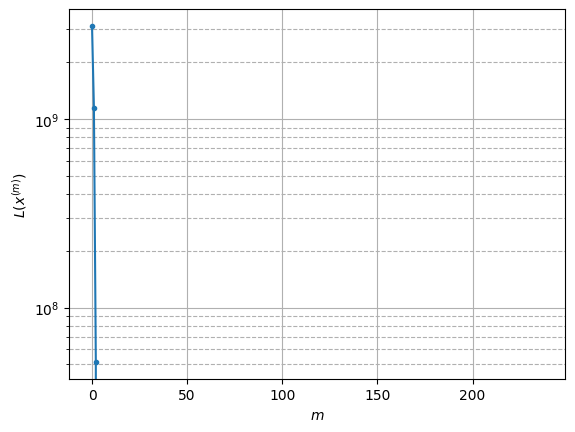

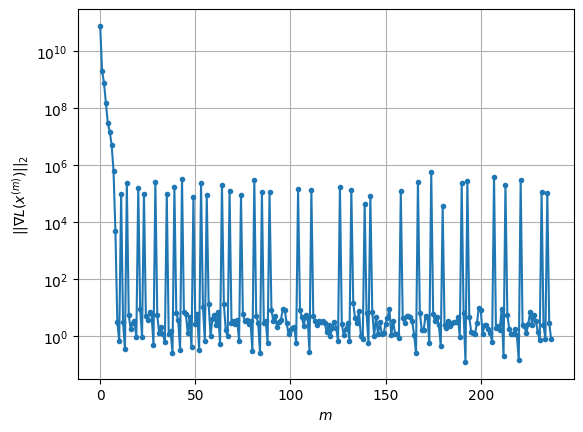

Windows:  12%|█▏        | 35/296 [06:24<41:55,  9.64s/it]

Before applying the algorithm
Cost function: -23635107.55726802
Gradient norm: 197335.66895996028
Global relative error: 1.1683189136494747
Position relative errors: 0.04483117685007382 m, 0.9447723275154608 m, 0.5653591898720595 m, 0.38824384170836673 m

Iteration 1
Cost function: -23635108.33931029 (-0.00%)
Gradient norm: 3.35325925064843 (-100.00%)
Global relative error: 1.0727436930516567 (-8.18%)
Position relative errors: 0.03235605155385068 m, 0.867851258608707 m, 0.5673596775087619 m, 0.2732565182343259 m

Iteration 2
Cost function: -23635108.33931047 (-0.00%)
Gradient norm: 2.545196682142624 (-24.10%)
Global relative error: 1.0727711497741321 (0.00%)
Position relative errors: 0.03235605482542226 m, 0.867871572131787 m, 0.5673725887009611 m, 0.27327298429630176 m

Iteration 3
Cost function: -23635108.33931027 (0.00%)
Gradient norm: 3.5626669172721024 (39.98%)
Global relative error: 1.0727711579272146 (0.00%)
Position relative errors: 0.03235605689105314 m, 0.8678715762358229 m, 

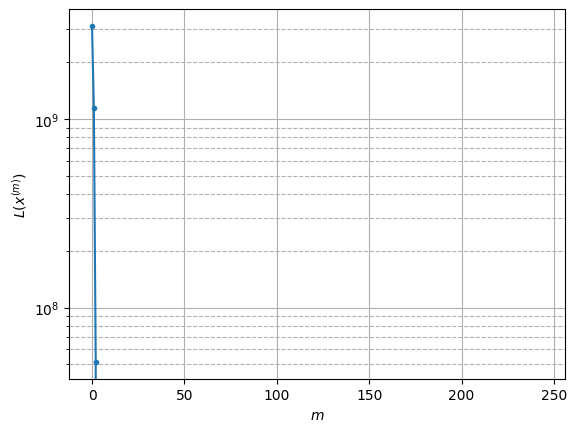

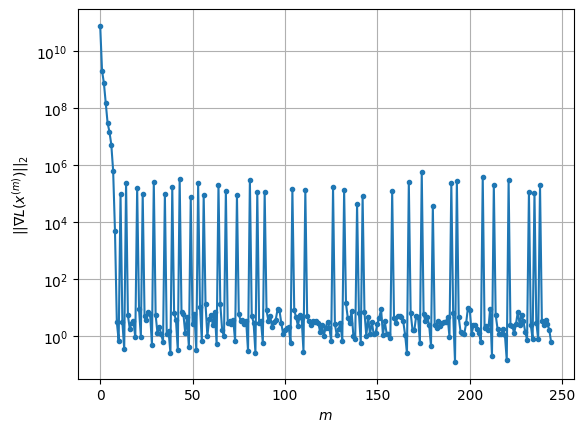

Windows:  12%|█▏        | 36/296 [06:35<44:06, 10.18s/it]

Before applying the algorithm
Cost function: -23635114.771501113
Gradient norm: 64229.368424649314
Global relative error: 1.0813472638171486
Position relative errors: 0.03141271115488408 m, 0.8673597015056714 m, 0.5769048581954969 m, 0.2884318449064466 m

Iteration 1
Cost function: -23635115.25900191 (-0.00%)
Gradient norm: 4.437060646267659 (-99.99%)
Global relative error: 1.0035497258731192 (-7.19%)
Position relative errors: 0.01537963961299977 m, 0.8032642489784909 m, 0.5878182379092008 m, 0.1269316784867053 m

STOP on Iteration 2
Cost function = -23635115.259002104 (-0.00%)
Gradient norm = 0.897753393081778 (-79.77%)
Global relative error = 1.0035692905807807 (0.00%)
Final position relative errors: 0.015379642676479633 m, 0.8032795647537223 m, 0.5878267189126677 m, 0.12695016144286383 m



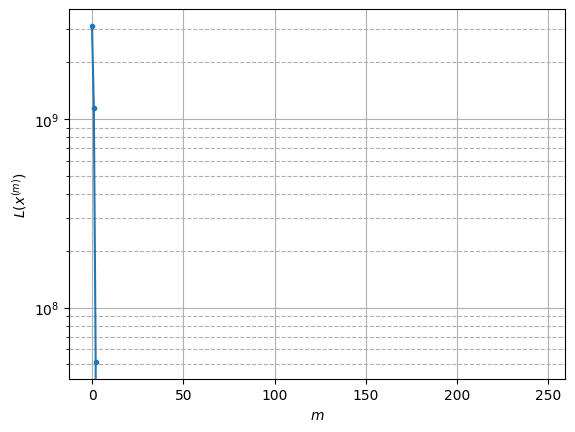

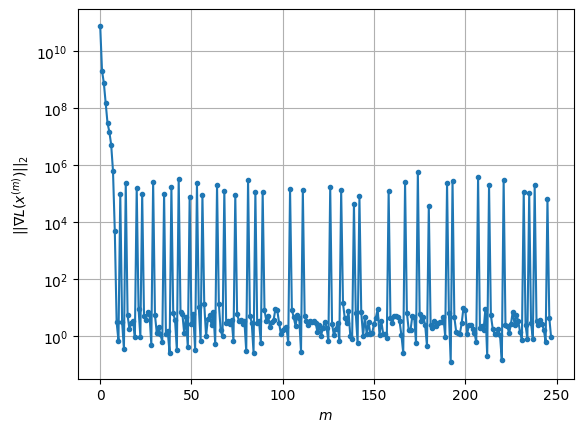

Windows:  12%|█▎        | 37/296 [06:40<37:14,  8.63s/it]

Before applying the algorithm
Cost function: -23635121.58805617
Gradient norm: 55713.59163472512
Global relative error: 1.001856325123609
Position relative errors: 0.01487697066907611 m, 0.7948527639203851 m, 0.5942764421447438 m, 0.1361588732911996 m

Iteration 1
Cost function: -23635121.849213343 (-0.00%)
Gradient norm: 4.279947860137242 (-99.99%)
Global relative error: 1.0639486531217728 (6.20%)
Position relative errors: 0.009531817774720954 m, 0.8377986169114208 m, 0.5745342861270811 m, 0.3160689998261463 m

STOP on Iteration 2
Cost function = -23635121.849213574 (-0.00%)
Gradient norm = 0.8315039390133177 (-80.57%)
Global relative error = 1.0639452522269597 (-0.00%)
Final position relative errors: 0.009531819217360219 m, 0.8377949542483683 m, 0.5745301207126674 m, 0.31607483187720836 m



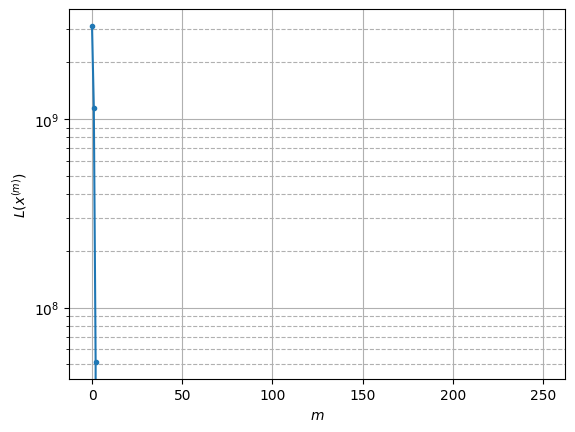

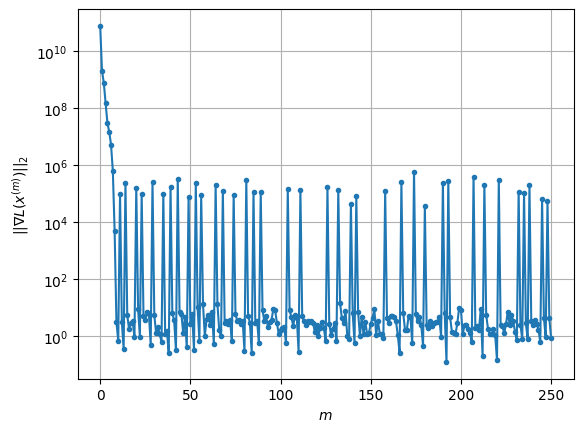

Windows:  13%|█▎        | 38/296 [06:45<32:27,  7.55s/it]

Before applying the algorithm
Cost function: -23635130.508950528
Gradient norm: 164924.49313310205
Global relative error: 1.059224826583139
Position relative errors: 0.009356852391220848 m, 0.8270460923575137 m, 0.5773393592924648 m, 0.3233320378358048 m

Iteration 1
Cost function: -23635131.207845073 (-0.00%)
Gradient norm: 3.009951612467849 (-100.00%)
Global relative error: 1.0224220577382004 (-3.47%)
Position relative errors: 0.012549142535294565 m, 0.8306412959976247 m, 0.5660873398990557 m, 0.18646539993086997 m

STOP on Iteration 2
Cost function = -23635131.207845047 (0.00%)
Gradient norm = 0.7568831735579282 (-74.85%)
Global relative error = 1.0224428610377205 (0.00%)
Final position relative errors: 0.012549146400457045 m, 0.8306548689174824 m, 0.5660996789341753 m, 0.18648154460092323 m



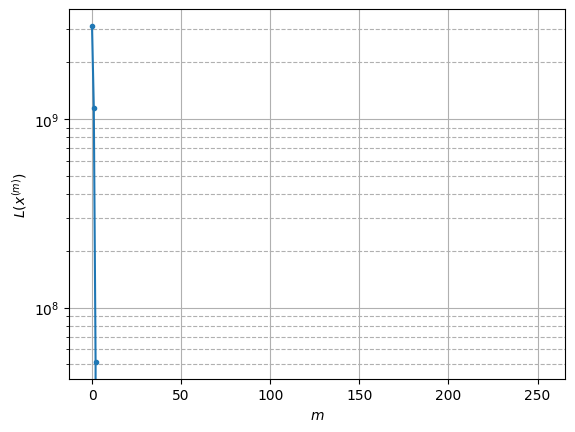

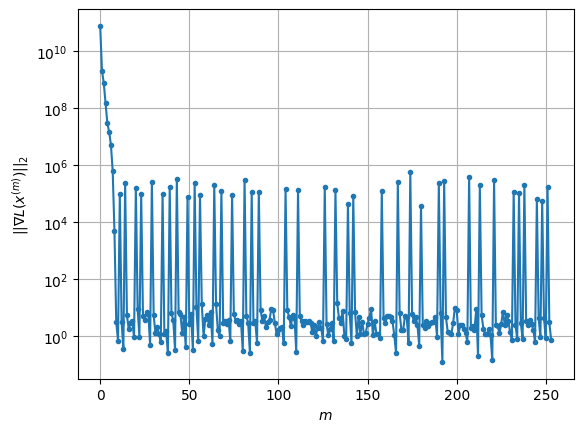

Windows:  13%|█▎        | 39/296 [06:50<29:12,  6.82s/it]

Before applying the algorithm
Cost function: -23635124.107675634
Gradient norm: 337809.7767462796
Global relative error: 1.011311029162977
Position relative errors: 0.012206986616553492 m, 0.8151530232819632 m, 0.5658217424402192 m, 0.19486429044484466 m

Iteration 1
Cost function: -23635124.57888982 (-0.00%)
Gradient norm: 8.394214623204144 (-100.00%)
Global relative error: 1.0951587159778715 (8.29%)
Position relative errors: 0.012874226212513868 m, 0.8017374278997804 m, 0.6288615729342371 m, 0.4011942869424308 m

STOP on Iteration 2
Cost function = -23635124.578889795 (0.00%)
Gradient norm = 0.6759835808205462 (-91.95%)
Global relative error = 1.0951596311796845 (0.00%)
Final position relative errors: 0.012874225003702361 m, 0.8017365842465286 m, 0.6288622357591164 m, 0.40119743221228704 m



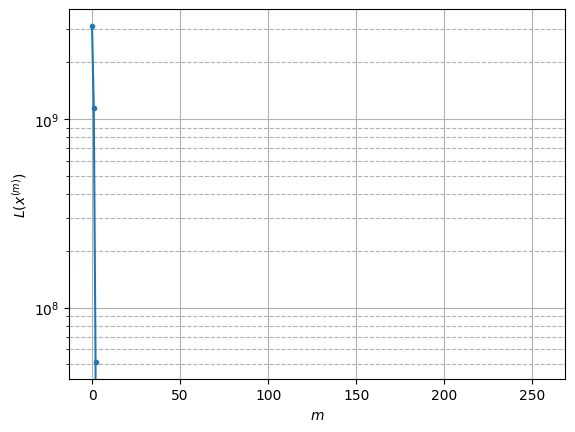

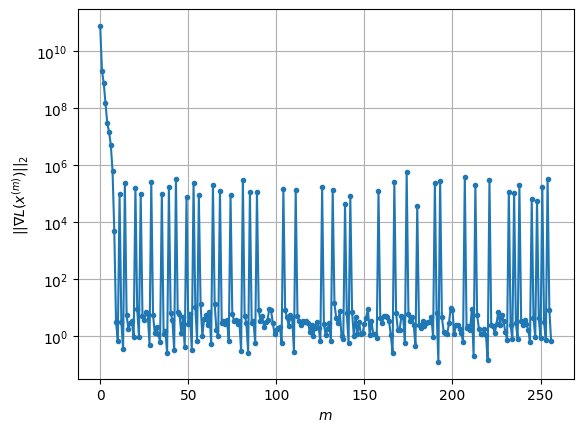

Windows:  14%|█▎        | 40/296 [06:55<26:41,  6.25s/it]

Before applying the algorithm
Cost function: -23635133.395447463
Gradient norm: 194818.90975028297
Global relative error: 1.0795500768845139
Position relative errors: 0.012486974300845359 m, 0.7823654586140338 m, 0.625686960072654 m, 0.40210984122413856 m

Iteration 1
Cost function: -23635133.827914 (-0.00%)
Gradient norm: 1.885605991501557 (-100.00%)
Global relative error: 1.1774193696707498 (9.07%)
Position relative errors: 0.013151948941504555 m, 0.8095783153096193 m, 0.7096606969729036 m, 0.4765580865629287 m

STOP on Iteration 2
Cost function = -23635133.827914 (0.00%)
Gradient norm = 0.38264780649181696 (-79.71%)
Global relative error = 1.1774309626015498 (0.00%)
Final position relative errors: 0.013151946763434614 m, 0.8095854228368602 m, 0.7096675994799908 m, 0.4765643758904044 m



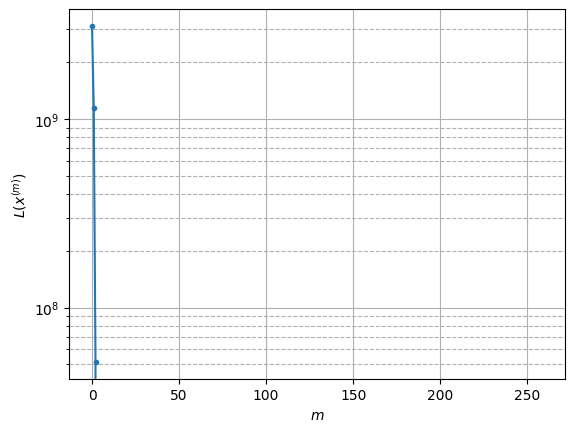

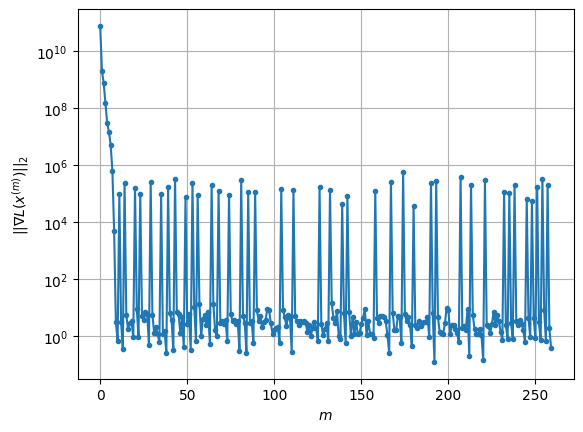

Windows:  14%|█▍        | 41/296 [07:00<24:59,  5.88s/it]

Before applying the algorithm
Cost function: -23635129.59169819
Gradient norm: 178123.33548084786
Global relative error: 1.1543944659799765
Position relative errors: 0.012526196661741925 m, 0.7847438938224203 m, 0.7008109298270471 m, 0.4748792563235343 m

Iteration 1
Cost function: -23635129.955023788 (-0.00%)
Gradient norm: 5.312335360042536 (-100.00%)
Global relative error: 1.3389016522111528 (15.98%)
Position relative errors: 0.011106035882095638 m, 0.8814187386875707 m, 0.7904714266933203 m, 0.6251318104573789 m

Iteration 2
Cost function: -23635129.955024038 (-0.00%)
Gradient norm: 3.986023156307505 (-24.97%)
Global relative error: 1.3389322998557982 (0.00%)
Position relative errors: 0.011106035622431468 m, 0.8814420090766223 m, 0.7904851517367568 m, 0.6251472855305281 m

Iteration 3
Cost function: -23635129.955023505 (0.00%)
Gradient norm: 3.112577547932937 (-21.91%)
Global relative error: 1.3389322941442965 (-0.00%)
Position relative errors: 0.011106040013784178 m, 0.88144200169

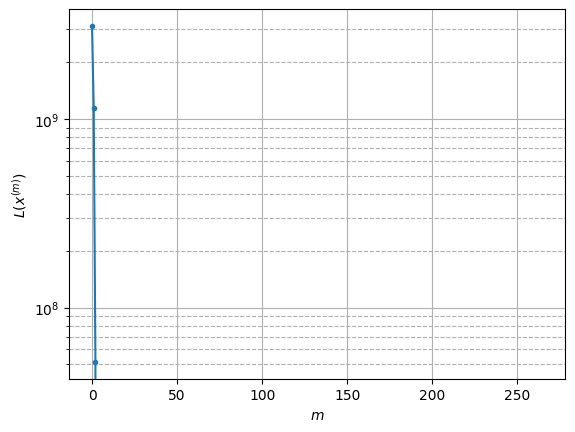

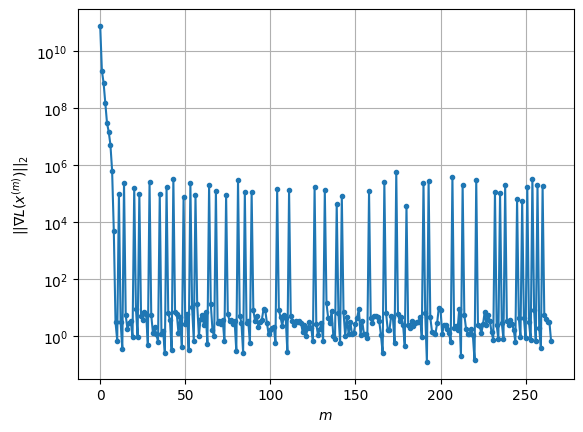

Windows:  14%|█▍        | 42/296 [07:10<29:39,  7.01s/it]

Before applying the algorithm
Cost function: -23635135.84324659
Gradient norm: 175769.76431674534
Global relative error: 1.3148651638762847
Position relative errors: 0.010600551786392088 m, 0.858005045717156 m, 0.7792758540669095 m, 0.6207367152517168 m

Iteration 1
Cost function: -23635136.363001302 (-0.00%)
Gradient norm: 2.3995798964934743 (-100.00%)
Global relative error: 1.3487615726611557 (2.58%)
Position relative errors: 0.028655721995776037 m, 0.9163914757112777 m, 0.8318388467065473 m, 0.5353569768508334 m

Iteration 2
Cost function: -23635136.36300141 (-0.00%)
Gradient norm: 2.7380193636593684 (14.10%)
Global relative error: 1.348766641943289 (0.00%)
Position relative errors: 0.02865571796783001 m, 0.9163936219963625 m, 0.8318404617515547 m, 0.5353635650945168 m

STOP on Iteration 3
Cost function = -23635136.36300138 (0.00%)
Gradient norm = 0.6569067372946773 (-76.01%)
Global relative error = 1.3487666453753058 (0.00%)
Final position relative errors: 0.02865572008453948 m, 0.

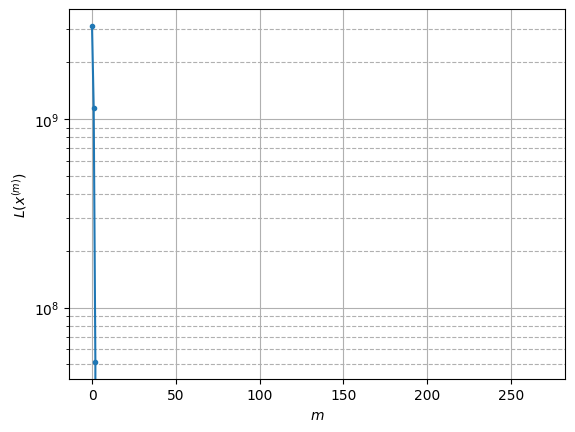

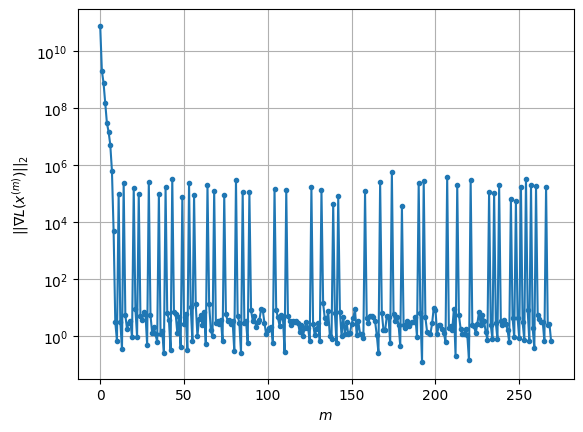

Windows:  15%|█▍        | 43/296 [07:17<29:05,  6.90s/it]

Before applying the algorithm
Cost function: -23635143.82087829
Gradient norm: 118737.76469486157
Global relative error: 1.3232796757712242
Position relative errors: 0.027628257535537156 m, 0.8917365865300316 m, 0.8210101393079251 m, 0.5301449122151647 m

STOP on Iteration 1
Cost function = -23635144.00781425 (-0.00%)
Gradient norm = 0.5386205183239593 (-100.00%)
Global relative error = 1.4403769892792113 (8.85%)
Final position relative errors: 0.024124726771341597 m, 0.9573552841442247 m, 0.8644971340290513 m, 0.6404834189211239 m



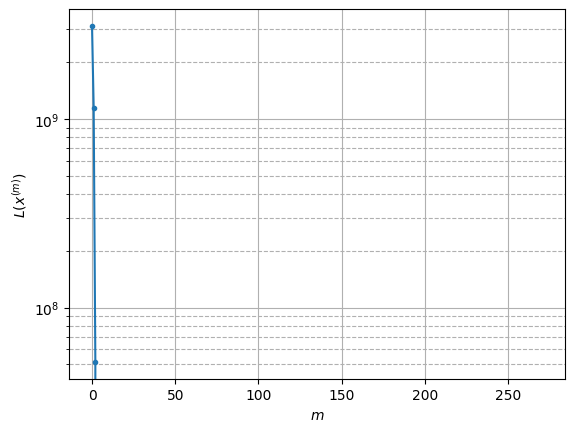

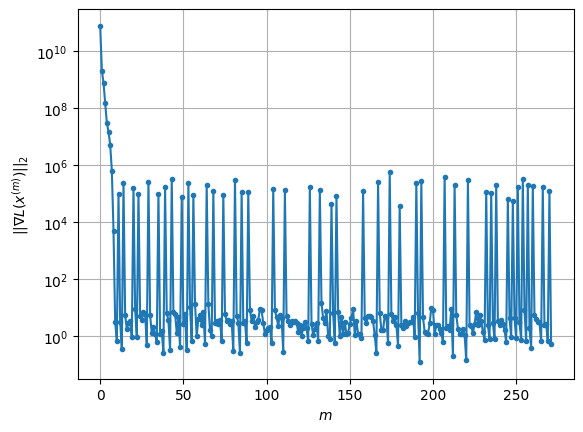

Windows:  15%|█▍        | 44/296 [07:20<24:40,  5.87s/it]

Before applying the algorithm
Cost function: -23635143.7826674
Gradient norm: 63226.95385788724
Global relative error: 1.4098865858082539
Position relative errors: 0.023202324129721036 m, 0.9298409808977258 m, 0.8499408558382966 m, 0.6326433968663104 m

Iteration 1
Cost function: -23635144.076180246 (-0.00%)
Gradient norm: 1.1294893423174202 (-100.00%)
Global relative error: 1.5126266353014057 (7.29%)
Position relative errors: 0.023179852653128608 m, 1.0260361226634906 m, 0.8721390379617469 m, 0.6885671980083975 m

Iteration 2
Cost function: -23635144.076180212 (0.00%)
Gradient norm: 1.0885969029197036 (-3.62%)
Global relative error: 1.512593020379101 (-0.00%)
Position relative errors: 0.02317985883563053 m, 1.026009847370392 m, 0.8721253526707748 m, 0.6885498400505421 m

Iteration 3
Cost function: -23635144.076180197 (0.00%)
Gradient norm: 1.3580065376200474 (24.75%)
Global relative error: 1.5125930205971279 (0.00%)
Position relative errors: 0.023179858881593556 m, 1.026009847568361 m

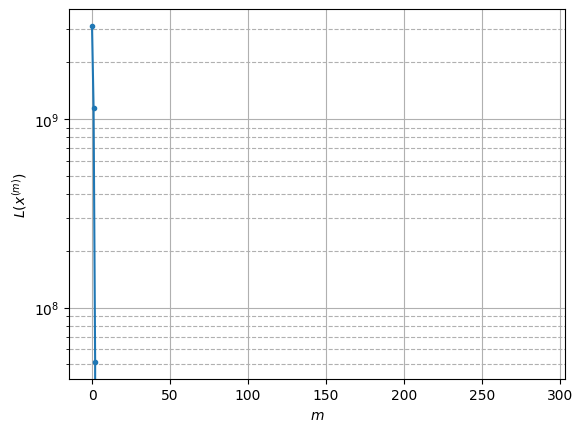

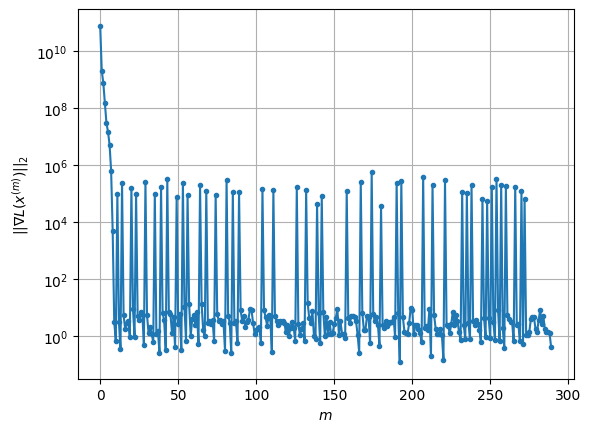

Windows:  15%|█▌        | 45/296 [07:48<52:39, 12.59s/it]

Before applying the algorithm
Cost function: -23635142.685468882
Gradient norm: 26636.013708300154
Global relative error: 1.4760245677204684
Position relative errors: 0.022180772839224056 m, 0.9940920616125108 m, 0.8529492706660587 m, 0.6800105940752815 m

Iteration 1
Cost function: -23635142.845516365 (-0.00%)
Gradient norm: 3.5941097405163798 (-99.99%)
Global relative error: 1.5794870824662688 (7.01%)
Position relative errors: 0.025684134432725176 m, 1.0237776812269406 m, 0.8574701485207588 m, 0.8430559102870485 m

STOP on Iteration 2
Cost function = -23635142.845515765 (0.00%)
Gradient norm = 0.5809094742060054 (-83.84%)
Global relative error = 1.5794877179579558 (0.00%)
Final position relative errors: 0.025684152497572842 m, 1.0237774192401095 m, 0.8574694754604646 m, 0.8430581030593123 m



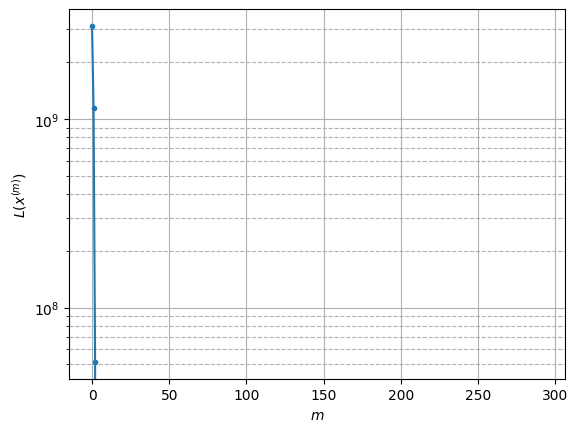

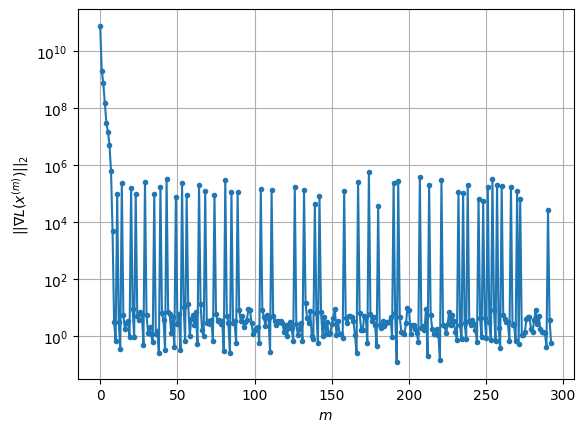

Windows:  16%|█▌        | 46/296 [07:53<43:07, 10.35s/it]

Before applying the algorithm
Cost function: -23635143.978679586
Gradient norm: 82252.94509541853
Global relative error: 1.5411910939727202
Position relative errors: 0.02454274230130321 m, 0.9892794691836879 m, 0.8368674989899964 m, 0.8340538530925143 m

Iteration 1
Cost function: -23635144.36290441 (-0.00%)
Gradient norm: 1.3571473913616217 (-100.00%)
Global relative error: 1.6599995860425487 (7.71%)
Position relative errors: 0.02842671783221837 m, 1.0551590433869955 m, 0.9633011649879992 m, 0.8446774667183671 m

STOP on Iteration 2
Cost function = -23635144.362904515 (-0.00%)
Gradient norm = 0.30069064722886685 (-77.84%)
Global relative error = 1.6600418502487815 (0.00%)
Final position relative errors: 0.028426718636523445 m, 1.0551876872162729 m, 0.9633212181553393 m, 0.8447018754322931 m



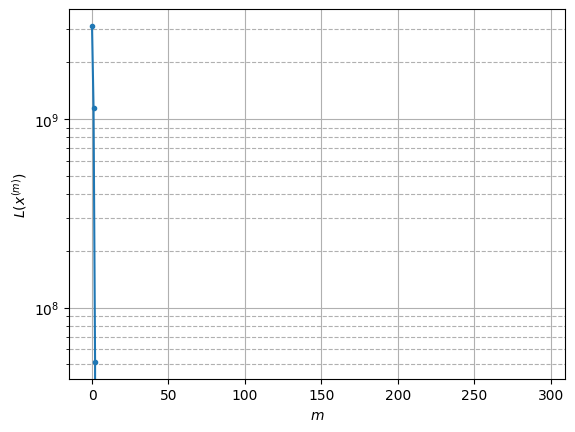

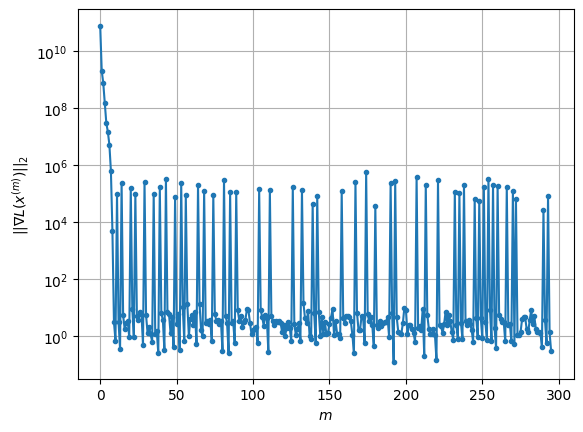

Windows:  16%|█▌        | 47/296 [07:59<37:10,  8.96s/it]

Before applying the algorithm
Cost function: -23635143.741973758
Gradient norm: 280768.7051377789
Global relative error: 1.615116976804342
Position relative errors: 0.02712734936100889 m, 1.0172066304381835 m, 0.9370858989285386 m, 0.8336826697389953 m

Iteration 1
Cost function: -23635144.103877068 (-0.00%)
Gradient norm: 5.397382843421851 (-100.00%)
Global relative error: 1.6716269629073388 (3.50%)
Position relative errors: 0.020490008115565887 m, 1.0267868835490963 m, 0.9724812820724648 m, 0.8910133949390806 m

Iteration 2
Cost function: -23635144.103877068 (0.00%)
Gradient norm: 3.959469916351531 (-26.64%)
Global relative error: 1.6716461510443166 (0.00%)
Position relative errors: 0.02049001006039995 m, 1.026798556819656 m, 0.9724917353726625 m, 0.8910245325549055 m

STOP on Iteration 3
Cost function = -23635144.103877008 (0.00%)
Gradient norm = 0.7543271689032907 (-80.95%)
Global relative error = 1.6716461426217337 (-0.00%)
Final position relative errors: 0.020490014556861832 m, 1

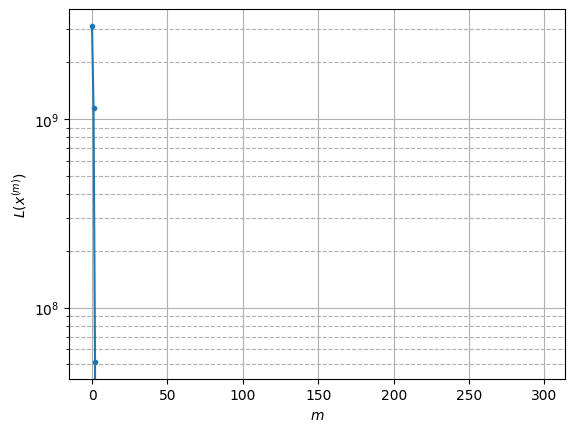

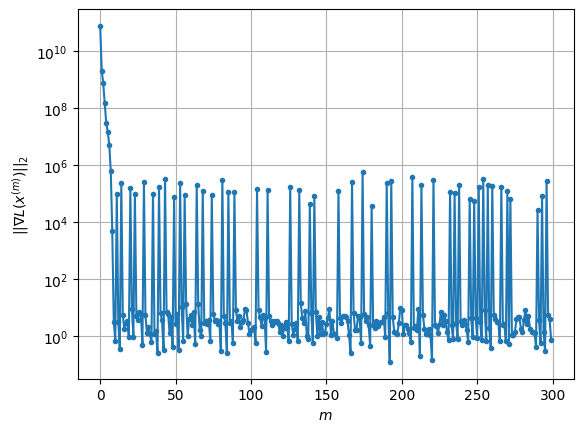

Windows:  16%|█▌        | 48/296 [08:08<36:43,  8.88s/it]

Before applying the algorithm
Cost function: -23635145.306555726
Gradient norm: 155364.20943912526
Global relative error: 1.6221553929223858
Position relative errors: 0.019568310659011014 m, 0.9843432428613877 m, 0.9441083670481677 m, 0.8779134470535905 m

Iteration 1
Cost function: -23635146.084199417 (-0.00%)
Gradient norm: 3.452233898162486 (-100.00%)
Global relative error: 1.6408237787913809 (1.15%)
Position relative errors: 0.009248779439158823 m, 0.9810189992883726 m, 1.0258289354295198 m, 0.8230995063936405 m

STOP on Iteration 2
Cost function = -23635146.08419947 (-0.00%)
Gradient norm = 0.8566621257939915 (-75.19%)
Global relative error = 1.6408349504945143 (0.00%)
Final position relative errors: 0.009248781963046451 m, 0.9810290495865945 m, 1.02583123312557 m, 0.8231069346323441 m



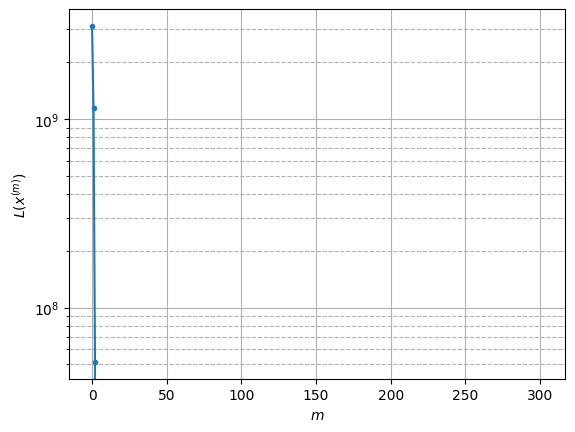

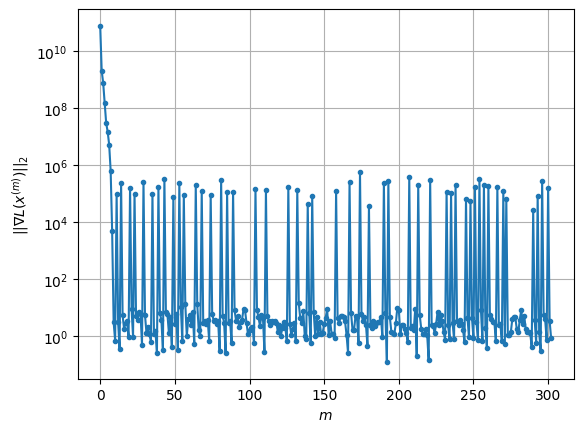

Windows:  17%|█▋        | 49/296 [08:14<33:52,  8.23s/it]

Before applying the algorithm
Cost function: -23635147.906347003
Gradient norm: 68391.77350471553
Global relative error: 1.5810758481705054
Position relative errors: 0.008778158750241852 m, 0.9365833951594194 m, 0.9906455089383343 m, 0.8007219205539662 m

Iteration 1
Cost function: -23635148.462926365 (-0.00%)
Gradient norm: 6.667047263648904 (-99.99%)
Global relative error: 1.4854300885701275 (-6.05%)
Position relative errors: 0.009919633329175899 m, 0.9025818187766169 m, 1.022384115632241 m, 0.5886249509575054 m

Iteration 2
Cost function: -23635148.462926254 (0.00%)
Gradient norm: 4.330940942605511 (-35.04%)
Global relative error: 1.4854529164790888 (0.00%)
Position relative errors: 0.009919622733354156 m, 0.9025983709103266 m, 1.022393527315494 m, 0.5886408308674151 m

Iteration 3
Cost function: -23635148.462926283 (-0.00%)
Gradient norm: 2.4645562867955926 (-43.09%)
Global relative error: 1.4854529242346153 (0.00%)
Position relative errors: 0.00991962556718325 m, 0.902598370510485

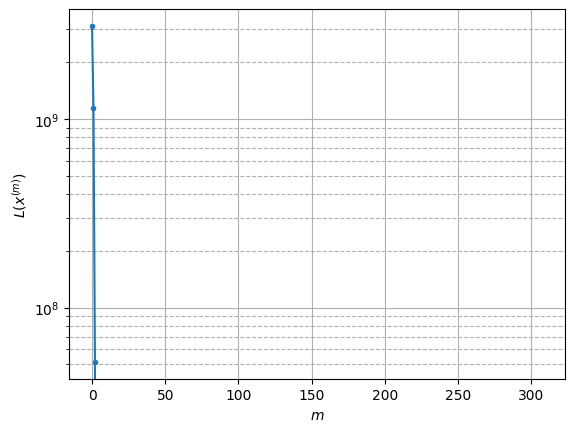

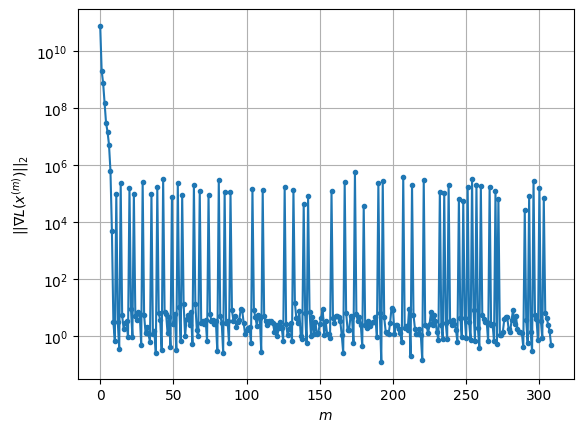

Windows:  17%|█▋        | 50/296 [08:26<37:13,  9.08s/it]

Before applying the algorithm
Cost function: -23635148.157332957
Gradient norm: 126293.64672555949
Global relative error: 1.4110122374420195
Position relative errors: 0.009547812597652885 m, 0.8511467767262624 m, 0.9783600427108972 m, 0.5560785961191886 m

Iteration 1
Cost function: -23635148.65632575 (-0.00%)
Gradient norm: 6.214188963269161 (-100.00%)
Global relative error: 1.6459524043888014 (16.65%)
Position relative errors: 0.0039815221765780754 m, 1.068090030835242 m, 1.1010882227715388 m, 0.5965988027245389 m

Iteration 2
Cost function: -23635148.656325765 (-0.00%)
Gradient norm: 2.0431595276408747 (-67.12%)
Global relative error: 1.6459141367045511 (-0.00%)
Position relative errors: 0.003981520100217294 m, 1.0680580662251493 m, 1.101073680012932 m, 0.5965772925514321 m

Iteration 3
Cost function: -23635148.656325426 (0.00%)
Gradient norm: 2.986275029467609 (46.16%)
Global relative error: 1.6459141394551944 (0.00%)
Position relative errors: 0.003981515781786215 m, 1.068058069591

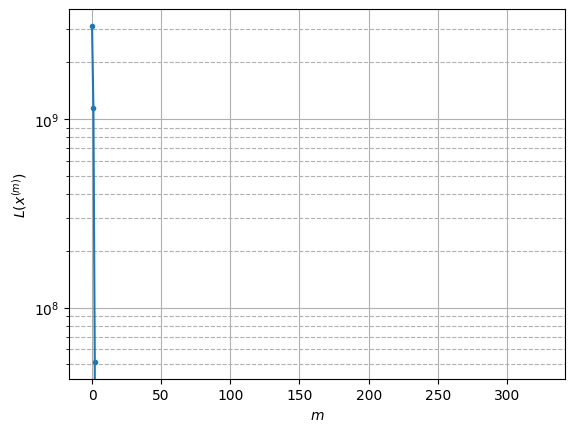

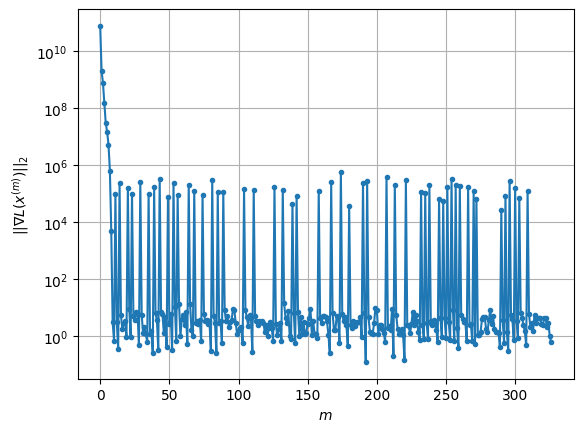

Windows:  17%|█▋        | 51/296 [08:57<1:04:31, 15.80s/it]

Before applying the algorithm
Cost function: -23635138.070332058
Gradient norm: 51626.27203675175
Global relative error: 1.566633936013216
Position relative errors: 0.00404567183835793 m, 1.011900762938082 m, 1.052459175164273 m, 0.5680758054173463 m

STOP on Iteration 1
Cost function = -23635138.608281847 (-0.00%)
Gradient norm = 0.8559567325688172 (-100.00%)
Global relative error = 1.4309832847938708 (-8.66%)
Final position relative errors: 0.01151402974059587 m, 0.9756281452528311 m, 0.8833953817069761 m, 0.561552700548759 m



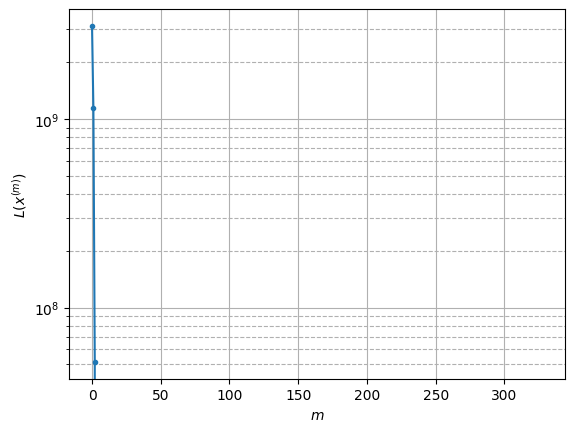

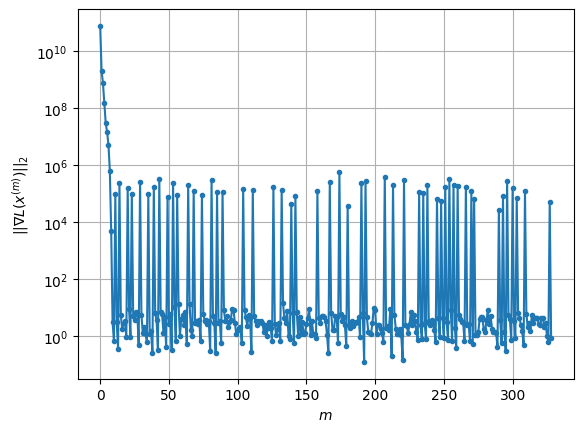

Windows:  18%|█▊        | 52/296 [09:01<49:31, 12.18s/it]  

Before applying the algorithm
Cost function: -23635138.993165188
Gradient norm: 81449.3665076971
Global relative error: 1.3584743406753101
Position relative errors: 0.01090880829820615 m, 0.9209149936543827 m, 0.8404092423334808 m, 0.5394068496034009 m

Iteration 1
Cost function: -23635139.09452823 (-0.00%)
Gradient norm: 4.421239895277371 (-99.99%)
Global relative error: 1.3964948261007122 (2.80%)
Position relative errors: 0.007971682870310616 m, 0.8860018843225943 m, 0.92649684181191 m, 0.5538382250562991 m

Iteration 2
Cost function: -23635139.09452849 (-0.00%)
Gradient norm: 2.9861277015272454 (-32.46%)
Global relative error: 1.396490970901568 (-0.00%)
Position relative errors: 0.007971670793449093 m, 0.8859981811621258 m, 0.9264961804047863 m, 0.553835534968628 m

STOP on Iteration 3
Cost function = -23635139.09452843 (0.00%)
Gradient norm = 0.20534043868065632 (-93.12%)
Global relative error = 1.3964909599911475 (-0.00%)
Final position relative errors: 0.007971683088311523 m, 0.8

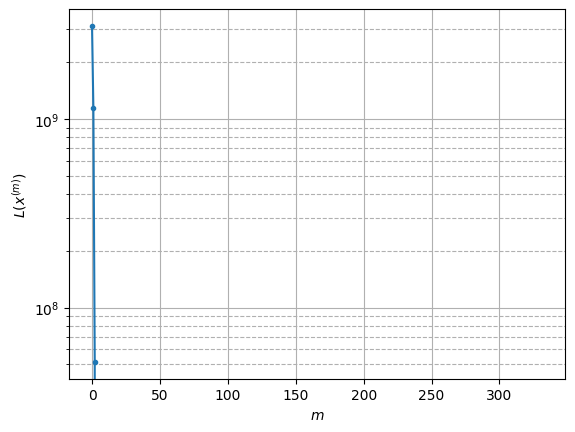

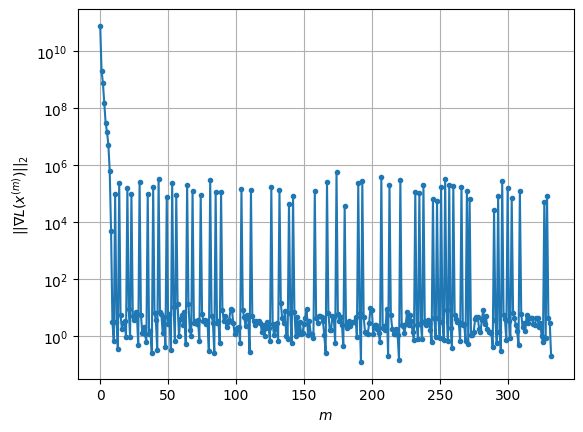

Windows:  18%|█▊        | 53/296 [09:08<43:46, 10.81s/it]

Before applying the algorithm
Cost function: -23635124.121584423
Gradient norm: 403330.7155586798
Global relative error: 1.3193304203936662
Position relative errors: 0.007558801372250907 m, 0.8281061644609163 m, 0.879920116716227 m, 0.5296739085726128 m

Iteration 1
Cost function: -23635125.35377555 (-0.00%)
Gradient norm: 5.806241379834106 (-100.00%)
Global relative error: 1.4755764411835133 (11.84%)
Position relative errors: 0.013069877861213396 m, 0.8130846756427393 m, 0.9573592523039991 m, 0.7742799497738908 m

Iteration 2
Cost function: -23635125.353775136 (0.00%)
Gradient norm: 4.913372640781944 (-15.38%)
Global relative error: 1.4755713601979328 (-0.00%)
Position relative errors: 0.013069875116344814 m, 0.8130861374780793 m, 0.9573580973883301 m, 0.774270159635811 m

STOP on Iteration 3
Cost function = -23635125.353775445 (-0.00%)
Gradient norm = 0.3471923806039848 (-92.93%)
Global relative error = 1.4755713516404367 (-0.00%)
Final position relative errors: 0.013069879041257063 

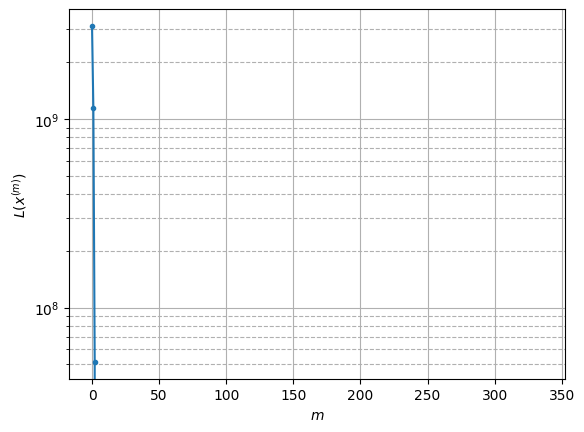

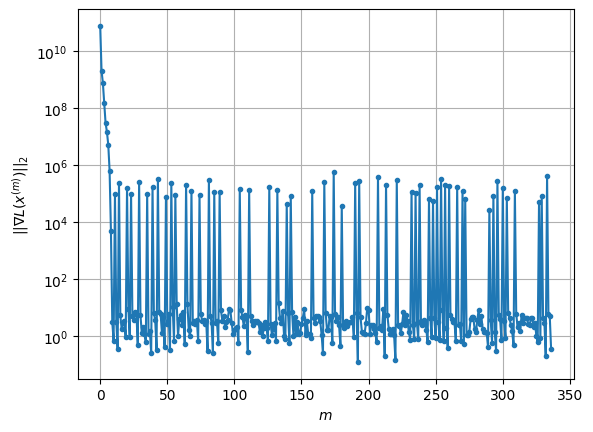

Windows:  18%|█▊        | 54/296 [09:16<39:32,  9.80s/it]

Before applying the algorithm
Cost function: -23635126.41573662
Gradient norm: 95213.89994445676
Global relative error: 1.390499073658779
Position relative errors: 0.012697790786229188 m, 0.7510449102269781 m, 0.9052606298724479 m, 0.7414572158032475 m

Iteration 1
Cost function: -23635126.858900845 (-0.00%)
Gradient norm: 1.2429759462581127 (-100.00%)
Global relative error: 1.372715510967132 (-1.28%)
Position relative errors: 0.017947847166754786 m, 0.6381153405602049 m, 0.933193267352793 m, 0.7784489618303294 m

Iteration 2
Cost function: -23635126.858900372 (0.00%)
Gradient norm: 3.0118229124589107 (142.31%)
Global relative error: 1.3726712023174288 (-0.00%)
Position relative errors: 0.017947838227555586 m, 0.6380784182265955 m, 0.93317517209894 m, 0.778422786543222 m

STOP on Iteration 3
Cost function = -23635126.858900093 (0.00%)
Gradient norm = 0.9095932233899262 (-69.80%)
Global relative error = 1.372671198187936 (-0.00%)
Final position relative errors: 0.017947844758805634 m, 0

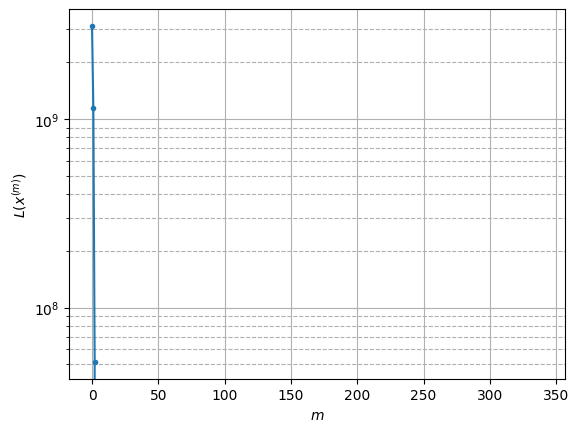

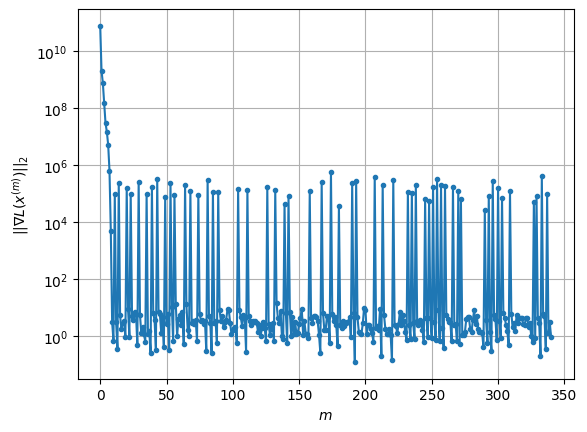

Windows:  19%|█▊        | 55/296 [09:23<36:27,  9.08s/it]

Before applying the algorithm
Cost function: -23635133.978387963
Gradient norm: 71517.83260283971
Global relative error: 1.2975210804897537
Position relative errors: 0.017510276696332792 m, 0.5826146465355806 m, 0.8841716599564232 m, 0.7497017173725895 m

Iteration 1
Cost function: -23635134.83623829 (-0.00%)
Gradient norm: 3.172703504853299 (-100.00%)
Global relative error: 1.0723779894430197 (-17.35%)
Position relative errors: 0.03390732256843638 m, 0.4905950998016852 m, 0.7145507743984112 m, 0.6305367881714597 m

Iteration 2
Cost function: -23635134.836237997 (0.00%)
Gradient norm: 6.604478762468698 (108.17%)
Global relative error: 1.0722898507424923 (-0.01%)
Position relative errors: 0.03390731319300345 m, 0.4905333662739891 m, 0.7145069217387612 m, 0.6304846154091353 m

Iteration 3
Cost function: -23635134.83623828 (-0.00%)
Gradient norm: 4.318680604009336 (-34.61%)
Global relative error: 1.072289845234779 (-0.00%)
Position relative errors: 0.03390732171503459 m, 0.490533353896425

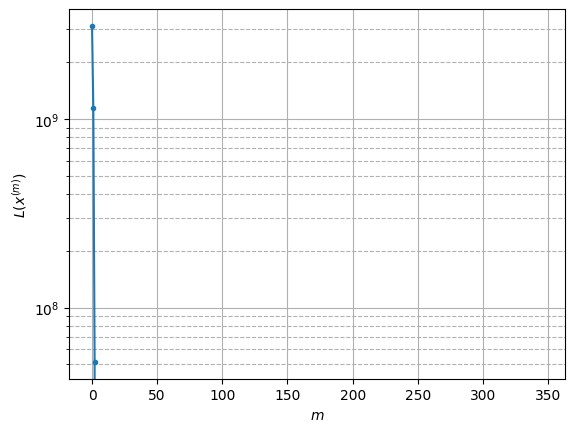

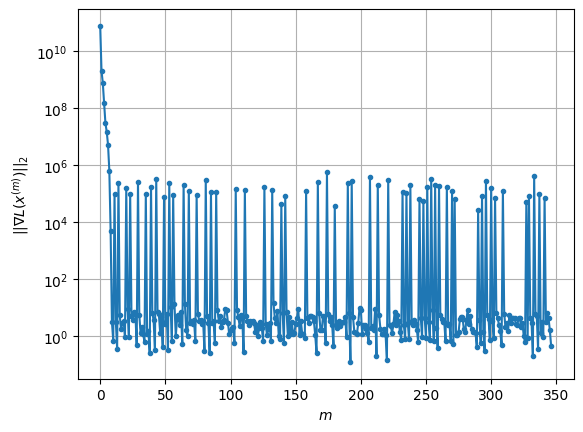

Windows:  19%|█▉        | 56/296 [09:33<37:19,  9.33s/it]

Before applying the algorithm
Cost function: -23635133.2002824
Gradient norm: 136100.18166323545
Global relative error: 1.017175446843011
Position relative errors: 0.03324835668514523 m, 0.45170620303842934 m, 0.6762824701045625 m, 0.6100343911711961 m

Iteration 1
Cost function: -23635133.518744327 (-0.00%)
Gradient norm: 2.4202079207734655 (-100.00%)
Global relative error: 0.8824032772341484 (-13.25%)
Position relative errors: 0.04196085598300044 m, 0.43124398337626185 m, 0.6018513998400573 m, 0.4782011839930685 m

STOP on Iteration 2
Cost function = -23635133.51874398 (0.00%)
Gradient norm = 0.3483967339600315 (-85.60%)
Global relative error = 0.8824117011158379 (0.00%)
Final position relative errors: 0.041960855458224595 m, 0.4312478976962957 m, 0.6018576348341753 m, 0.4782053510787132 m



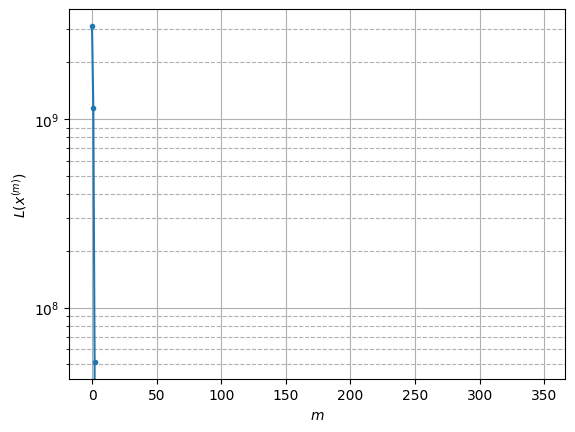

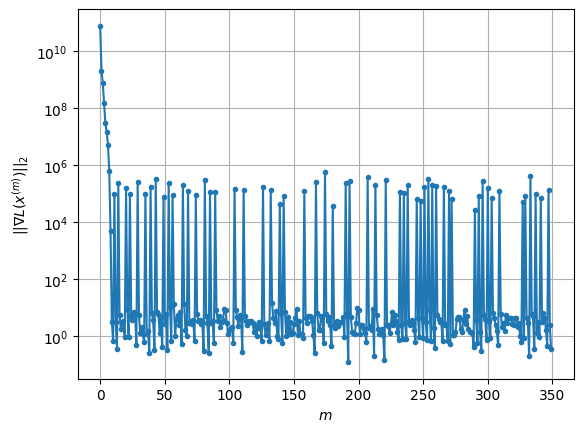

Windows:  19%|█▉        | 57/296 [09:38<32:17,  8.11s/it]

Before applying the algorithm
Cost function: -23635135.23418895
Gradient norm: 211617.14403724938
Global relative error: 0.8413937851022252
Position relative errors: 0.040819802310680914 m, 0.41204311895727397 m, 0.5675751414169197 m, 0.4629838861902321 m

Iteration 1
Cost function: -23635135.845511813 (-0.00%)
Gradient norm: 2.374167964648409 (-100.00%)
Global relative error: 0.923790527897605 (9.79%)
Position relative errors: 0.04156818866714727 m, 0.45729916749734606 m, 0.5844995762576429 m, 0.5485407961954402 m

Iteration 2
Cost function: -23635135.845511302 (0.00%)
Gradient norm: 1.3224161111593282 (-44.30%)
Global relative error: 0.9237825941796063 (-0.00%)
Position relative errors: 0.04156818721128008 m, 0.45729175231585184 m, 0.58449787092183 m, 0.5485354341254115 m

Iteration 3
Cost function: -23635135.84551192 (-0.00%)
Gradient norm: 4.443225187776477 (235.99%)
Global relative error: 0.9237825841292804 (-0.00%)
Position relative errors: 0.041568192615187995 m, 0.4572917494070

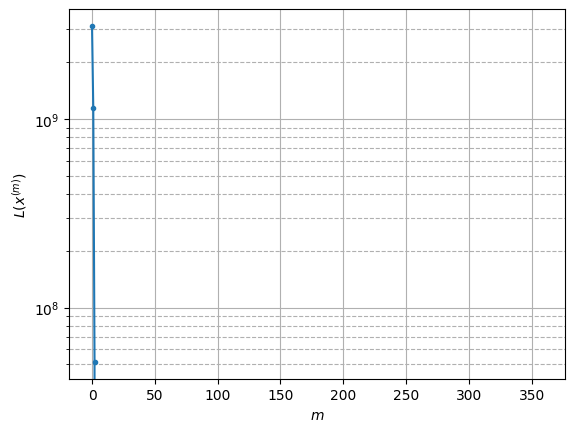

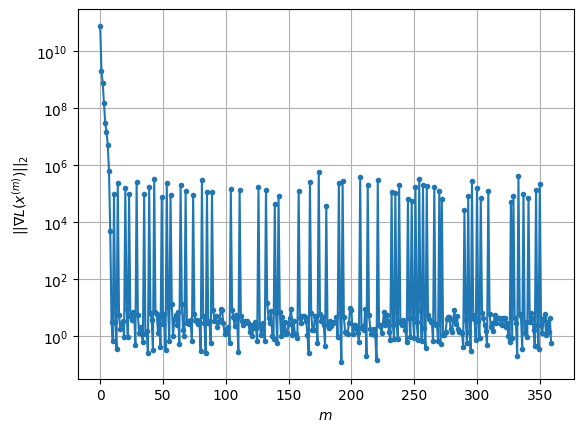

Windows:  20%|█▉        | 58/296 [09:55<41:41, 10.51s/it]

Before applying the algorithm
Cost function: -23635126.75810028
Gradient norm: 88704.90868244917
Global relative error: 0.8894400281410636
Position relative errors: 0.04040913679848107 m, 0.4344912651880308 m, 0.5596006985679299 m, 0.5362212356614217 m

Iteration 1
Cost function: -23635127.143313088 (-0.00%)
Gradient norm: 1.5408515394833744 (-100.00%)
Global relative error: 0.9191277352586112 (3.34%)
Position relative errors: 0.02291494539696352 m, 0.43897716821954785 m, 0.5882868306051139 m, 0.5527083959740432 m

Iteration 2
Cost function: -23635127.143314037 (-0.00%)
Gradient norm: 1.7999558371986955 (16.82%)
Global relative error: 0.9191301652718115 (0.00%)
Position relative errors: 0.022914949627672626 m, 0.43897872978273766 m, 0.588287982758463 m, 0.5527099702305163 m

Iteration 3
Cost function: -23635127.143313356 (0.00%)
Gradient norm: 2.0389042518836122 (13.28%)
Global relative error: 0.9191301694041126 (0.00%)
Position relative errors: 0.02291494212633438 m, 0.438978734766249

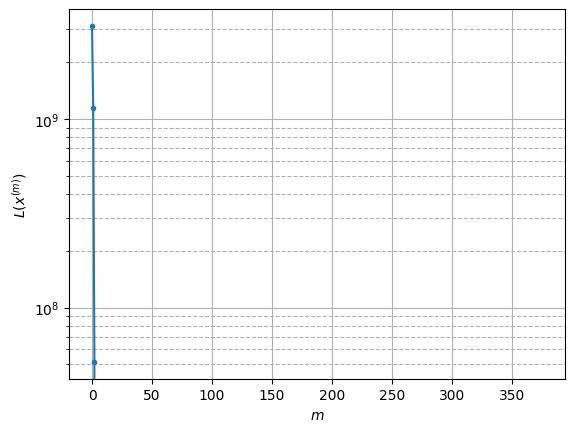

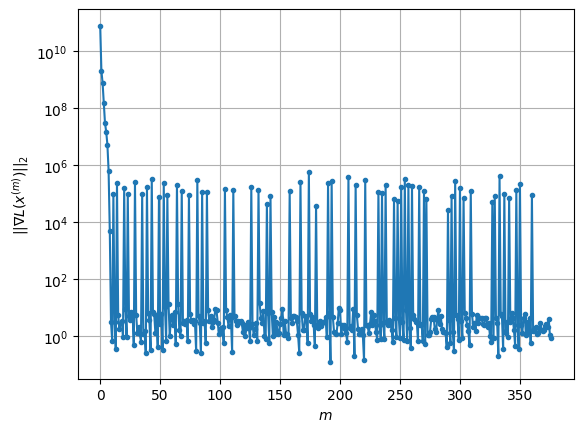

Windows:  20%|█▉        | 59/296 [10:21<1:00:43, 15.37s/it]

Before applying the algorithm
Cost function: -23635121.247861367
Gradient norm: 84617.80953221573
Global relative error: 0.8934866023991314
Position relative errors: 0.02249878401827865 m, 0.42582845023757193 m, 0.5672956890065513 m, 0.5428222246720387 m

Iteration 1
Cost function: -23635121.48843623 (-0.00%)
Gradient norm: 4.477263552227149 (-99.99%)
Global relative error: 1.1911541365080611 (33.32%)
Position relative errors: 0.0178670185660253 m, 0.5789804975696424 m, 0.7158037290305123 m, 0.755601410483411 m

Iteration 2
Cost function: -23635121.48843669 (-0.00%)
Gradient norm: 6.9162303239104235 (54.47%)
Global relative error: 1.191162899725173 (0.00%)
Position relative errors: 0.0178670151785996 m, 0.5789840992495904 m, 0.7158108934582326 m, 0.7556056783058197 m

Iteration 3
Cost function: -23635121.488435995 (0.00%)
Gradient norm: 3.6788912559012705 (-46.81%)
Global relative error: 1.1911629182569996 (0.00%)
Position relative errors: 0.017867013019523776 m, 0.5789841003232438 m, 

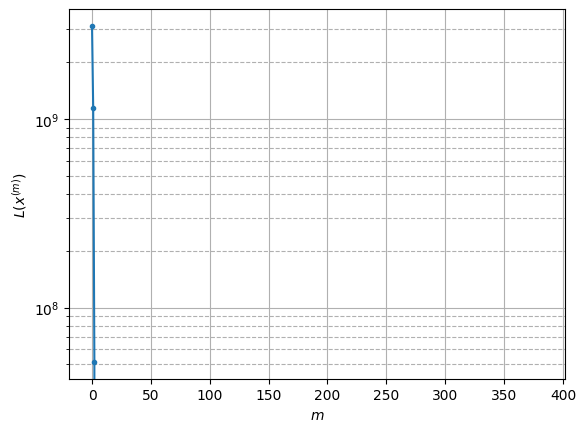

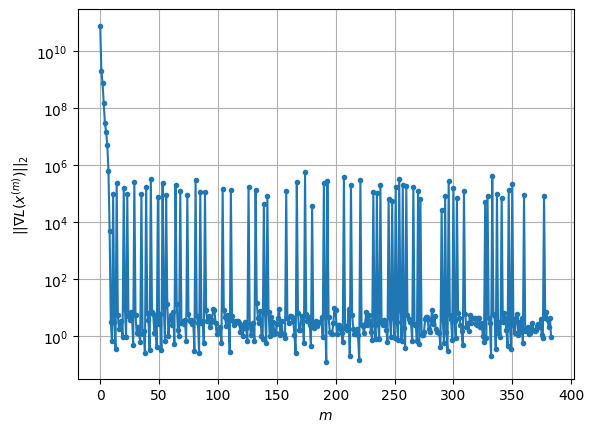

Windows:  20%|██        | 60/296 [10:33<55:53, 14.21s/it]  

Before applying the algorithm
Cost function: -23635119.548361942
Gradient norm: 249589.81068751978
Global relative error: 1.1519315454189116
Position relative errors: 0.017489162175530187 m, 0.5494083703306629 m, 0.6886037962719677 m, 0.7420333248282329 m

Iteration 1
Cost function: -23635120.030689415 (-0.00%)
Gradient norm: 2.2186878831198733 (-100.00%)
Global relative error: 1.10570859521186 (-4.01%)
Position relative errors: 0.028457419758939555 m, 0.5757729331920813 m, 0.6076115905829287 m, 0.7218537256380433 m

Iteration 2
Cost function: -23635120.030689925 (-0.00%)
Gradient norm: 4.630210797066785 (108.69%)
Global relative error: 1.1057105643546412 (0.00%)
Position relative errors: 0.028457423698142723 m, 0.5757712099379354 m, 0.6076141773467785 m, 0.7218559388906973 m

Iteration 3
Cost function: -23635120.030690167 (-0.00%)
Gradient norm: 2.1032253342973934 (-54.58%)
Global relative error: 1.1057105830890763 (0.00%)
Position relative errors: 0.028457420238321002 m, 0.5757712129

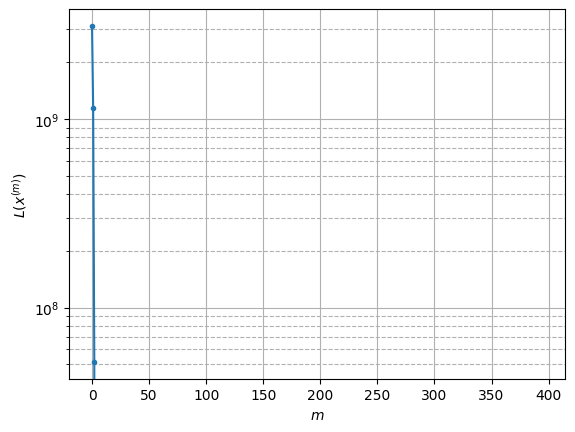

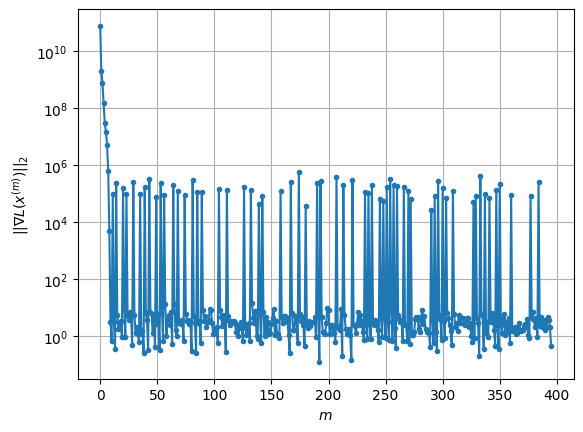

Windows:  21%|██        | 61/296 [10:52<1:01:19, 15.66s/it]

Before applying the algorithm
Cost function: -23635117.07113083
Gradient norm: 106007.54237614413
Global relative error: 1.0656658575669642
Position relative errors: 0.02729642755884934 m, 0.5492482753912897 m, 0.5858307008481831 m, 0.7000175998421324 m

Iteration 1
Cost function: -23635117.328064818 (-0.00%)
Gradient norm: 3.372096676760895 (-100.00%)
Global relative error: 1.076815494110663 (1.05%)
Position relative errors: 0.030719290957693914 m, 0.4783117678039883 m, 0.600022789758078 m, 0.754835004539317 m

STOP on Iteration 2
Cost function = -23635117.32806492 (-0.00%)
Gradient norm = 0.7544160777886595 (-77.63%)
Global relative error = 1.076817778485792 (0.00%)
Final position relative errors: 0.030719296124624314 m, 0.47831616643100144 m, 0.6000244097510248 m, 0.7548341880941813 m



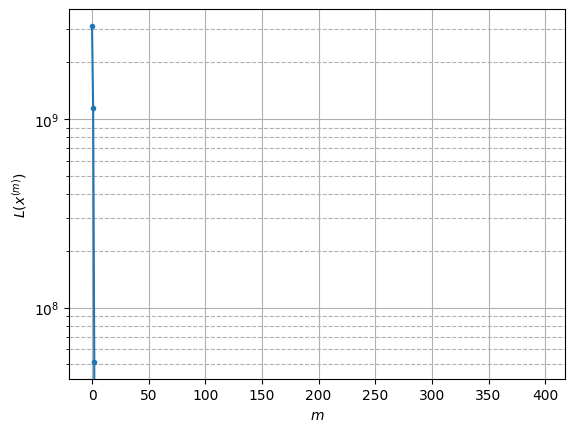

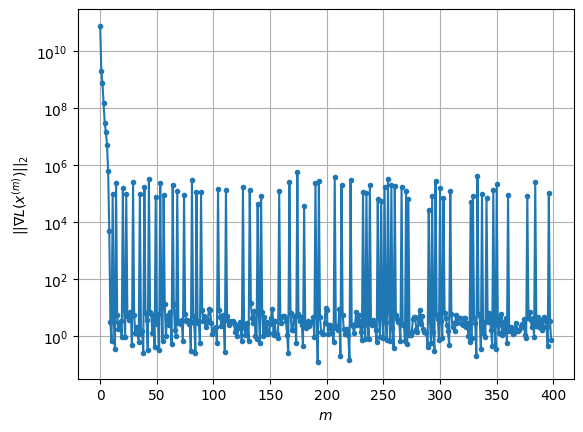

Windows:  21%|██        | 62/296 [10:57<48:39, 12.48s/it]  

Before applying the algorithm
Cost function: -23635115.726599075
Gradient norm: 144790.96034548074
Global relative error: 1.0482295510584305
Position relative errors: 0.029396381191801123 m, 0.4703408168289648 m, 0.584341748384494 m, 0.731602764691927 m

Iteration 1
Cost function: -23635116.264131784 (-0.00%)
Gradient norm: 4.947953294356346 (-100.00%)
Global relative error: 1.06147509915819 (1.26%)
Position relative errors: 0.02186003489476303 m, 0.5776367755042412 m, 0.6280371890359785 m, 0.6309945470924343 m

Iteration 2
Cost function: -23635116.264131423 (0.00%)
Gradient norm: 2.8793699289079706 (-41.81%)
Global relative error: 1.061479194268098 (0.00%)
Position relative errors: 0.02186003241775694 m, 0.5776362091591272 m, 0.6280393700385398 m, 0.6309997837009668 m

Iteration 3
Cost function: -23635116.264131773 (-0.00%)
Gradient norm: 3.340411616815162 (16.01%)
Global relative error: 1.0614792028910227 (0.00%)
Position relative errors: 0.021860035375462404 m, 0.5776362068081609 m,

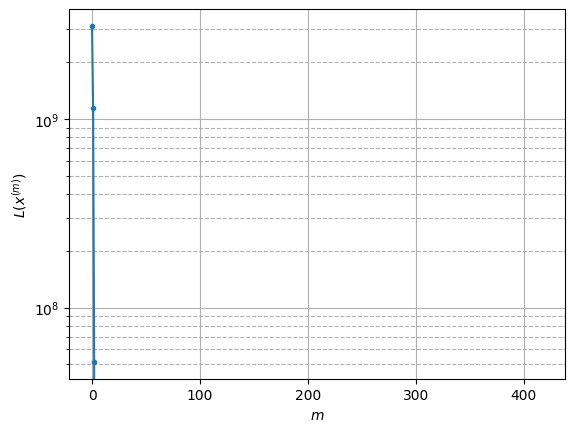

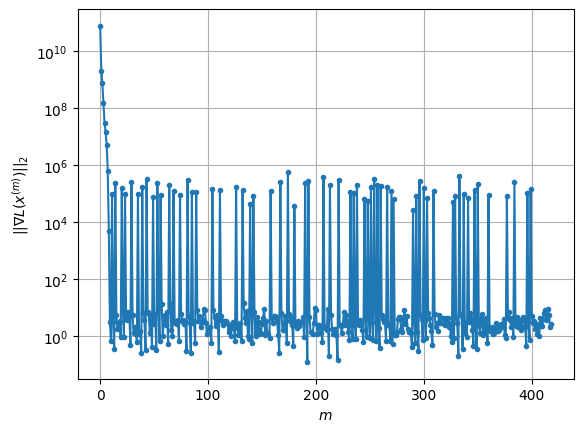

Windows:  21%|██▏       | 63/296 [11:28<1:10:39, 18.20s/it]

Before applying the algorithm
Cost function: -23635110.249701723
Gradient norm: 111107.95282023873
Global relative error: 1.0563495791110682
Position relative errors: 0.021132390139464368 m, 0.5881371524602551 m, 0.6217588716441496 m, 0.6188181847999203 m

Iteration 1
Cost function: -23635110.832351655 (-0.00%)
Gradient norm: 3.366623147938243 (-100.00%)
Global relative error: 0.9754819238566148 (-7.66%)
Position relative errors: 0.021098401792858473 m, 0.5089338120206501 m, 0.5972771208293084 m, 0.5791064947360662 m

Iteration 2
Cost function: -23635110.832351316 (0.00%)
Gradient norm: 7.466654488095497 (121.78%)
Global relative error: 0.9754811907986181 (-0.00%)
Position relative errors: 0.021098395595057898 m, 0.5089319131420023 m, 0.5972762768044834 m, 0.5791077994472509 m

Iteration 3
Cost function: -23635110.832351096 (0.00%)
Gradient norm: 1.8178190445002689 (-75.65%)
Global relative error: 0.9754811777903711 (-0.00%)
Position relative errors: 0.021098401683615518 m, 0.508931907

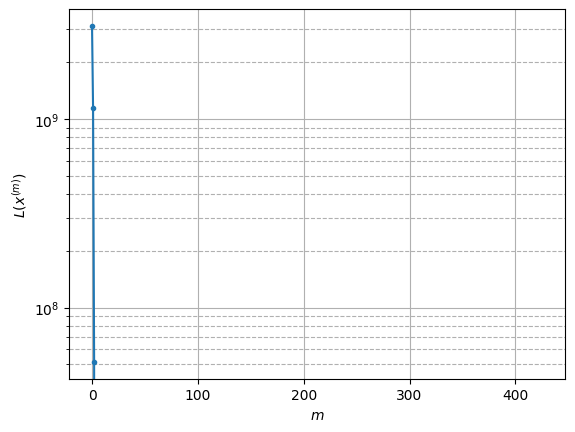

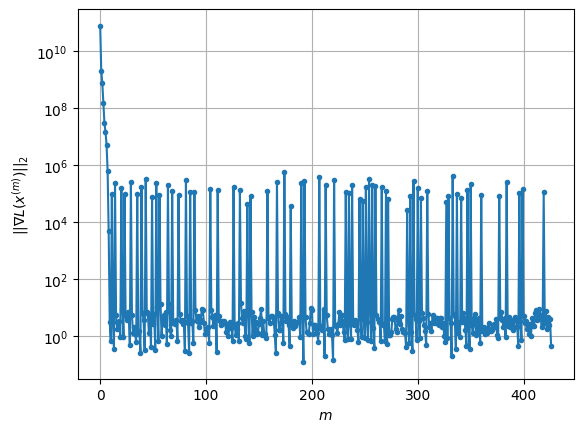

Windows:  22%|██▏       | 64/296 [11:41<1:03:53, 16.52s/it]

Before applying the algorithm
Cost function: -23635107.84108205
Gradient norm: 329636.25311987277
Global relative error: 0.979670822955691
Position relative errors: 0.02036959717819844 m, 0.5296503131888682 m, 0.5944017352582615 m, 0.5705218484778009 m

Iteration 1
Cost function: -23635108.47526509 (-0.00%)
Gradient norm: 2.9792489143572785 (-100.00%)
Global relative error: 1.0191413865020544 (4.03%)
Position relative errors: 0.022099201996614415 m, 0.6013306672672064 m, 0.5515577942135641 m, 0.6102000865950032 m

Iteration 2
Cost function: -23635108.475265205 (-0.00%)
Gradient norm: 3.164788789396493 (6.23%)
Global relative error: 1.0191401693014006 (-0.00%)
Position relative errors: 0.022099204083133952 m, 0.601330252895241 m, 0.5515567126057325 m, 0.6101994396000193 m

Iteration 3
Cost function: -23635108.475265283 (-0.00%)
Gradient norm: 9.491270483973752 (199.90%)
Global relative error: 1.019140184107754 (0.00%)
Position relative errors: 0.022099184670661205 m, 0.6013302506537215 

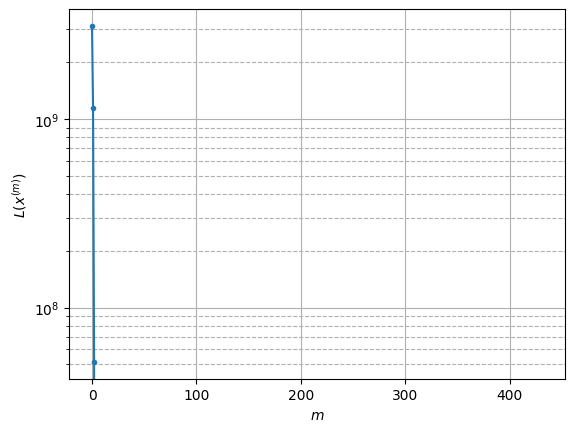

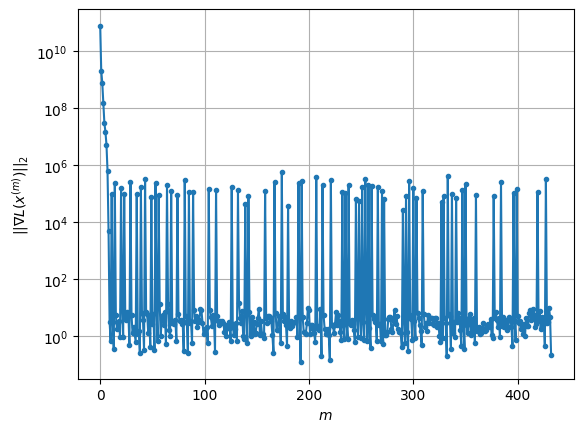

Windows:  22%|██▏       | 65/296 [11:51<55:44, 14.48s/it]  

Before applying the algorithm
Cost function: -23635108.712218136
Gradient norm: 118270.21695378928
Global relative error: 1.0212513211834358
Position relative errors: 0.02134288117886036 m, 0.6193424060231574 m, 0.5483115670264697 m, 0.5985533106277616 m

Iteration 1
Cost function: -23635108.81480811 (-0.00%)
Gradient norm: 2.440255889162898 (-100.00%)
Global relative error: 1.0430063457155874 (2.13%)
Position relative errors: 0.01874163326562159 m, 0.5924550373285276 m, 0.5625459526861357 m, 0.6481109138306995 m

Iteration 2
Cost function: -23635108.814808052 (0.00%)
Gradient norm: 2.5335119021308623 (3.82%)
Global relative error: 1.0430064243857338 (0.00%)
Position relative errors: 0.018741635175722977 m, 0.5924550234855515 m, 0.5625465132641292 m, 0.6481105664676268 m

STOP on Iteration 3
Cost function = -23635108.814808406 (-0.00%)
Gradient norm = 0.16924088093466594 (-93.32%)
Global relative error = 1.0430064382106843 (0.00%)
Final position relative errors: 0.018741635446167547 m,

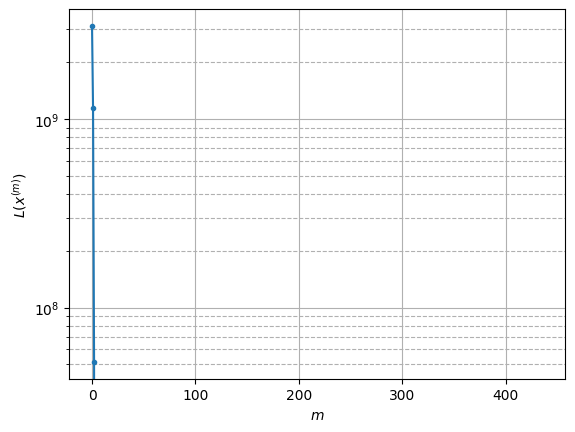

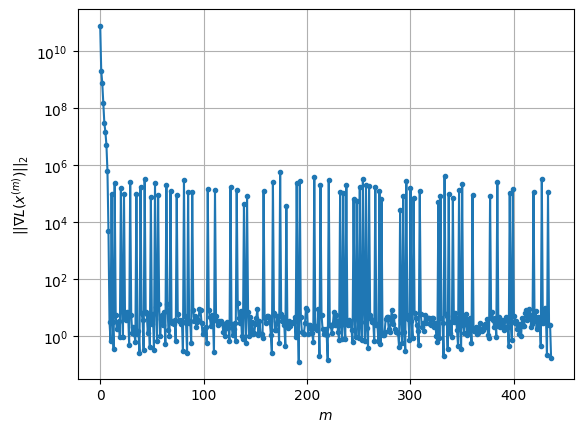

Windows:  22%|██▏       | 66/296 [11:57<46:26, 12.12s/it]

Before applying the algorithm
Cost function: -23635106.733125523
Gradient norm: 92170.40003415532
Global relative error: 1.0369134846040586
Position relative errors: 0.018119535603040426 m, 0.6039004274500392 m, 0.5590528900214625 m, 0.6305735918474621 m

Iteration 1
Cost function: -23635107.03299719 (-0.00%)
Gradient norm: 1.856079267150914 (-100.00%)
Global relative error: 0.9237739925582561 (-10.91%)
Position relative errors: 0.028106966174529676 m, 0.6236627342926403 m, 0.4698306626933094 m, 0.49281857231014814 m

STOP on Iteration 2
Cost function = -23635107.032997455 (-0.00%)
Gradient norm = 0.807785803395547 (-56.48%)
Global relative error = 0.9237723709100795 (-0.00%)
Final position relative errors: 0.02810696150349979 m, 0.623663531146757 m, 0.46983040417485566 m, 0.4928147708760108 m



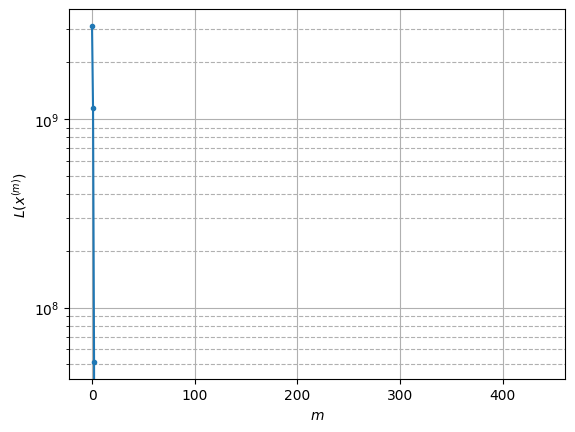

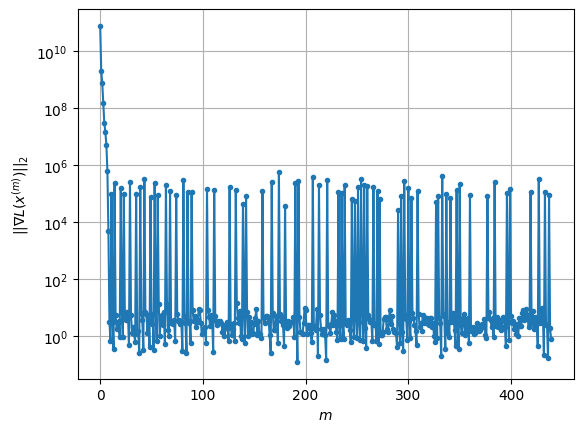

Windows:  23%|██▎       | 67/296 [12:02<38:14, 10.02s/it]

Before applying the algorithm
Cost function: -23635103.022574328
Gradient norm: 179804.95694064486
Global relative error: 0.9391105420539042
Position relative errors: 0.027095020531631504 m, 0.6499680166844134 m, 0.4768515874431036 m, 0.4809848695465618 m

STOP on Iteration 1
Cost function = -23635103.29680801 (-0.00%)
Gradient norm = 0.7613563063681651 (-100.00%)
Global relative error = 0.888142554722975 (-5.43%)
Final position relative errors: 0.022703430355094225 m, 0.6156058596938264 m, 0.44680581753803617 m, 0.457901697859689 m



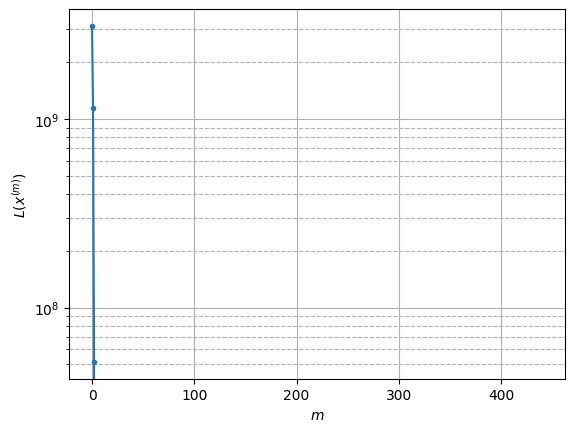

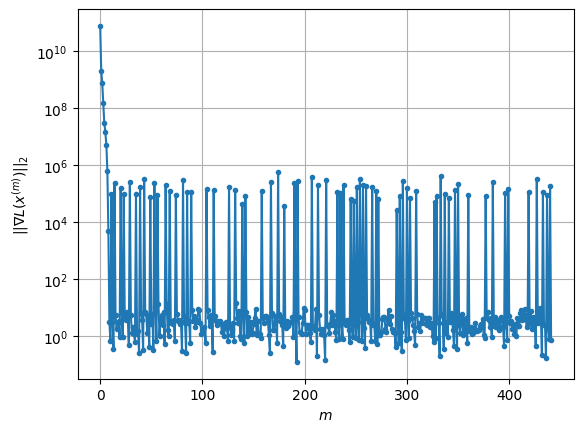

Windows:  23%|██▎       | 68/296 [12:06<30:42,  8.08s/it]

Before applying the algorithm
Cost function: -23635108.89466789
Gradient norm: 106044.92749483327
Global relative error: 0.9025105914811233
Position relative errors: 0.021927887921260904 m, 0.6394706604744619 m, 0.4529926064053561 m, 0.44712163634221846 m

Iteration 1
Cost function: -23635109.59860499 (-0.00%)
Gradient norm: 4.02603027010344 (-100.00%)
Global relative error: 0.9744230436832754 (7.97%)
Position relative errors: 0.03574625565823347 m, 0.6076525288516264 m, 0.520760125797165 m, 0.554786018158149 m

Iteration 2
Cost function: -23635109.59860492 (0.00%)
Gradient norm: 1.6116014747346177 (-59.97%)
Global relative error: 0.9744255905132427 (0.00%)
Position relative errors: 0.03574626376839786 m, 0.6076526861678655 m, 0.5207609914364445 m, 0.5547895060213898 m

Iteration 3
Cost function: -23635109.598605223 (-0.00%)
Gradient norm: 1.5300154142234244 (-5.06%)
Global relative error: 0.9744255921785568 (0.00%)
Position relative errors: 0.03574625812288448 m, 0.6076526901600002 m,

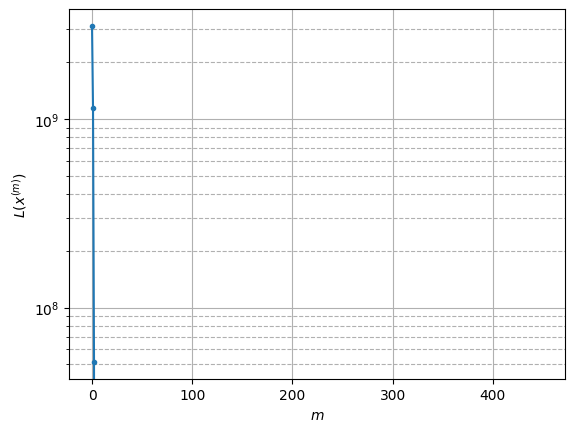

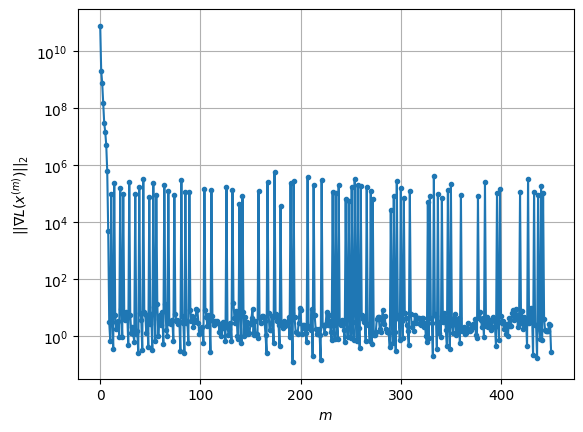

Windows:  23%|██▎       | 69/296 [12:20<37:44,  9.98s/it]

Before applying the algorithm
Cost function: -23635109.638453417
Gradient norm: 96461.52034062287
Global relative error: 0.9853634400654844
Position relative errors: 0.03444571173758877 m, 0.6369660121250397 m, 0.5238920635226342 m, 0.5381113099933943 m

Iteration 1
Cost function: -23635110.332586948 (-0.00%)
Gradient norm: 8.302205517562715 (-99.99%)
Global relative error: 1.0638395275003973 (7.96%)
Position relative errors: 0.022397751704038127 m, 0.5760815675127235 m, 0.6955482463015749 m, 0.5617771696420223 m

STOP on Iteration 2
Cost function = -23635110.332586948 (0.00%)
Gradient norm = 0.44136177309862146 (-94.68%)
Global relative error = 1.0638377092139815 (-0.00%)
Final position relative errors: 0.022397752472407932 m, 0.5760790753612913 m, 0.6955469251814038 m, 0.5617779176396976 m



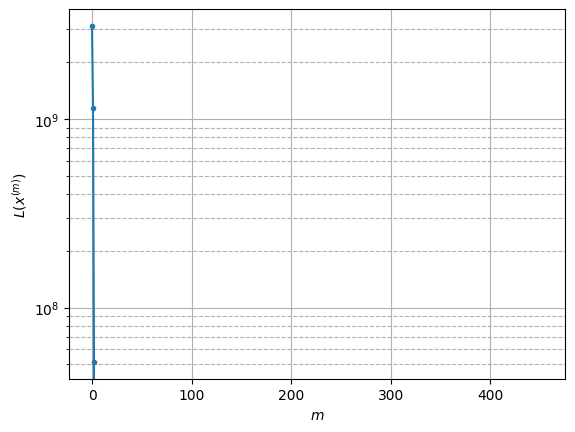

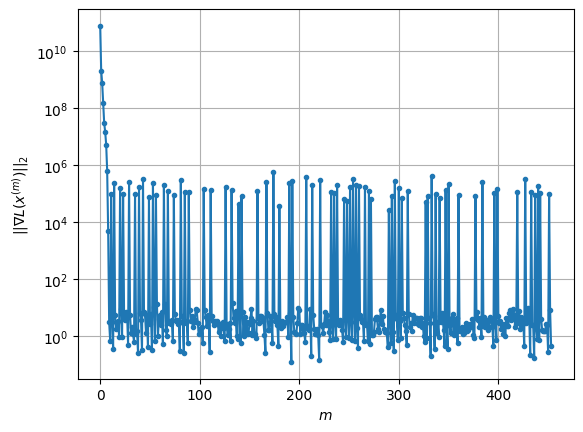

Windows:  24%|██▎       | 70/296 [12:25<32:01,  8.50s/it]

Before applying the algorithm
Cost function: -23635108.453991797
Gradient norm: 26658.227850387397
Global relative error: 1.0658670100204448
Position relative errors: 0.021438550398949673 m, 0.598532496910083 m, 0.6911603494770134 m, 0.5474186217301024 m

Iteration 1
Cost function: -23635108.737444557 (-0.00%)
Gradient norm: 4.765144263595282 (-99.98%)
Global relative error: 1.106936173713934 (3.85%)
Position relative errors: 0.0171608922106836 m, 0.6326855695266378 m, 0.7424501670462131 m, 0.5229607832765409 m

STOP on Iteration 2
Cost function = -23635108.737444367 (0.00%)
Gradient norm = 0.5792075797651209 (-87.84%)
Global relative error = 1.1069368846261858 (0.00%)
Final position relative errors: 0.017160893508630076 m, 0.6326859783909179 m, 0.7424504982007581 m, 0.5229613232035694 m



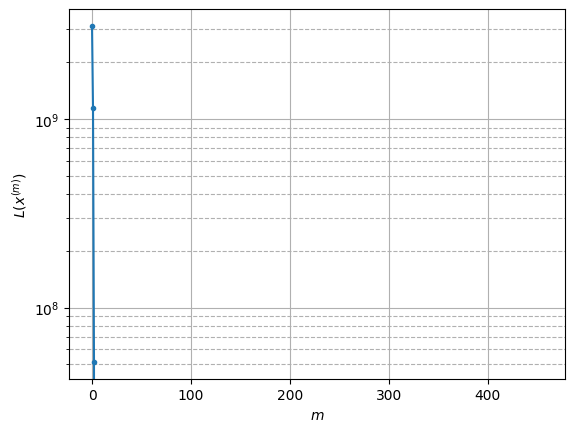

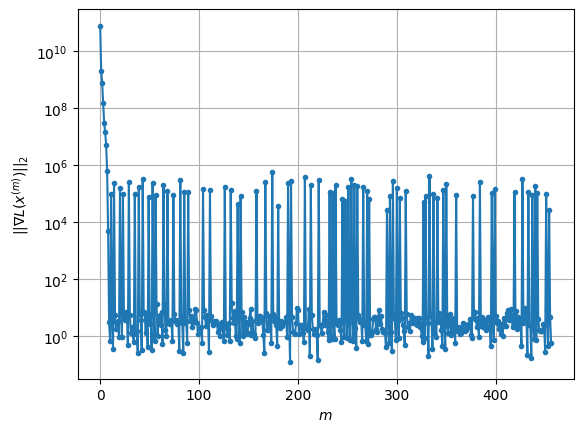

Windows:  24%|██▍       | 71/296 [12:30<27:55,  7.45s/it]

Before applying the algorithm
Cost function: -23635107.14503714
Gradient norm: 116015.92076623505
Global relative error: 1.1090904371319483
Position relative errors: 0.016570227420685927 m, 0.6479573972656663 m, 0.7392628603926874 m, 0.5132706425656997 m

Iteration 1
Cost function: -23635107.690458383 (-0.00%)
Gradient norm: 5.127295725889098 (-100.00%)
Global relative error: 1.1092307949516715 (0.01%)
Position relative errors: 0.015938058001664594 m, 0.7253568180253727 m, 0.7460023414825948 m, 0.3840250194360316 m

Iteration 2
Cost function: -23635107.690457974 (0.00%)
Gradient norm: 2.224529775715228 (-56.61%)
Global relative error: 1.1092316018981347 (0.00%)
Position relative errors: 0.01593806575492464 m, 0.7253559311869151 m, 0.7460021438193845 m, 0.38402940894296816 m

Iteration 3
Cost function: -23635107.69045824 (-0.00%)
Gradient norm: 1.2976558470953792 (-41.67%)
Global relative error: 1.1092315955560055 (-0.00%)
Position relative errors: 0.0159380556492058 m, 0.72535592638056

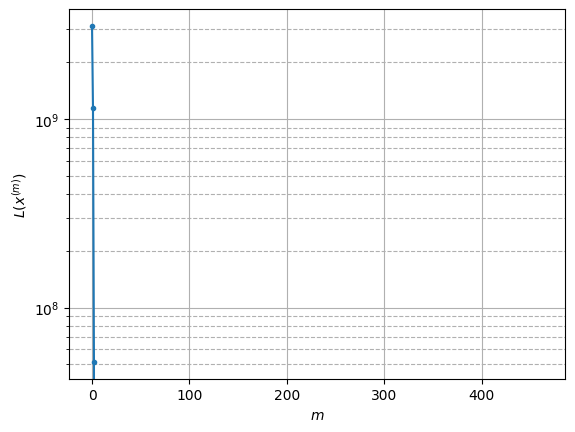

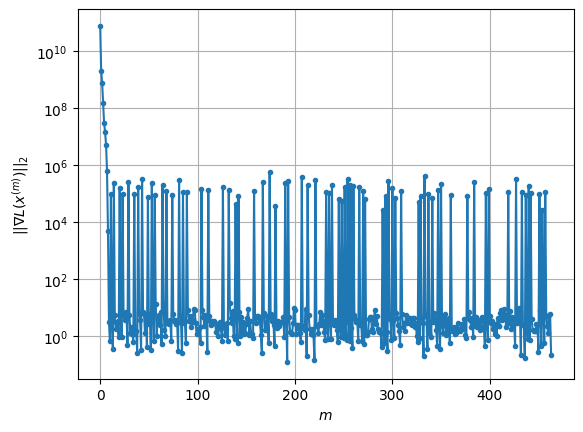

Windows:  24%|██▍       | 72/296 [12:42<31:59,  8.57s/it]

Before applying the algorithm
Cost function: -23635105.46042465
Gradient norm: 220590.18199103972
Global relative error: 1.1264673990712528
Position relative errors: 0.015425936712868146 m, 0.7449351812089393 m, 0.7510121900771192 m, 0.38696441638146667 m

STOP on Iteration 1
Cost function = -23635105.84621114 (-0.00%)
Gradient norm = 0.9852328003072208 (-100.00%)
Global relative error = 1.243979311663296 (10.43%)
Final position relative errors: 0.014095977629754994 m, 0.7267692438259135 m, 0.8931590955317087 m, 0.4704861773686147 m



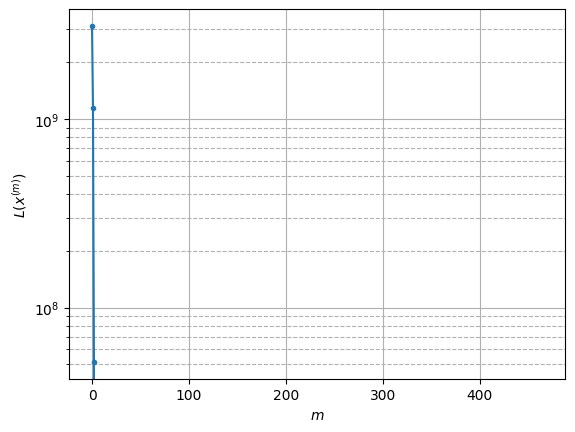

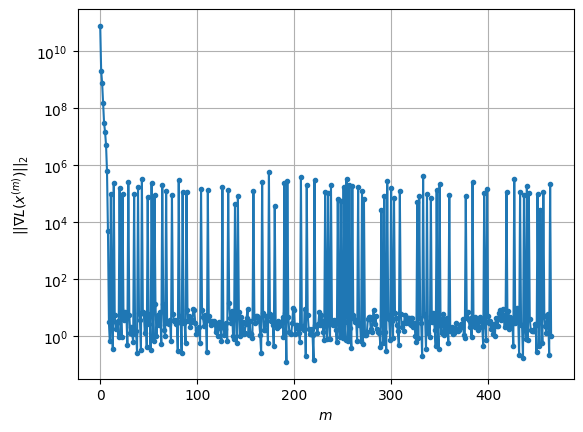

Windows:  25%|██▍       | 73/296 [12:45<26:20,  7.09s/it]

Before applying the algorithm
Cost function: -23635095.872098032
Gradient norm: 137061.60375867848
Global relative error: 1.247412286793427
Position relative errors: 0.013712840444689714 m, 0.7408578845166773 m, 0.8859456099678572 m, 0.47125101656792245 m

Iteration 1
Cost function: -23635096.114755798 (-0.00%)
Gradient norm: 4.218928378132486 (-100.00%)
Global relative error: 1.092588402335017 (-12.41%)
Position relative errors: 0.010304547249674124 m, 0.6951180080932572 m, 0.7559201155605806 m, 0.37287747501841806 m

Iteration 2
Cost function: -23635096.114755794 (0.00%)
Gradient norm: 1.409202642439602 (-66.60%)
Global relative error: 1.0925865703894104 (-0.00%)
Position relative errors: 0.010304542151615068 m, 0.695116433483736 m, 0.7559186800380877 m, 0.3728779528516943 m

STOP on Iteration 3
Cost function = -23635096.11475562 (0.00%)
Gradient norm = 0.4029732523362184 (-71.40%)
Global relative error = 1.0925865749984323 (0.00%)
Final position relative errors: 0.010304543767256619

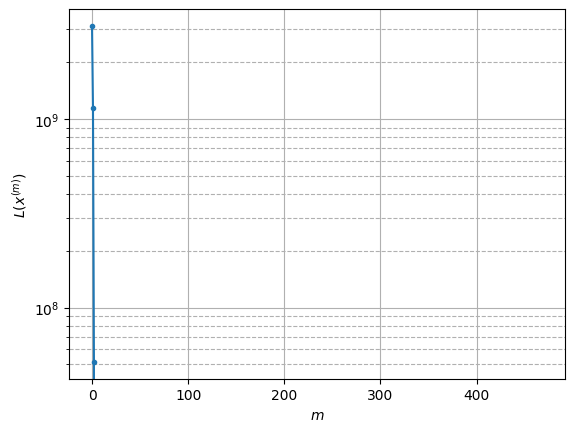

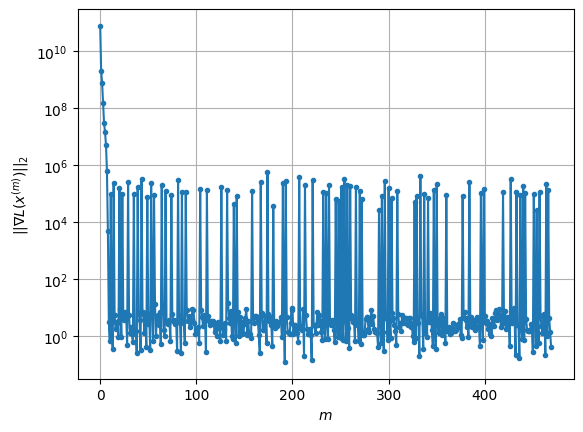

Windows:  25%|██▌       | 74/296 [12:52<25:31,  6.90s/it]

Before applying the algorithm
Cost function: -23635094.601426274
Gradient norm: 169150.60876384214
Global relative error: 1.1016215312397426
Position relative errors: 0.01000629740922926 m, 0.7093070541288243 m, 0.7534689524560422 m, 0.37767263468426604 m

Iteration 1
Cost function: -23635095.11978659 (-0.00%)
Gradient norm: 1.9102789947534036 (-100.00%)
Global relative error: 0.9495851882280052 (-13.80%)
Position relative errors: 0.013507440167445841 m, 0.6035997944695847 m, 0.6426104196901508 m, 0.35248777593376573 m

Iteration 2
Cost function: -23635095.11978595 (0.00%)
Gradient norm: 3.4028931837884375 (78.14%)
Global relative error: 0.9495849384007836 (-0.00%)
Position relative errors: 0.0135074410791345 m, 0.603599513837028 m, 0.6426104261020827 m, 0.3524875717308929 m

Iteration 3
Cost function: -23635095.119786188 (-0.00%)
Gradient norm: 6.742039431836032 (98.13%)
Global relative error: 0.9495849371680778 (-0.00%)
Position relative errors: 0.013507438413723186 m, 0.603599509644

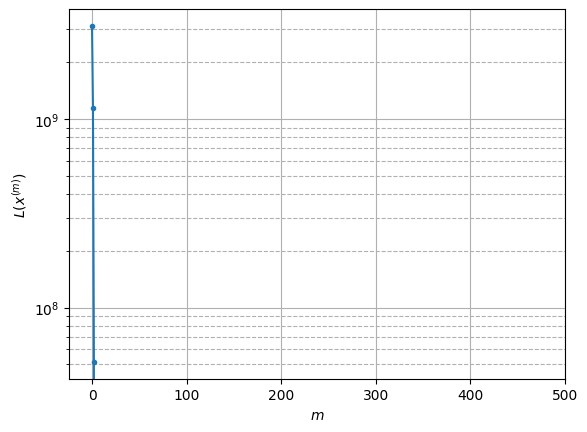

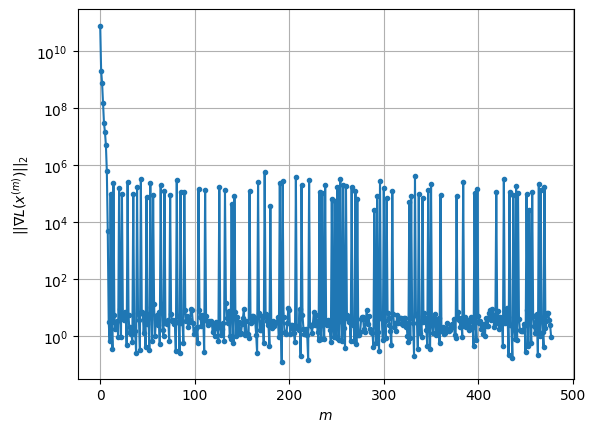

Windows:  25%|██▌       | 75/296 [13:04<31:43,  8.61s/it]

Before applying the algorithm
Cost function: -23635088.6057559
Gradient norm: 73961.31348539637
Global relative error: 0.9589297349343159
Position relative errors: 0.01318702470592036 m, 0.6166326000092678 m, 0.6452011252566813 m, 0.35050114223362033 m

Iteration 1
Cost function: -23635088.902283486 (-0.00%)
Gradient norm: 3.679943708637166 (-100.00%)
Global relative error: 0.8943910709409038 (-6.73%)
Position relative errors: 0.012419652684223084 m, 0.6265211322292038 m, 0.5707823764431574 m, 0.2854099403882242 m

Iteration 2
Cost function: -23635088.90228378 (-0.00%)
Gradient norm: 6.413346113630735 (74.28%)
Global relative error: 0.8943914579950845 (0.00%)
Position relative errors: 0.012419653100824353 m, 0.6265209701919617 m, 0.5707815455983578 m, 0.28541317053162973 m

Iteration 3
Cost function: -23635088.90228334 (0.00%)
Gradient norm: 7.114787962214311 (10.94%)
Global relative error: 0.8943914727881375 (0.00%)
Position relative errors: 0.012419653643021014 m, 0.6265209777324218 

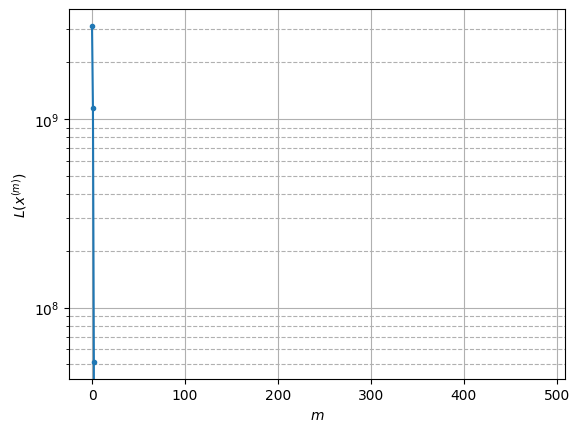

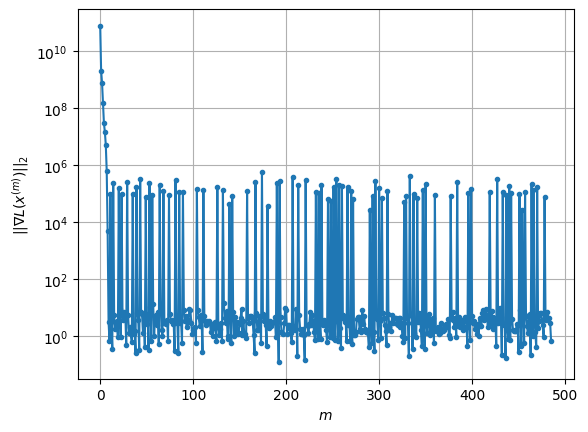

Windows:  26%|██▌       | 76/296 [13:17<36:11,  9.87s/it]

Before applying the algorithm
Cost function: -23635086.838839646
Gradient norm: 111221.83392974574
Global relative error: 0.9119578196402511
Position relative errors: 0.012122261511212595 m, 0.6440566907203541 m, 0.5782425681004651 m, 0.28695929806200826 m

Iteration 1
Cost function: -23635087.234214604 (-0.00%)
Gradient norm: 2.136463259426636 (-100.00%)
Global relative error: 0.9261869162183888 (1.56%)
Position relative errors: 0.01688260824639662 m, 0.6279314456710638 m, 0.567776701387534 m, 0.37532331895933563 m

STOP on Iteration 2
Cost function = -23635087.2342146 (0.00%)
Gradient norm = 0.922476120689883 (-56.82%)
Global relative error = 0.9261878776674962 (0.00%)
Final position relative errors: 0.01688260928243847 m, 0.6279307342814571 m, 0.5677769507396154 m, 0.37532650438765164 m



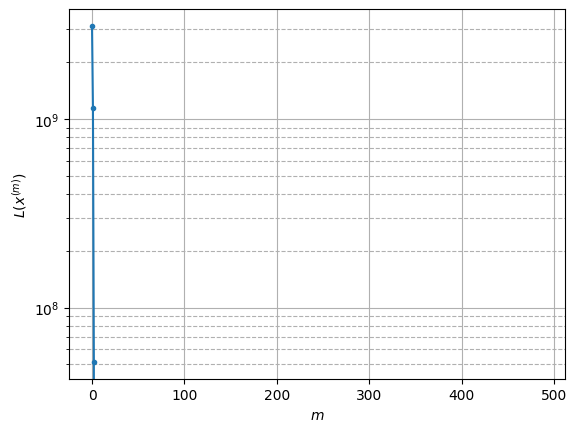

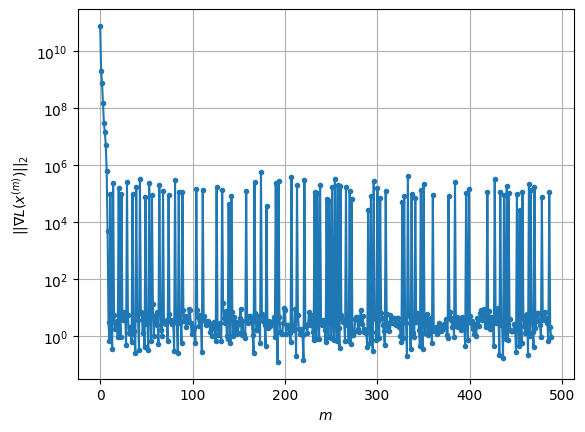

Windows:  26%|██▌       | 77/296 [13:22<30:48,  8.44s/it]

Before applying the algorithm
Cost function: -23635090.672339097
Gradient norm: 214371.6743705209
Global relative error: 0.9357993544999065
Position relative errors: 0.01657664256125791 m, 0.6452745229049254 m, 0.5720275017123868 m, 0.36311118796178243 m

Iteration 1
Cost function: -23635091.02336428 (-0.00%)
Gradient norm: 3.1644963745423884 (-100.00%)
Global relative error: 1.0278671716601078 (9.84%)
Position relative errors: 0.015385293414967926 m, 0.7207292663243592 m, 0.6591164407912935 m, 0.3199807020456738 m

Iteration 2
Cost function: -23635091.02336422 (0.00%)
Gradient norm: 2.6768241002113307 (-15.41%)
Global relative error: 1.027866935886034 (-0.00%)
Position relative errors: 0.015385291149238235 m, 0.7207280923825496 m, 0.6591161561198244 m, 0.3199831753629827 m

STOP on Iteration 3
Cost function = -23635091.023364358 (-0.00%)
Gradient norm = 0.8568861151584728 (-67.99%)
Global relative error = 1.0278669272763588 (-0.00%)
Final position relative errors: 0.015385292127340737

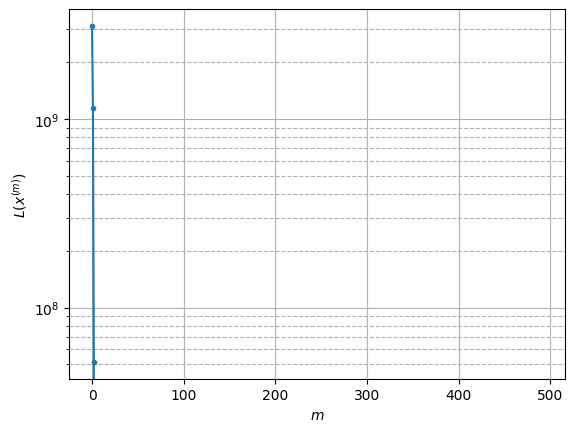

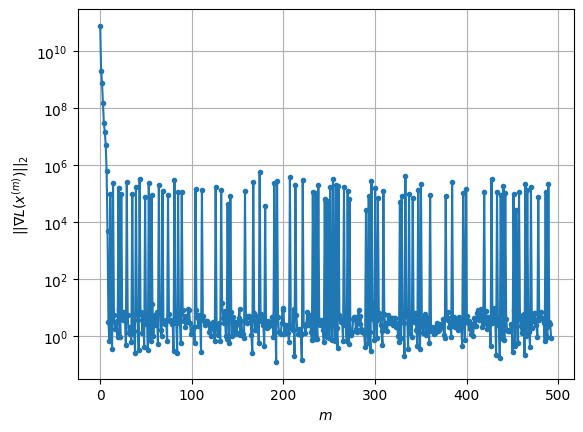

Windows:  26%|██▋       | 78/296 [13:29<28:34,  7.87s/it]

Before applying the algorithm
Cost function: -23635097.403723817
Gradient norm: 74398.77208552982
Global relative error: 1.0414588942523177
Position relative errors: 0.015056447341472145 m, 0.7381691092748026 m, 0.6629764619783001 m, 0.31619170332150637 m

Iteration 1
Cost function: -23635097.513402026 (-0.00%)
Gradient norm: 7.038670336191552 (-99.99%)
Global relative error: 1.2044594258271983 (15.65%)
Position relative errors: 0.013591484141286267 m, 0.863752559038444 m, 0.7902269208971967 m, 0.2828586250259209 m

Iteration 2
Cost function: -23635097.51340142 (0.00%)
Gradient norm: 1.8761628321268498 (-73.34%)
Global relative error: 1.2044477590787366 (-0.00%)
Position relative errors: 0.013591486734511358 m, 0.8637429299227871 m, 0.790219231012021 m, 0.2828598333233159 m

STOP on Iteration 3
Cost function = -23635097.513401728 (-0.00%)
Gradient norm = 0.278434550185887 (-85.16%)
Global relative error = 1.2044477440291326 (-0.00%)
Final position relative errors: 0.013591481024042552 

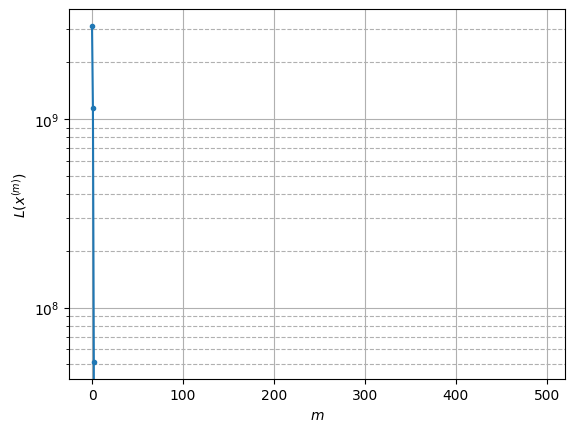

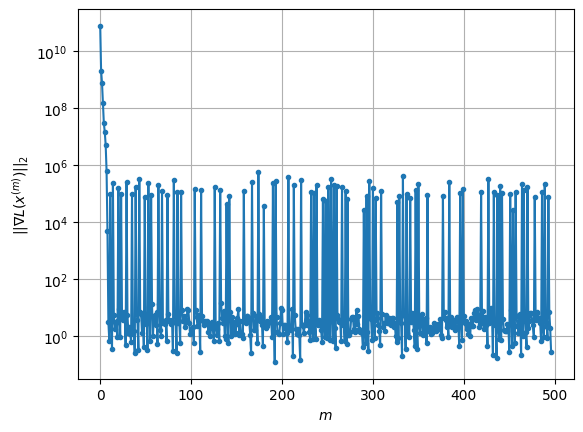

Windows:  27%|██▋       | 79/296 [13:35<27:00,  7.47s/it]

Before applying the algorithm
Cost function: -23635092.456786644
Gradient norm: 68660.34936351713
Global relative error: 1.2269578845669464
Position relative errors: 0.013134341261474442 m, 0.886485336046915 m, 0.8013052344620553 m, 0.2780382024131588 m

Iteration 1
Cost function: -23635093.431284025 (-0.00%)
Gradient norm: 12.14304738923028 (-99.98%)
Global relative error: 1.2517695167304543 (2.02%)
Position relative errors: 0.017161994708093726 m, 0.8127618108545158 m, 0.763396375401992 m, 0.5685726657029394 m

Iteration 2
Cost function: -23635093.431284163 (-0.00%)
Gradient norm: 1.2489509134441183 (-89.71%)
Global relative error: 1.251771758543908 (0.00%)
Position relative errors: 0.017161993284837605 m, 0.8127698350823762 m, 0.7633994751660109 m, 0.5685619687938996 m

STOP on Iteration 3
Cost function = -23635093.43128428 (-0.00%)
Gradient norm = 0.8467218739368334 (-32.21%)
Global relative error = 1.2517717578476515 (-0.00%)
Final position relative errors: 0.01716199557315987 m, 

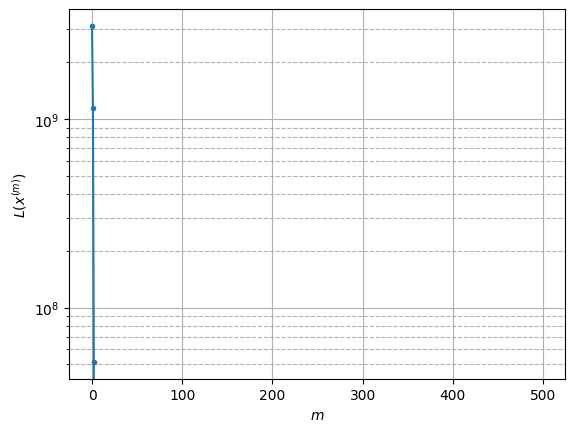

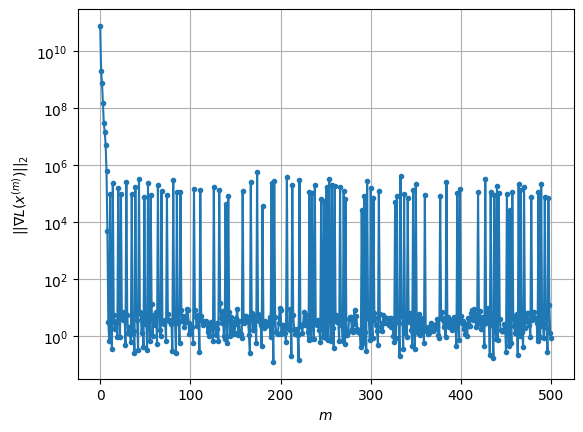

Windows:  27%|██▋       | 80/296 [13:42<26:03,  7.24s/it]

Before applying the algorithm
Cost function: -23635103.676887877
Gradient norm: 78300.78764144503
Global relative error: 1.2531193833387295
Position relative errors: 0.01664185233664504 m, 0.8269703478441607 m, 0.7706109244309078 m, 0.5406555742196482 m

Iteration 1
Cost function: -23635103.9221886 (-0.00%)
Gradient norm: 2.948830096967984 (-100.00%)
Global relative error: 1.3065953553066836 (4.27%)
Position relative errors: 0.023127437255420286 m, 0.8115647701811362 m, 0.7565913742852445 m, 0.6896279267200774 m

STOP on Iteration 2
Cost function = -23635103.922188655 (-0.00%)
Gradient norm = 0.6496797488139352 (-77.97%)
Global relative error = 1.3065941621946735 (-0.00%)
Final position relative errors: 0.02312743640434057 m, 0.8115633945773367 m, 0.7565905670098096 m, 0.6896281707263999 m



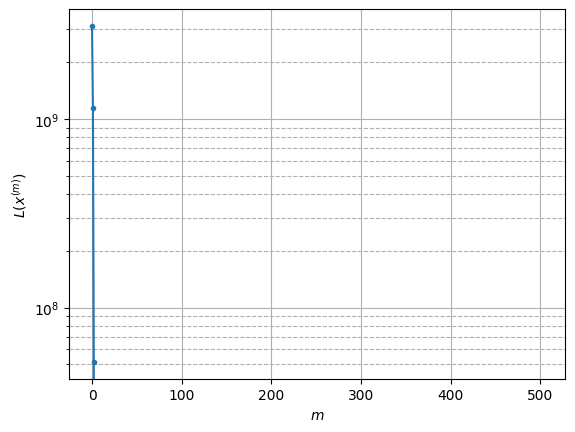

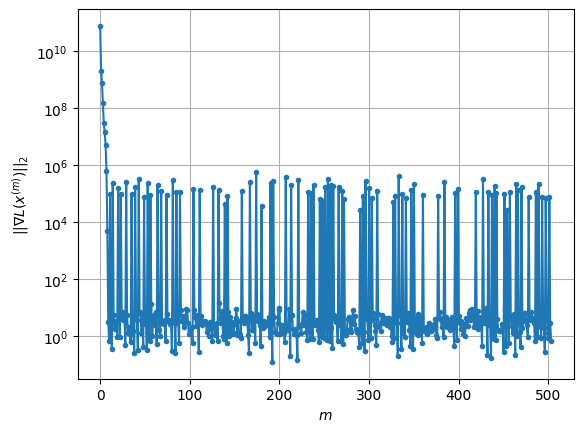

Windows:  27%|██▋       | 81/296 [13:47<23:39,  6.60s/it]

Before applying the algorithm
Cost function: -23635099.780883573
Gradient norm: 178507.71185195554
Global relative error: 1.2930502501683716
Position relative errors: 0.022352658357564375 m, 0.821870458972873 m, 0.758307746477983 m, 0.6488264051215028 m

Iteration 1
Cost function: -23635100.111648105 (-0.00%)
Gradient norm: 2.230770374887724 (-100.00%)
Global relative error: 1.3156979693276252 (1.75%)
Position relative errors: 0.022762238472127667 m, 0.8056591334571644 m, 0.6352037271742488 m, 0.8233898197075636 m

Iteration 2
Cost function: -23635100.11164859 (-0.00%)
Gradient norm: 2.3800764299476915 (6.69%)
Global relative error: 1.3156919777610447 (-0.00%)
Position relative errors: 0.022762234008189747 m, 0.8056570427505535 m, 0.6352041244925976 m, 0.8233819850485042 m

Iteration 3
Cost function: -23635100.11164869 (-0.00%)
Gradient norm: 1.0704090439644243 (-55.03%)
Global relative error: 1.315691967001377 (-0.00%)
Position relative errors: 0.022762239012501052 m, 0.80565703800608

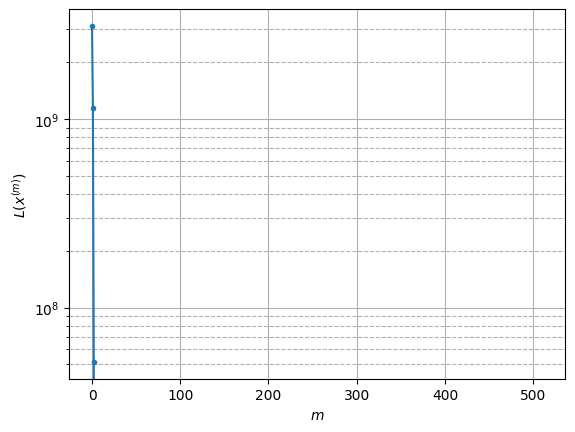

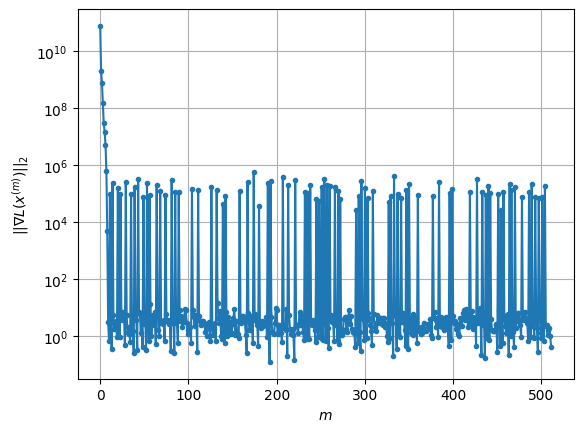

Windows:  28%|██▊       | 82/296 [14:00<30:00,  8.41s/it]

Before applying the algorithm
Cost function: -23635098.77642675
Gradient norm: 186177.10168137625
Global relative error: 1.2902132329129583
Position relative errors: 0.022138835414556746 m, 0.8121934165670318 m, 0.6352624910519357 m, 0.7752042865099039 m

Iteration 1
Cost function: -23635099.64059464 (-0.00%)
Gradient norm: 5.048437037494077 (-100.00%)
Global relative error: 1.519732749410788 (17.79%)
Position relative errors: 0.018163990207675448 m, 0.9534477346730971 m, 0.8381892509959908 m, 0.8352430950871955 m

STOP on Iteration 2
Cost function = -23635099.640594736 (-0.00%)
Gradient norm = 0.7635652068759355 (-84.88%)
Global relative error = 1.519726052912376 (-0.00%)
Final position relative errors: 0.01816399125820628 m, 0.9534345039512883 m, 0.8381788192255379 m, 0.8352564822055724 m



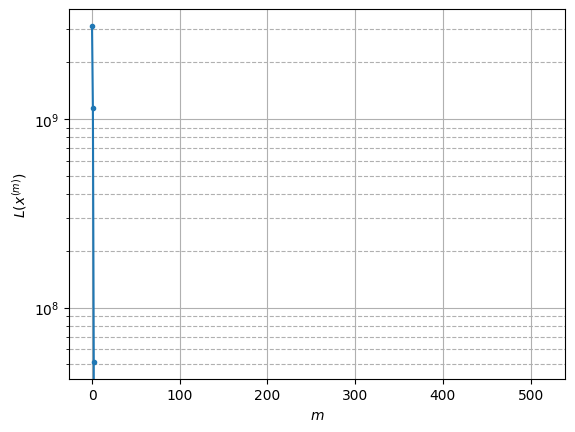

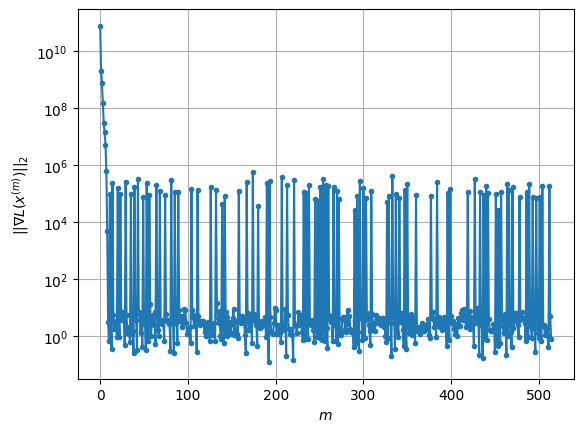

Windows:  28%|██▊       | 83/296 [14:05<26:50,  7.56s/it]

Before applying the algorithm
Cost function: -23635091.83285914
Gradient norm: 72286.67815083072
Global relative error: 1.4922423833630223
Position relative errors: 0.017549807420055193 m, 0.9607817301585487 m, 0.8415255120027576 m, 0.7714984154173508 m

Iteration 1
Cost function: -23635092.398136336 (-0.00%)
Gradient norm: 5.0397697818909375 (-99.99%)
Global relative error: 1.3066939655726144 (-12.43%)
Position relative errors: 0.02829191526951014 m, 0.8360439666238821 m, 0.7810016369442985 m, 0.6306452893071866 m

Iteration 2
Cost function: -23635092.398136508 (-0.00%)
Gradient norm: 1.050361440996675 (-79.16%)
Global relative error: 1.3066798113819382 (-0.00%)
Position relative errors: 0.028291914934262377 m, 0.8360315072211527 m, 0.7809968840136329 m, 0.6306383654080903 m

Iteration 3
Cost function: -23635092.398136344 (0.00%)
Gradient norm: 2.772040838912033 (163.91%)
Global relative error: 1.3066798153406773 (0.00%)
Position relative errors: 0.028291916946160723 m, 0.836031507442

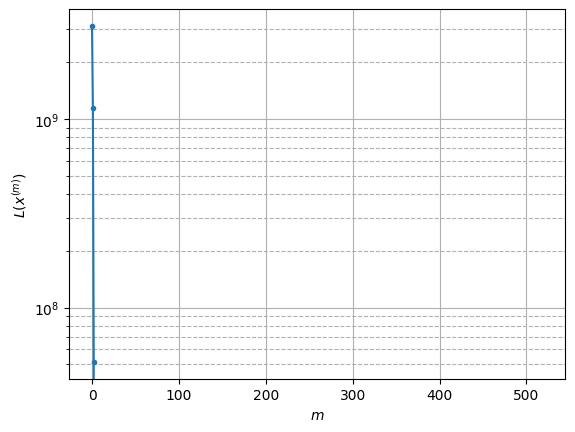

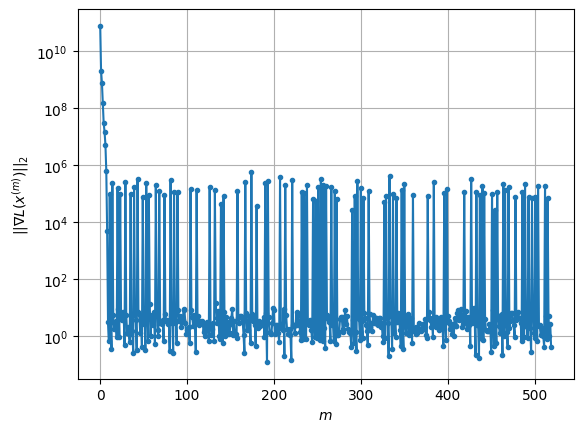

Windows:  28%|██▊       | 84/296 [14:15<28:30,  8.07s/it]

Before applying the algorithm
Cost function: -23635100.841118187
Gradient norm: 321277.486144692
Global relative error: 1.283008720933798
Position relative errors: 0.027546287684585294 m, 0.8385008022515158 m, 0.7779810691399515 m, 0.5805276618242311 m

Iteration 1
Cost function: -23635101.177200016 (-0.00%)
Gradient norm: 1.3833806693514281 (-100.00%)
Global relative error: 1.2417506275566594 (-3.22%)
Position relative errors: 0.035112131025842486 m, 0.8069102823562515 m, 0.7063756757033478 m, 0.6250110840888601 m

Iteration 2
Cost function: -23635101.177200243 (-0.00%)
Gradient norm: 1.8805381952987377 (35.94%)
Global relative error: 1.2417494289254032 (-0.00%)
Position relative errors: 0.03511213042185102 m, 0.8069097710177885 m, 0.7063761089649834 m, 0.6250088732135567 m

STOP on Iteration 3
Cost function = -23635101.177200127 (0.00%)
Gradient norm = 0.9278873380253985 (-50.66%)
Global relative error = 1.2417494333577193 (0.00%)
Final position relative errors: 0.0351121328712076 m,

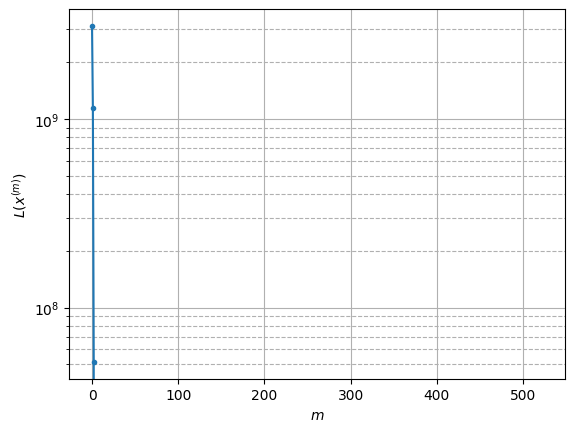

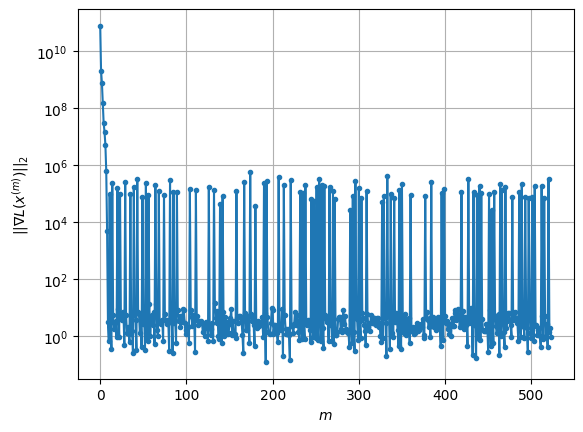

Windows:  29%|██▊       | 85/296 [14:22<27:42,  7.88s/it]

Before applying the algorithm
Cost function: -23635095.22197945
Gradient norm: 177787.14966964812
Global relative error: 1.2155919309974925
Position relative errors: 0.03436890668416259 m, 0.8122687265967549 m, 0.7031897632670854 m, 0.5676478874286501 m

Iteration 1
Cost function: -23635096.2798707 (-0.00%)
Gradient norm: 12.647280582378038 (-99.99%)
Global relative error: 1.3756549634936777 (13.17%)
Position relative errors: 0.032874795920482765 m, 0.7728518281763317 m, 0.6146171038970305 m, 0.9572300695684993 m

STOP on Iteration 2
Cost function = -23635096.27987033 (0.00%)
Gradient norm = 0.5851105305821137 (-95.37%)
Global relative error = 1.375620220970488 (-0.00%)
Final position relative errors: 0.03287480079868148 m, 0.7728669725702367 m, 0.6146340215801624 m, 0.9571570479593232 m



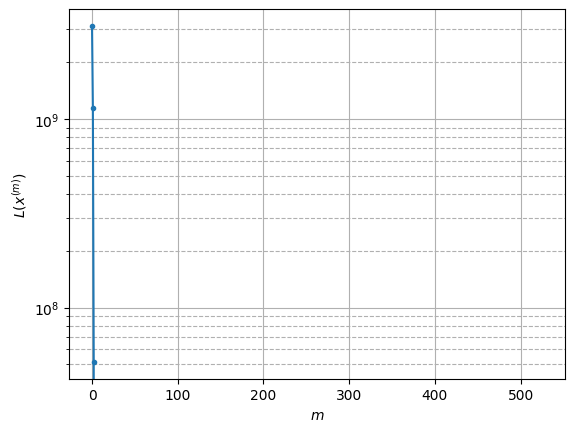

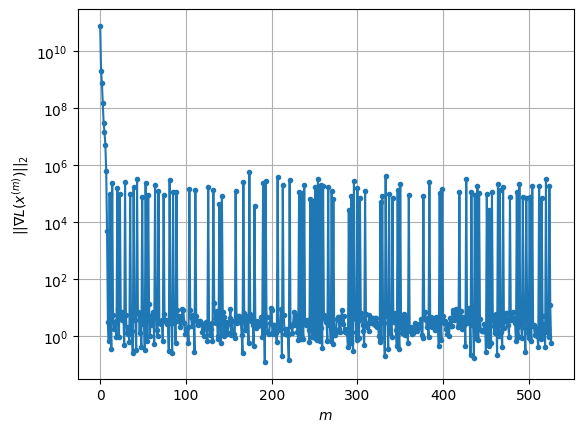

Windows:  29%|██▉       | 86/296 [14:28<25:13,  7.21s/it]

Before applying the algorithm
Cost function: -23635099.2419489
Gradient norm: 163548.31670345287
Global relative error: 1.3222470093346927
Position relative errors: 0.03205044449669283 m, 0.7697907278186193 m, 0.6130982625254708 m, 0.8825193131042571 m

Iteration 1
Cost function: -23635100.12043717 (-0.00%)
Gradient norm: 7.221634317835252 (-100.00%)
Global relative error: 1.2978292068971418 (-1.85%)
Position relative errors: 0.031346848605091085 m, 0.8090771724295583 m, 0.7507755459545511 m, 0.6819869462004593 m

Iteration 2
Cost function: -23635100.120437205 (-0.00%)
Gradient norm: 1.3451222275235608 (-81.37%)
Global relative error: 1.2978193523805923 (-0.00%)
Position relative errors: 0.03134684925604022 m, 0.8090736055788854 m, 0.7507783686079497 m, 0.6819693169351384 m

Iteration 3
Cost function: -23635100.120437417 (-0.00%)
Gradient norm: 2.9196274035556247 (117.05%)
Global relative error: 1.2978193515763257 (-0.00%)
Position relative errors: 0.03134684566302414 m, 0.809073602099

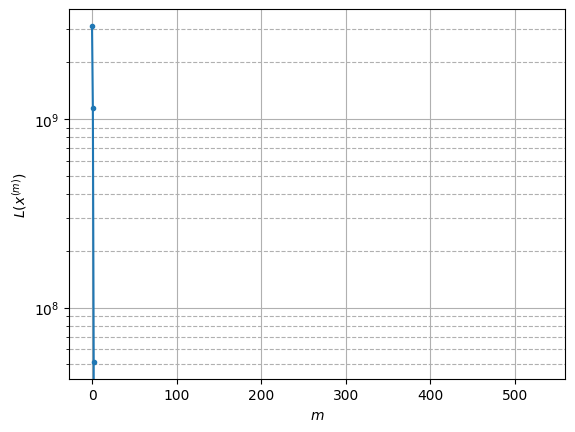

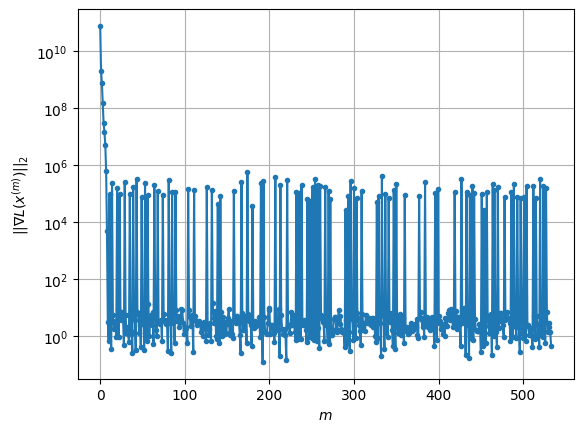

Windows:  29%|██▉       | 87/296 [14:40<30:47,  8.84s/it]

Before applying the algorithm
Cost function: -23635101.659837637
Gradient norm: 127679.63370451253
Global relative error: 1.2559285137069123
Position relative errors: 0.030328727680240822 m, 0.8007716193069303 m, 0.739016746439519 m, 0.6237416465500925 m

Iteration 1
Cost function: -23635102.24215599 (-0.00%)
Gradient norm: 1.5735886092966427 (-100.00%)
Global relative error: 1.1373665722107988 (-9.44%)
Position relative errors: 0.019733453297786016 m, 0.7554940636477796 m, 0.6787222987542345 m, 0.5116409771719564 m

STOP on Iteration 2
Cost function = -23635102.24215576 (0.00%)
Gradient norm = 0.5176615852058069 (-67.10%)
Global relative error = 1.137367630510119 (0.00%)
Final position relative errors: 0.01973345262148531 m, 0.7554968267757459 m, 0.678722173226437 m, 0.5116394162143089 m



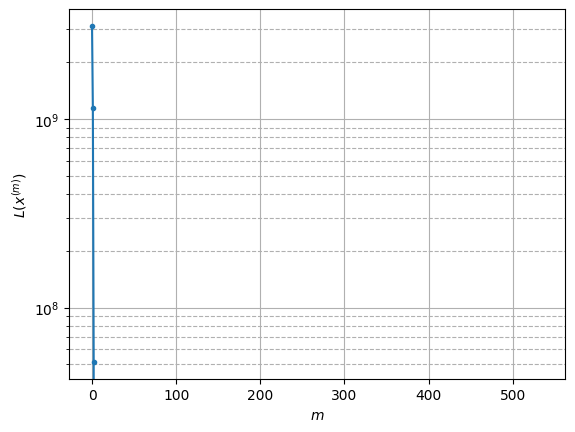

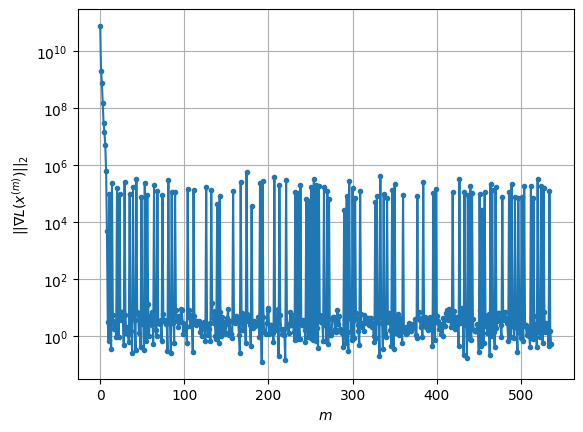

Windows:  30%|██▉       | 88/296 [14:46<27:31,  7.94s/it]

Before applying the algorithm
Cost function: -23635100.506150108
Gradient norm: 153143.02905539397
Global relative error: 1.1072709915530028
Position relative errors: 0.018747268028781544 m, 0.7528609756534796 m, 0.6671794723572885 m, 0.4623504319057234 m

Iteration 1
Cost function: -23635100.699962635 (-0.00%)
Gradient norm: 1.5660468859899537 (-100.00%)
Global relative error: 1.1076379584352214 (0.03%)
Position relative errors: 0.01551985522016545 m, 0.7355366915167066 m, 0.686665267880841 m, 0.4627049188852682 m

Iteration 2
Cost function: -23635100.699962568 (0.00%)
Gradient norm: 1.7540635429512514 (12.01%)
Global relative error: 1.1076381924691632 (0.00%)
Position relative errors: 0.015519856911675827 m, 0.7355377698679114 m, 0.6866657513151949 m, 0.46270304743202484 m

Iteration 3
Cost function: -23635100.699962642 (-0.00%)
Gradient norm: 4.183987631529742 (138.53%)
Global relative error: 1.1076381867972351 (-0.00%)
Position relative errors: 0.01551986275398505 m, 0.735537762762

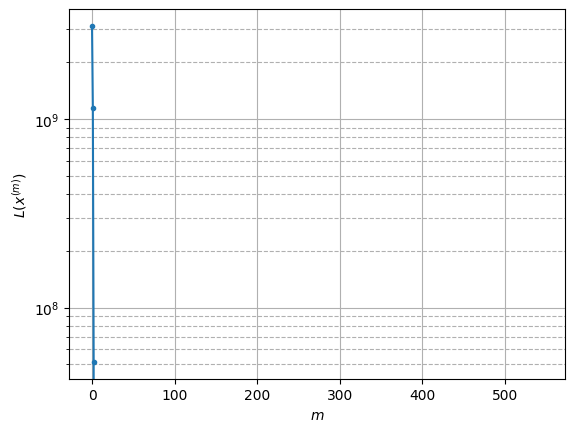

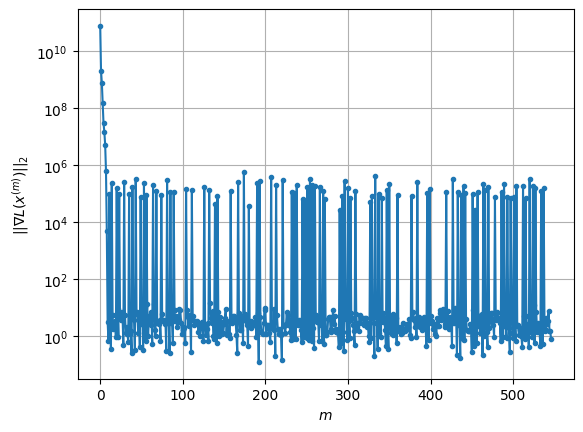

Windows:  30%|███       | 89/296 [15:03<37:04, 10.75s/it]

Before applying the algorithm
Cost function: -23635107.4709815
Gradient norm: 165174.94216791663
Global relative error: 1.0756246547756667
Position relative errors: 0.01456005382093437 m, 0.7268826656106285 m, 0.674606113321822 m, 0.41629661419282543 m

Iteration 1
Cost function: -23635108.122482378 (-0.00%)
Gradient norm: 4.348397661005636 (-100.00%)
Global relative error: 0.9438980774154203 (-12.25%)
Position relative errors: 0.03034984928550595 m, 0.6460866643784845 m, 0.6296691548558936 m, 0.275879744112607 m

Iteration 2
Cost function: -23635108.12248275 (-0.00%)
Gradient norm: 3.937274771457095 (-9.45%)
Global relative error: 0.9439004541830016 (0.00%)
Position relative errors: 0.030349844150305 m, 0.6460817392578914 m, 0.6296759793505591 m, 0.27588383439399383 m

Iteration 3
Cost function: -23635108.122482464 (0.00%)
Gradient norm: 8.67454708685565 (120.32%)
Global relative error: 0.9439004602339824 (0.00%)
Position relative errors: 0.030349849905822946 m, 0.6460817414150677 m, 

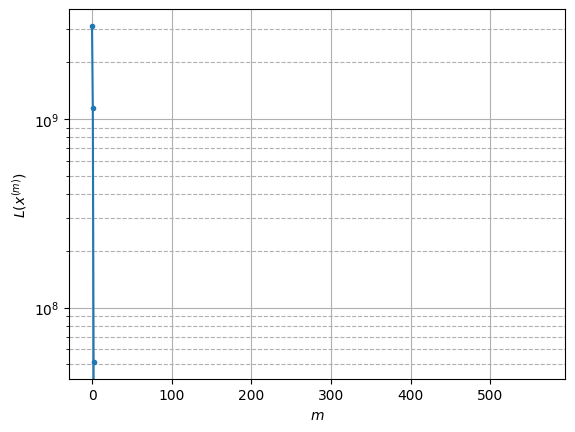

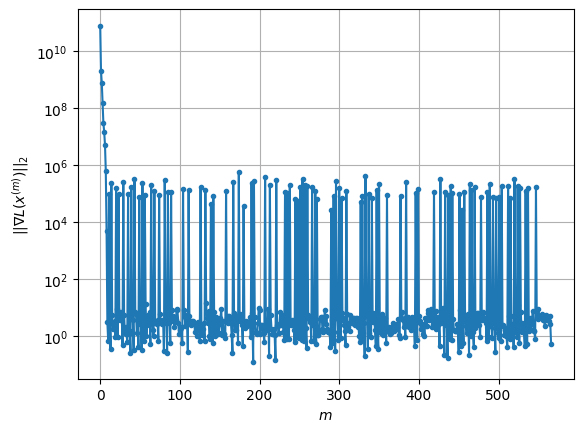

Windows:  30%|███       | 90/296 [15:38<1:01:17, 17.85s/it]

Before applying the algorithm
Cost function: -23635116.567659754
Gradient norm: 56210.846326076105
Global relative error: 0.9306290046543008
Position relative errors: 0.029183239054484427 m, 0.6318342989913242 m, 0.6218517801823404 m, 0.28160767945708404 m

Iteration 1
Cost function: -23635117.561106052 (-0.00%)
Gradient norm: 14.899669829480517 (-99.97%)
Global relative error: 0.9061170945902309 (-2.63%)
Position relative errors: 0.027333821670979478 m, 0.48177873907227065 m, 0.4990750114072496 m, 0.5823340296220895 m

STOP on Iteration 2
Cost function = -23635117.561105926 (0.00%)
Gradient norm = 0.10687072764682817 (-99.28%)
Global relative error = 0.9060560890085682 (-0.01%)
Final position relative errors: 0.027333821946872977 m, 0.4817754291876661 m, 0.49908960102994765 m, 0.5822293326356193 m



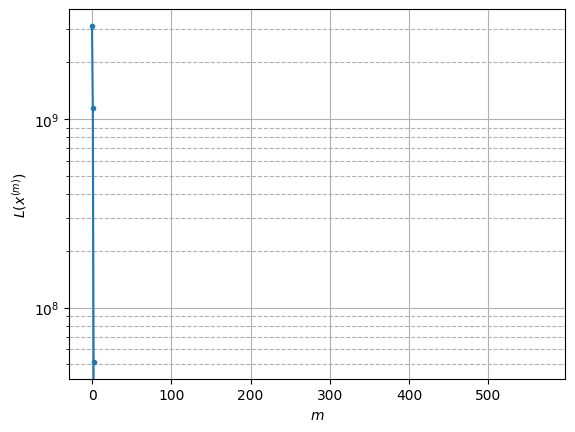

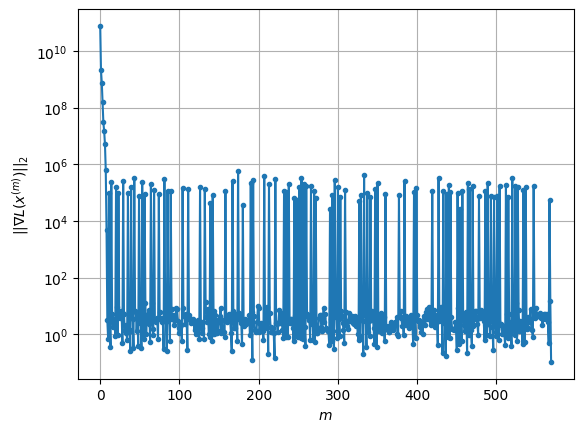

Windows:  31%|███       | 91/296 [15:43<47:49, 14.00s/it]  

Before applying the algorithm
Cost function: -23635120.807569694
Gradient norm: 220311.6623073313
Global relative error: 0.8535199773704445
Position relative errors: 0.026158432316992716 m, 0.4690998694684518 m, 0.4867030748102113 m, 0.5204574505456158 m

Iteration 1
Cost function: -23635121.347978387 (-0.00%)
Gradient norm: 2.559508359107293 (-100.00%)
Global relative error: 0.961807604784007 (12.69%)
Position relative errors: 0.03902696795706925 m, 0.6214226406067593 m, 0.5626798357389894 m, 0.4698666507033321 m

Iteration 2
Cost function: -23635121.347978324 (0.00%)
Gradient norm: 2.7492976489798058 (7.42%)
Global relative error: 0.9618037406454811 (-0.00%)
Position relative errors: 0.03902695941443644 m, 0.6214207292570638 m, 0.562677066247985 m, 0.4698645860048168 m

Iteration 3
Cost function: -23635121.347978514 (-0.00%)
Gradient norm: 2.248594504681211 (-18.21%)
Global relative error: 0.9618037348502088 (-0.00%)
Position relative errors: 0.03902695597879132 m, 0.6214207183406024

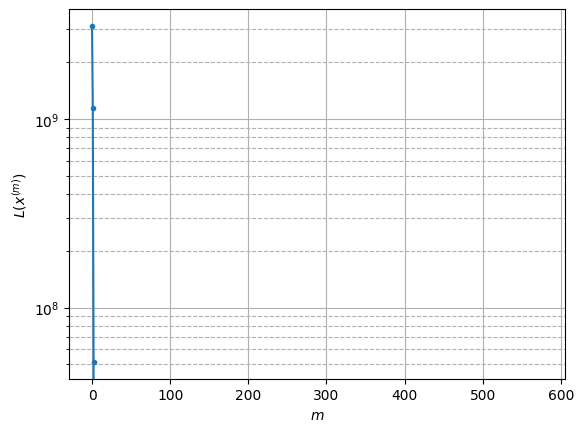

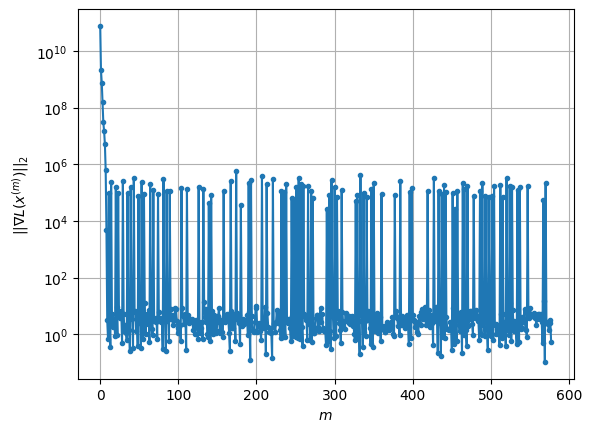

Windows:  31%|███       | 92/296 [15:56<46:26, 13.66s/it]

Before applying the algorithm
Cost function: -23635118.52313164
Gradient norm: 386767.00230236526
Global relative error: 0.9263906164990414
Position relative errors: 0.03744108097428854 m, 0.6076071756388112 m, 0.5606841133722463 m, 0.416224883599986 m

Iteration 1
Cost function: -23635118.94295276 (-0.00%)
Gradient norm: 3.28425992206405 (-100.00%)
Global relative error: 0.9657742961931705 (4.25%)
Position relative errors: 0.03289802912527294 m, 0.5939548774797158 m, 0.4960621703880773 m, 0.5768677861045589 m

Iteration 2
Cost function: -23635118.942952346 (0.00%)
Gradient norm: 1.7107433492701791 (-47.91%)
Global relative error: 0.965764226287447 (-0.00%)
Position relative errors: 0.03289803227523474 m, 0.5939555103804185 m, 0.4960653900262299 m, 0.5768475066301157 m

STOP on Iteration 3
Cost function = -23635118.94295239 (-0.00%)
Gradient norm = 0.33716854694517856 (-80.29%)
Global relative error = 0.9657642211746932 (-0.00%)
Final position relative errors: 0.03289803135328974 m, 0.

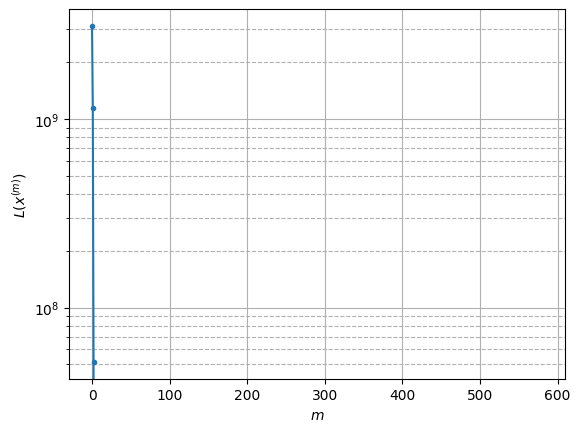

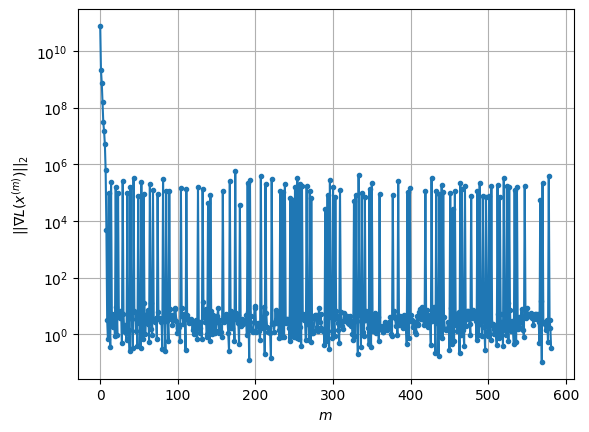

Windows:  31%|███▏      | 93/296 [16:02<38:54, 11.50s/it]

Before applying the algorithm
Cost function: -23635119.977200363
Gradient norm: 44045.7471802333
Global relative error: 0.919506010274175
Position relative errors: 0.03154408305759489 m, 0.5791858698756773 m, 0.48785914547356124 m, 0.5206075317489378 m

Iteration 1
Cost function: -23635120.65965539 (-0.00%)
Gradient norm: 9.122589210811945 (-99.98%)
Global relative error: 1.0479779477139197 (13.97%)
Position relative errors: 0.024715123229711502 m, 0.8130303694757841 m, 0.6280572905076193 m, 0.20535682823693613 m

Iteration 2
Cost function: -23635120.659655746 (-0.00%)
Gradient norm: 1.9033261923457125 (-79.14%)
Global relative error: 1.048021318856415 (0.00%)
Position relative errors: 0.024715122546596125 m, 0.8130747416498124 m, 0.628076726983427 m, 0.20534304013653026 m

Iteration 3
Cost function: -23635120.65965511 (0.00%)
Gradient norm: 4.4298402504198675 (132.74%)
Global relative error: 1.0480213260766473 (0.00%)
Position relative errors: 0.024715125354845977 m, 0.813074742436639

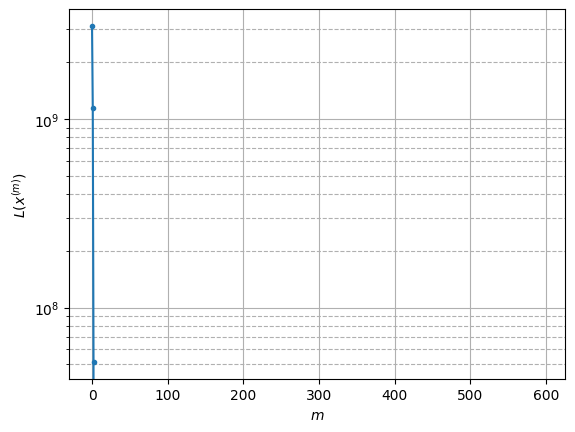

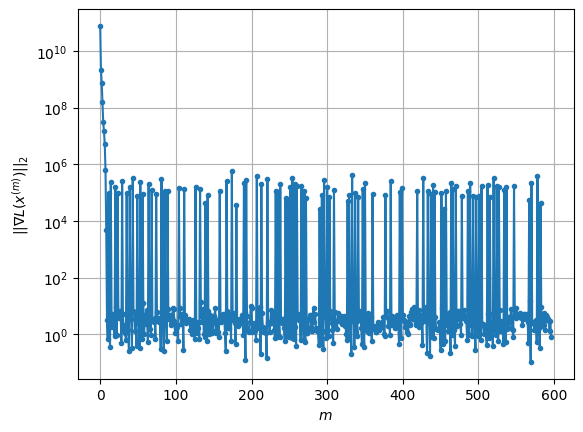

Windows:  32%|███▏      | 94/296 [16:26<50:47, 15.09s/it]

Before applying the algorithm
Cost function: -23635128.235454805
Gradient norm: 327593.04311969894
Global relative error: 1.040595105317832
Position relative errors: 0.023640260708984104 m, 0.8041531699088043 m, 0.6307563547227201 m, 0.19432503420545474 m

Iteration 1
Cost function: -23635128.739732336 (-0.00%)
Gradient norm: 3.824759188332448 (-100.00%)
Global relative error: 1.4163657975062816 (36.11%)
Position relative errors: 0.025576855678693212 m, 1.082168604156648 m, 0.845019524228173 m, 0.34682789222119886 m

Iteration 2
Cost function: -23635128.739732746 (-0.00%)
Gradient norm: 6.593560044058374 (72.39%)
Global relative error: 1.4164193635419724 (0.00%)
Position relative errors: 0.025576833050343653 m, 1.082212665032231 m, 0.8450382876108433 m, 0.3468634504481842 m

Iteration 3
Cost function: -23635128.73973252 (0.00%)
Gradient norm: 2.84785160623076 (-56.81%)
Global relative error: 1.4164193635945284 (0.00%)
Position relative errors: 0.025576857404753142 m, 1.082212666354789 

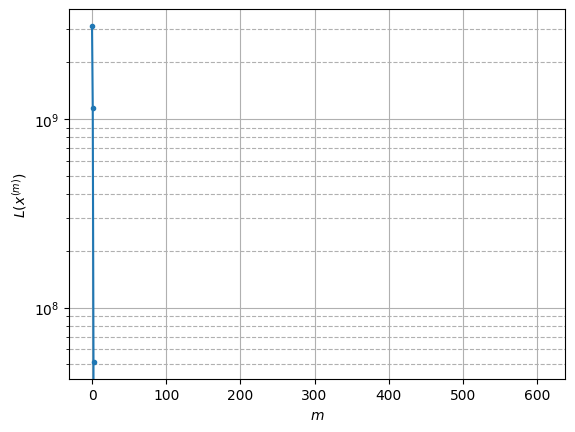

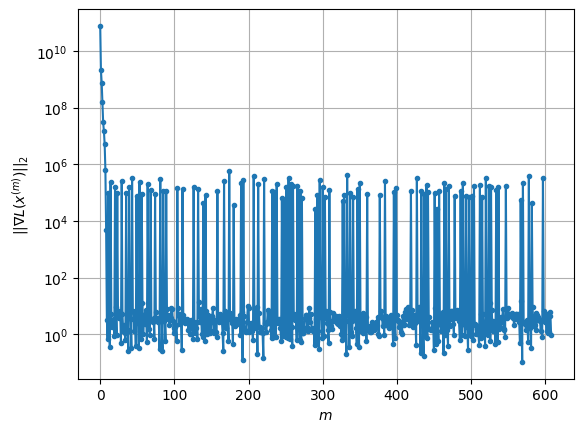

Windows:  32%|███▏      | 95/296 [16:45<54:38, 16.31s/it]

Before applying the algorithm
Cost function: -23635124.78654894
Gradient norm: 132345.81164033664
Global relative error: 1.4313830044130147
Position relative errors: 0.024483794339713295 m, 1.0735951159834722 m, 0.852984528124382 m, 0.40996021579226194 m

Iteration 1
Cost function: -23635125.52515028 (-0.00%)
Gradient norm: 4.416416037289742 (-100.00%)
Global relative error: 1.5644095667815494 (9.29%)
Position relative errors: 0.007953452992151912 m, 1.1129336530478378 m, 0.9131183078723031 m, 0.6122960912773248 m

Iteration 2
Cost function: -23635125.52515004 (0.00%)
Gradient norm: 1.9309944881394168 (-56.28%)
Global relative error: 1.5644058343554093 (-0.00%)
Position relative errors: 0.007953455783412907 m, 1.1129339323064724 m, 0.9131164470455463 m, 0.6122888223600804 m

Iteration 3
Cost function: -23635125.52515023 (-0.00%)
Gradient norm: 3.9594078285223255 (105.05%)
Global relative error: 1.5644058358722361 (0.00%)
Position relative errors: 0.007953447695867968 m, 1.1129339340307

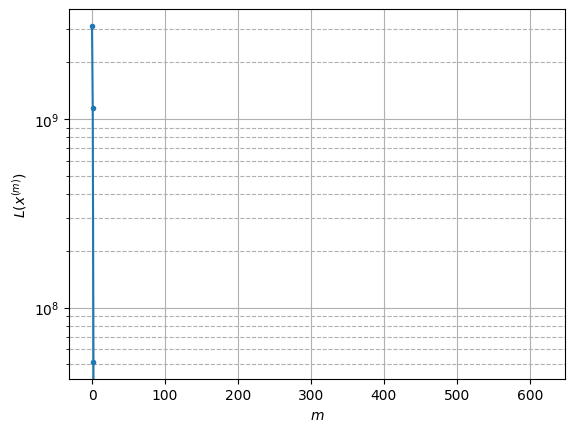

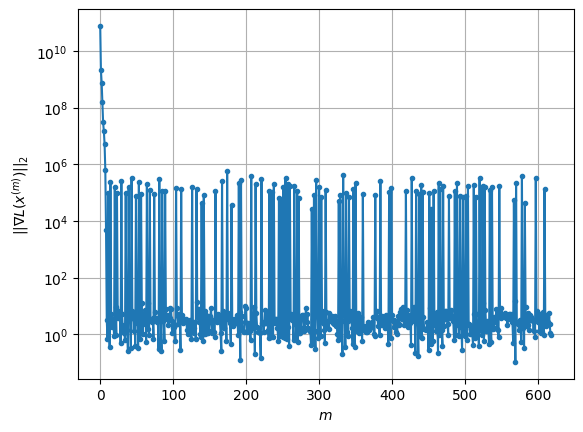

Windows:  32%|███▏      | 96/296 [17:01<54:02, 16.21s/it]

Before applying the algorithm
Cost function: -23635138.242812887
Gradient norm: 107483.0260336617
Global relative error: 1.5808043893907215
Position relative errors: 0.008889139209968642 m, 1.0984181638864972 m, 0.9177407995873491 m, 0.6708887632962947 m

Iteration 1
Cost function: -23635139.07888939 (-0.00%)
Gradient norm: 18.985352991799367 (-99.98%)
Global relative error: 1.8413682926967925 (16.48%)
Position relative errors: 0.007168544259031584 m, 1.0658548651893138 m, 0.9407019107314429 m, 1.1703064970613022 m

Iteration 2
Cost function: -23635139.07888914 (0.00%)
Gradient norm: 4.759001097905993 (-74.93%)
Global relative error: 1.8414392391387193 (0.00%)
Position relative errors: 0.0071685467494786255 m, 1.065893511078526 m, 0.9407243298057777 m, 1.1703649071618596 m

STOP on Iteration 3
Cost function = -23635139.07888906 (0.00%)
Gradient norm = 0.5487401146178718 (-88.47%)
Global relative error = 1.841439228594171 (-0.00%)
Final position relative errors: 0.007168545177324013 m, 

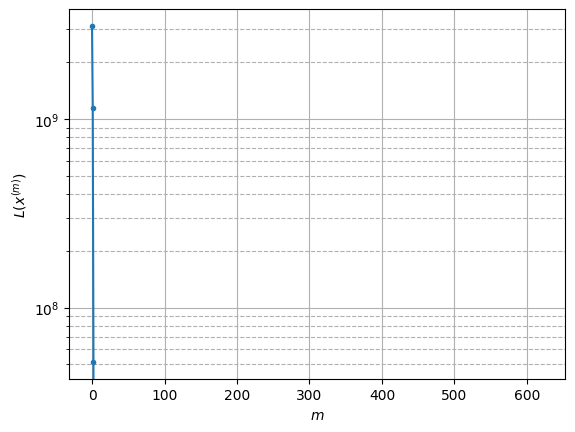

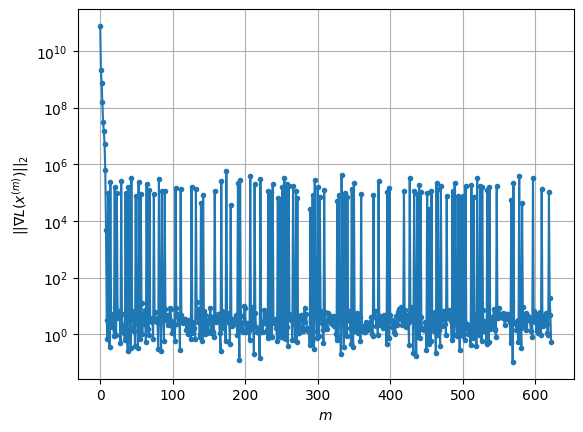

Windows:  33%|███▎      | 97/296 [17:08<45:04, 13.59s/it]

Before applying the algorithm
Cost function: -23635138.25409218
Gradient norm: 75623.5860537427
Global relative error: 1.874544435719892
Position relative errors: 0.00826722846043289 m, 1.0462198638511384 m, 0.9427305441834464 m, 1.2371458745118542 m

Iteration 1
Cost function: -23635138.975747526 (-0.00%)
Gradient norm: 9.122813510511545 (-99.99%)
Global relative error: 1.595564292502868 (-14.88%)
Position relative errors: 0.016978556961397256 m, 1.0151552642007762 m, 0.7795655284585477 m, 0.9525087535518157 m

Iteration 2
Cost function: -23635138.975747846 (-0.00%)
Gradient norm: 6.522482017157554 (-28.50%)
Global relative error: 1.5955510168281672 (-0.00%)
Position relative errors: 0.016978551071195794 m, 1.015157929945524 m, 0.7795605566123576 m, 0.9524877432381883 m

Iteration 3
Cost function: -23635138.975747705 (0.00%)
Gradient norm: 2.271876851137498 (-65.17%)
Global relative error: 1.595551023717527 (0.00%)
Position relative errors: 0.016978556916319113 m, 1.0151579359387295 m

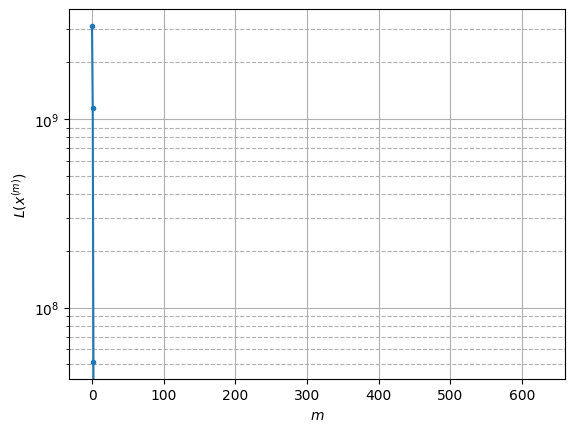

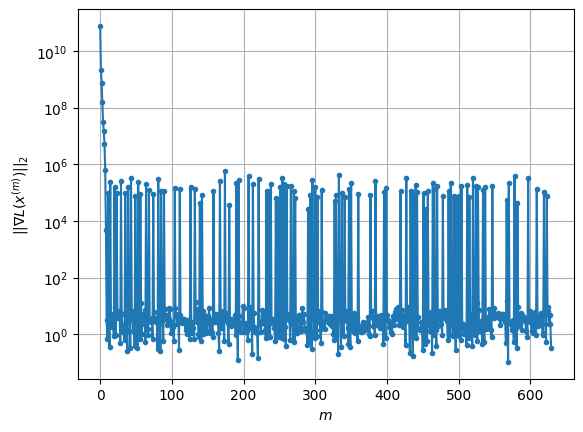

Windows:  33%|███▎      | 98/296 [17:21<43:58, 13.32s/it]

Before applying the algorithm
Cost function: -23635131.35803314
Gradient norm: 96978.17010772
Global relative error: 1.6164617054630228
Position relative errors: 0.01719566571774567 m, 0.9911860314709764 m, 0.7700407792518793 m, 1.0184491545218837 m

Iteration 1
Cost function: -23635131.796179492 (-0.00%)
Gradient norm: 6.9512107471196325 (-99.99%)
Global relative error: 2.1357132465293276 (32.12%)
Position relative errors: 0.01537227268148977 m, 1.2968822337136878 m, 0.9566100717430812 m, 1.4014374598959038 m

Iteration 2
Cost function: -23635131.796179686 (-0.00%)
Gradient norm: 1.9814867241501286 (-71.49%)
Global relative error: 2.135713476639537 (0.00%)
Position relative errors: 0.015372270697769544 m, 1.296889446004536 m, 0.9566106598807246 m, 1.4014307348833093 m

Iteration 3
Cost function: -23635131.796179514 (0.00%)
Gradient norm: 2.7705344730640467 (39.82%)
Global relative error: 2.135713471762797 (-0.00%)
Position relative errors: 0.01537227089889038 m, 1.2968894447563164 m, 

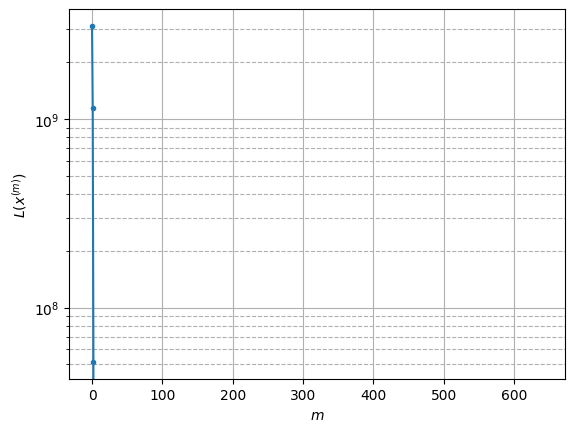

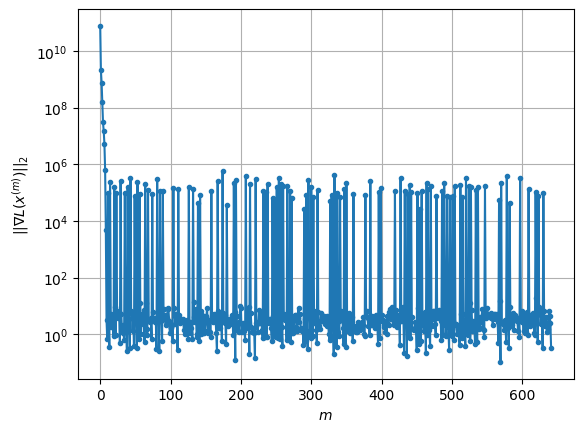

Windows:  33%|███▎      | 99/296 [17:43<51:57, 15.82s/it]

Before applying the algorithm
Cost function: -23635133.32581028
Gradient norm: 142692.77596940935
Global relative error: 2.149922453286966
Position relative errors: 0.015424475563622073 m, 1.2684560523561965 m, 0.9445875569714519 m, 1.4562626262713247 m

Iteration 1
Cost function: -23635133.752554104 (-0.00%)
Gradient norm: 3.7877034614806084 (-100.00%)
Global relative error: 2.218499790456356 (3.19%)
Position relative errors: 0.019148771401290034 m, 1.2121129403888604 m, 0.8864386627654065 m, 1.6329058903379206 m

Iteration 2
Cost function: -23635133.752553828 (0.00%)
Gradient norm: 1.4997749534263012 (-60.40%)
Global relative error: 2.218492542846184 (-0.00%)
Position relative errors: 0.019148775487327185 m, 1.2121236873984558 m, 0.8864331780659768 m, 1.6328910433152366 m

Iteration 3
Cost function: -23635133.752553497 (0.00%)
Gradient norm: 1.6658721396859621 (11.07%)
Global relative error: 2.2184925384048007 (-0.00%)
Position relative errors: 0.0191487742735941 m, 1.212123681021717

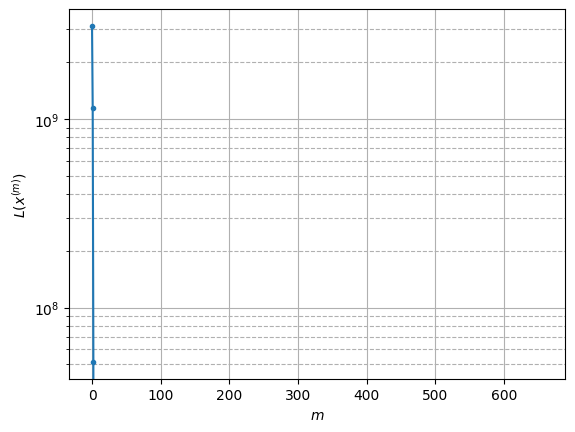

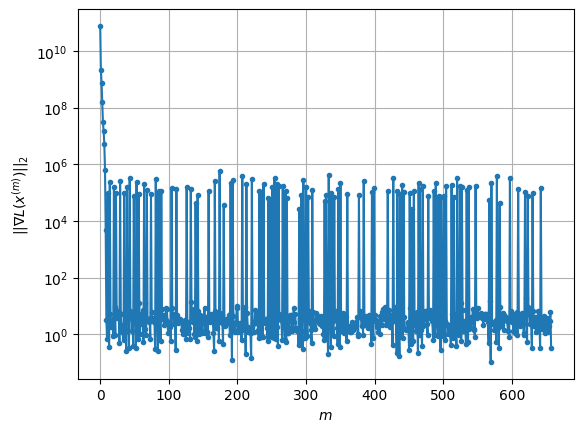

Windows:  34%|███▍      | 100/296 [18:11<1:03:59, 19.59s/it]

Before applying the algorithm
Cost function: -23635132.689065896
Gradient norm: 87327.09574856504
Global relative error: 2.2365926349600813
Position relative errors: 0.018793883364969597 m, 1.1815883182692408 m, 0.8684195072024821 m, 1.6886942844774644 m

Iteration 1
Cost function: -23635132.971621487 (-0.00%)
Gradient norm: 2.5243998222265125 (-100.00%)
Global relative error: 1.9036847967761115 (-14.88%)
Position relative errors: 0.016065250215794583 m, 0.9811620680515012 m, 0.7450008598816024 m, 1.451223956284417 m

Iteration 2
Cost function: -23635132.971621495 (-0.00%)
Gradient norm: 1.0508834898453896 (-58.37%)
Global relative error: 1.9036623062241838 (-0.00%)
Position relative errors: 0.01606524086093821 m, 0.9811463268375692 m, 0.7449925304715271 m, 1.4512093722604211 m

STOP on Iteration 3
Cost function = -23635132.971621785 (-0.00%)
Gradient norm = 0.6383668114274245 (-39.25%)
Global relative error = 1.903662294784923 (-0.00%)
Final position relative errors: 0.016065241451566

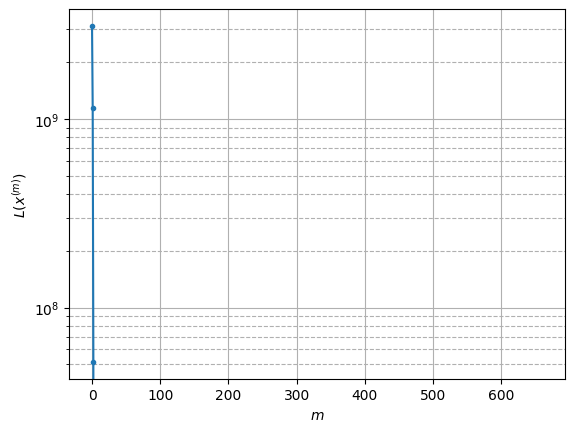

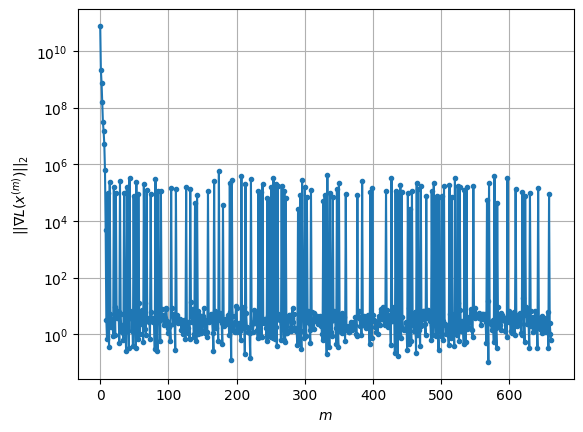

Windows:  34%|███▍      | 101/296 [18:18<51:47, 15.94s/it]  

Before applying the algorithm
Cost function: -23635131.69179755
Gradient norm: 60700.93504666517
Global relative error: 1.920352117155179
Position relative errors: 0.01598980317700558 m, 0.9519830124790538 m, 0.7238019663289299 m, 1.502442759560761 m

Iteration 1
Cost function: -23635131.99135473 (-0.00%)
Gradient norm: 3.408919737454948 (-99.99%)
Global relative error: 2.1764980294075347 (13.34%)
Position relative errors: 0.019744451961578386 m, 1.0115793213796738 m, 0.7727087415216072 m, 1.7653273390446904 m

Iteration 2
Cost function: -23635131.991354436 (0.00%)
Gradient norm: 1.0171044604002373 (-70.16%)
Global relative error: 2.176497258343959 (-0.00%)
Position relative errors: 0.01974445181242813 m, 1.011592873582289 m, 0.7727120887854196 m, 1.76531715739277 m

Iteration 3
Cost function: -23635131.991355117 (-0.00%)
Gradient norm: 3.1245767777942643 (207.20%)
Global relative error: 2.1764972615818095 (0.00%)
Position relative errors: 0.01974444711121998 m, 1.0115928824265648 m, 0

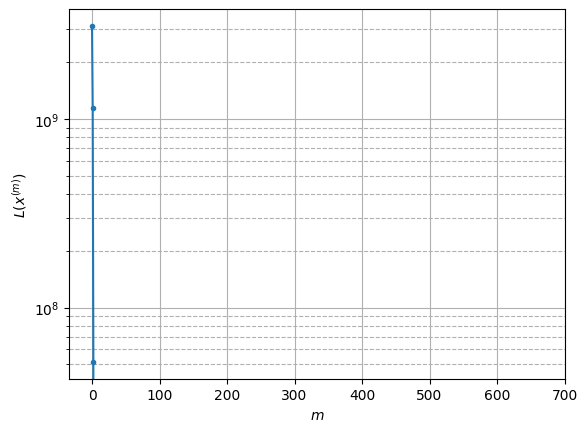

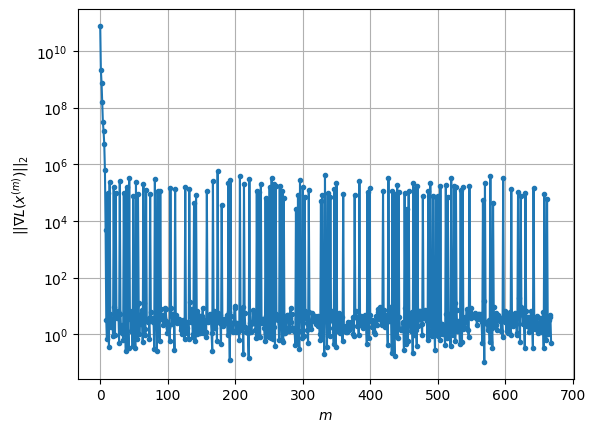

Windows:  34%|███▍      | 102/296 [18:31<48:13, 14.91s/it]

Before applying the algorithm
Cost function: -23635127.233264808
Gradient norm: 108909.60782949906
Global relative error: 2.1967027877063985
Position relative errors: 0.019371791706185883 m, 0.9823030446247871 m, 0.7517689597703415 m, 1.8152273799346954 m

Iteration 1
Cost function: -23635127.568696544 (-0.00%)
Gradient norm: 4.097559771471296 (-100.00%)
Global relative error: 1.9637524271396163 (-10.60%)
Position relative errors: 0.015486741417595318 m, 0.9648835118788518 m, 0.7116741808298714 m, 1.5551854895231132 m

Iteration 2
Cost function: -23635127.568696775 (-0.00%)
Gradient norm: 3.0122219691692655 (-26.49%)
Global relative error: 1.9637292686792986 (-0.00%)
Position relative errors: 0.015486739281994658 m, 0.9648866205386853 m, 0.7116709998793844 m, 1.555155773892993 m

Iteration 3
Cost function: -23635127.568696648 (0.00%)
Gradient norm: 1.3999974554473669 (-53.52%)
Global relative error: 1.9637292747218889 (0.00%)
Position relative errors: 0.015486745534986385 m, 0.96488662

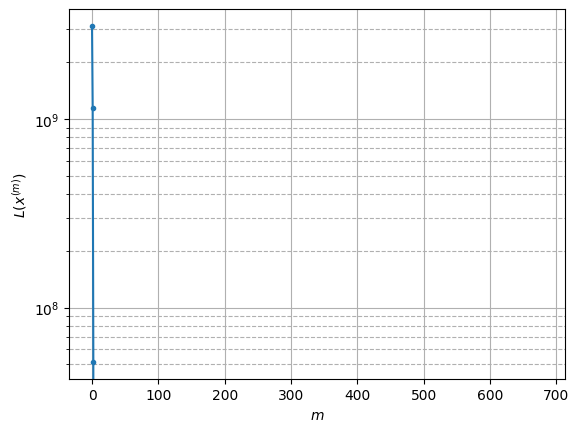

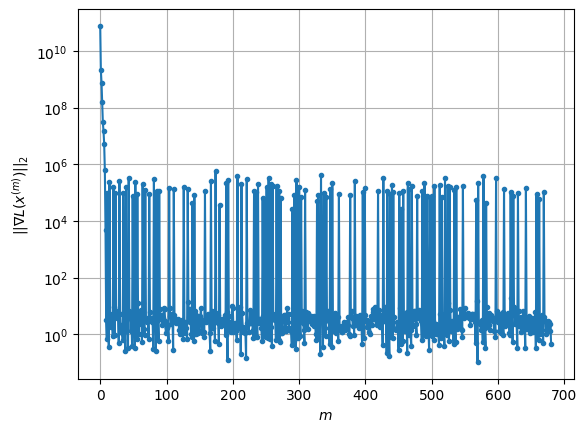

Windows:  35%|███▍      | 103/296 [18:50<52:04, 16.19s/it]

Before applying the algorithm
Cost function: -23635127.608937316
Gradient norm: 237638.30116809785
Global relative error: 1.9808719588866595
Position relative errors: 0.015589916640066528 m, 0.9375370869136914 m, 0.6954279323655782 m, 1.6003166662513861 m

Iteration 1
Cost function: -23635127.892660957 (-0.00%)
Gradient norm: 1.6972608051364684 (-100.00%)
Global relative error: 2.0591318871304947 (3.95%)
Position relative errors: 0.01689596627585195 m, 0.9294015245130852 m, 0.7363502969817559 m, 1.6833710101994082 m

Iteration 2
Cost function: -23635127.89266066 (0.00%)
Gradient norm: 3.9318611109239328 (131.66%)
Global relative error: 2.059134686230248 (0.00%)
Position relative errors: 0.016895963966758295 m, 0.9294026896704038 m, 0.7363504734962829 m, 1.6833737136304339 m

STOP on Iteration 3
Cost function = -23635127.89266074 (-0.00%)
Gradient norm = 0.9533072920434361 (-75.75%)
Global relative error = 2.0591346952225233 (0.00%)
Final position relative errors: 0.016895967757313318 m

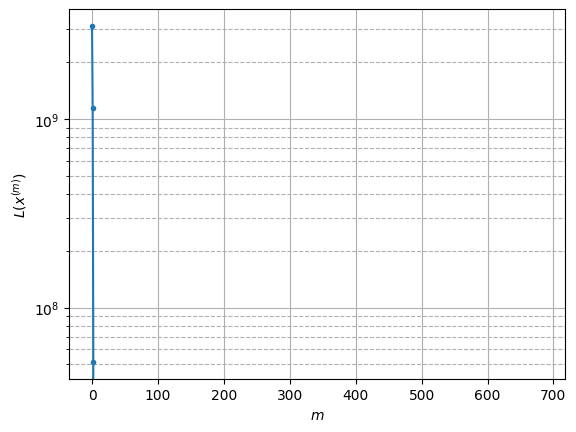

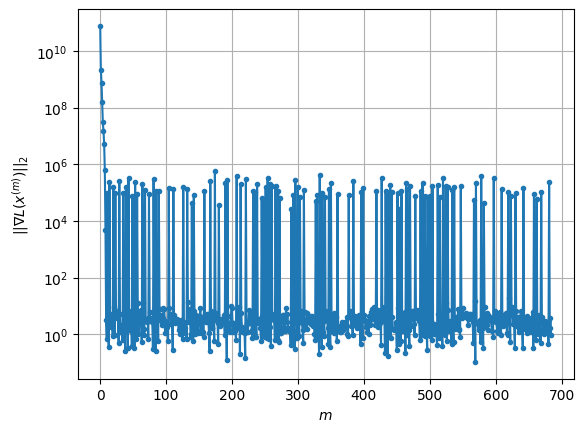

Windows:  35%|███▌      | 104/296 [18:57<42:35, 13.31s/it]

Before applying the algorithm
Cost function: -23635124.97257083
Gradient norm: 60872.571631935774
Global relative error: 2.0749532007218594
Position relative errors: 0.017733036380726763 m, 0.8965621876363229 m, 0.7192675369050351 m, 1.7274099454073992 m

Iteration 1
Cost function: -23635125.43457012 (-0.00%)
Gradient norm: 4.52658160060485 (-99.99%)
Global relative error: 2.040174147271055 (-1.68%)
Position relative errors: 0.018678847098944216 m, 0.96105192104289 m, 0.8586616477951255 m, 1.5814675506102522 m

Iteration 2
Cost function: -23635125.434569873 (0.00%)
Gradient norm: 5.1270379828966215 (13.27%)
Global relative error: 2.040184592840365 (0.00%)
Position relative errors: 0.018678846038737013 m, 0.961069111641602 m, 0.8586726092484165 m, 1.5814646276317388 m

Iteration 3
Cost function: -23635125.43456979 (0.00%)
Gradient norm: 2.334271000174838 (-54.47%)
Global relative error: 2.04018458243858 (-0.00%)
Position relative errors: 0.018678840949499696 m, 0.9610691126355313 m, 0.8

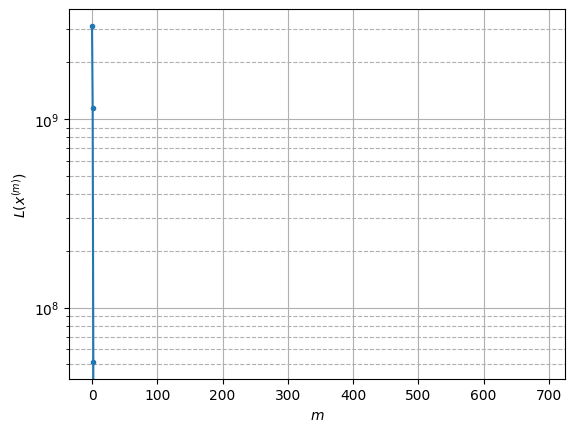

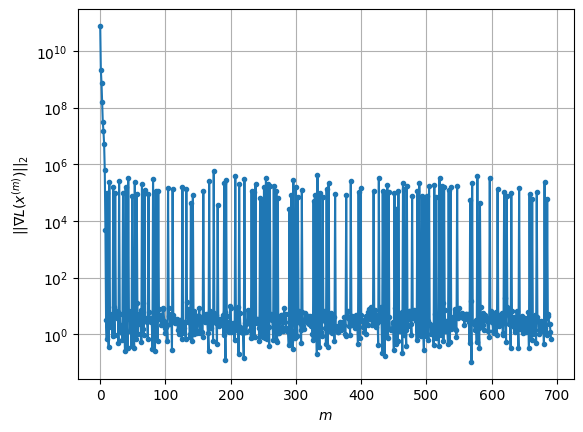

Windows:  35%|███▌      | 105/296 [19:08<40:27, 12.71s/it]

Before applying the algorithm
Cost function: -23635114.945567735
Gradient norm: 114008.13998803309
Global relative error: 2.029459667091136
Position relative errors: 0.018711385732690745 m, 0.9162033694714834 m, 0.8330934120185671 m, 1.6077567285291423 m

Iteration 1
Cost function: -23635115.77616178 (-0.00%)
Gradient norm: 16.682388171480525 (-99.99%)
Global relative error: 1.8130800414762134 (-10.66%)
Position relative errors: 0.010751444910841271 m, 0.8817626787077305 m, 0.878404449412714 m, 1.3183484228352977 m

Iteration 2
Cost function: -23635115.77616148 (0.00%)
Gradient norm: 7.818402163295833 (-53.13%)
Global relative error: 1.8130760626163653 (-0.00%)
Position relative errors: 0.01075144800426945 m, 0.8817593539659578 m, 0.8784037515069159 m, 1.3183456395414537 m

Iteration 3
Cost function: -23635115.776162207 (-0.00%)
Gradient norm: 7.3284735604266045 (-6.27%)
Global relative error: 1.8130760625603555 (-0.00%)
Position relative errors: 0.010751454370127393 m, 0.8817593508581

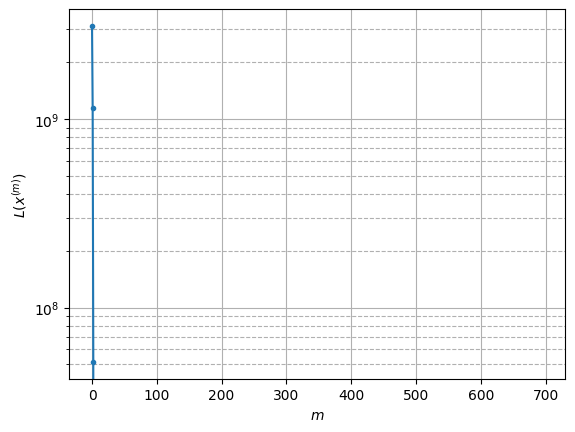

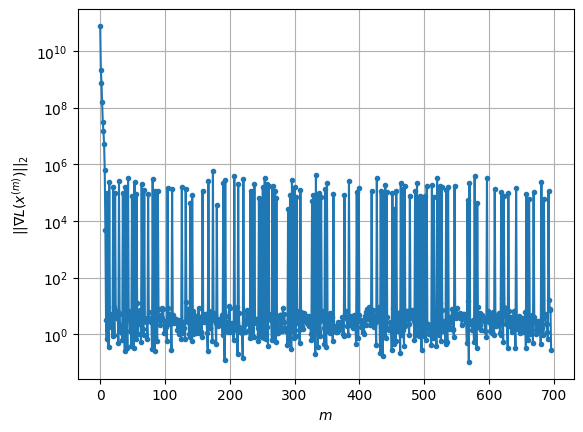

Windows:  36%|███▌      | 106/296 [19:16<36:00, 11.37s/it]

Before applying the algorithm
Cost function: -23635112.776603978
Gradient norm: 201371.08000131397
Global relative error: 1.7708199967934857
Position relative errors: 0.010991266241459694 m, 0.8355688132282761 m, 0.8466915816942161 m, 1.31172378945343 m

Iteration 1
Cost function: -23635113.41341536 (-0.00%)
Gradient norm: 4.292471132789874 (-100.00%)
Global relative error: 1.8391930816293152 (3.86%)
Position relative errors: 0.010371954469757631 m, 0.9691266588877953 m, 0.729334846163982 m, 1.3825289316296354 m

Iteration 2
Cost function: -23635113.413414977 (0.00%)
Gradient norm: 3.327032011444389 (-22.49%)
Global relative error: 1.8392060874250045 (0.00%)
Position relative errors: 0.010371953729235096 m, 0.9691315787528685 m, 0.7293458690595341 m, 1.382536969655302 m

Iteration 3
Cost function: -23635113.413414963 (0.00%)
Gradient norm: 2.711429116240597 (-18.50%)
Global relative error: 1.8392061212893356 (0.00%)
Position relative errors: 0.010371957176413255 m, 0.969131581471623 m,

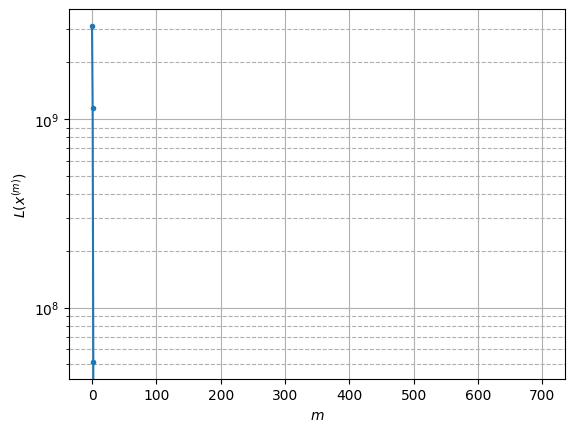

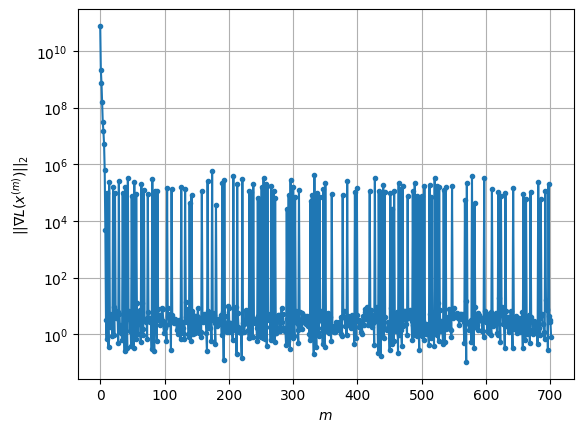

Windows:  36%|███▌      | 107/296 [19:25<33:17, 10.57s/it]

Before applying the algorithm
Cost function: -23635104.082614698
Gradient norm: 263684.81823743903
Global relative error: 1.7951859336935456
Position relative errors: 0.010726159387764151 m, 0.9199606257002214 m, 0.690999373506404 m, 1.377957918460962 m

Iteration 1
Cost function: -23635105.04336579 (-0.00%)
Gradient norm: 5.117870701452625 (-100.00%)
Global relative error: 1.6473988145141452 (-8.23%)
Position relative errors: 0.007526173663838343 m, 0.6757374848459546 m, 0.720998121929584 m, 1.3181067150112615 m

STOP on Iteration 2
Cost function = -23635105.043365948 (-0.00%)
Gradient norm = 0.9556247306733754 (-81.33%)
Global relative error = 1.6473994320986278 (0.00%)
Final position relative errors: 0.007526174619982946 m, 0.6757423575291999 m, 0.7210047144384789 m, 1.3181013827610655 m



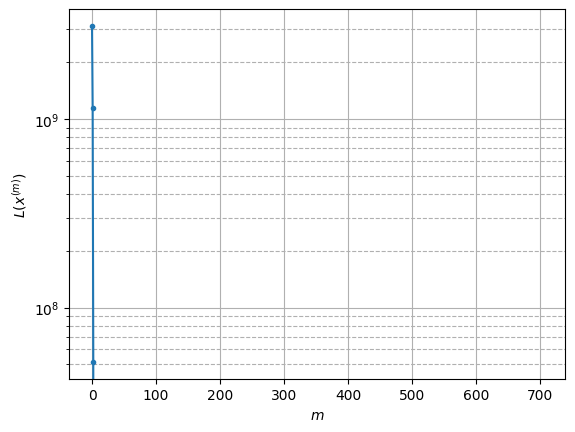

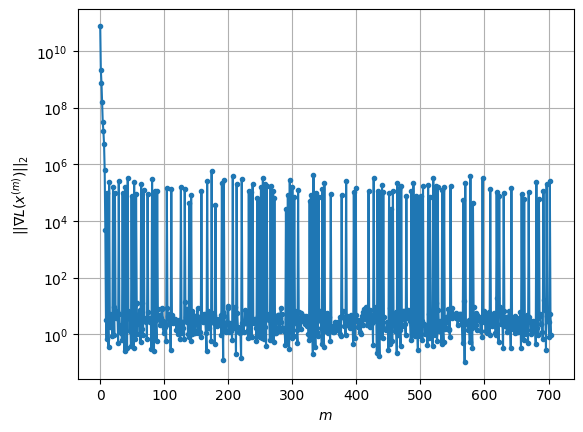

Windows:  36%|███▋      | 108/296 [19:30<27:57,  8.92s/it]

Before applying the algorithm
Cost function: -23635114.717633013
Gradient norm: 54935.958823994355
Global relative error: 1.6204753990012397
Position relative errors: 0.008113597651178616 m, 0.6308375427485787 m, 0.6910818650149164 m, 1.3229977182366623 m

Iteration 1
Cost function: -23635115.282181025 (-0.00%)
Gradient norm: 5.594746662632352 (-99.99%)
Global relative error: 1.6408007172524566 (1.25%)
Position relative errors: 0.012360872037718264 m, 0.7003613538155964 m, 0.7824466955966594 m, 1.2606917527948749 m

Iteration 2
Cost function: -23635115.282180857 (0.00%)
Gradient norm: 7.610623544909674 (36.03%)
Global relative error: 1.6408034035804109 (0.00%)
Position relative errors: 0.012360871030869027 m, 0.7003648666013111 m, 0.7824463345609547 m, 1.26069352168222 m

Iteration 3
Cost function: -23635115.28218043 (0.00%)
Gradient norm: 6.728063554876964 (-11.60%)
Global relative error: 1.6408033758301621 (-0.00%)
Position relative errors: 0.012360870151922887 m, 0.7003648642292389 

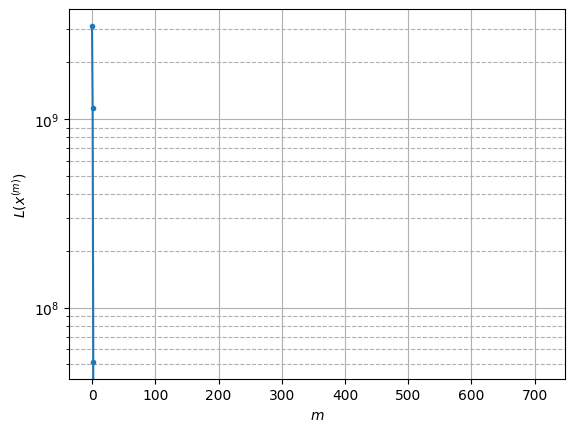

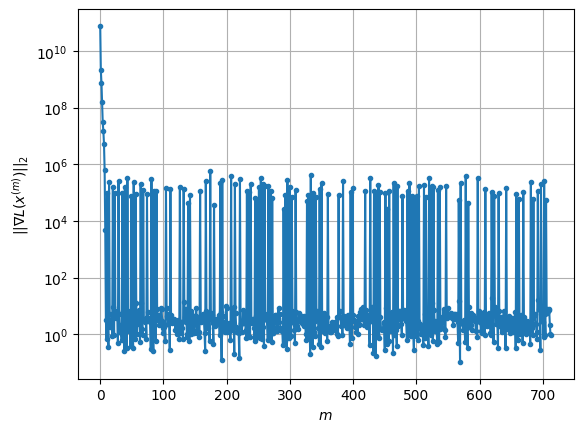

Windows:  37%|███▋      | 109/296 [19:45<33:09, 10.64s/it]

Before applying the algorithm
Cost function: -23635117.6507651
Gradient norm: 136813.5720423037
Global relative error: 1.6213474164034087
Position relative errors: 0.01248446471490914 m, 0.6616629562893226 m, 0.7596968608337695 m, 1.2703041737447005 m

Iteration 1
Cost function: -23635118.13582592 (-0.00%)
Gradient norm: 3.211289780017716 (-100.00%)
Global relative error: 1.714357322210725 (5.74%)
Position relative errors: 0.011340882212886766 m, 0.6783901948210277 m, 0.9058490707220154 m, 1.2876779750071259 m

Iteration 2
Cost function: -23635118.13582671 (-0.00%)
Gradient norm: 6.1119972382921075 (90.33%)
Global relative error: 1.7143680236719385 (0.00%)
Position relative errors: 0.011340885958631383 m, 0.6783946057865704 m, 0.9058544466510965 m, 1.2876861167478824 m

Iteration 3
Cost function: -23635118.135826267 (0.00%)
Gradient norm: 2.277610326968781 (-62.74%)
Global relative error: 1.7143679959513518 (-0.00%)
Position relative errors: 0.011340879333590287 m, 0.678394607736456 m,

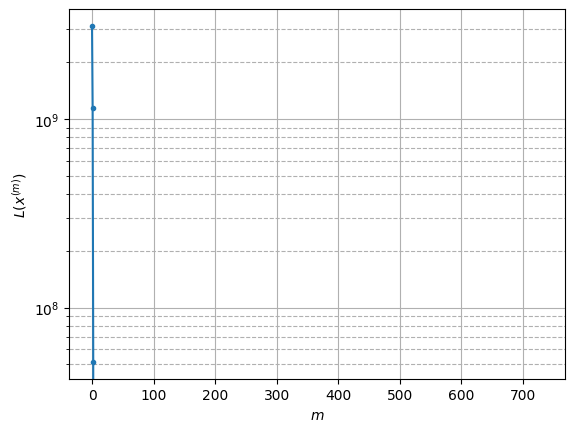

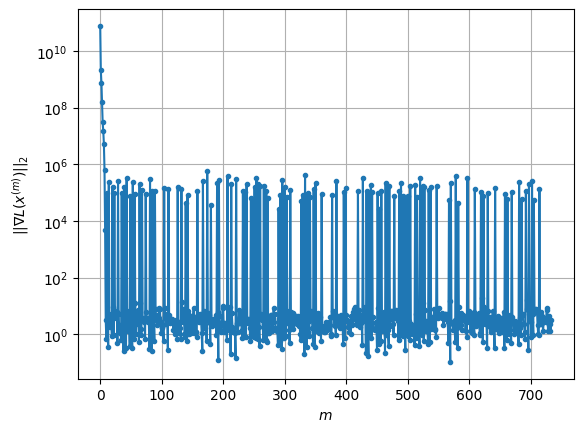

Windows:  37%|███▋      | 110/296 [20:16<52:25, 16.91s/it]

Before applying the algorithm
Cost function: -23635111.10853234
Gradient norm: 247218.59169145778
Global relative error: 1.7020957730518913
Position relative errors: 0.011636099816272009 m, 0.6510008353443558 m, 0.8841507413802973 m, 1.3005644937373768 m

Iteration 1
Cost function: -23635111.673295945 (-0.00%)
Gradient norm: 8.186313959231823 (-100.00%)
Global relative error: 1.4124705409164362 (-17.02%)
Position relative errors: 0.022808595328759874 m, 0.5411580028829744 m, 0.7851567142326764 m, 1.0417429174788715 m

Iteration 2
Cost function: -23635111.67329548 (0.00%)
Gradient norm: 4.976348368600725 (-39.21%)
Global relative error: 1.4124878478813399 (0.00%)
Position relative errors: 0.02280858611495341 m, 0.5411619862934218 m, 0.785163829683944 m, 1.041758951549478 m

Iteration 3
Cost function: -23635111.67329517 (0.00%)
Gradient norm: 2.72037764690238 (-45.33%)
Global relative error: 1.4124878602948832 (0.00%)
Position relative errors: 0.02280859082171526 m, 0.5411619927195821 m,

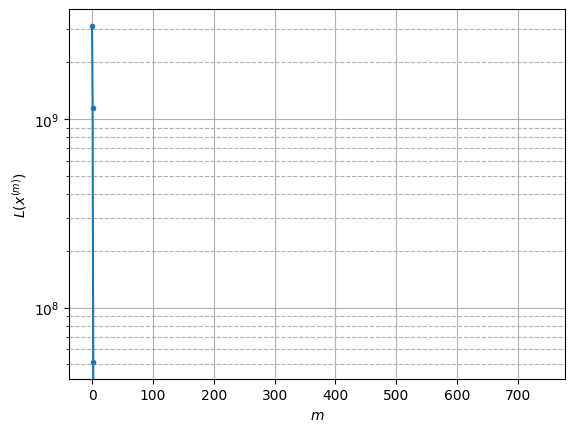

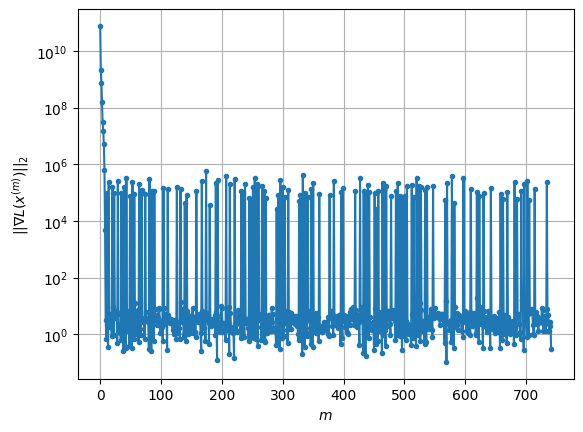

Windows:  38%|███▊      | 111/296 [20:29<48:16, 15.65s/it]

Before applying the algorithm
Cost function: -23635109.585021175
Gradient norm: 256631.57799572748
Global relative error: 1.394944384418959
Position relative errors: 0.022451494819599502 m, 0.527583359517173 m, 0.7640538959530907 m, 1.0407890142454779 m

Iteration 1
Cost function: -23635110.404824674 (-0.00%)
Gradient norm: 4.939647549330892 (-100.00%)
Global relative error: 1.5303636325398111 (9.71%)
Position relative errors: 0.027826601624459886 m, 0.5371706759843621 m, 0.9545564599307579 m, 1.0684130003285097 m

Iteration 2
Cost function: -23635110.404824313 (0.00%)
Gradient norm: 2.386473174254169 (-51.69%)
Global relative error: 1.5303702063346885 (0.00%)
Position relative errors: 0.027826600932386016 m, 0.5371734340980839 m, 0.9545607055335077 m, 1.0684172365772202 m

Iteration 3
Cost function: -23635110.404824503 (-0.00%)
Gradient norm: 3.171787433410521 (32.91%)
Global relative error: 1.5303702273514417 (0.00%)
Position relative errors: 0.027826605725491733 m, 0.537173428883810

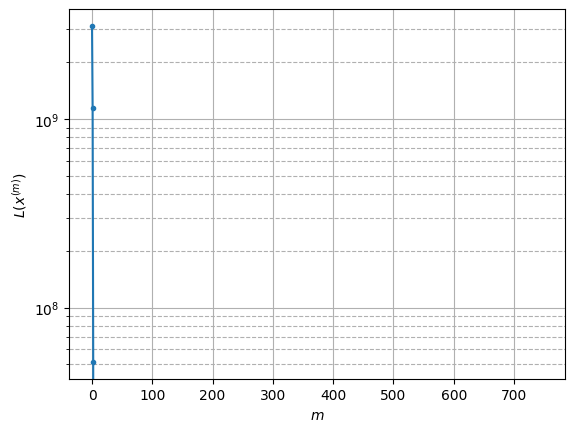

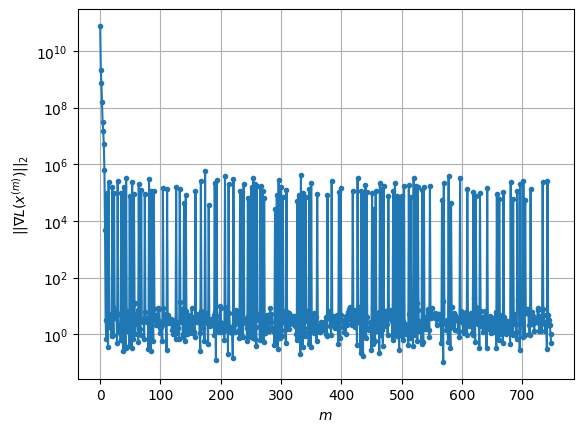

Windows:  38%|███▊      | 112/296 [20:41<44:53, 14.64s/it]

Before applying the algorithm
Cost function: -23635113.51115473
Gradient norm: 242971.81523186254
Global relative error: 1.509893695502225
Position relative errors: 0.026892649207678403 m, 0.5170802803696652 m, 0.9304229571007734 m, 1.0705116077525947 m

Iteration 1
Cost function: -23635114.752098437 (-0.00%)
Gradient norm: 10.75449617535703 (-100.00%)
Global relative error: 1.241645429801401 (-17.77%)
Position relative errors: 0.025298169396307326 m, 0.5932207879650112 m, 0.6413611287133679 m, 0.8819224835607145 m

Iteration 2
Cost function: -23635114.75209833 (0.00%)
Gradient norm: 1.3915982703236067 (-87.06%)
Global relative error: 1.2416684346135196 (0.00%)
Position relative errors: 0.025298174894019268 m, 0.5932209886315251 m, 0.6413812248398018 m, 0.8819401219223907 m

STOP on Iteration 3
Cost function = -23635114.75209839 (-0.00%)
Gradient norm = 0.36399901116973665 (-73.84%)
Global relative error = 1.2416684402615696 (0.00%)
Final position relative errors: 0.025298178555731212 

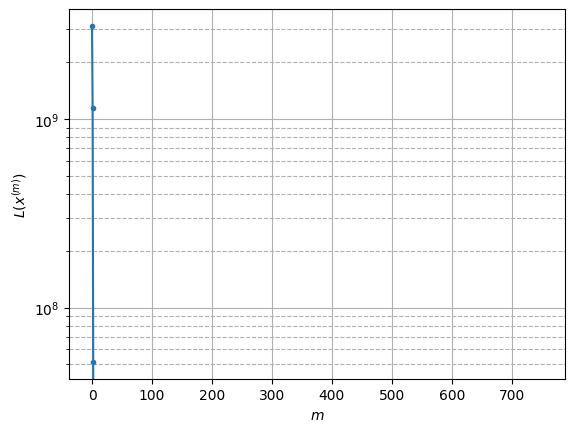

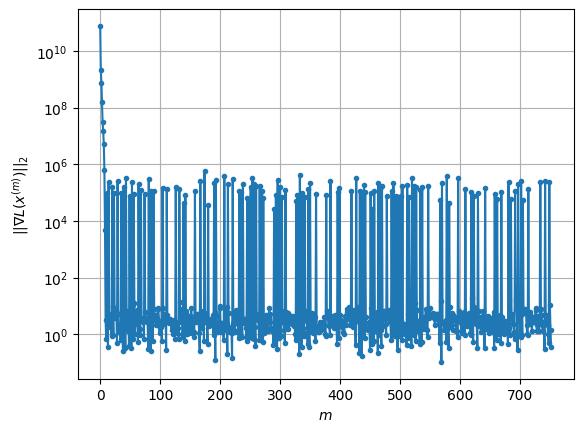

Windows:  38%|███▊      | 113/296 [20:49<38:09, 12.51s/it]

Before applying the algorithm
Cost function: -23635108.3222511
Gradient norm: 398460.7654155185
Global relative error: 1.2277921868263286
Position relative errors: 0.024276031974256467 m, 0.5945967695133593 m, 0.6212712264175039 m, 0.8759908612438089 m

Iteration 1
Cost function: -23635109.252323348 (-0.00%)
Gradient norm: 9.063290643812891 (-100.00%)
Global relative error: 1.2472970768275746 (1.59%)
Position relative errors: 0.018914070084412506 m, 0.662629401090917 m, 0.7746499568866607 m, 0.718491944441999 m

STOP on Iteration 2
Cost function = -23635109.2523231 (0.00%)
Gradient norm = 0.9361931410702794 (-89.67%)
Global relative error = 1.2472992444106472 (0.00%)
Final position relative errors: 0.018914070961434486 m, 0.662625273809857 m, 0.7746485381468851 m, 0.7185010432659457 m



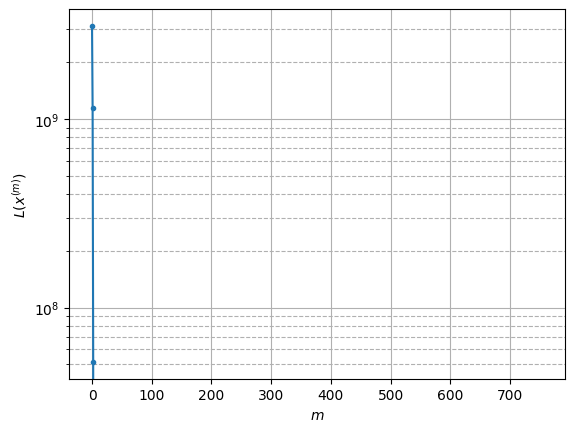

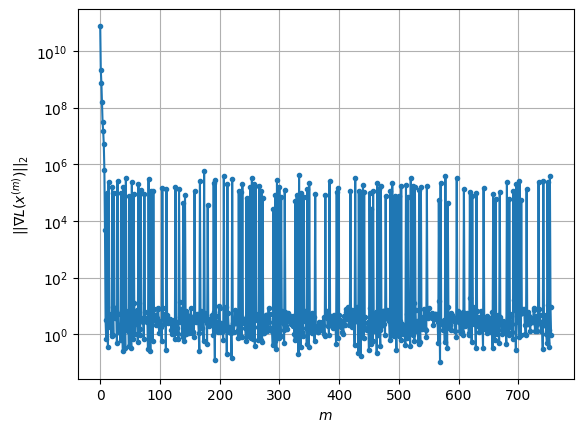

Windows:  39%|███▊      | 114/296 [20:54<31:41, 10.45s/it]

Before applying the algorithm
Cost function: -23635104.75382454
Gradient norm: 71631.41726982158
Global relative error: 1.221198030115602
Position relative errors: 0.018550078219062 m, 0.6624580143612351 m, 0.7501341612890617 m, 0.6995908561615036 m

Iteration 1
Cost function: -23635105.475527983 (-0.00%)
Gradient norm: 9.862282771964372 (-99.99%)
Global relative error: 1.1262060690839013 (-7.78%)
Position relative errors: 0.022947854115563316 m, 0.352237742048308 m, 0.7662439598094353 m, 0.7460633514695614 m

STOP on Iteration 2
Cost function = -23635105.475527726 (0.00%)
Gradient norm = 0.49448527408497195 (-94.99%)
Global relative error = 1.1262550822150705 (0.00%)
Final position relative errors: 0.022947865339008902 m, 0.3522201994100994 m, 0.7662784018000708 m, 0.7461102455602243 m



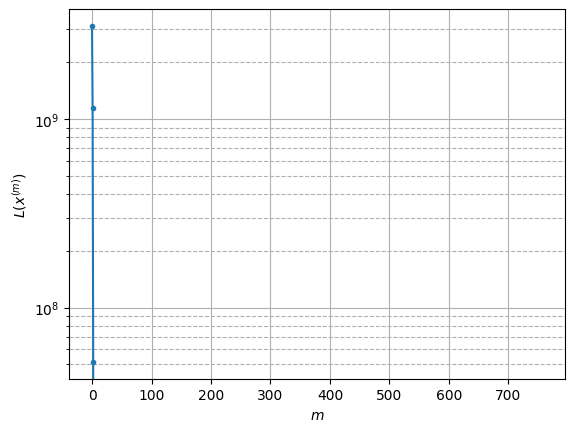

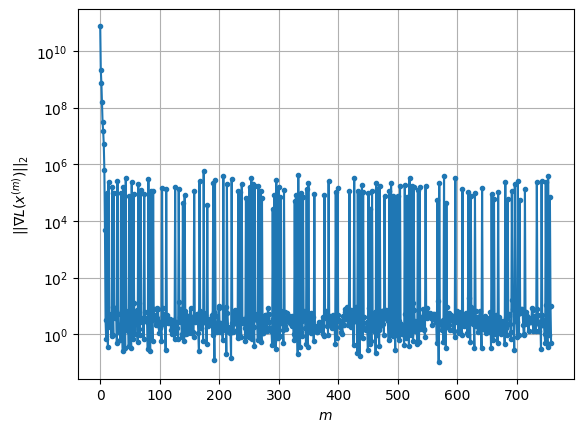

Windows:  39%|███▉      | 115/296 [21:00<27:14,  9.03s/it]

Before applying the algorithm
Cost function: -23635107.3536484
Gradient norm: 112378.1447772502
Global relative error: 1.084493881345082
Position relative errors: 0.02243898510723966 m, 0.3605890044291662 m, 0.7374099715419499 m, 0.7083952033571644 m

Iteration 1
Cost function: -23635108.20899007 (-0.00%)
Gradient norm: 4.1403765169682885 (-100.00%)
Global relative error: 1.1178008884109318 (3.07%)
Position relative errors: 0.009154269214460997 m, 0.40077254215291624 m, 0.6824821369957644 m, 0.789298676991016 m

Iteration 2
Cost function: -23635108.20899014 (-0.00%)
Gradient norm: 1.4078499077402726 (-66.00%)
Global relative error: 1.1178068952490623 (0.00%)
Position relative errors: 0.009154269686732434 m, 0.4007724588229625 m, 0.6824857835214183 m, 0.7893040731035073 m

Iteration 3
Cost function: -23635108.208989967 (0.00%)
Gradient norm: 3.0159182701206277 (114.22%)
Global relative error: 1.1178069082571065 (0.00%)
Position relative errors: 0.009154269881867488 m, 0.4007724573318857

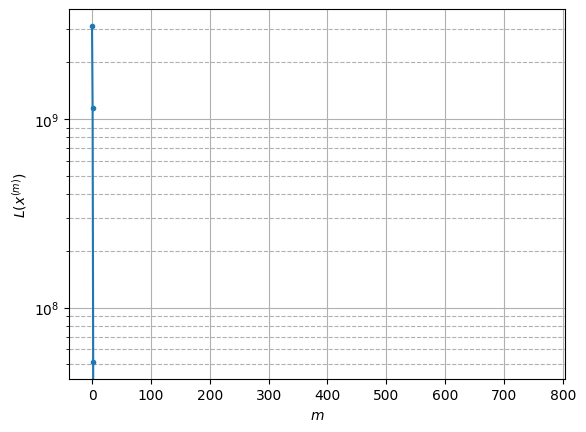

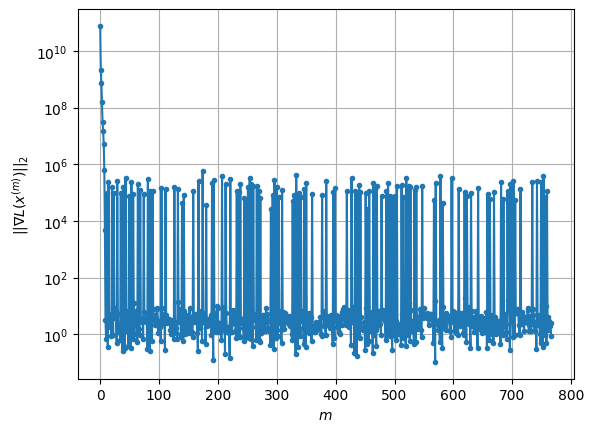

Windows:  39%|███▉      | 116/296 [21:14<31:53, 10.63s/it]

Before applying the algorithm
Cost function: -23635108.83020561
Gradient norm: 217594.38542914594
Global relative error: 1.0686983245852375
Position relative errors: 0.009507120629447141 m, 0.39651427157211094 m, 0.64638081948065 m, 0.7529885631111456 m

Iteration 1
Cost function: -23635109.35690044 (-0.00%)
Gradient norm: 4.551503787812394 (-100.00%)
Global relative error: 1.072459495077751 (0.35%)
Position relative errors: 0.014116569573933724 m, 0.2228707300597019 m, 0.5782556579928729 m, 0.8751664849478025 m

STOP on Iteration 2
Cost function = -23635109.356900454 (-0.00%)
Gradient norm = 0.5934297295584238 (-86.96%)
Global relative error = 1.0724571715216915 (-0.00%)
Final position relative errors: 0.01411657273470946 m, 0.22287128665676892 m, 0.5782606290357996 m, 0.8751602112125747 m



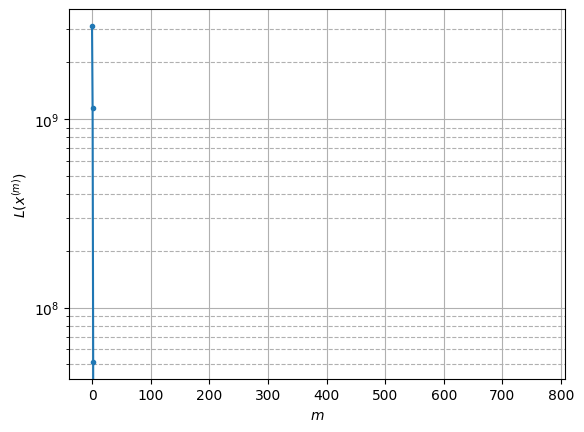

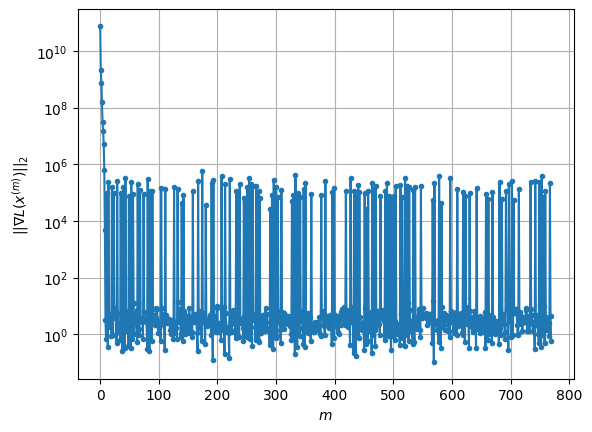

Windows:  40%|███▉      | 117/296 [21:20<27:28,  9.21s/it]

Before applying the algorithm
Cost function: -23635111.235205434
Gradient norm: 143209.57557149435
Global relative error: 1.0135897875445188
Position relative errors: 0.013897369608617885 m, 0.22934243866220924 m, 0.5366126846980448 m, 0.828623624437565 m

Iteration 1
Cost function: -23635112.06771649 (-0.00%)
Gradient norm: 8.634358493097059 (-99.99%)
Global relative error: 1.2113436677216654 (19.51%)
Position relative errors: 0.014012976185019975 m, 0.38205472820308395 m, 0.7129630912118399 m, 0.9015946870317403 m

Iteration 2
Cost function: -23635112.067716163 (0.00%)
Gradient norm: 4.604758486475798 (-46.67%)
Global relative error: 1.211384726166665 (0.00%)
Position relative errors: 0.014012969686533363 m, 0.3820623315865231 m, 0.7129912093282162 m, 0.9016243942595942 m

Iteration 3
Cost function: -23635112.067716498 (-0.00%)
Gradient norm: 3.1088441740953683 (-32.49%)
Global relative error: 1.2113847182339548 (-0.00%)
Position relative errors: 0.014012973344025187 m, 0.38206233942

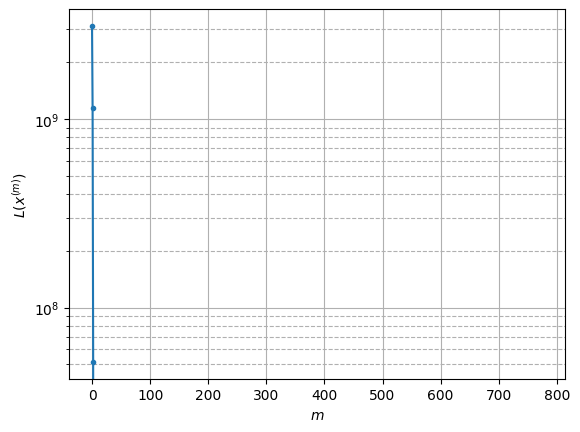

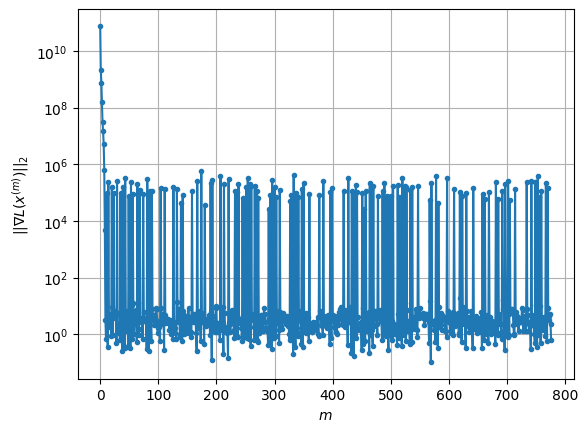

Windows:  40%|███▉      | 118/296 [21:33<30:37, 10.32s/it]

Before applying the algorithm
Cost function: -23635116.535989285
Gradient norm: 62240.16049830679
Global relative error: 1.1620331288350294
Position relative errors: 0.013715088950964544 m, 0.36991859420525586 m, 0.669882557938056 m, 0.8743846081571275 m

Iteration 1
Cost function: -23635116.92079544 (-0.00%)
Gradient norm: 2.5235840831416074 (-100.00%)
Global relative error: 1.108767868197981 (-4.58%)
Position relative errors: 0.022097582176508986 m, 0.5265557500825175 m, 0.6137796862453094 m, 0.7582145928062561 m

Iteration 2
Cost function: -23635116.920795538 (-0.00%)
Gradient norm: 1.8721597940378434 (-25.81%)
Global relative error: 1.108777357996652 (0.00%)
Position relative errors: 0.022097587114827073 m, 0.5265467145646977 m, 0.6137913981683051 m, 0.7582252636835278 m

Iteration 3
Cost function: -23635116.920796003 (-0.00%)
Gradient norm: 4.983492240499497 (166.19%)
Global relative error: 1.1087773421371674 (-0.00%)
Position relative errors: 0.022097586175495912 m, 0.52654671485

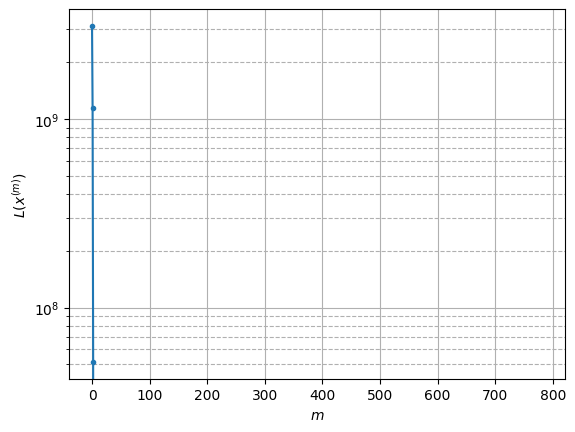

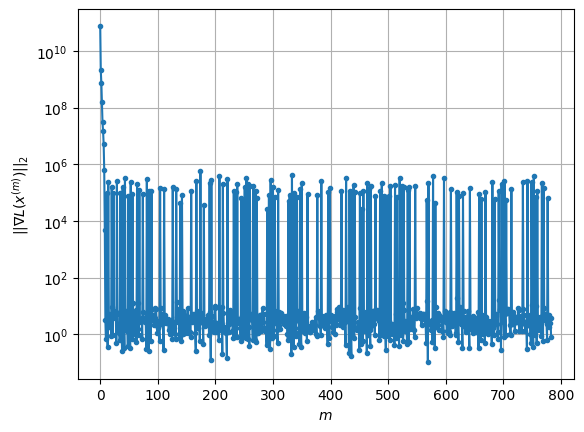

Windows:  40%|████      | 119/296 [21:46<32:34, 11.04s/it]

Before applying the algorithm
Cost function: -23635109.194398724
Gradient norm: 197994.06833937348
Global relative error: 1.0749957910990389
Position relative errors: 0.02135953443592043 m, 0.5310524020686057 m, 0.5779638246495592 m, 0.7342335097888009 m

Iteration 1
Cost function: -23635109.604128268 (-0.00%)
Gradient norm: 3.21849431890944 (-100.00%)
Global relative error: 1.0117339842762454 (-5.88%)
Position relative errors: 0.029054068280364553 m, 0.4572357288905129 m, 0.5000787414298227 m, 0.7507436421832664 m

Iteration 2
Cost function: -23635109.604127996 (0.00%)
Gradient norm: 2.672167403858441 (-16.97%)
Global relative error: 1.011726570067812 (-0.00%)
Position relative errors: 0.02905406517353555 m, 0.4572309189928048 m, 0.5000817118769273 m, 0.7507346014041939 m

Iteration 3
Cost function: -23635109.604127757 (0.00%)
Gradient norm: 1.8226196513094863 (-31.79%)
Global relative error: 1.0117265735695389 (0.00%)
Position relative errors: 0.029054072328401695 m, 0.45723092133018

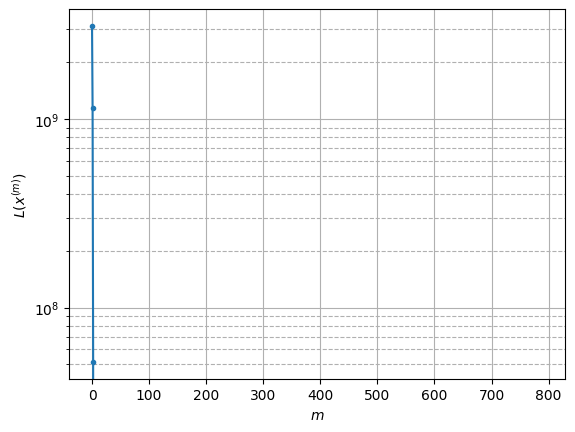

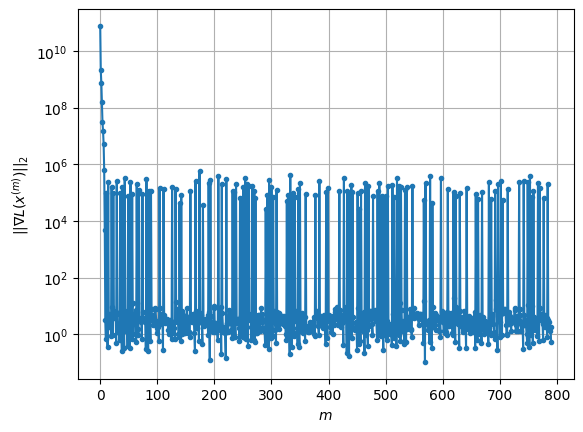

Windows:  41%|████      | 120/296 [21:59<34:02, 11.61s/it]

Before applying the algorithm
Cost function: -23635118.68513216
Gradient norm: 94578.6294756906
Global relative error: 0.9855753060397524
Position relative errors: 0.027819009407256828 m, 0.48140372773971035 m, 0.4696123352413886 m, 0.7199286497797396 m

Iteration 1
Cost function: -23635118.89732194 (-0.00%)
Gradient norm: 1.7141414723299264 (-100.00%)
Global relative error: 1.0551216695116814 (7.06%)
Position relative errors: 0.026166767671076212 m, 0.5378727933616733 m, 0.5496074139640534 m, 0.7219554109521684 m

Iteration 2
Cost function: -23635118.89732179 (0.00%)
Gradient norm: 2.511003731363051 (46.49%)
Global relative error: 1.055123089648127 (0.00%)
Position relative errors: 0.026166752926228023 m, 0.5378687694476375 m, 0.549606714783529 m, 0.7219610170892534 m

Iteration 3
Cost function: -23635118.897321988 (-0.00%)
Gradient norm: 4.297716543241747 (71.16%)
Global relative error: 1.0551231068585325 (0.00%)
Position relative errors: 0.026166762634814066 m, 0.5378687659472887 m,

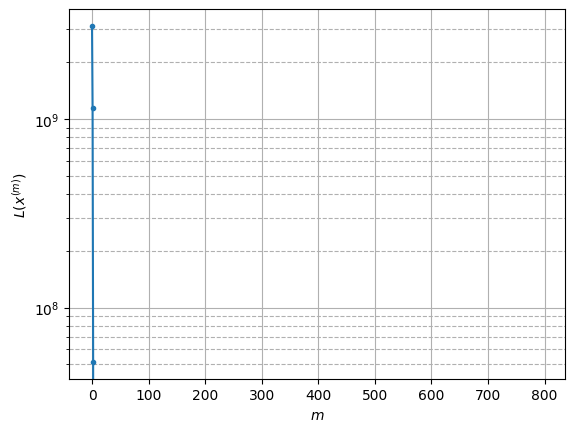

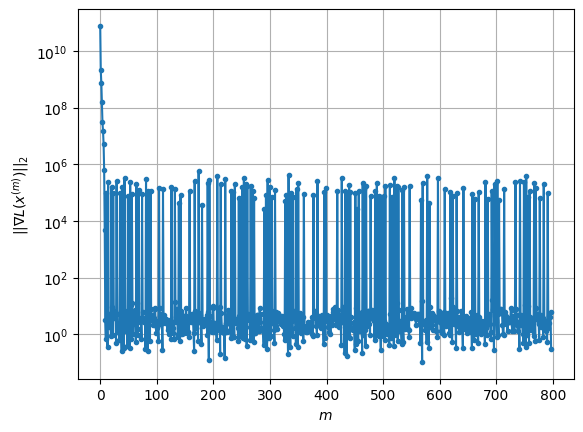

Windows:  41%|████      | 121/296 [22:11<33:56, 11.64s/it]

Before applying the algorithm
Cost function: -23635113.186975025
Gradient norm: 101136.50545404467
Global relative error: 1.0320644576005322
Position relative errors: 0.025075421090221865 m, 0.5548423267171515 m, 0.5264851933206156 m, 0.6924519313123263 m

Iteration 1
Cost function: -23635113.703722313 (-0.00%)
Gradient norm: 2.5089928893594795 (-100.00%)
Global relative error: 1.0852512903438396 (5.15%)
Position relative errors: 0.03639985666438401 m, 0.5814090467525656 m, 0.5461902093396103 m, 0.7349032609929348 m

Iteration 2
Cost function: -23635113.70372201 (0.00%)
Gradient norm: 1.90437959782764 (-24.10%)
Global relative error: 1.085251869851385 (0.00%)
Position relative errors: 0.036399860719118896 m, 0.5814094436408258 m, 0.5461891583708988 m, 0.7349045836624136 m

Iteration 3
Cost function: -23635113.70372294 (-0.00%)
Gradient norm: 2.4970370405373643 (31.12%)
Global relative error: 1.0852518546448415 (-0.00%)
Position relative errors: 0.036399860357379875 m, 0.581409445654332

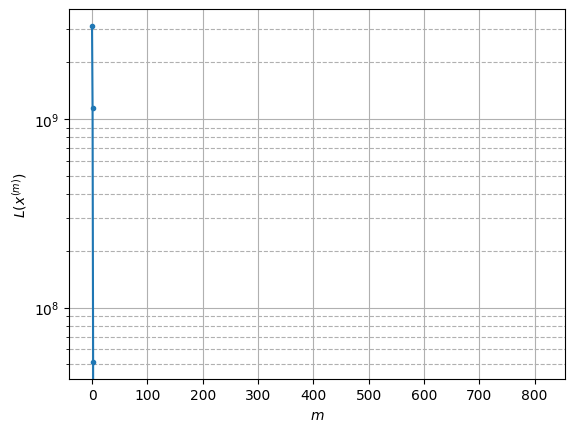

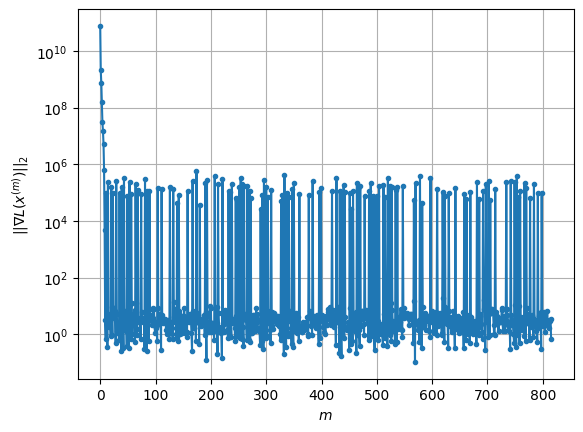

Windows:  41%|████      | 122/296 [22:39<48:30, 16.73s/it]

Before applying the algorithm
Cost function: -23635113.7654967
Gradient norm: 86175.16045573157
Global relative error: 1.0703557305392486
Position relative errors: 0.03477734787968615 m, 0.6000338610012338 m, 0.5346936756345106 m, 0.7060535830124033 m

Iteration 1
Cost function: -23635113.979085214 (-0.00%)
Gradient norm: 4.115609119422139 (-100.00%)
Global relative error: 1.1079650339871097 (3.51%)
Position relative errors: 0.03506856163152478 m, 0.7888279174871395 m, 0.49967535211179015 m, 0.5953398550870116 m

STOP on Iteration 2
Cost function = -23635113.97908471 (0.00%)
Gradient norm = 0.6143120606476501 (-85.07%)
Global relative error = 1.1079497018087747 (-0.00%)
Final position relative errors: 0.035068562663744335 m, 0.7888092183228758 m, 0.49966185586825923 m, 0.5953474247243574 m



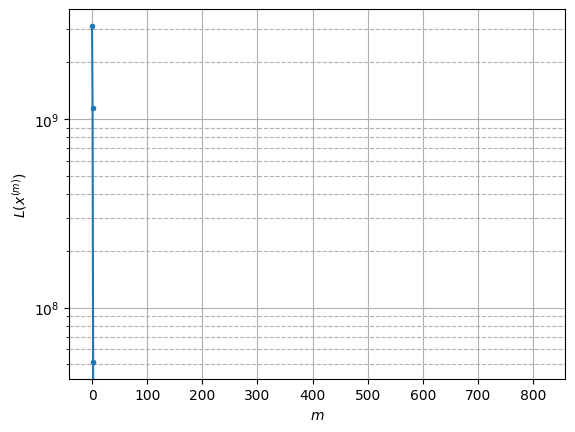

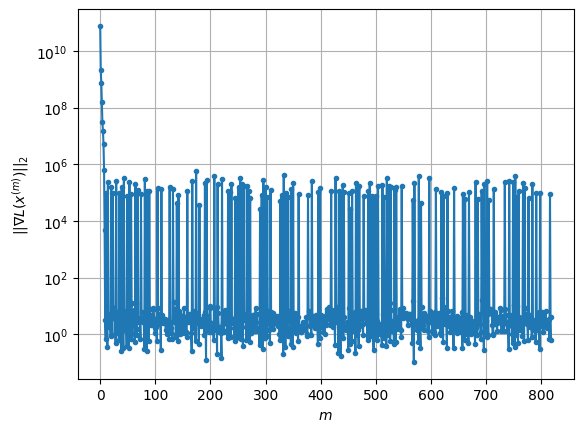

Windows:  42%|████▏     | 123/296 [22:44<38:10, 13.24s/it]

Before applying the algorithm
Cost function: -23635115.173995886
Gradient norm: 109187.91914911395
Global relative error: 1.1260163711457323
Position relative errors: 0.033480775253162766 m, 0.8251757082972582 m, 0.509572578762074 m, 0.5711485401271501 m

Iteration 1
Cost function: -23635115.729012676 (-0.00%)
Gradient norm: 3.749289435837561 (-100.00%)
Global relative error: 1.164819398768093 (3.45%)
Position relative errors: 0.03211635197701215 m, 0.747118889161253 m, 0.5522904843474217 m, 0.7018259470298714 m

STOP on Iteration 2
Cost function = -23635115.729012307 (0.00%)
Gradient norm = 0.2664383215828323 (-92.89%)
Global relative error = 1.164807036807098 (-0.00%)
Final position relative errors: 0.032116339390858284 m, 0.7470969427059364 m, 0.5522800527450388 m, 0.7018370019295436 m



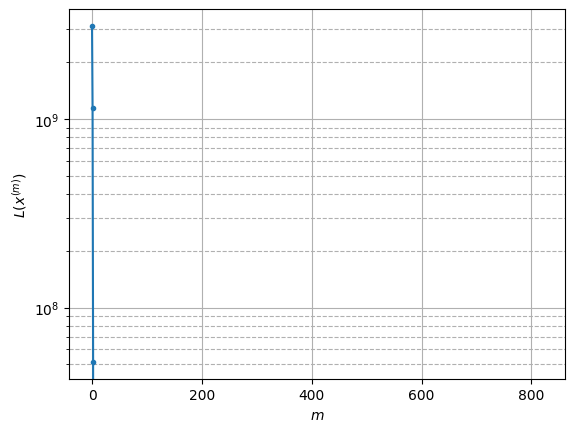

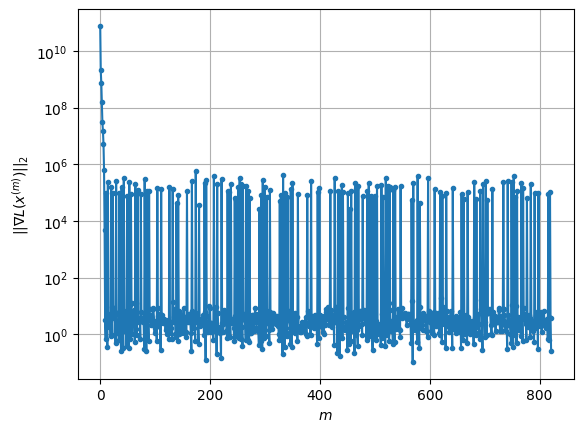

Windows:  42%|████▏     | 124/296 [22:50<31:03, 10.83s/it]

Before applying the algorithm
Cost function: -23635108.90307356
Gradient norm: 172299.7552682186
Global relative error: 1.1624811499102363
Position relative errors: 0.03068556510183728 m, 0.7737749331262966 m, 0.5398680556928835 m, 0.6784055424769454 m

Iteration 1
Cost function: -23635109.04841408 (-0.00%)
Gradient norm: 1.65496343299978 (-100.00%)
Global relative error: 1.0421490113955976 (-10.35%)
Position relative errors: 0.03381835490678283 m, 0.6170455193758818 m, 0.4569828220259838 m, 0.7038118271631167 m

STOP on Iteration 2
Cost function = -23635109.048414696 (-0.00%)
Gradient norm = 0.1987184614593237 (-87.99%)
Global relative error = 1.042153264484918 (0.00%)
Final position relative errors: 0.03381836816697029 m, 0.6170501715396262 m, 0.4569840706891084 m, 0.7038132347511177 m



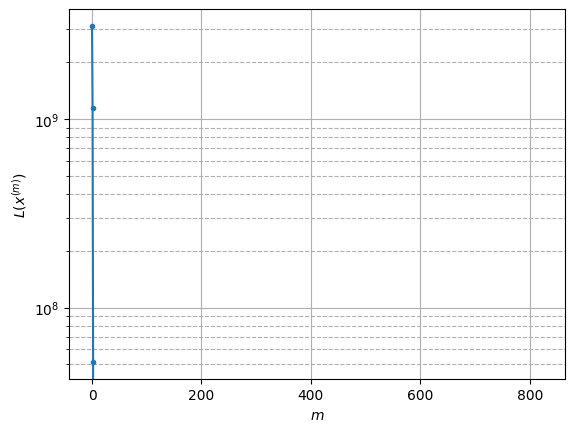

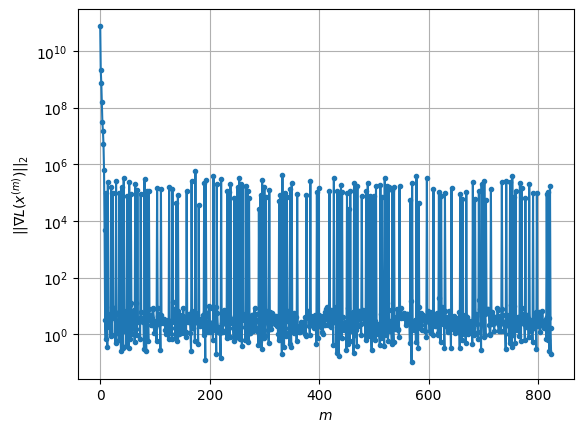

Windows:  42%|████▏     | 125/296 [22:55<25:57,  9.11s/it]

Before applying the algorithm
Cost function: -23635113.60256302
Gradient norm: 72872.27461918567
Global relative error: 1.0358707530374656
Position relative errors: 0.0324431506640679 m, 0.6382520668091842 m, 0.4431424691542184 m, 0.6842758832201722 m

Iteration 1
Cost function: -23635114.317949325 (-0.00%)
Gradient norm: 15.332463883972357 (-99.98%)
Global relative error: 1.2436804748588501 (20.06%)
Position relative errors: 0.046365546469805625 m, 0.9652219970583522 m, 0.3869653066617506 m, 0.6805840045867888 m

Iteration 2
Cost function: -23635114.317948937 (0.00%)
Gradient norm: 5.37614259960877 (-64.94%)
Global relative error: 1.2437097682895417 (0.00%)
Position relative errors: 0.04636554443242183 m, 0.9652673662632235 m, 0.3869652273471329 m, 0.6805732350248125 m

Iteration 3
Cost function: -23635114.317948822 (0.00%)
Gradient norm: 4.567019885027338 (-15.05%)
Global relative error: 1.243709767276855 (-0.00%)
Position relative errors: 0.046365548271462644 m, 0.9652673663388727 m

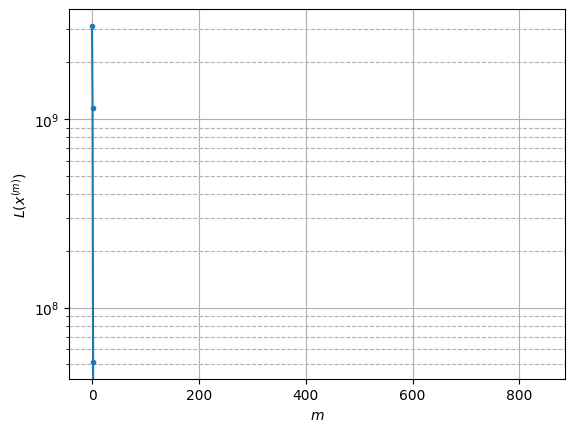

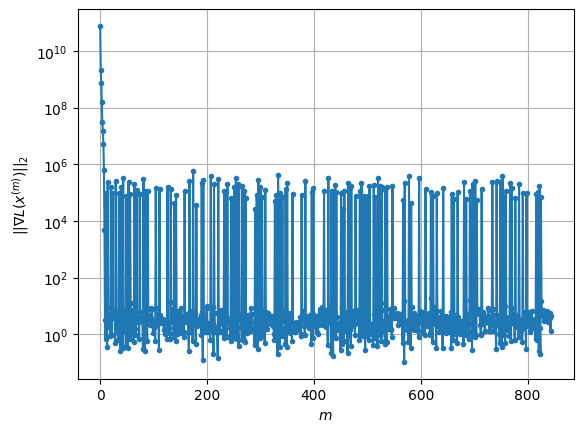

Windows:  43%|████▎     | 126/296 [23:26<44:46, 15.81s/it]

Before applying the algorithm
Cost function: -23635118.875645135
Gradient norm: 101439.22108464445
Global relative error: 1.230714456747386
Position relative errors: 0.04442101505730265 m, 0.9692981606975003 m, 0.3695414966563415 m, 0.6607450147227895 m

Iteration 1
Cost function: -23635119.88561351 (-0.00%)
Gradient norm: 12.909305978071478 (-99.99%)
Global relative error: 1.1860830065672645 (-3.63%)
Position relative errors: 0.030513347588848085 m, 0.945990693073264 m, 0.3487063842754042 m, 0.6239919519866248 m

Iteration 2
Cost function: -23635119.885613617 (-0.00%)
Gradient norm: 1.8360495478135197 (-85.78%)
Global relative error: 1.1860608320287263 (-0.00%)
Position relative errors: 0.030513348701721593 m, 0.9459707269861383 m, 0.3486872711924042 m, 0.6239907525655147 m

STOP on Iteration 3
Cost function = -23635119.885613196 (0.00%)
Gradient norm = 0.19489706600024753 (-89.38%)
Global relative error = 1.186060827087684 (-0.00%)
Final position relative errors: 0.030513345603713316

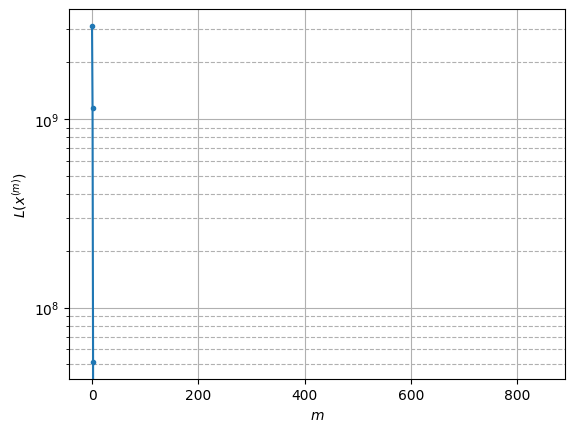

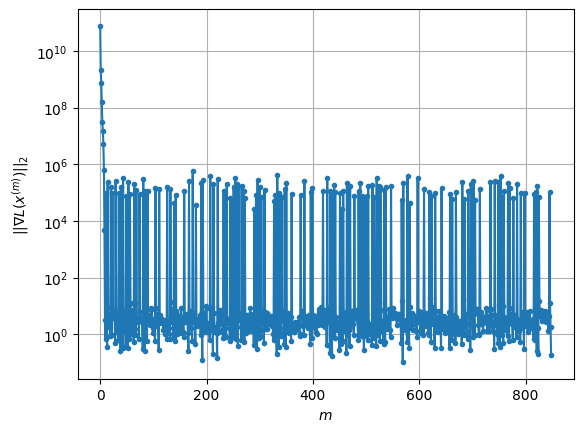

Windows:  43%|████▎     | 127/296 [23:33<36:46, 13.05s/it]

Before applying the algorithm
Cost function: -23635121.464424636
Gradient norm: 51064.16799672812
Global relative error: 1.188650581201383
Position relative errors: 0.029284094064450466 m, 0.9601277430428826 m, 0.365331629791839 m, 0.597259514324489 m

Iteration 1
Cost function: -23635121.776653748 (-0.00%)
Gradient norm: 7.899266919589592 (-99.98%)
Global relative error: 0.9943618201160974 (-16.35%)
Position relative errors: 0.0272367247134805 m, 0.6300721133969438 m, 0.387292863373366 m, 0.6640975934737512 m

Iteration 2
Cost function: -23635121.77665314 (0.00%)
Gradient norm: 1.9754802013948896 (-74.99%)
Global relative error: 0.9943900165995355 (0.00%)
Position relative errors: 0.0272367191786901 m, 0.6301051701427286 m, 0.3872960201675675 m, 0.6641066082704983 m

Iteration 3
Cost function: -23635121.77665334 (-0.00%)
Gradient norm: 4.102371368935476 (107.66%)
Global relative error: 0.9943900004732426 (-0.00%)
Position relative errors: 0.027236726160686033 m, 0.6301051655490797 m, 

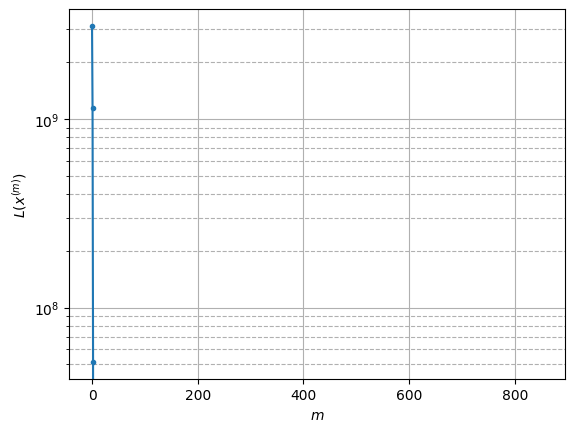

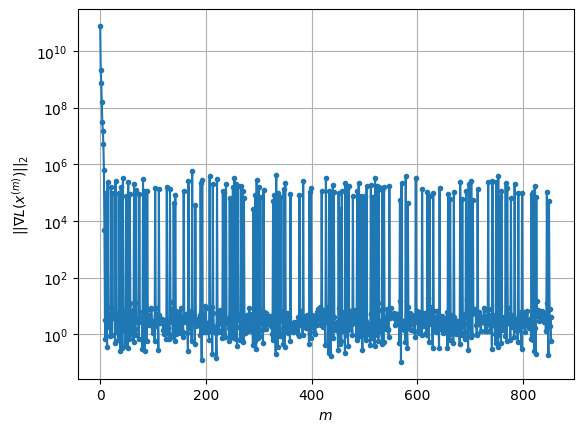

Windows:  43%|████▎     | 128/296 [23:42<33:22, 11.92s/it]

Before applying the algorithm
Cost function: -23635122.054316726
Gradient norm: 95936.11562285385
Global relative error: 0.9841664851070369
Position relative errors: 0.026040606958937677 m, 0.6391033794450954 m, 0.3982643326015493 m, 0.6331166486400787 m

Iteration 1
Cost function: -23635122.69388834 (-0.00%)
Gradient norm: 10.299744863727929 (-99.99%)
Global relative error: 0.9176113272763116 (-6.76%)
Position relative errors: 0.018279630213101306 m, 0.7244472379124648 m, 0.20413960893216784 m, 0.5245749085714922 m

Iteration 2
Cost function: -23635122.693887733 (0.00%)
Gradient norm: 3.7888295239004792 (-63.21%)
Global relative error: 0.9175993139847287 (-0.00%)
Position relative errors: 0.018279626533772225 m, 0.7244366204891122 m, 0.20413069751844237 m, 0.52457202516835 m

Iteration 3
Cost function: -23635122.693888027 (-0.00%)
Gradient norm: 5.263357174200656 (38.92%)
Global relative error: 0.9175993126782306 (-0.00%)
Position relative errors: 0.018279629116893886 m, 0.72443662079

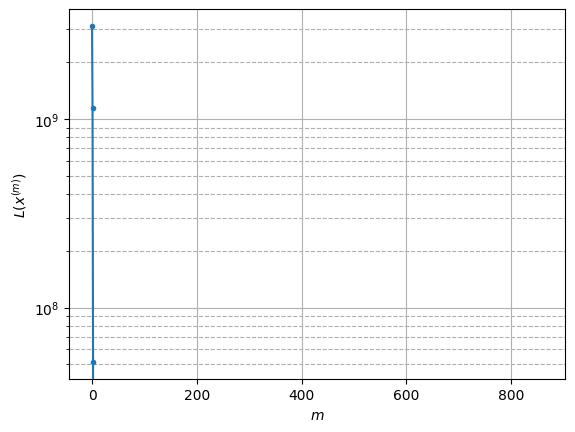

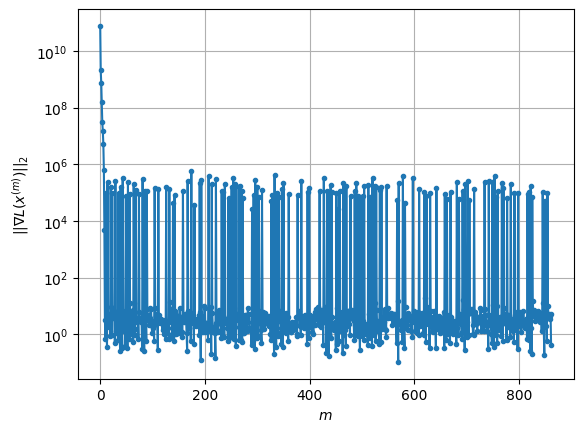

Windows:  44%|████▎     | 129/296 [23:57<35:37, 12.80s/it]

Before applying the algorithm
Cost function: -23635122.21631049
Gradient norm: 203859.31792985954
Global relative error: 0.9141044177530444
Position relative errors: 0.01749946545478831 m, 0.7250117747405433 m, 0.21679860206714524 m, 0.5124804518496522 m

Iteration 1
Cost function: -23635123.250445366 (-0.00%)
Gradient norm: 16.1590251354156 (-99.99%)
Global relative error: 0.8641913402104819 (-5.46%)
Position relative errors: 0.020846361801497248 m, 0.6250431157340649 m, 0.32645208604415876 m, 0.49914078568337494 m

Iteration 2
Cost function: -23635123.25044488 (0.00%)
Gradient norm: 2.379089946089316 (-85.28%)
Global relative error: 0.8642189508851573 (0.00%)
Position relative errors: 0.020846368723846213 m, 0.6249908134256388 m, 0.3265546965828294 m, 0.49918695942878216 m

STOP on Iteration 3
Cost function = -23635123.250444923 (-0.00%)
Gradient norm = 0.613936069759953 (-74.19%)
Global relative error = 0.8642189538696455 (0.00%)
Final position relative errors: 0.020846372800800768 

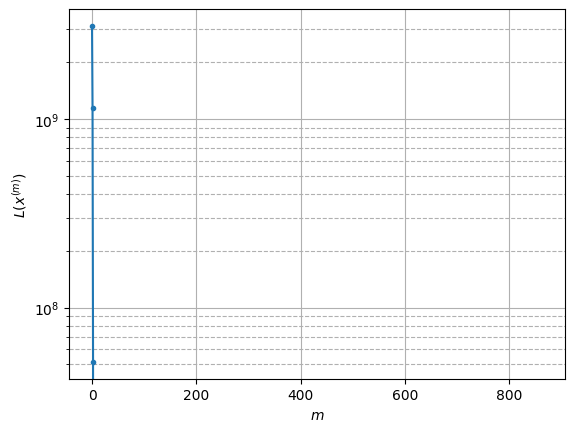

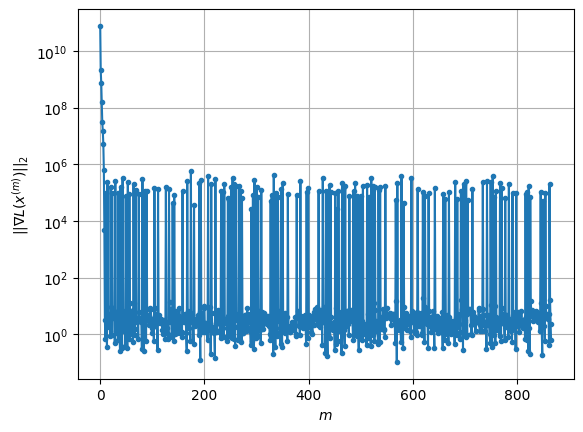

Windows:  44%|████▍     | 130/296 [24:04<30:56, 11.19s/it]

Before applying the algorithm
Cost function: -23635123.20588857
Gradient norm: 298281.798809667
Global relative error: 0.8489112250929212
Position relative errors: 0.019460541008463342 m, 0.5999514147760571 m, 0.30607417300774287 m, 0.5163794466518395 m

Iteration 1
Cost function: -23635123.764733054 (-0.00%)
Gradient norm: 7.21576658207447 (-100.00%)
Global relative error: 0.9157746844593289 (7.88%)
Position relative errors: 0.02458545572805922 m, 0.8498155626971531 m, 0.08815405029959374 m, 0.3287563201944272 m

Iteration 2
Cost function: -23635123.76473273 (0.00%)
Gradient norm: 3.061518137710169 (-57.57%)
Global relative error: 0.9157671223511734 (-0.00%)
Position relative errors: 0.024585454477489062 m, 0.8498022093230545 m, 0.08816333093414887 m, 0.32876728410263806 m

Iteration 3
Cost function: -23635123.764733385 (-0.00%)
Gradient norm: 5.436660004603113 (77.58%)
Global relative error: 0.9157671213321695 (-0.00%)
Position relative errors: 0.024585460059697608 m, 0.8498022169664

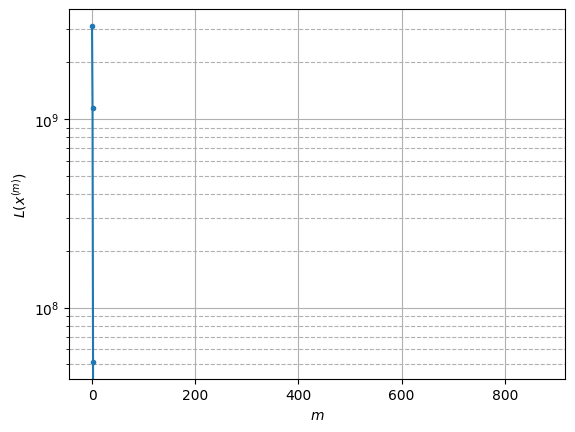

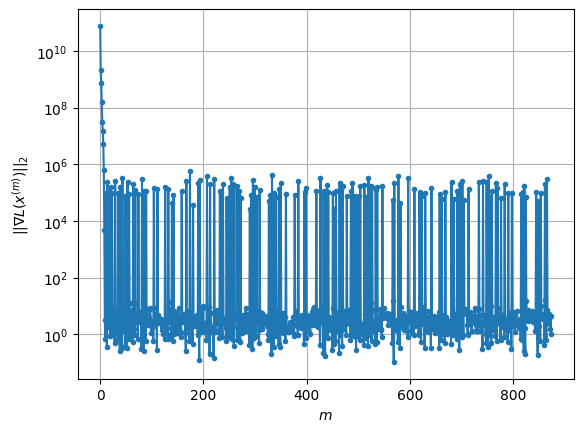

Windows:  44%|████▍     | 131/296 [24:22<35:55, 13.06s/it]

Before applying the algorithm
Cost function: -23635122.980950017
Gradient norm: 37161.367413257685
Global relative error: 0.9042067780389986
Position relative errors: 0.023339418054528594 m, 0.8419654920530618 m, 0.07419298497262868 m, 0.3203657153144488 m

Iteration 1
Cost function: -23635123.212605614 (-0.00%)
Gradient norm: 2.1781995165778185 (-99.99%)
Global relative error: 0.9953716959507223 (10.08%)
Position relative errors: 0.021983267229354862 m, 0.9038483740539616 m, 0.12778498443284575 m, 0.3962449866283298 m

STOP on Iteration 2
Cost function = -23635123.212605357 (0.00%)
Gradient norm = 0.25116375229228194 (-88.47%)
Global relative error = 0.9953684846124451 (-0.00%)
Final position relative errors: 0.02198326972189084 m, 0.9038465938536008 m, 0.12777385891797846 m, 0.39624456798865326 m



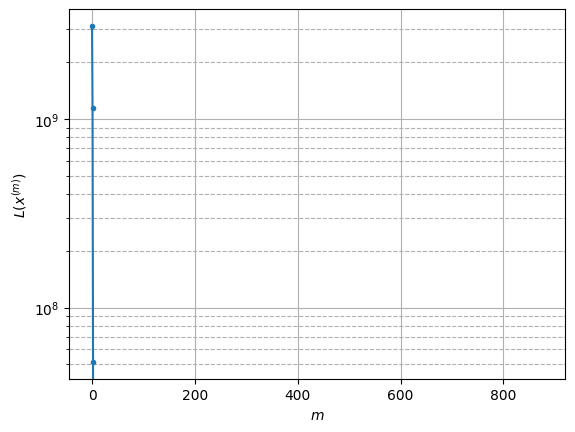

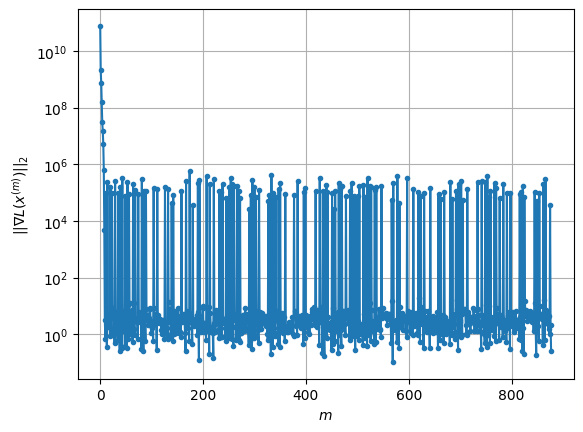

Windows:  45%|████▍     | 132/296 [24:27<29:41, 10.86s/it]

Before applying the algorithm
Cost function: -23635123.065821495
Gradient norm: 266891.8673050052
Global relative error: 0.9858321598930534
Position relative errors: 0.02095570219461012 m, 0.8963174079352253 m, 0.16146217251300954 m, 0.37678961305968434 m

Iteration 1
Cost function: -23635124.003314342 (-0.00%)
Gradient norm: 11.026366721266866 (-100.00%)
Global relative error: 0.6684863181268388 (-32.19%)
Position relative errors: 0.008973870364676537 m, 0.4342775081176091 m, 0.2516688541083403 m, 0.4414281265609642 m

Iteration 2
Cost function: -23635124.00331498 (-0.00%)
Gradient norm: 7.982118403859639 (-27.61%)
Global relative error: 0.6684972959062677 (0.00%)
Position relative errors: 0.008973868884867118 m, 0.43421111187329053 m, 0.2517272501314148 m, 0.4414767673554081 m

Iteration 3
Cost function: -23635124.003314562 (0.00%)
Gradient norm: 5.574272662023818 (-30.17%)
Global relative error: 0.6684972952236018 (-0.00%)
Position relative errors: 0.008973869484463536 m, 0.43421113

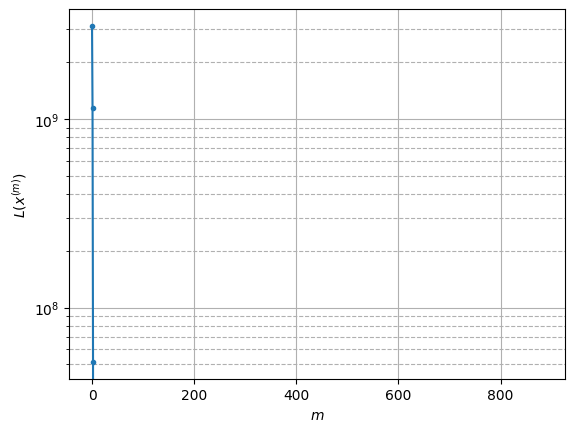

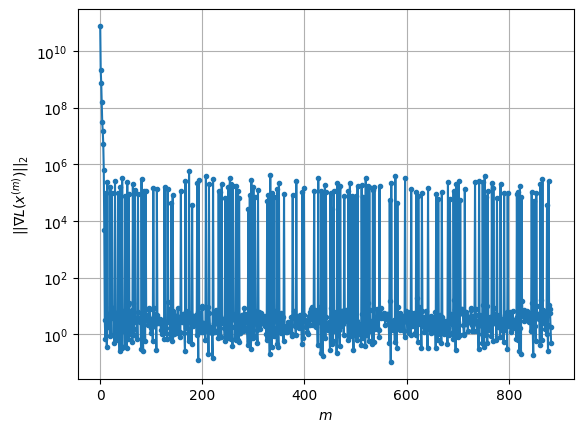

Windows:  45%|████▍     | 133/296 [24:38<29:35, 10.89s/it]

Before applying the algorithm
Cost function: -23635125.368862603
Gradient norm: 137185.39756488678
Global relative error: 0.6554861143401031
Position relative errors: 0.008368873553747202 m, 0.4128986253754337 m, 0.2378599787799025 m, 0.45003210132555155 m

Iteration 1
Cost function: -23635126.027335003 (-0.00%)
Gradient norm: 3.712076656820241 (-100.00%)
Global relative error: 0.7387651160229729 (12.70%)
Position relative errors: 0.007142382251043855 m, 0.6684539942638872 m, 0.13163680892955767 m, 0.28559306989531535 m

Iteration 2
Cost function: -23635126.027335744 (-0.00%)
Gradient norm: 4.992036235663613 (34.48%)
Global relative error: 0.7387055850967792 (-0.01%)
Position relative errors: 0.007142381440952783 m, 0.6683858500391413 m, 0.1315961221207057 m, 0.28561732155744524 m

STOP on Iteration 3
Cost function = -23635126.027335387 (0.00%)
Gradient norm = 0.8112113886947652 (-83.75%)
Global relative error = 0.7387055899156739 (0.00%)
Final position relative errors: 0.0071423813825

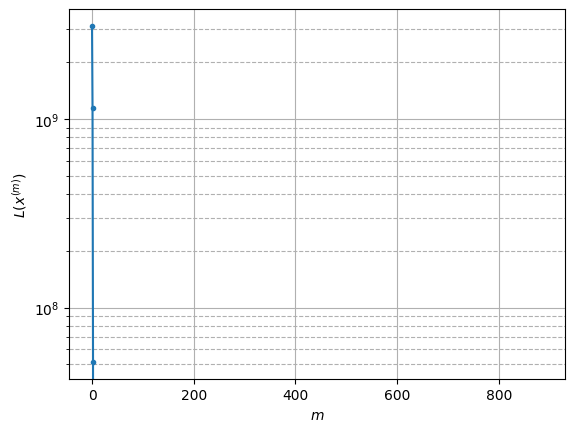

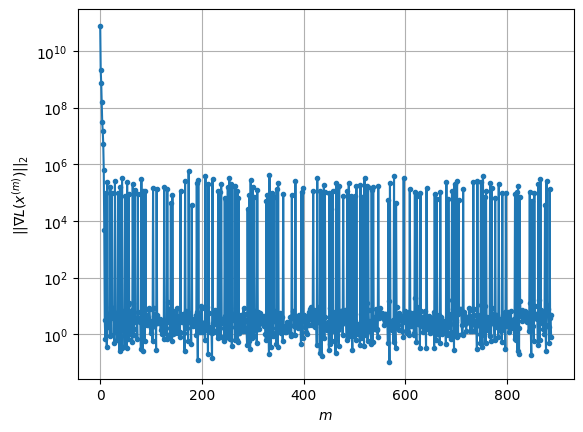

Windows:  45%|████▌     | 134/296 [24:46<26:36,  9.86s/it]

Before applying the algorithm
Cost function: -23635128.27740968
Gradient norm: 134182.8478993852
Global relative error: 0.7342131727758662
Position relative errors: 0.006716963630683043 m, 0.6601303334560346 m, 0.16300029454170203 m, 0.27691556393635736 m

Iteration 1
Cost function: -23635128.684037987 (-0.00%)
Gradient norm: 9.963325498994092 (-99.99%)
Global relative error: 0.6175385544555709 (-15.89%)
Position relative errors: 0.004445190007607262 m, 0.27727638920445274 m, 0.04032681409300467 m, 0.550295416731882 m

Iteration 2
Cost function: -23635128.684037905 (0.00%)
Gradient norm: 3.4337513331305662 (-65.54%)
Global relative error: 0.6175380338618497 (-0.00%)
Position relative errors: 0.004445185020984062 m, 0.27725039853809125 m, 0.04034195076944246 m, 0.5503068182298838 m

Iteration 3
Cost function: -23635128.68403796 (-0.00%)
Gradient norm: 3.5481796892179323 (3.33%)
Global relative error: 0.6175380237482861 (-0.00%)
Position relative errors: 0.004445188016438227 m, 0.2772504

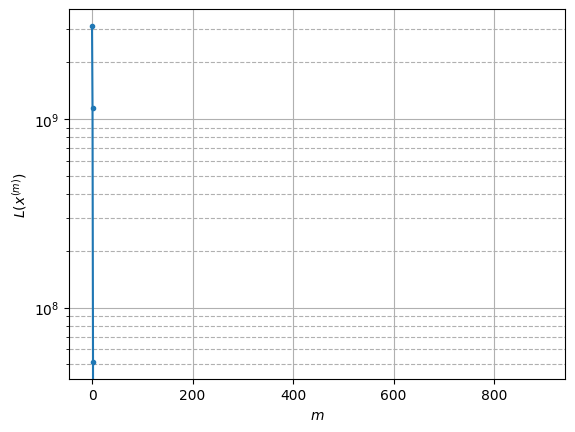

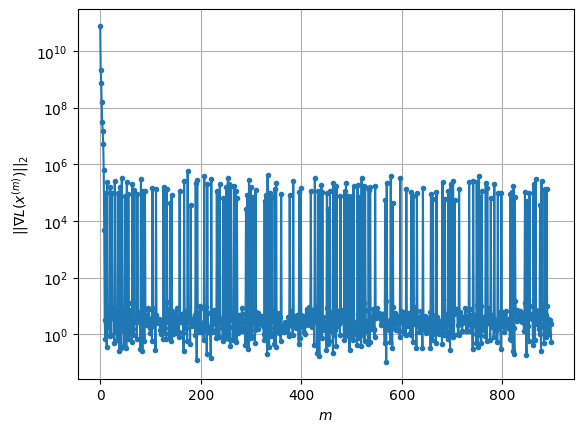

Windows:  46%|████▌     | 135/296 [25:04<32:45, 12.21s/it]

Before applying the algorithm
Cost function: -23635126.271234397
Gradient norm: 26895.64688206744
Global relative error: 0.6258581300086242
Position relative errors: 0.003954164705591852 m, 0.2574501555970332 m, 0.0417413663655464 m, 0.5689105874685733 m

STOP on Iteration 1
Cost function = -23635126.61361295 (-0.00%)
Gradient norm = 0.564501211467182 (-100.00%)
Global relative error = 0.6920392673988225 (10.57%)
Final position relative errors: 0.008122575355905428 m, 0.3537617302221836 m, 0.13209715752349854 m, 0.5798747899312662 m



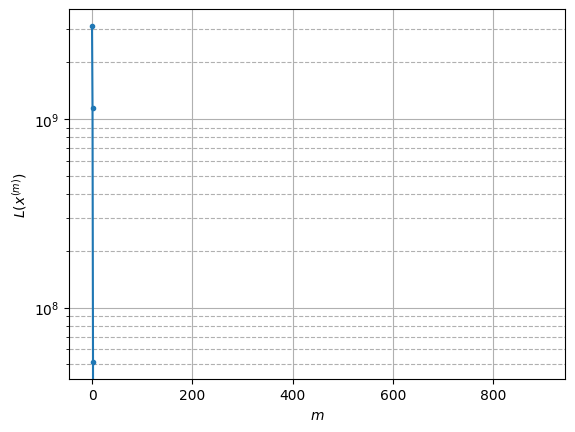

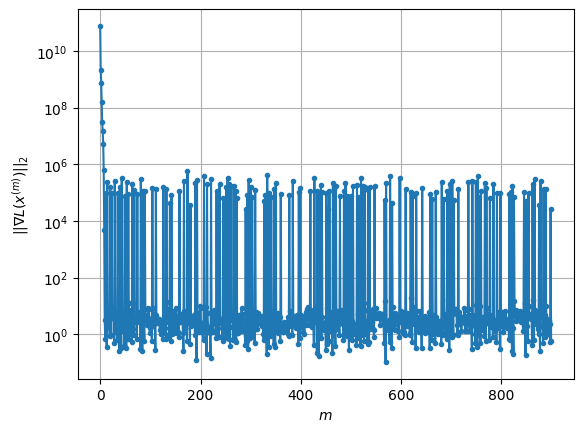

Windows:  46%|████▌     | 136/296 [25:07<25:39,  9.62s/it]

Before applying the algorithm
Cost function: -23635122.84142791
Gradient norm: 107077.1501375376
Global relative error: 0.6942843440546572
Position relative errors: 0.00777789096034617 m, 0.33337364351234444 m, 0.13467730643398257 m, 0.5938802396905895 m

Iteration 1
Cost function: -23635123.179375794 (-0.00%)
Gradient norm: 17.60729525717869 (-99.98%)
Global relative error: 0.8593403997382997 (23.77%)
Position relative errors: 0.0042468836423755875 m, 0.7594519766498319 m, 0.14932002569678313 m, 0.3733409641240228 m

Iteration 2
Cost function: -23635123.179376073 (-0.00%)
Gradient norm: 5.013678071201732 (-71.52%)
Global relative error: 0.8592874530438438 (-0.01%)
Position relative errors: 0.004246887302285819 m, 0.7593799019517958 m, 0.14931964379085577 m, 0.3733658570405505 m

Iteration 3
Cost function: -23635123.179376055 (0.00%)
Gradient norm: 4.068555815634271 (-18.85%)
Global relative error: 0.8592874556208842 (0.00%)
Position relative errors: 0.004246883573616374 m, 0.759379905

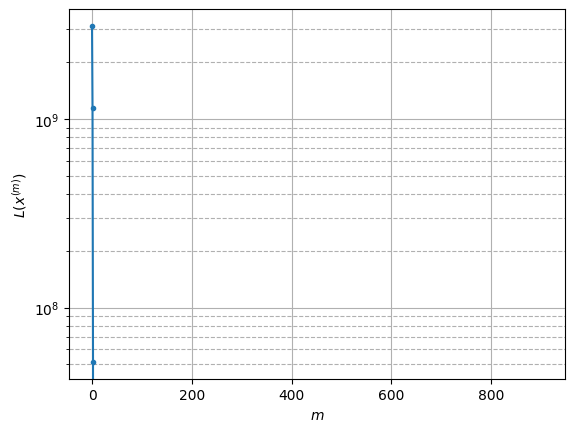

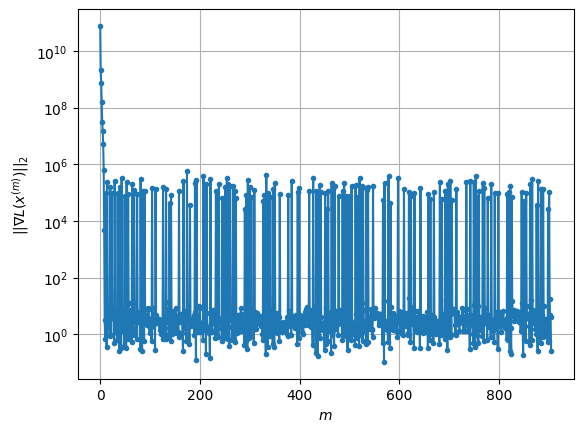

Windows:  46%|████▋     | 137/296 [25:16<24:37,  9.29s/it]

Before applying the algorithm
Cost function: -23635120.283611957
Gradient norm: 335245.15550013556
Global relative error: 0.8369320651778005
Position relative errors: 0.004618300804722855 m, 0.7308383818131446 m, 0.16858974659985285 m, 0.37133010844129416 m

Iteration 1
Cost function: -23635120.559670504 (-0.00%)
Gradient norm: 2.200026394748807 (-100.00%)
Global relative error: 0.8091663106449051 (-3.32%)
Position relative errors: 0.00908989215147412 m, 0.6624442110107102 m, 0.19198600018531936 m, 0.4230555602939518 m

Iteration 2
Cost function: -23635120.559670396 (0.00%)
Gradient norm: 5.253457166018307 (138.79%)
Global relative error: 0.809161077801556 (-0.00%)
Position relative errors: 0.00908989764044501 m, 0.6624348131284744 m, 0.1919853805214097 m, 0.4230605483070632 m

Iteration 3
Cost function: -23635120.559670053 (0.00%)
Gradient norm: 2.4314479984604587 (-53.72%)
Global relative error: 0.8091610748730065 (-0.00%)
Position relative errors: 0.009089901260904575 m, 0.662434819

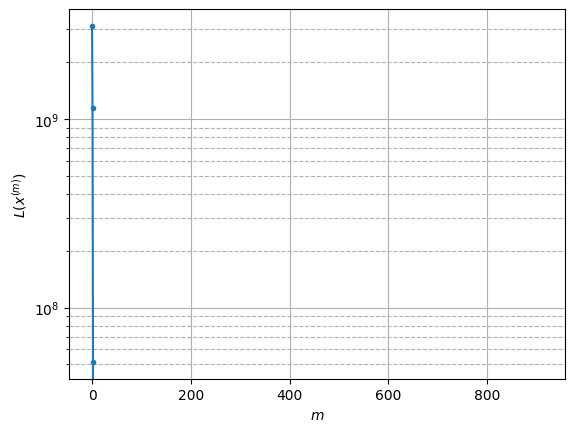

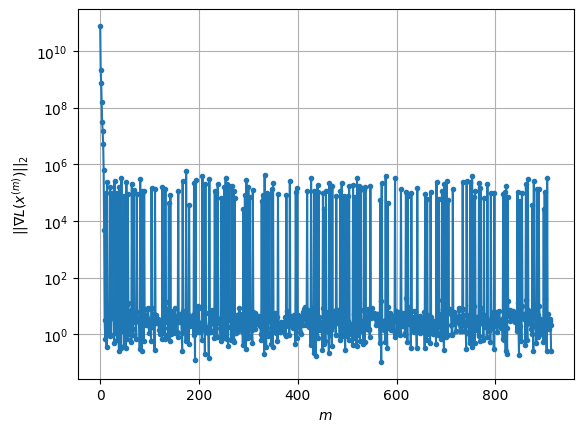

Windows:  47%|████▋     | 138/296 [25:30<28:33, 10.85s/it]

Before applying the algorithm
Cost function: -23635114.60328185
Gradient norm: 94939.52768550006
Global relative error: 0.790917435356601
Position relative errors: 0.009138913406312602 m, 0.6368333887683396 m, 0.2105675349242205 m, 0.41901178647699683 m

Iteration 1
Cost function: -23635115.47021424 (-0.00%)
Gradient norm: 9.967007345139585 (-99.99%)
Global relative error: 0.9046212653683928 (14.38%)
Position relative errors: 0.011731925770893657 m, 0.44638560562475615 m, 0.35799710395810247 m, 0.7005564454838838 m

Iteration 2
Cost function: -23635115.470213726 (0.00%)
Gradient norm: 1.7391959800461307 (-82.55%)
Global relative error: 0.9046223571020783 (0.00%)
Position relative errors: 0.011731932622258818 m, 0.4463359494203381 m, 0.35799403189335405 m, 0.7005910626572502 m

STOP on Iteration 3
Cost function = -23635115.470214296 (-0.00%)
Gradient norm = 0.6504507991091422 (-62.60%)
Global relative error = 0.9046223668420793 (0.00%)
Final position relative errors: 0.01173193602821494

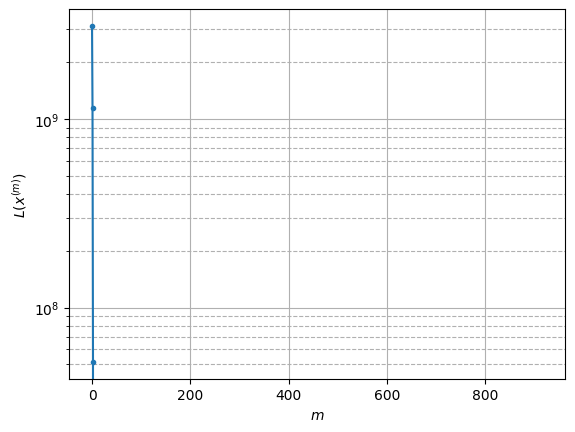

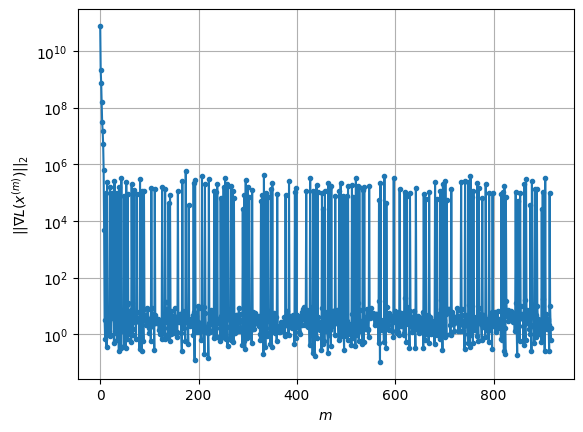

Windows:  47%|████▋     | 139/296 [25:37<25:00,  9.56s/it]

Before applying the algorithm
Cost function: -23635119.061518103
Gradient norm: 96955.9841489401
Global relative error: 0.8831863652533605
Position relative errors: 0.01190367682761104 m, 0.42071813207553027 m, 0.3544502830168795 m, 0.6908234913603001 m

Iteration 1
Cost function: -23635119.42367575 (-0.00%)
Gradient norm: 1.2829697225976513 (-100.00%)
Global relative error: 0.8535355776863517 (-3.36%)
Position relative errors: 0.014221982441756747 m, 0.34867784954974496 m, 0.35743545741720745 m, 0.6920865330193059 m

Iteration 2
Cost function: -23635119.42367548 (0.00%)
Gradient norm: 4.63369069603733 (261.17%)
Global relative error: 0.8535348385911704 (-0.00%)
Position relative errors: 0.014221981572254933 m, 0.3486717778705393 m, 0.35743548930400254 m, 0.6920886639812778 m

Iteration 3
Cost function: -23635119.42367564 (-0.00%)
Gradient norm: 4.76395208276154 (2.81%)
Global relative error: 0.8535348411852994 (0.00%)
Position relative errors: 0.014221982390663145 m, 0.348671765393670

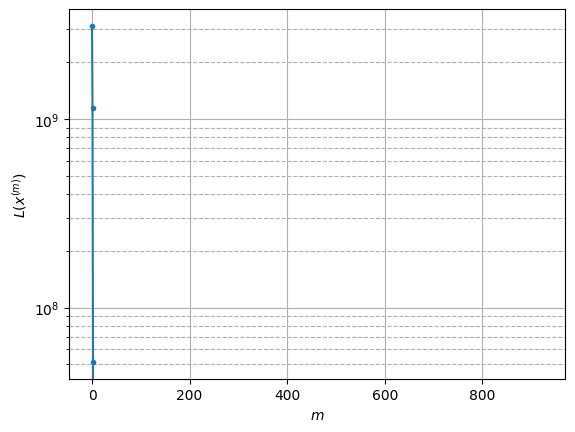

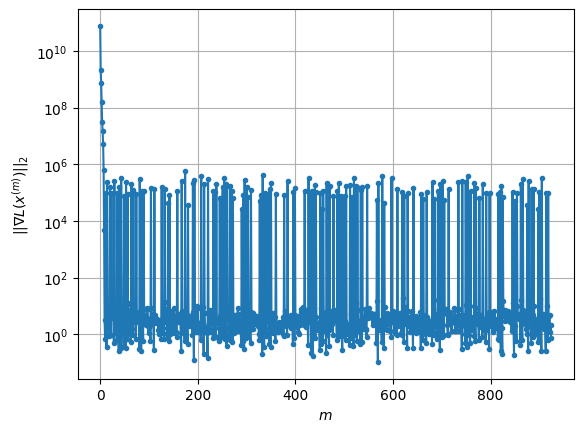

Windows:  47%|████▋     | 140/296 [25:48<26:15, 10.10s/it]

Before applying the algorithm
Cost function: -23635124.365257923
Gradient norm: 228761.13870593937
Global relative error: 0.826872321909392
Position relative errors: 0.015190875947774846 m, 0.3258514170899622 m, 0.35258291115083606 m, 0.673047268580171 m

Iteration 1
Cost function: -23635124.747951575 (-0.00%)
Gradient norm: 12.35941271171508 (-99.99%)
Global relative error: 1.0387944579453465 (25.63%)
Position relative errors: 0.018519918992688414 m, 0.16738451858660466 m, 0.39360697588099736 m, 0.9464704840570851 m

Iteration 2
Cost function: -23635124.747951567 (0.00%)
Gradient norm: 3.379281303037549 (-72.66%)
Global relative error: 1.0388082103128509 (0.00%)
Position relative errors: 0.018519917391911025 m, 0.16737909921203287 m, 0.39360422915367 m, 0.9464876785603226 m

Iteration 3
Cost function: -23635124.747950897 (0.00%)
Gradient norm: 1.1072249666540306 (-67.23%)
Global relative error: 1.038808207925169 (-0.00%)
Position relative errors: 0.01851991821316088 m, 0.1673790974568

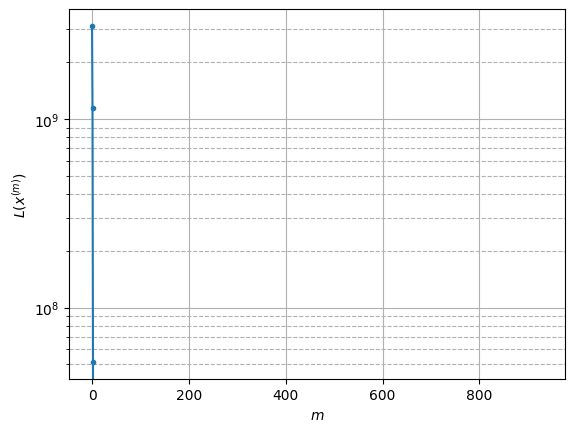

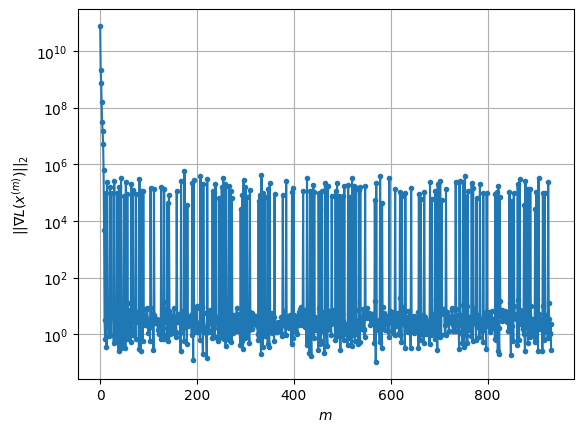

Windows:  48%|████▊     | 141/296 [25:59<27:04, 10.48s/it]

Before applying the algorithm
Cost function: -23635123.30665718
Gradient norm: 238688.86054283965
Global relative error: 1.0172300274633133
Position relative errors: 0.01959476292464784 m, 0.15325329763639842 m, 0.386359513527336 m, 0.9282306861435157 m

Iteration 1
Cost function: -23635124.708645765 (-0.00%)
Gradient norm: 14.029195762252746 (-99.99%)
Global relative error: 0.8202403850153115 (-19.37%)
Position relative errors: 0.01967205790870525 m, 0.19206132066251225 m, 0.3748139561636477 m, 0.703586308939867 m

Iteration 2
Cost function: -23635124.70864579 (-0.00%)
Gradient norm: 1.5432902897081988 (-89.00%)
Global relative error: 0.8202891001742575 (0.01%)
Position relative errors: 0.019672056309466585 m, 0.1921394614282174 m, 0.3748139782228719 m, 0.7036217553127898 m

STOP on Iteration 3
Cost function = -23635124.708645757 (0.00%)
Gradient norm = 0.8567088718957635 (-44.49%)
Global relative error = 0.8202891025921899 (0.00%)
Final position relative errors: 0.019672055815976683 

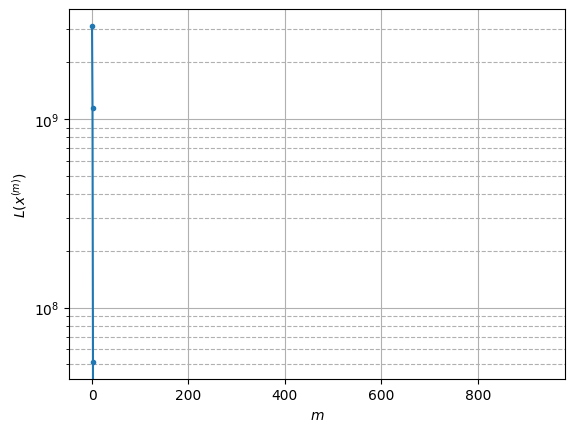

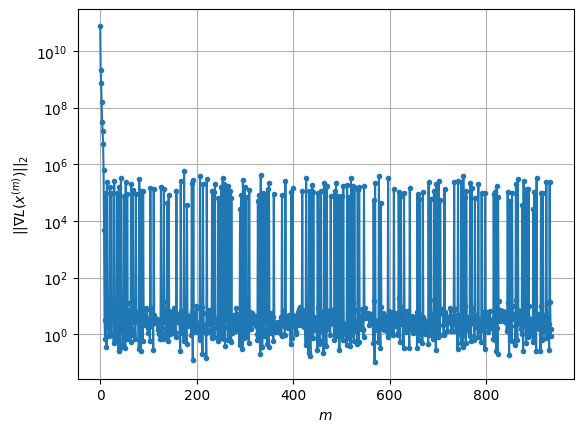

Windows:  48%|████▊     | 142/296 [26:06<23:54,  9.32s/it]

Before applying the algorithm
Cost function: -23635122.395363502
Gradient norm: 516314.0389853751
Global relative error: 0.79426337008469
Position relative errors: 0.02040902300521024 m, 0.19755183247626268 m, 0.3681381907774186 m, 0.6751924065022407 m

Iteration 1
Cost function: -23635122.816167865 (-0.00%)
Gradient norm: 4.44119215743753 (-100.00%)
Global relative error: 0.8666581540488066 (9.11%)
Position relative errors: 0.018378490724758327 m, 0.25431133734777844 m, 0.3430527900746447 m, 0.7539220619156528 m

Iteration 2
Cost function: -23635122.816168148 (-0.00%)
Gradient norm: 1.9424038702094906 (-56.26%)
Global relative error: 0.8666605376414808 (0.00%)
Position relative errors: 0.01837849592490903 m, 0.25431087207876796 m, 0.34305194850443993 m, 0.7539253416826669 m

Iteration 3
Cost function: -23635122.81616784 (0.00%)
Gradient norm: 1.1931197072527073 (-38.58%)
Global relative error: 0.8666605465551371 (0.00%)
Position relative errors: 0.018378498320748792 m, 0.2543108810963

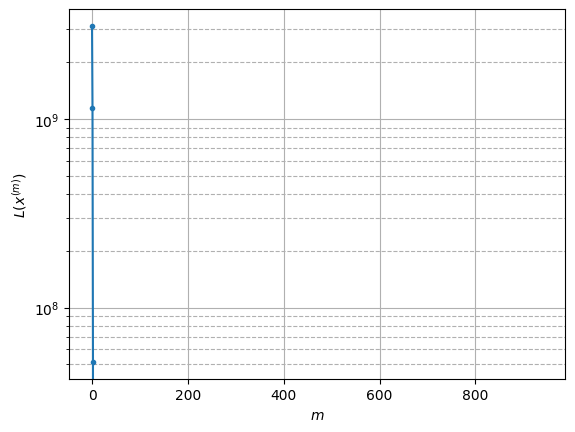

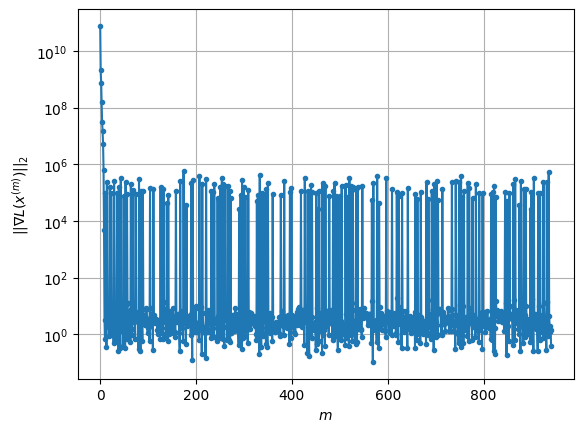

Windows:  48%|████▊     | 143/296 [26:16<24:06,  9.46s/it]

Before applying the algorithm
Cost function: -23635116.46442843
Gradient norm: 131400.16328308088
Global relative error: 0.832689012841141
Position relative errors: 0.019032525664186555 m, 0.2540290987698086 m, 0.3417707733939963 m, 0.7153111600338512 m

Iteration 1
Cost function: -23635116.792365473 (-0.00%)
Gradient norm: 3.1888434168407978 (-100.00%)
Global relative error: 0.9014233232671015 (8.25%)
Position relative errors: 0.024446930950903546 m, 0.3845305180698924 m, 0.2838433233144447 m, 0.7638945705640495 m

Iteration 2
Cost function: -23635116.79236578 (-0.00%)
Gradient norm: 4.895341947202995 (53.51%)
Global relative error: 0.9014277138373039 (0.00%)
Position relative errors: 0.02444692979435716 m, 0.38453443689770084 m, 0.28383914132199717 m, 0.7638993328646785 m

Iteration 3
Cost function: -23635116.792365525 (0.00%)
Gradient norm: 2.084324172692008 (-57.42%)
Global relative error: 0.901427715846663 (0.00%)
Position relative errors: 0.024446933574245017 m, 0.384534437652690

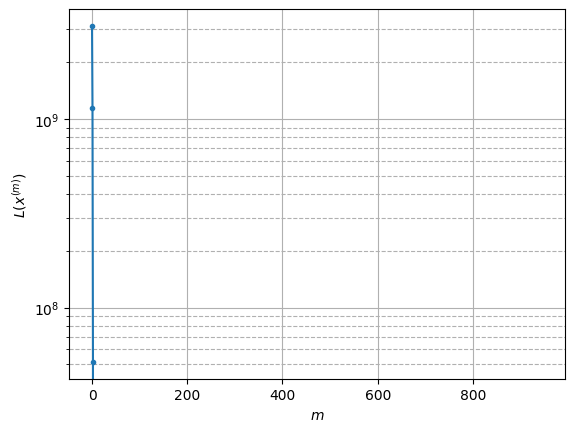

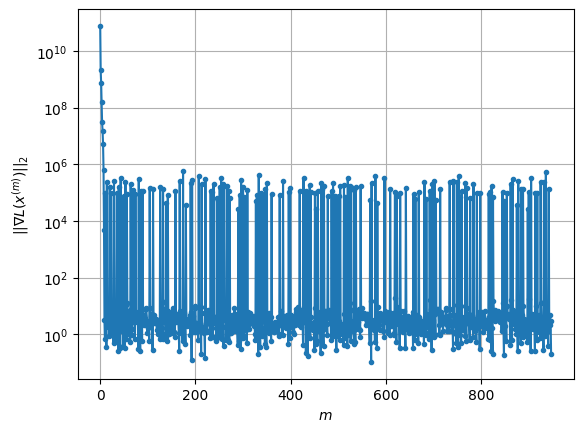

Windows:  49%|████▊     | 144/296 [26:26<24:14,  9.57s/it]

Before applying the algorithm
Cost function: -23635115.652281474
Gradient norm: 248915.41714979865
Global relative error: 0.8645017787264676
Position relative errors: 0.02494181972620266 m, 0.38024253219817483 m, 0.28466768077090737 m, 0.7218867222412119 m

Iteration 1
Cost function: -23635116.027001154 (-0.00%)
Gradient norm: 3.845061799732168 (-100.00%)
Global relative error: 0.9766128085590247 (12.97%)
Position relative errors: 0.023396031394598317 m, 0.3671113687806559 m, 0.3376857760290865 m, 0.8392985317463999 m

STOP on Iteration 2
Cost function = -23635116.027000844 (0.00%)
Gradient norm = 0.21199257238481323 (-94.49%)
Global relative error = 0.9766269049524801 (0.00%)
Final position relative errors: 0.0233960313483574 m, 0.36712436201541715 m, 0.3376842834340132 m, 0.8393098515983207 m



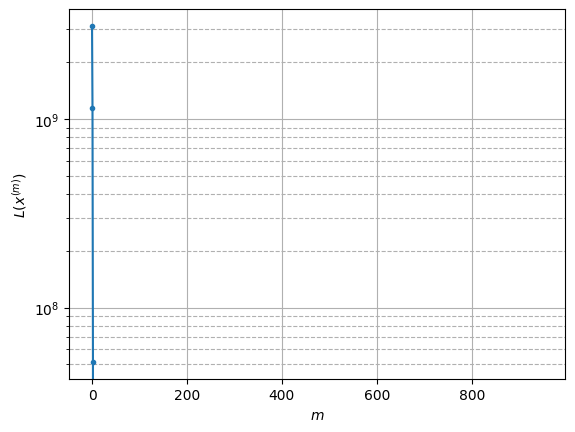

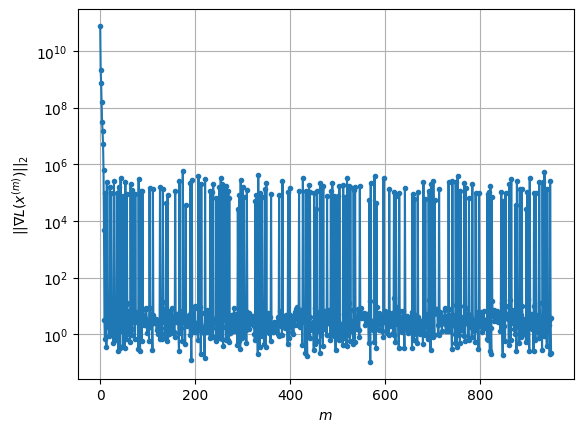

Windows:  49%|████▉     | 145/296 [26:31<20:38,  8.20s/it]

Before applying the algorithm
Cost function: -23635113.906518925
Gradient norm: 143124.8577925096
Global relative error: 0.9408622982572559
Position relative errors: 0.024251487825591993 m, 0.365239660299822 m, 0.3323687842327273 m, 0.800477326495722 m

Iteration 1
Cost function: -23635114.00919252 (-0.00%)
Gradient norm: 1.3830372240267301 (-100.00%)
Global relative error: 0.937605147612495 (-0.35%)
Position relative errors: 0.027977445734833857 m, 0.3499385143088223 m, 0.3778764239924283 m, 0.7829892882420628 m

Iteration 2
Cost function: -23635114.009192552 (-0.00%)
Gradient norm: 2.0166764367118843 (45.82%)
Global relative error: 0.9376072933504229 (0.00%)
Position relative errors: 0.027977444726780456 m, 0.3499406408308577 m, 0.3778764394166757 m, 0.7829908998873163 m

STOP on Iteration 3
Cost function = -23635114.009192526 (0.00%)
Gradient norm = 0.7932329480817647 (-60.67%)
Global relative error = 0.9376072875071553 (-0.00%)
Final position relative errors: 0.027977445602923257 m

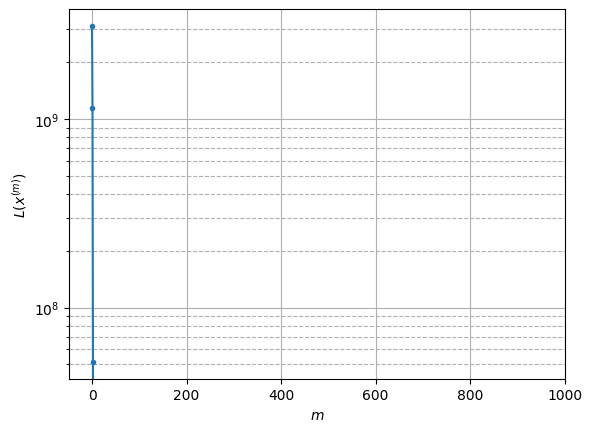

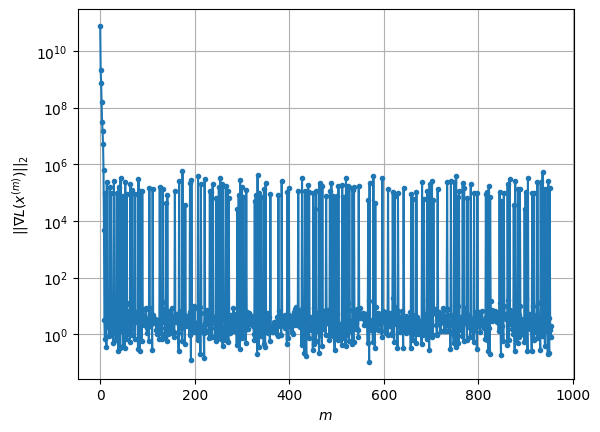

Windows:  49%|████▉     | 146/296 [26:37<19:15,  7.70s/it]

Before applying the algorithm
Cost function: -23635115.9110135
Gradient norm: 162454.33551612854
Global relative error: 0.8991376438340598
Position relative errors: 0.028566764977200662 m, 0.34771843705318733 m, 0.3708464913139243 m, 0.7410777979429047 m

Iteration 1
Cost function: -23635116.27138045 (-0.00%)
Gradient norm: 2.2510866917148395 (-100.00%)
Global relative error: 0.8182881580013572 (-8.99%)
Position relative errors: 0.03223257451605773 m, 0.2897790296683816 m, 0.3454361342902545 m, 0.6820981755998413 m

Iteration 2
Cost function: -23635116.271380354 (0.00%)
Gradient norm: 3.8913677093035925 (72.87%)
Global relative error: 0.8182960807776972 (0.00%)
Position relative errors: 0.03223257274428455 m, 0.28978835773117506 m, 0.34543587810422405 m, 0.6821038471603952 m

STOP on Iteration 3
Cost function = -23635116.27138086 (-0.00%)
Gradient norm = 0.5142058273192848 (-86.79%)
Global relative error = 0.8182960833115082 (0.00%)
Final position relative errors: 0.03223257553079492 m

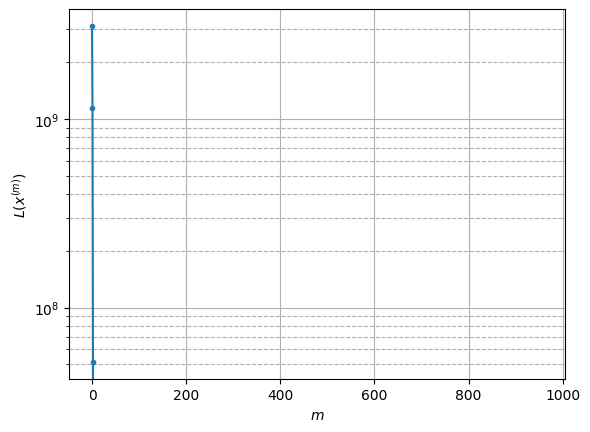

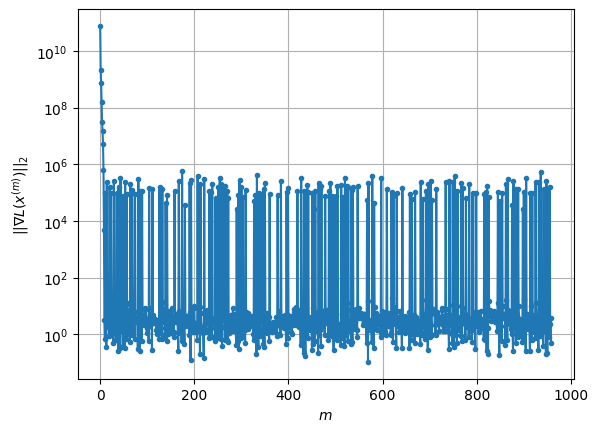

Windows:  50%|████▉     | 147/296 [26:44<18:27,  7.43s/it]

Before applying the algorithm
Cost function: -23635119.275159106
Gradient norm: 170477.41209131439
Global relative error: 0.7855731763803975
Position relative errors: 0.03257788364743894 m, 0.29020201940744694 m, 0.34388902078317973 m, 0.6431068035958969 m

Iteration 1
Cost function: -23635119.786016084 (-0.00%)
Gradient norm: 2.730333665160328 (-100.00%)
Global relative error: 0.9307717772313224 (18.48%)
Position relative errors: 0.031105734375737718 m, 0.38988072174562877 m, 0.20136087362837815 m, 0.8202529838050113 m

STOP on Iteration 2
Cost function = -23635119.78601597 (0.00%)
Gradient norm = 0.5949741576073893 (-78.21%)
Global relative error = 0.9307610103315757 (-0.00%)
Final position relative errors: 0.031105733469021048 m, 0.3898650261691254 m, 0.20137040350996027 m, 0.8202458869875017 m



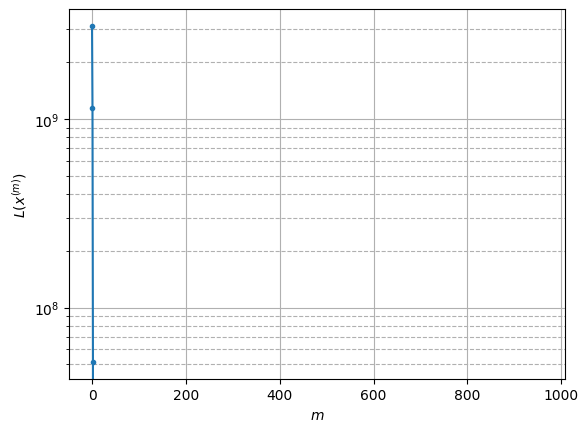

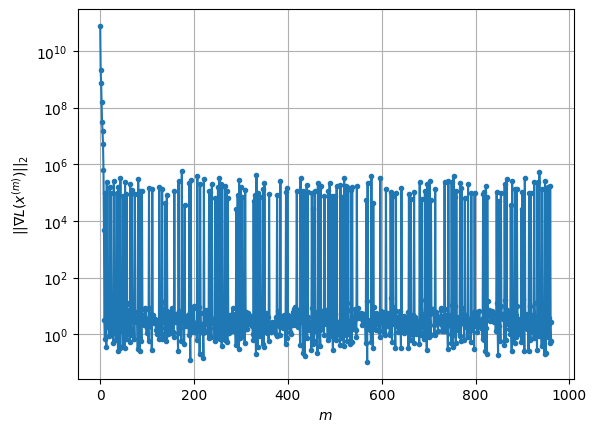

Windows:  50%|█████     | 148/296 [26:49<16:36,  6.73s/it]

Before applying the algorithm
Cost function: -23635130.8999714
Gradient norm: 108805.48671971382
Global relative error: 0.900015054476562
Position relative errors: 0.03122530738895723 m, 0.39066240449852035 m, 0.20348384331120925 m, 0.7842377395655699 m

Iteration 1
Cost function: -23635131.278009173 (-0.00%)
Gradient norm: 3.9787155616773027 (-100.00%)
Global relative error: 1.0774678508890512 (19.72%)
Position relative errors: 0.028213993671325335 m, 0.5150932835332859 m, 0.21012023228248916 m, 0.9223170762840835 m

Iteration 2
Cost function: -23635131.278009083 (0.00%)
Gradient norm: 1.8739505884376448 (-52.90%)
Global relative error: 1.07746242414954 (-0.00%)
Position relative errors: 0.028213996315786333 m, 0.5150902685172413 m, 0.21012415275119933 m, 0.9223115272346913 m

Iteration 3
Cost function: -23635131.27800916 (-0.00%)
Gradient norm: 1.4970980456156309 (-20.11%)
Global relative error: 1.0774624255870717 (0.00%)
Position relative errors: 0.028213994301361296 m, 0.5150902786

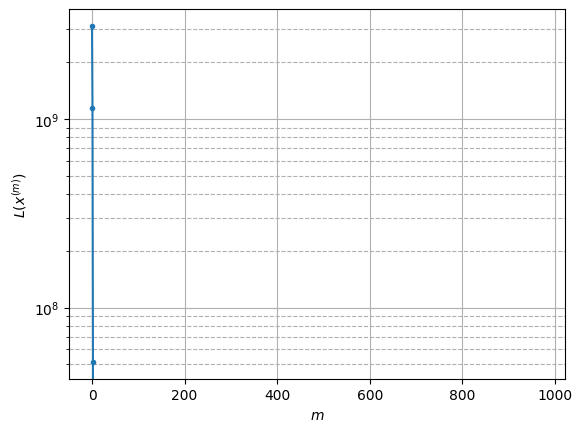

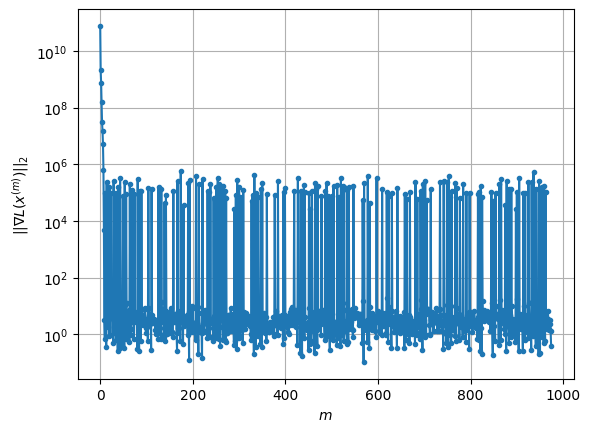

Windows:  50%|█████     | 149/296 [27:10<27:10, 11.09s/it]

Before applying the algorithm
Cost function: -23635129.89369372
Gradient norm: 215545.2990129068
Global relative error: 1.049897496216149
Position relative errors: 0.02867719482005514 m, 0.5256440532487201 m, 0.20922224365368552 m, 0.8839604883554029 m

Iteration 1
Cost function: -23635130.09993813 (-0.00%)
Gradient norm: 2.3429558114304783 (-100.00%)
Global relative error: 1.0782931776955689 (2.70%)
Position relative errors: 0.030014589811911775 m, 0.4473603046362345 m, 0.1892814653358446 m, 0.9622141453614481 m

STOP on Iteration 2
Cost function = -23635130.09993828 (-0.00%)
Gradient norm = 0.3462152699782935 (-85.22%)
Global relative error = 1.078297416624964 (0.00%)
Final position relative errors: 0.030014587478289476 m, 0.44736119156538445 m, 0.18928317829015706 m, 0.9622181464137647 m



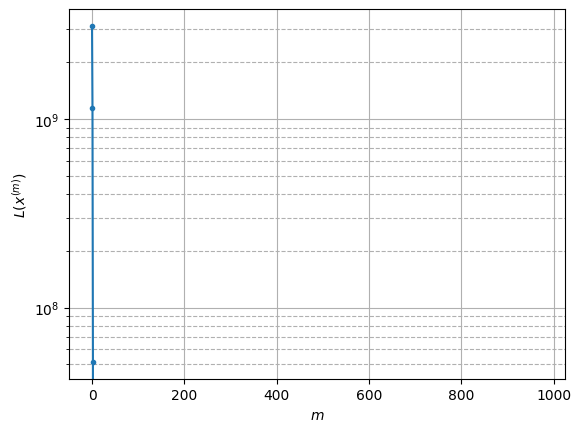

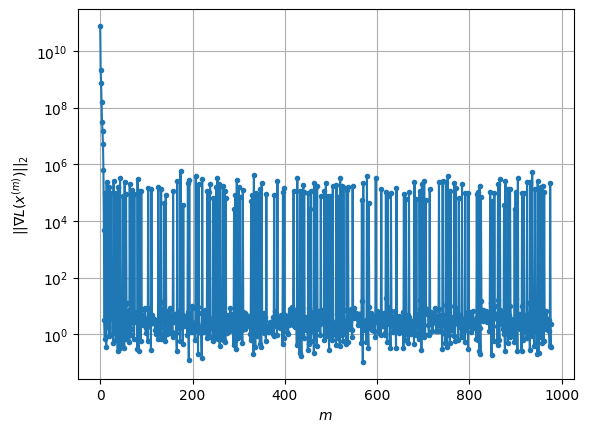

Windows:  51%|█████     | 150/296 [27:16<22:43,  9.34s/it]

Before applying the algorithm
Cost function: -23635131.28002605
Gradient norm: 188952.89601671617
Global relative error: 1.0436818545438287
Position relative errors: 0.03074174778872551 m, 0.45232176167949956 m, 0.18898764898924816 m, 0.9208772140070787 m

Iteration 1
Cost function: -23635132.426905125 (-0.00%)
Gradient norm: 20.793770427965956 (-99.99%)
Global relative error: 1.55271675601277 (48.77%)
Position relative errors: 0.0332730221482755 m, 0.6488169681336675 m, 0.34075788453863454 m, 1.3684818296782952 m

STOP on Iteration 2
Cost function = -23635132.426905423 (-0.00%)
Gradient norm = 0.28167529548158 (-98.65%)
Global relative error = 1.5527328385261634 (0.00%)
Final position relative errors: 0.03327301961518547 m, 0.6488358186219105 m, 0.3407628388260832 m, 1.3684899064008287 m



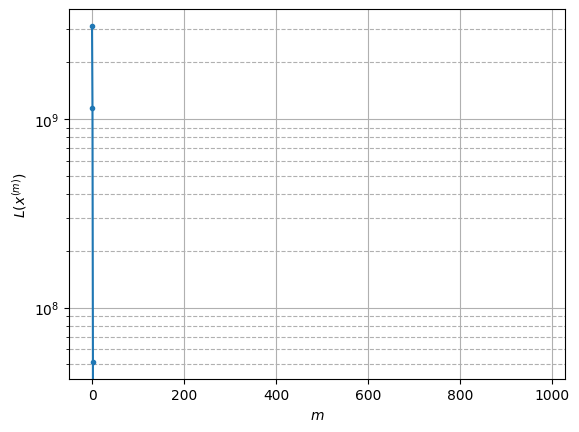

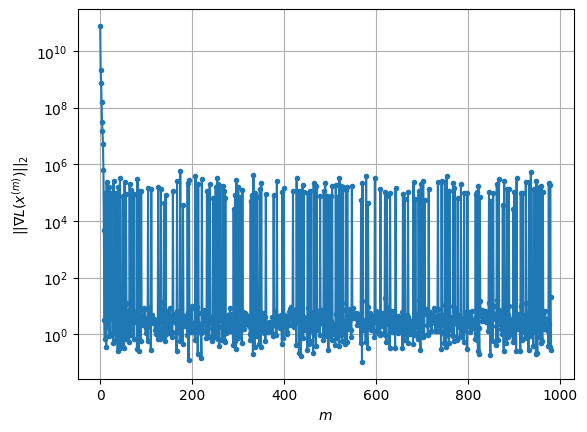

Windows:  51%|█████     | 151/296 [27:21<19:33,  8.10s/it]

Before applying the algorithm
Cost function: -23635147.728077985
Gradient norm: 277093.30772588635
Global relative error: 1.5530878300181483
Position relative errors: 0.033592803060107854 m, 0.6680730143151021 m, 0.33475008044692206 m, 1.3610928913074105 m

Iteration 1
Cost function: -23635148.097278 (-0.00%)
Gradient norm: 4.140730865166171 (-100.00%)
Global relative error: 1.559307947542788 (0.40%)
Position relative errors: 0.03204722527204661 m, 0.7266895321259398 m, 0.3111193296242764 m, 1.3437042515508872 m

Iteration 2
Cost function: -23635148.097278077 (-0.00%)
Gradient norm: 3.491702255371577 (-15.67%)
Global relative error: 1.559322043107212 (0.00%)
Position relative errors: 0.032047218354037114 m, 0.7267021098260856 m, 0.3111242830063556 m, 1.3437126599063987 m

Iteration 3
Cost function: -23635148.097278442 (-0.00%)
Gradient norm: 9.411102189912668 (169.53%)
Global relative error: 1.5593220128745724 (-0.00%)
Position relative errors: 0.03204721730375246 m, 0.7267020942914157

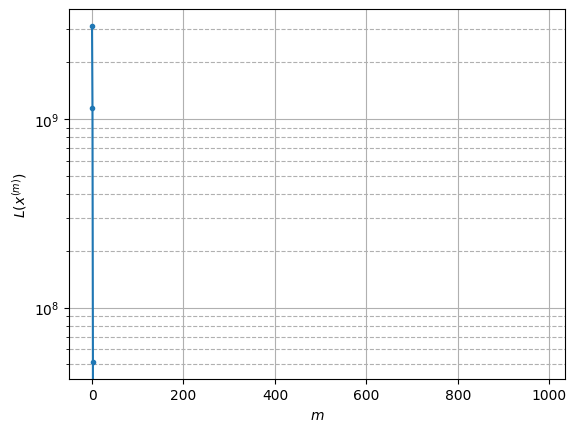

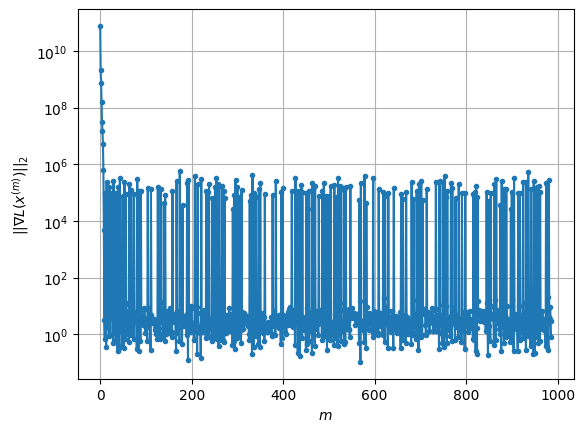

Windows:  51%|█████▏    | 152/296 [27:31<20:49,  8.68s/it]

Before applying the algorithm
Cost function: -23635148.267216295
Gradient norm: 310567.79464684793
Global relative error: 1.5529943548570024
Position relative errors: 0.032770771023124 m, 0.735959621350396 m, 0.3098803296223033 m, 1.3315610867569014 m

Iteration 1
Cost function: -23635148.46436495 (-0.00%)
Gradient norm: 2.4601472179959503 (-100.00%)
Global relative error: 1.5722284568661615 (1.24%)
Position relative errors: 0.03561940292990567 m, 0.7459364773136028 m, 0.31117920676059824 m, 1.348102203895764 m

STOP on Iteration 2
Cost function = -23635148.464364693 (0.00%)
Gradient norm = 0.7857401628226778 (-68.06%)
Global relative error = 1.5722247008313874 (-0.00%)
Final position relative errors: 0.03561940052548337 m, 0.7459338702313459 m, 0.3111792490895622 m, 1.3480992562624217 m



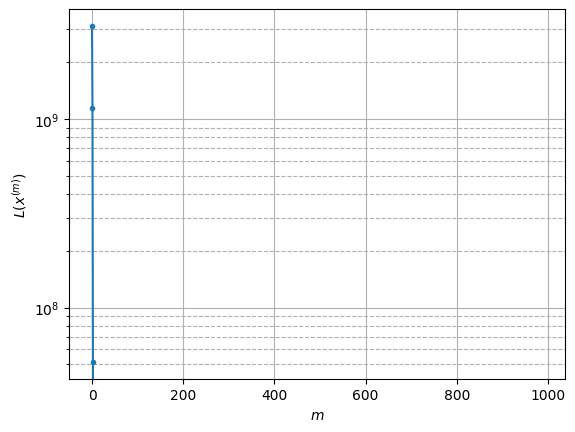

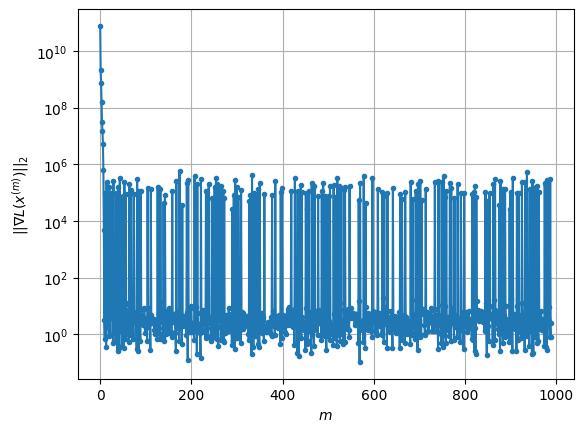

Windows:  52%|█████▏    | 153/296 [27:36<18:10,  7.63s/it]

Before applying the algorithm
Cost function: -23635161.867180984
Gradient norm: 171992.427714599
Global relative error: 1.5728376533149682
Position relative errors: 0.03597275401214735 m, 0.7603111532630964 m, 0.3084875971829936 m, 1.3413747867440589 m

Iteration 1
Cost function: -23635162.72942411 (-0.00%)
Gradient norm: 10.095746768651194 (-99.99%)
Global relative error: 1.6069129923878307 (2.17%)
Position relative errors: 0.03112273731722918 m, 0.9516419783909917 m, 0.3397790690709378 m, 1.2490507137282976 m

Iteration 2
Cost function: -23635162.729424145 (-0.00%)
Gradient norm: 1.0419157692130134 (-89.68%)
Global relative error: 1.6068707034177567 (-0.00%)
Position relative errors: 0.031122738792826704 m, 0.9516156250841858 m, 0.3397839968189867 m, 1.249015046454493 m

Iteration 3
Cost function: -23635162.729424115 (0.00%)
Gradient norm: 4.951831775776167 (375.26%)
Global relative error: 1.606870700311202 (-0.00%)
Position relative errors: 0.031122741117363847 m, 0.9516156252191834

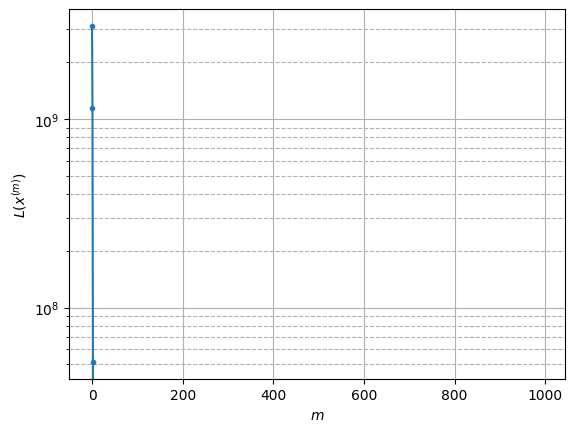

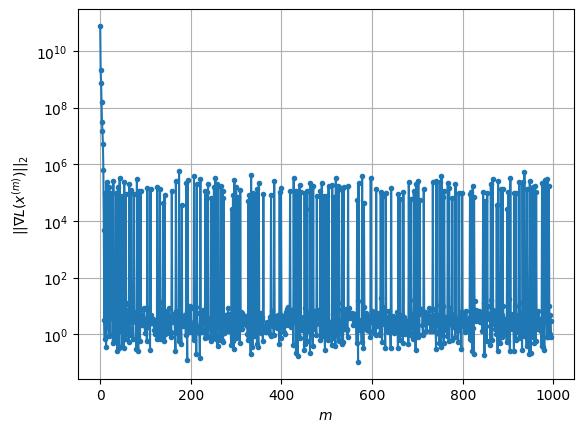

Windows:  52%|█████▏    | 154/296 [27:46<19:49,  8.38s/it]

Before applying the algorithm
Cost function: -23635156.748236507
Gradient norm: 142860.82975408857
Global relative error: 1.6054026487615236
Position relative errors: 0.03129712685433344 m, 0.9771176844825389 m, 0.3369997712956459 m, 1.2280104159039265 m

Iteration 1
Cost function: -23635157.014693365 (-0.00%)
Gradient norm: 10.954840203769507 (-99.99%)
Global relative error: 1.5390462677843402 (-4.13%)
Position relative errors: 0.03902884700632027 m, 0.9158372422191515 m, 0.3453154463646946 m, 1.1870713615808106 m

Iteration 2
Cost function: -23635157.014693312 (0.00%)
Gradient norm: 5.660898412424913 (-48.33%)
Global relative error: 1.5390205522984413 (-0.00%)
Position relative errors: 0.03902884300160124 m, 0.9158148659965134 m, 0.34531819704636846 m, 1.187054484648798 m

Iteration 3
Cost function: -23635157.014693327 (-0.00%)
Gradient norm: 3.706487910865429 (-34.52%)
Global relative error: 1.5390205606210987 (0.00%)
Position relative errors: 0.03902885207907779 m, 0.91581486526016

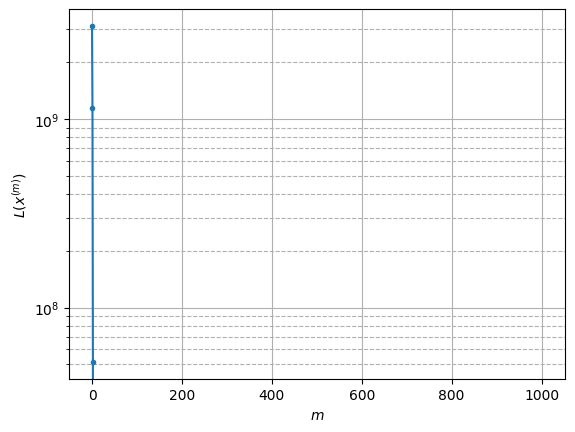

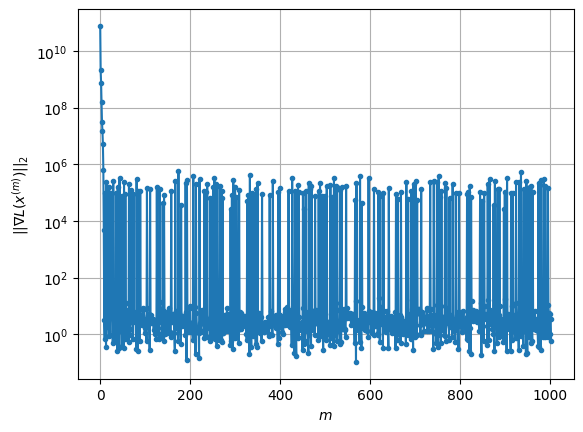

Windows:  52%|█████▏    | 155/296 [28:00<23:20,  9.93s/it]

Before applying the algorithm
Cost function: -23635163.27900567
Gradient norm: 351545.80724047177
Global relative error: 1.5416379487440863
Position relative errors: 0.038941038909082834 m, 0.9448286277974172 m, 0.3418255929069471 m, 1.168582137492323 m

Iteration 1
Cost function: -23635163.99019224 (-0.00%)
Gradient norm: 18.64827773539056 (-99.99%)
Global relative error: 1.6024377541136894 (3.94%)
Position relative errors: 0.037384251646775626 m, 1.1134489335303948 m, 0.3544324867856822 m, 1.0959087693340117 m

Iteration 2
Cost function: -23635163.990192004 (0.00%)
Gradient norm: 3.657769225983541 (-80.39%)
Global relative error: 1.6023811009429945 (-0.00%)
Position relative errors: 0.037384254713147796 m, 1.1134043556902329 m, 0.3544329242395612 m, 1.0958710808162637 m

Iteration 3
Cost function: -23635163.990192108 (-0.00%)
Gradient norm: 3.9937223134850433 (9.18%)
Global relative error: 1.6023811034883189 (0.00%)
Position relative errors: 0.037384251488285614 m, 1.1134043510289207

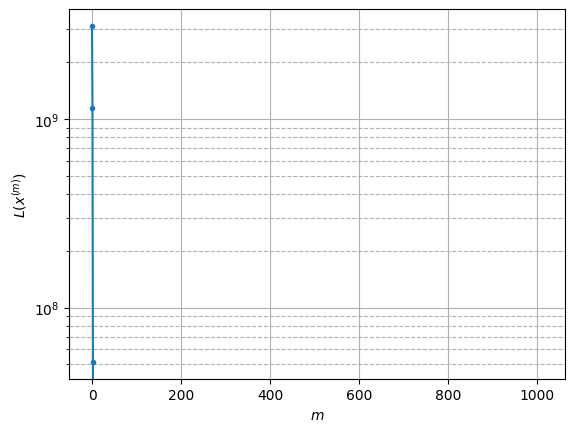

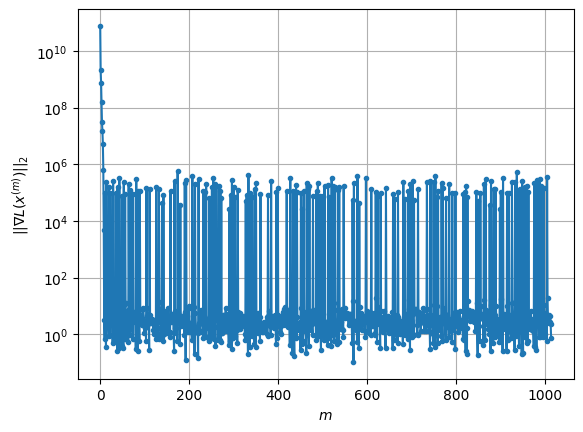

Windows:  53%|█████▎    | 156/296 [28:16<27:55, 11.97s/it]

Before applying the algorithm
Cost function: -23635157.397966377
Gradient norm: 154188.79294490747
Global relative error: 1.6225578376019525
Position relative errors: 0.03774268557344265 m, 1.151596655498794 m, 0.3520281425666687 m, 1.0868158522681857 m

Iteration 1
Cost function: -23635158.32674607 (-0.00%)
Gradient norm: 19.640234609746997 (-99.99%)
Global relative error: 1.151943217384576 (-29.00%)
Position relative errors: 0.03867749663231825 m, 0.696344826437479 m, 0.33406908698222837 m, 0.8538019354113618 m

Iteration 2
Cost function: -23635158.326746084 (-0.00%)
Gradient norm: 1.2580084868344998 (-93.59%)
Global relative error: 1.1519761802844621 (0.00%)
Position relative errors: 0.03867749686080271 m, 0.696354306901114 m, 0.3340990578821136 m, 0.8538269495958503 m

STOP on Iteration 3
Cost function = -23635158.326746214 (-0.00%)
Gradient norm = 0.3347264060815575 (-73.39%)
Global relative error = 1.1519761399048 (-0.00%)
Final position relative errors: 0.038677500508122416 m, 0

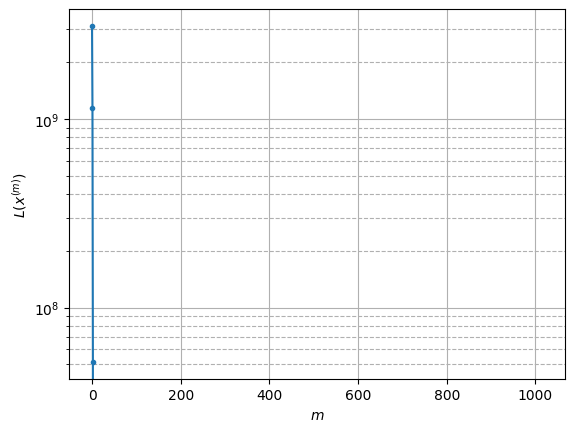

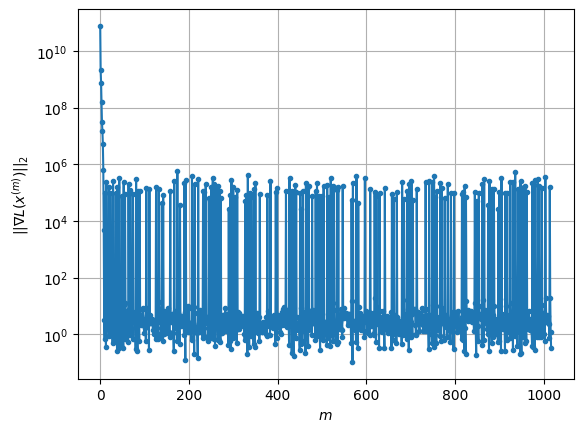

Windows:  53%|█████▎    | 157/296 [28:23<24:06, 10.41s/it]

Before applying the algorithm
Cost function: -23635159.754586056
Gradient norm: 164497.01676896782
Global relative error: 1.151650886349006
Position relative errors: 0.038747182567153406 m, 0.7144233668147992 m, 0.3345124720983026 m, 0.8381514890415855 m

Iteration 1
Cost function: -23635160.40433392 (-0.00%)
Gradient norm: 7.929264700064957 (-100.00%)
Global relative error: 0.9929115396628359 (-13.78%)
Position relative errors: 0.02505658282259962 m, 0.6933628164222829 m, 0.2897240794075299 m, 0.6485002588478501 m

Iteration 2
Cost function: -23635160.40433404 (-0.00%)
Gradient norm: 2.8022876246364756 (-64.66%)
Global relative error: 0.9928970400036385 (-0.00%)
Position relative errors: 0.025056586163110173 m, 0.6933387996257736 m, 0.28972847385590855 m, 0.6485017731368541 m

Iteration 3
Cost function: -23635160.40433408 (-0.00%)
Gradient norm: 2.1519564456710385 (-23.21%)
Global relative error: 0.9928970310116757 (-0.00%)
Position relative errors: 0.025056586072139765 m, 0.693338777

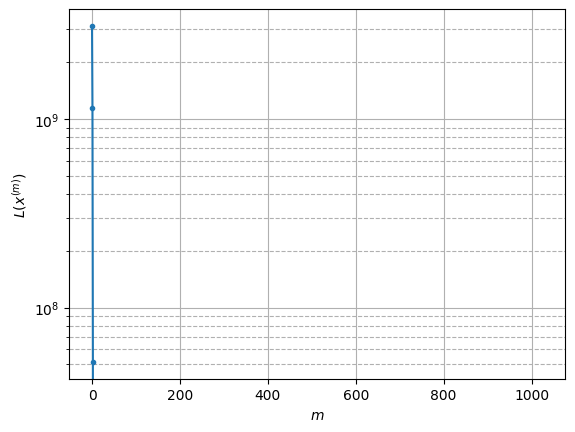

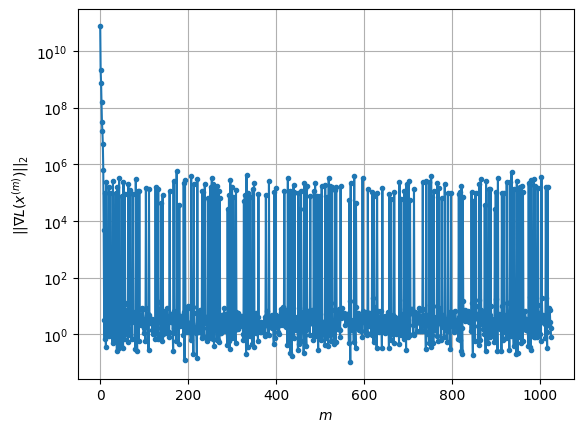

Windows:  53%|█████▎    | 158/296 [28:38<27:06, 11.79s/it]

Before applying the algorithm
Cost function: -23635168.859943237
Gradient norm: 150898.58173247208
Global relative error: 0.9852169858796908
Position relative errors: 0.025818626041041074 m, 0.7113007779873813 m, 0.2899393249920786 m, 0.6164182327623394 m

Iteration 1
Cost function: -23635169.777474854 (-0.00%)
Gradient norm: 22.357508163491335 (-99.99%)
Global relative error: 0.6843613689799831 (-30.54%)
Position relative errors: 0.02614092227956127 m, 0.33687821087197406 m, 0.10615647170796491 m, 0.5855856560893825 m

STOP on Iteration 2
Cost function = -23635169.777474992 (-0.00%)
Gradient norm = 0.7216976297697856 (-96.77%)
Global relative error = 0.6844000585118682 (0.01%)
Final position relative errors: 0.026140919059549225 m, 0.33688935732629727 m, 0.10619354147688342 m, 0.5856177385144928 m



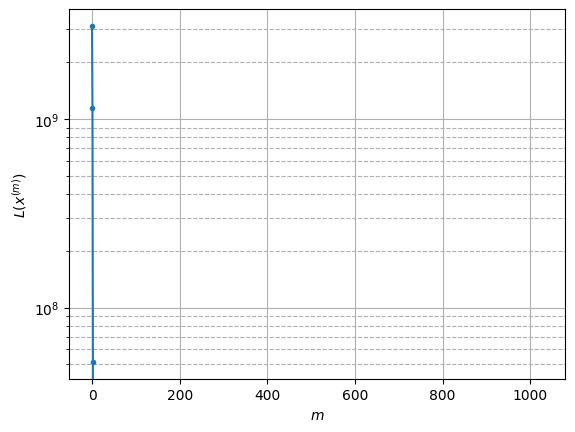

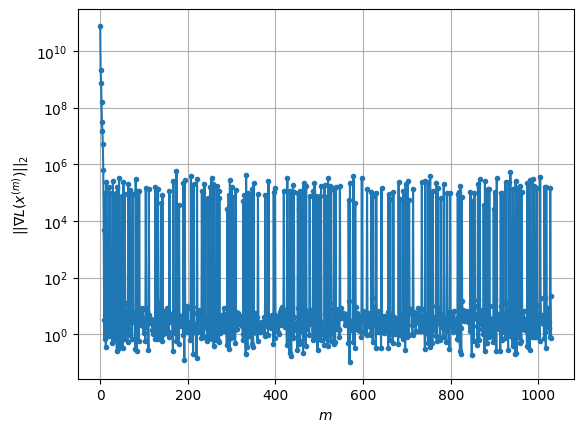

Windows:  54%|█████▎    | 159/296 [28:43<22:17,  9.77s/it]

Before applying the algorithm
Cost function: -23635172.765715424
Gradient norm: 138587.18794803004
Global relative error: 0.6533507394677747
Position relative errors: 0.026867982999401383 m, 0.3313122109547614 m, 0.10967925671571564 m, 0.5516769862353931 m

Iteration 1
Cost function: -23635173.00422591 (-0.00%)
Gradient norm: 9.07479094300277 (-99.99%)
Global relative error: 1.1300702411952708 (72.97%)
Position relative errors: 0.024723048164873068 m, 0.5933569074409774 m, 0.19341332024386426 m, 0.9417886477341406 m

Iteration 2
Cost function: -23635173.00422572 (0.00%)
Gradient norm: 1.9989566332834283 (-77.97%)
Global relative error: 1.130013073959063 (-0.01%)
Position relative errors: 0.024723044893936928 m, 0.5933081093817039 m, 0.19337627395688006 m, 0.9417584034842074 m

STOP on Iteration 3
Cost function = -23635173.004225623 (0.00%)
Gradient norm = 0.30209659002861994 (-84.89%)
Global relative error = 1.1300130667865764 (-0.00%)
Final position relative errors: 0.0247230441840063

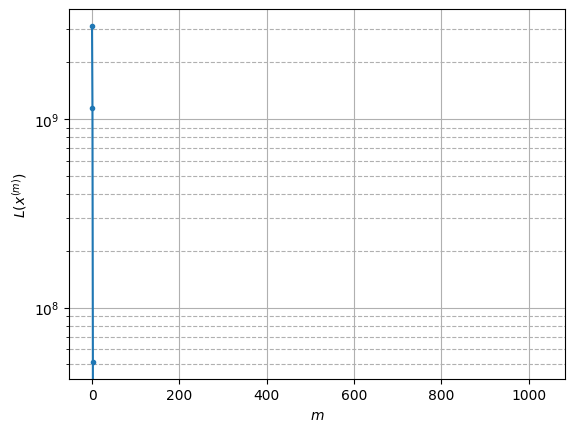

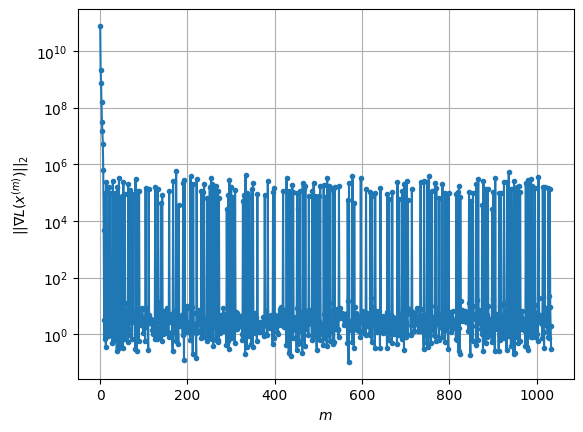

Windows:  54%|█████▍    | 160/296 [28:50<19:59,  8.82s/it]

Before applying the algorithm
Cost function: -23635174.403966483
Gradient norm: 38868.950437018466
Global relative error: 1.0942368785567003
Position relative errors: 0.025469111184154503 m, 0.5891907956709801 m, 0.19872802868064035 m, 0.9000369090264433 m

Iteration 1
Cost function: -23635174.632909782 (-0.00%)
Gradient norm: 2.3612489257658464 (-99.99%)
Global relative error: 0.8572256332344628 (-21.66%)
Position relative errors: 0.01645666870719019 m, 0.4144701942503887 m, 0.11758001631080993 m, 0.7409142096841309 m

Iteration 2
Cost function: -23635174.63290945 (0.00%)
Gradient norm: 4.502265273861302 (90.67%)
Global relative error: 0.8571953117944774 (-0.00%)
Position relative errors: 0.016456671808036692 m, 0.41444641310247365 m, 0.11758329574485984 m, 0.7408919109334196 m

Iteration 3
Cost function: -23635174.632909823 (-0.00%)
Gradient norm: 5.741874375690916 (27.53%)
Global relative error: 0.8571953383420472 (0.00%)
Position relative errors: 0.01645666969895827 m, 0.4144464040

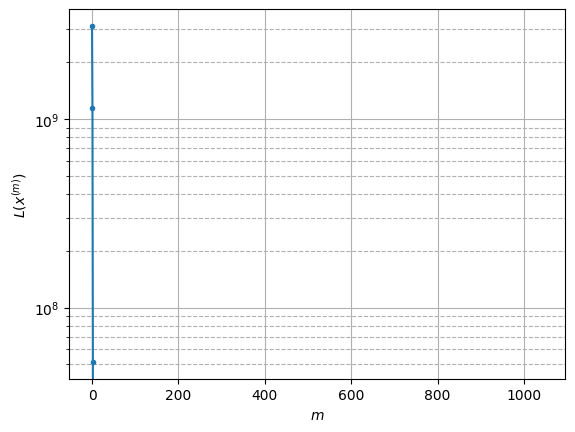

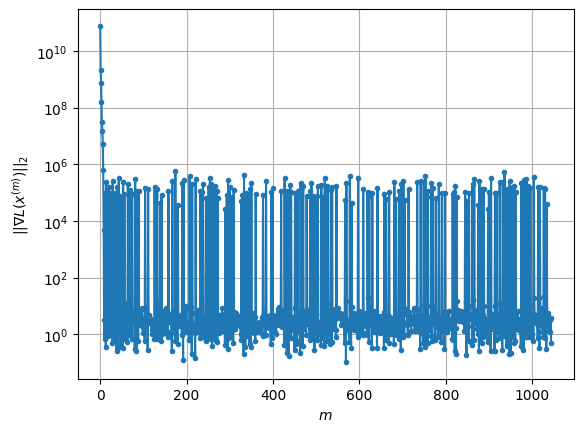

Windows:  54%|█████▍    | 161/296 [29:07<25:46, 11.46s/it]

Before applying the algorithm
Cost function: -23635185.80146416
Gradient norm: 32550.869110347106
Global relative error: 0.8216802713356283
Position relative errors: 0.017412195839161173 m, 0.41117022363064687 m, 0.1242249948395978 m, 0.7002584692212102 m

Iteration 1
Cost function: -23635186.221216664 (-0.00%)
Gradient norm: 4.985931412876353 (-99.98%)
Global relative error: 0.7482456572672859 (-8.94%)
Position relative errors: 0.016961291679148623 m, 0.3640458358781676 m, 0.1857354701004847 m, 0.6265426865844935 m

Iteration 2
Cost function: -23635186.22121676 (-0.00%)
Gradient norm: 4.310139263342773 (-13.55%)
Global relative error: 0.7482308710894001 (-0.00%)
Position relative errors: 0.016961290889917352 m, 0.3640416479483165 m, 0.1857352394496917 m, 0.6265275299963288 m

Iteration 3
Cost function: -23635186.221216407 (0.00%)
Gradient norm: 3.4830742673889854 (-19.19%)
Global relative error: 0.7482308149924216 (-0.00%)
Position relative errors: 0.016961292356670186 m, 0.3640416236

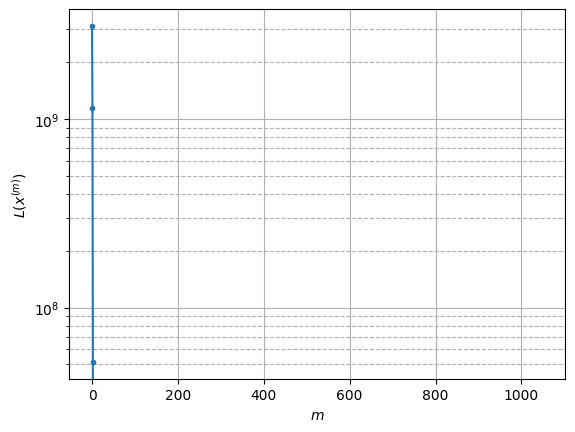

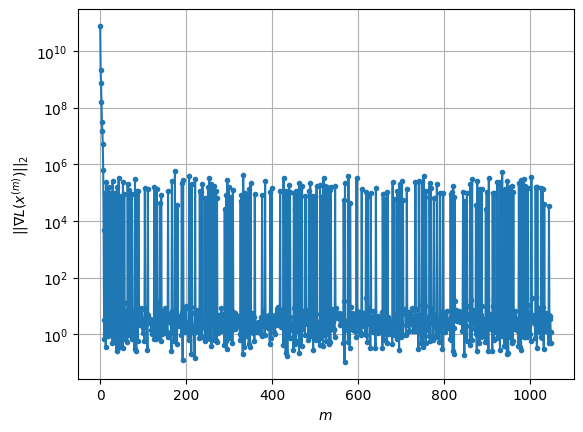

Windows:  55%|█████▍    | 162/296 [29:18<24:40, 11.05s/it]

Before applying the algorithm
Cost function: -23635180.41357246
Gradient norm: 286438.50947876397
Global relative error: 0.6975782763674039
Position relative errors: 0.017870676340307978 m, 0.36099673882071315 m, 0.19003392883467965 m, 0.5655646378263719 m

Iteration 1
Cost function: -23635181.317577347 (-0.00%)
Gradient norm: 8.266202105721582 (-100.00%)
Global relative error: 0.8261131009697693 (18.43%)
Position relative errors: 0.02123278410340812 m, 0.271249931359754 m, 0.21948311097801104 m, 0.7485064749302225 m

Iteration 2
Cost function: -23635181.31757758 (-0.00%)
Gradient norm: 2.92109090946987 (-64.66%)
Global relative error: 0.8260925880907284 (-0.00%)
Position relative errors: 0.02123278189111443 m, 0.27122311502757196 m, 0.2194852313264427 m, 0.7484929311590941 m

Iteration 3
Cost function: -23635181.317577243 (0.00%)
Gradient norm: 3.6753275221167416 (25.82%)
Global relative error: 0.8260926045507401 (0.00%)
Position relative errors: 0.02123278248422934 m, 0.2712231242201

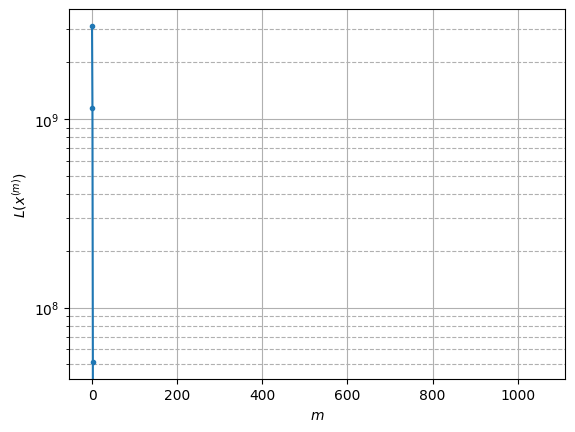

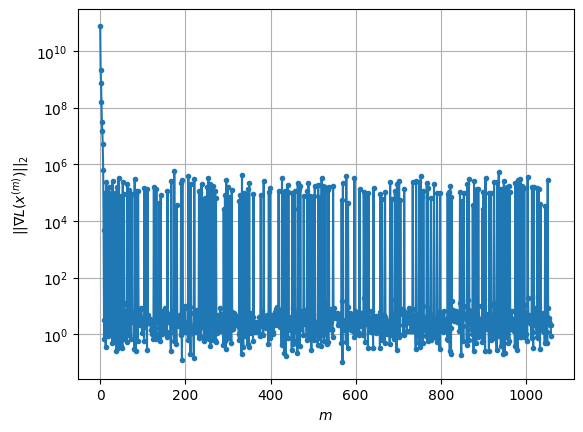

Windows:  55%|█████▌    | 163/296 [29:32<27:00, 12.18s/it]

Before applying the algorithm
Cost function: -23635182.242683806
Gradient norm: 241296.88191113804
Global relative error: 0.7787443214378569
Position relative errors: 0.02190999688549965 m, 0.25699263364265784 m, 0.221324774637865 m, 0.7006653895512088 m

Iteration 1
Cost function: -23635182.936880283 (-0.00%)
Gradient norm: 26.48761346470334 (-99.99%)
Global relative error: 1.1187679470067935 (43.66%)
Position relative errors: 0.02058613969427995 m, 0.5273773337949862 m, 0.19182030942326891 m, 0.9676231391496667 m

Iteration 2
Cost function: -23635182.936879896 (0.00%)
Gradient norm: 6.017292645858129 (-77.28%)
Global relative error: 1.1187865619621258 (0.00%)
Position relative errors: 0.020586137815157637 m, 0.5273791126221777 m, 0.19182365116869002 m, 0.9676430298325008 m

Iteration 3
Cost function: -23635182.93688011 (-0.00%)
Gradient norm: 8.946706384875482 (48.68%)
Global relative error: 1.1187865505981989 (-0.00%)
Position relative errors: 0.020586138976903468 m, 0.5273790882557

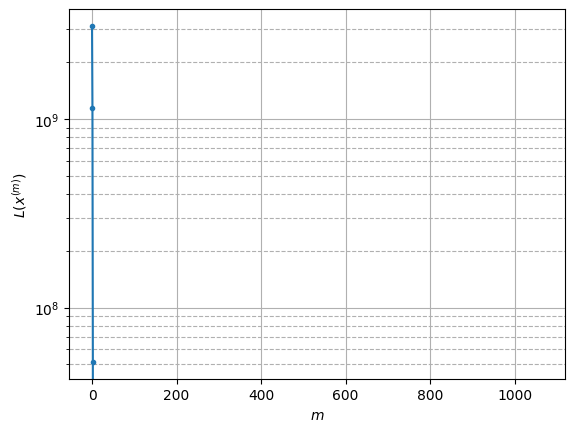

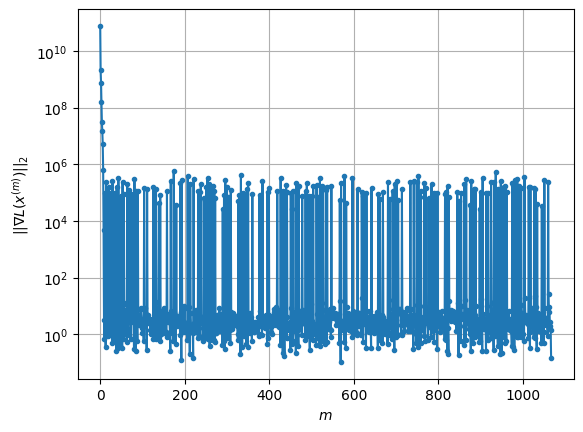

Windows:  55%|█████▌    | 164/296 [29:46<27:26, 12.48s/it]

Before applying the algorithm
Cost function: -23635192.775879946
Gradient norm: 27625.16223505075
Global relative error: 1.0458939076714486
Position relative errors: 0.021528984809008524 m, 0.484329320302571 m, 0.1889713434308095 m, 0.9072727341597803 m

Iteration 1
Cost function: -23635193.44524358 (-0.00%)
Gradient norm: 18.010290154999204 (-99.93%)
Global relative error: 1.3568803766353996 (29.73%)
Position relative errors: 0.030939335306881175 m, 0.7435937108382636 m, 0.2970536740763541 m, 1.0949849385934205 m

Iteration 2
Cost function: -23635193.445243668 (-0.00%)
Gradient norm: 9.219513911115495 (-48.81%)
Global relative error: 1.356935250750031 (0.00%)
Position relative errors: 0.030939330257367254 m, 0.7436354756231759 m, 0.29705326049959474 m, 1.095024687410175 m

Iteration 3
Cost function: -23635193.445243783 (-0.00%)
Gradient norm: 5.141182816947801 (-44.24%)
Global relative error: 1.356935214630962 (-0.00%)
Position relative errors: 0.03093933018933255 m, 0.743635457009935

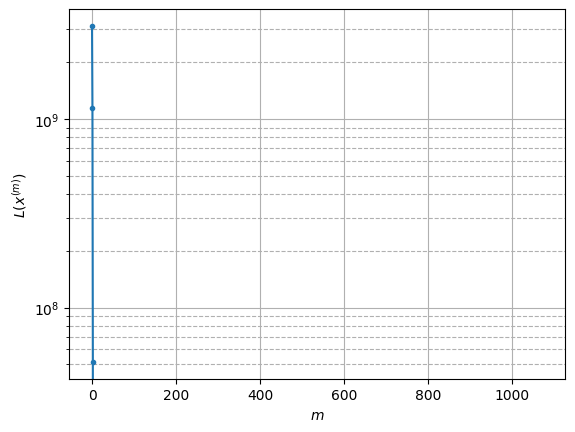

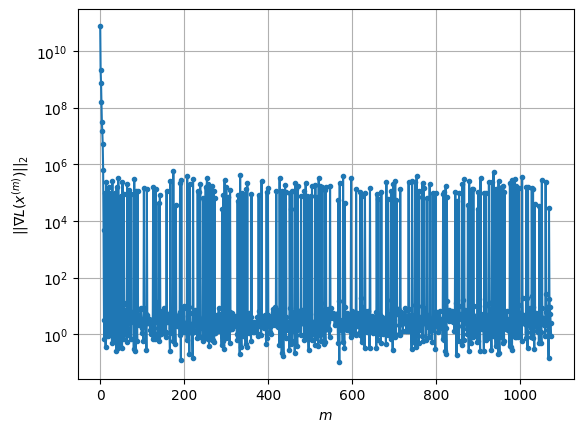

Windows:  56%|█████▌    | 165/296 [29:56<25:40, 11.76s/it]

Before applying the algorithm
Cost function: -23635193.41886775
Gradient norm: 195492.17447322316
Global relative error: 1.2589580347883562
Position relative errors: 0.03172005064011796 m, 0.6814133761284477 m, 0.2808134532539995 m, 1.0201891422371219 m

Iteration 1
Cost function: -23635193.811284225 (-0.00%)
Gradient norm: 3.218605842302457 (-100.00%)
Global relative error: 1.422192304744958 (12.97%)
Position relative errors: 0.03743947771914656 m, 0.8022311992271143 m, 0.1556940413922669 m, 1.1633619438975555 m

STOP on Iteration 2
Cost function = -23635193.81128387 (0.00%)
Gradient norm = 0.43783365085803355 (-86.40%)
Global relative error = 1.4221717374354796 (-0.00%)
Final position relative errors: 0.03743947786527978 m, 0.8022168995520161 m, 0.1556971899093697 m, 1.1633462400748196 m



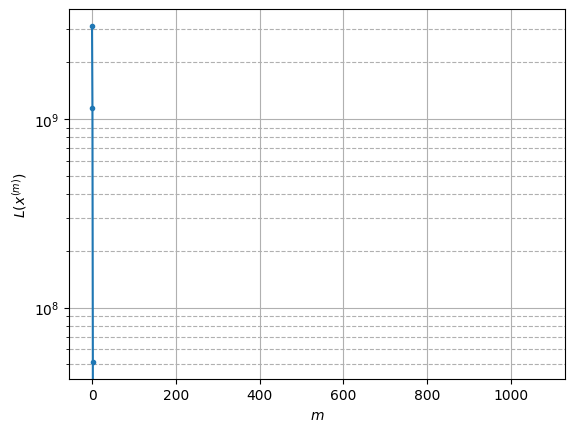

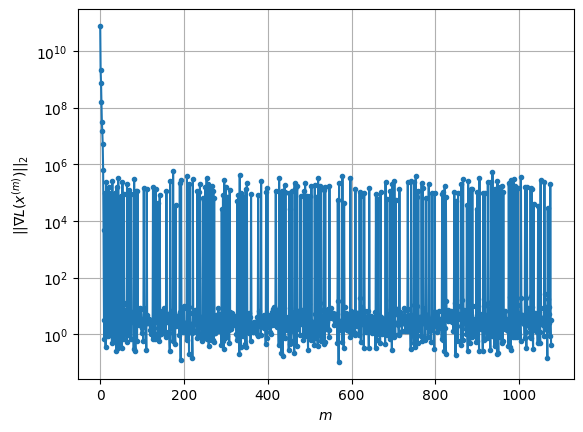

Windows:  56%|█████▌    | 166/296 [30:01<21:12,  9.79s/it]

Before applying the algorithm
Cost function: -23635194.74245425
Gradient norm: 132770.4007085815
Global relative error: 1.3253206310349708
Position relative errors: 0.038074212680383614 m, 0.7305984947925305 m, 0.1497984589059449 m, 1.0949010861041708 m

Iteration 1
Cost function: -23635195.208876844 (-0.00%)
Gradient norm: 8.970013703347917 (-99.99%)
Global relative error: 1.2790232975874778 (-3.49%)
Position relative errors: 0.04199630469092716 m, 0.691036398604833 m, 0.15807157528137677 m, 1.0637748890787462 m

Iteration 2
Cost function: -23635195.20887698 (-0.00%)
Gradient norm: 7.847536066596275 (-12.51%)
Global relative error: 1.279020442485661 (-0.00%)
Position relative errors: 0.041996301589374785 m, 0.691038161089049 m, 0.15806756055751306 m, 1.0637709080131466 m

Iteration 3
Cost function: -23635195.20887696 (0.00%)
Gradient norm: 6.120272207344023 (-22.01%)
Global relative error: 1.2790204770871885 (0.00%)
Position relative errors: 0.04199630437783058 m, 0.6910381470550142 m

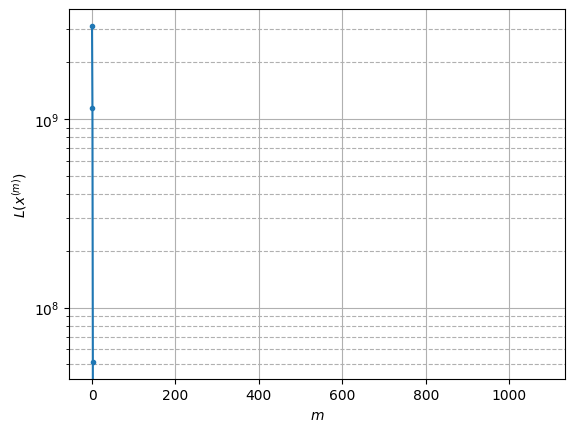

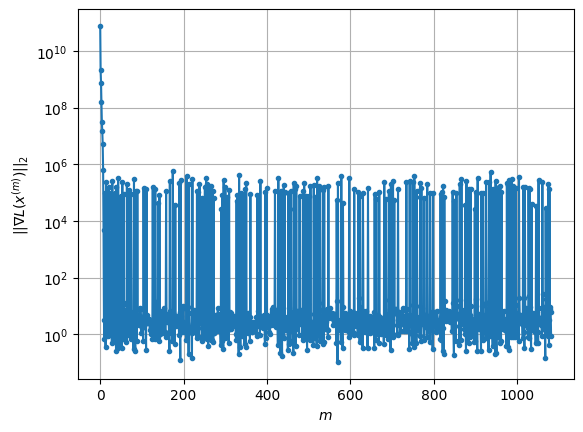

Windows:  56%|█████▋    | 167/296 [30:09<20:04,  9.33s/it]

Before applying the algorithm
Cost function: -23635200.449081637
Gradient norm: 66259.4764681973
Global relative error: 1.2017374418405262
Position relative errors: 0.04259374544324691 m, 0.6266999588750407 m, 0.15999898355545505 m, 1.011930805894343 m

Iteration 1
Cost function: -23635201.08064032 (-0.00%)
Gradient norm: 16.723170850234172 (-99.97%)
Global relative error: 1.4063663745661417 (17.03%)
Position relative errors: 0.03448098972102068 m, 0.8929939321337226 m, 0.16896911317875157 m, 1.0727000097169028 m

Iteration 2
Cost function: -23635201.080640007 (0.00%)
Gradient norm: 4.368577962362528 (-73.88%)
Global relative error: 1.4063647461172637 (-0.00%)
Position relative errors: 0.03448098793547735 m, 0.8929742680482333 m, 0.1689719910192557 m, 1.0727137910046638 m

Iteration 3
Cost function: -23635201.080640104 (-0.00%)
Gradient norm: 2.20411918698625 (-49.55%)
Global relative error: 1.4063647331135247 (-0.00%)
Position relative errors: 0.03448099475435428 m, 0.8929742591171982

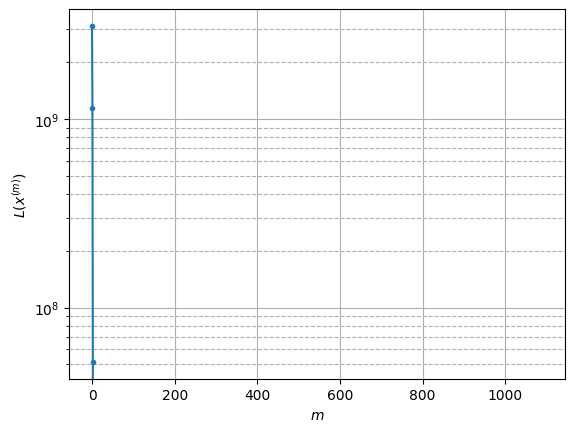

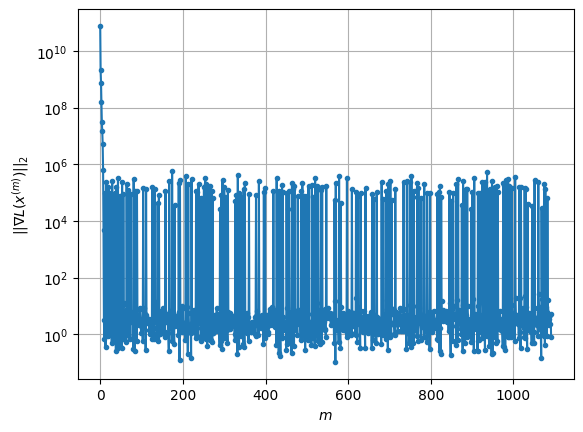

Windows:  57%|█████▋    | 168/296 [30:25<24:15, 11.37s/it]

Before applying the algorithm
Cost function: -23635200.761077892
Gradient norm: 91666.96299211688
Global relative error: 1.2993610925388954
Position relative errors: 0.035344100764918125 m, 0.8045998017271039 m, 0.15986692711067574 m, 1.007049171785531 m

Iteration 1
Cost function: -23635201.199437816 (-0.00%)
Gradient norm: 2.712229077810789 (-100.00%)
Global relative error: 1.3647802362405141 (5.03%)
Position relative errors: 0.02726624687955338 m, 0.9856947642297915 m, 0.12955384772052664 m, 0.9346113890659659 m

Iteration 2
Cost function: -23635201.199437454 (0.00%)
Gradient norm: 2.6808290540877957 (-1.16%)
Global relative error: 1.364779409172968 (-0.00%)
Position relative errors: 0.027266245634720028 m, 0.9856817406662858 m, 0.12955576383275144 m, 0.9346236509623784 m

Iteration 3
Cost function: -23635201.19943774 (-0.00%)
Gradient norm: 1.5388004589657807 (-42.60%)
Global relative error: 1.364779412359478 (0.00%)
Position relative errors: 0.027266250782305844 m, 0.9856817356685

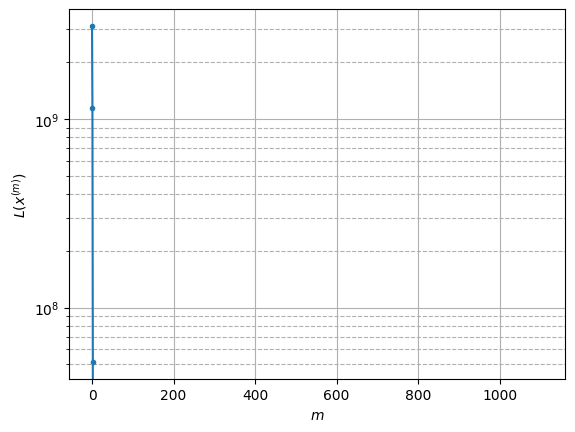

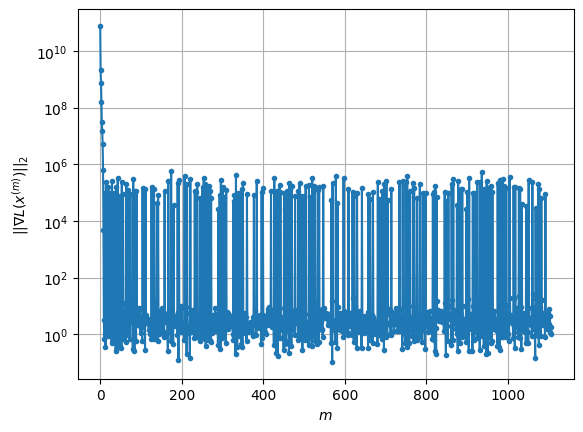

Windows:  57%|█████▋    | 169/296 [30:49<32:14, 15.23s/it]

Before applying the algorithm
Cost function: -23635196.186929505
Gradient norm: 99502.45564826006
Global relative error: 1.2366642407584663
Position relative errors: 0.028369674021755033 m, 0.8861488657498063 m, 0.1352340433939251 m, 0.8514577649536462 m

Iteration 1
Cost function: -23635196.383525603 (-0.00%)
Gradient norm: 3.6670213277212413 (-100.00%)
Global relative error: 1.5561586452081313 (25.84%)
Position relative errors: 0.028748374474733808 m, 1.0860338494711352 m, 0.1811923320215436 m, 1.0993164828231299 m

Iteration 2
Cost function: -23635196.383525655 (-0.00%)
Gradient norm: 1.7935536308017617 (-51.09%)
Global relative error: 1.5561304807093237 (-0.00%)
Position relative errors: 0.028748378164026908 m, 1.086011982852627 m, 0.18117921318233599 m, 1.0993003786260063 m

STOP on Iteration 3
Cost function = -23635196.38352576 (-0.00%)
Gradient norm = 0.6669756353471831 (-62.81%)
Global relative error = 1.556130495320732 (0.00%)
Final position relative errors: 0.0287483799979873

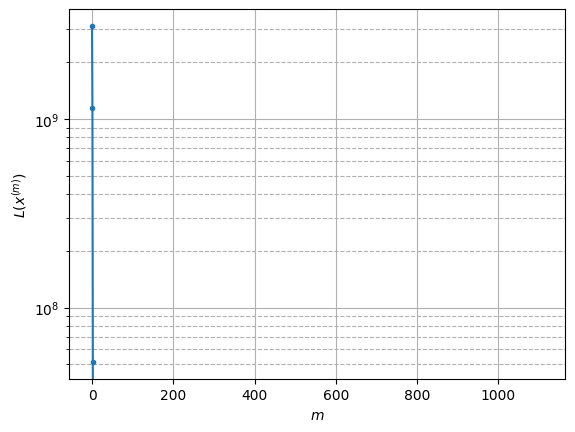

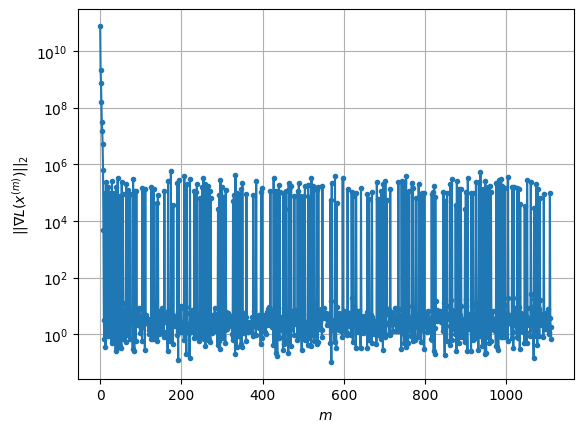

Windows:  57%|█████▋    | 170/296 [30:56<26:43, 12.73s/it]

Before applying the algorithm
Cost function: -23635197.468211282
Gradient norm: 65342.23970474113
Global relative error: 1.4075500746540286
Position relative errors: 0.029601459877481265 m, 0.975774686321522 m, 0.188600956978742 m, 0.9962969100132879 m

Iteration 1
Cost function: -23635197.706272025 (-0.00%)
Gradient norm: 3.93540944326469 (-99.99%)
Global relative error: 1.6377413584621978 (16.35%)
Position relative errors: 0.024023053299473553 m, 1.186706748028508 m, 0.20783163047513611 m, 1.109119458112346 m

Iteration 2
Cost function: -23635197.706272904 (-0.00%)
Gradient norm: 8.538013429360953 (116.95%)
Global relative error: 1.6377477132884828 (0.00%)
Position relative errors: 0.02402305322035551 m, 1.18670915054134 m, 0.20782779861171544 m, 1.1091269891746558 m

Iteration 3
Cost function: -23635197.706272487 (0.00%)
Gradient norm: 1.9147245086961313 (-77.57%)
Global relative error: 1.6377477557237958 (0.00%)
Position relative errors: 0.024023052533625102 m, 1.1867091661631768 m

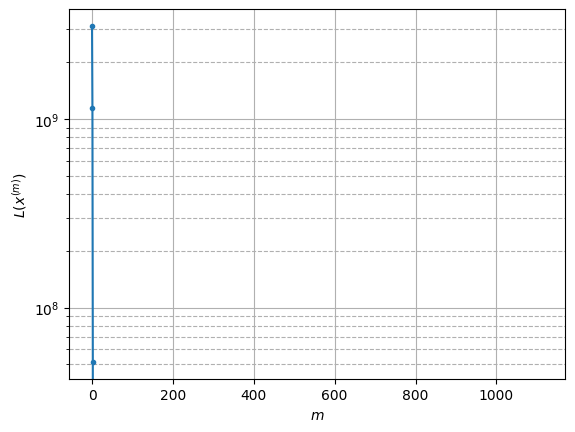

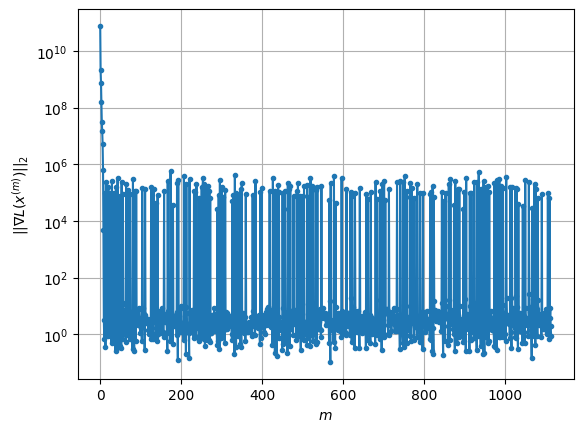

Windows:  58%|█████▊    | 171/296 [31:05<23:45, 11.41s/it]

Before applying the algorithm
Cost function: -23635195.815704033
Gradient norm: 134411.80398462623
Global relative error: 1.4837645622329931
Position relative errors: 0.02519521407427077 m, 1.0679033957767283 m, 0.2137434223974352 m, 1.0073783833353727 m

Iteration 1
Cost function: -23635196.534836993 (-0.00%)
Gradient norm: 7.250553776164273 (-99.99%)
Global relative error: 1.6825709870103351 (13.40%)
Position relative errors: 0.0245337914145736 m, 1.185222516912326 m, 0.4160270980471442 m, 1.1191977210433226 m

STOP on Iteration 2
Cost function = -23635196.534836847 (0.00%)
Gradient norm = 0.4826477990395274 (-93.34%)
Global relative error = 1.6825262655056406 (-0.00%)
Final position relative errors: 0.02453378590381984 m, 1.1851933656668208 m, 0.41601189983099063 m, 1.119167008611938 m



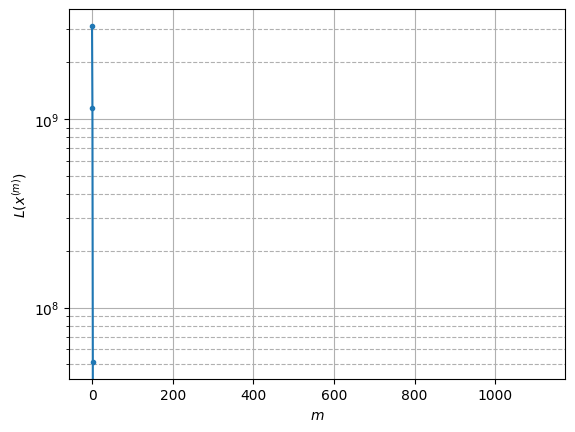

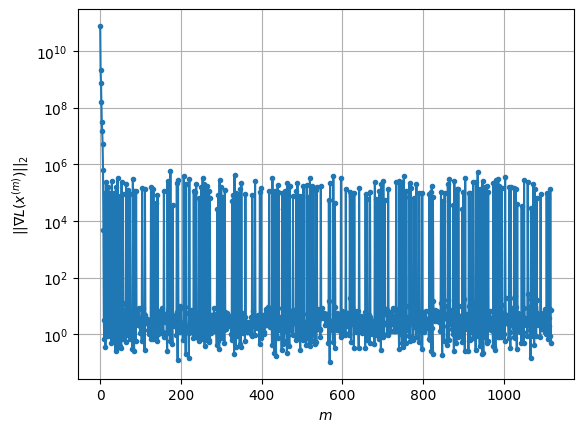

Windows:  58%|█████▊    | 172/296 [31:10<19:41,  9.53s/it]

Before applying the algorithm
Cost function: -23635204.621471006
Gradient norm: 30322.022488271577
Global relative error: 1.5128597614031938
Position relative errors: 0.025725455386953002 m, 1.066769872239138 m, 0.4105464025437848 m, 0.9907205338711587 m

Iteration 1
Cost function: -23635204.8819383 (-0.00%)
Gradient norm: 6.233741605211001 (-99.98%)
Global relative error: 1.6833152725048302 (11.27%)
Position relative errors: 0.020129984069738715 m, 1.056568584484941 m, 0.39293962467526683 m, 1.2499586763355384 m

Iteration 2
Cost function: -23635204.881938364 (-0.00%)
Gradient norm: 5.61809512677811 (-9.88%)
Global relative error: 1.6833361919311853 (0.00%)
Position relative errors: 0.020129986213789492 m, 1.0565642320343704 m, 0.3929400160260463 m, 1.2499904042069934 m

Iteration 3
Cost function: -23635204.88193877 (-0.00%)
Gradient norm: 5.0655284252084565 (-9.84%)
Global relative error: 1.6833361693791613 (-0.00%)
Position relative errors: 0.020129985393781025 m, 1.0565642207947183

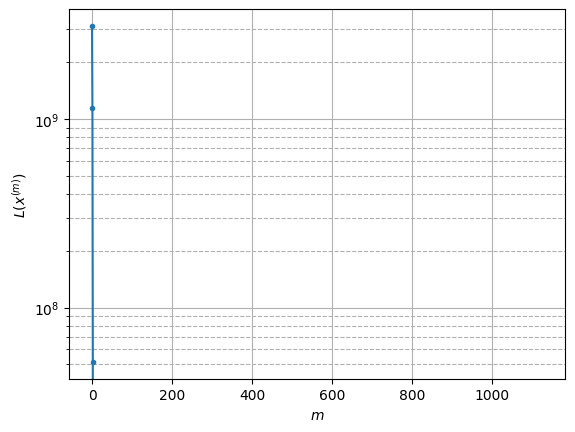

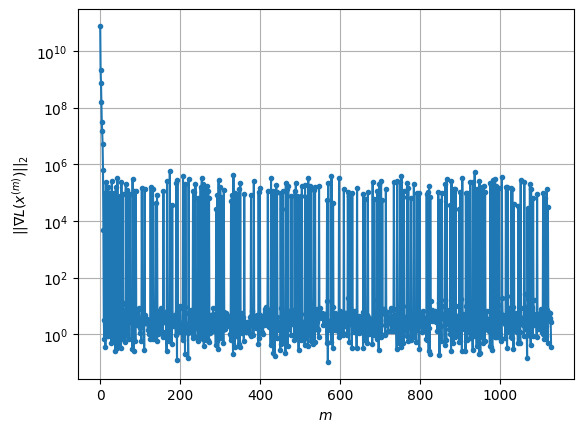

Windows:  58%|█████▊    | 173/296 [31:25<22:54, 11.17s/it]

Before applying the algorithm
Cost function: -23635205.966992192
Gradient norm: 104879.02425109758
Global relative error: 1.502888761152231
Position relative errors: 0.02129276857674045 m, 0.9375078850122375 m, 0.3861131521808605 m, 1.1091467317915689 m

Iteration 1
Cost function: -23635206.33223381 (-0.00%)
Gradient norm: 8.565658181092843 (-99.99%)
Global relative error: 1.5274446817661693 (1.63%)
Position relative errors: 0.023503524532749343 m, 0.8801530489350803 m, 0.4859549154693923 m, 1.1496542596074537 m

STOP on Iteration 2
Cost function = -23635206.332233217 (0.00%)
Gradient norm = 0.5203990943840493 (-93.92%)
Global relative error = 1.527414508299106 (-0.00%)
Final position relative errors: 0.023503522135838787 m, 0.8801252313496103 m, 0.4859501432502391 m, 1.1496374845730792 m



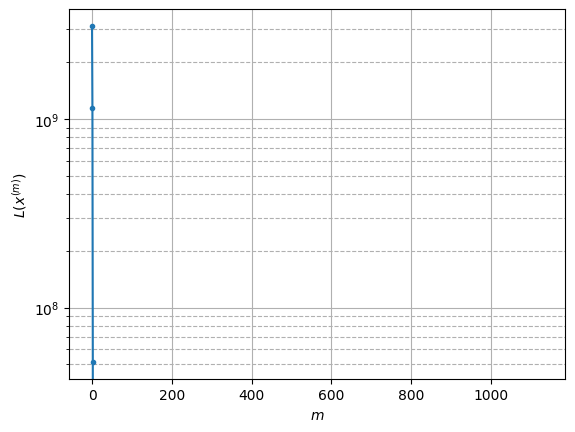

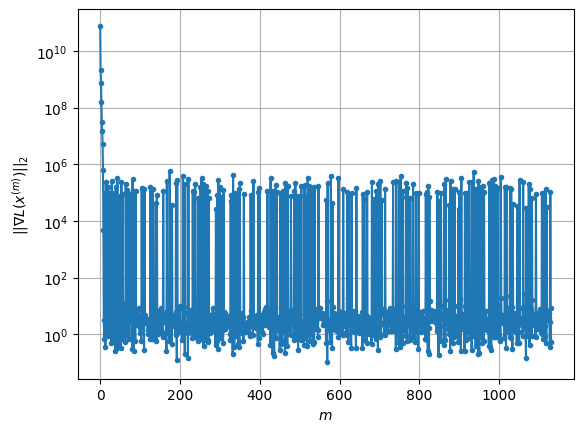

Windows:  59%|█████▉    | 174/296 [31:30<19:03,  9.37s/it]

Before applying the algorithm
Cost function: -23635204.838755973
Gradient norm: 142077.86147954228
Global relative error: 1.3620125209168858
Position relative errors: 0.024637599793495637 m, 0.7734986043916765 m, 0.4702486147530226 m, 1.0173634105222096 m

Iteration 1
Cost function: -23635205.64949367 (-0.00%)
Gradient norm: 12.049464264788856 (-99.99%)
Global relative error: 1.2786889699679005 (-6.12%)
Position relative errors: 0.02865364596870369 m, 0.6863113018643118 m, 0.6917907027171947 m, 0.8274164695194083 m

STOP on Iteration 2
Cost function = -23635205.649494264 (-0.00%)
Gradient norm = 0.3857105721433076 (-96.80%)
Global relative error = 1.2787018101696848 (0.00%)
Final position relative errors: 0.028653648500093967 m, 0.6863196104955273 m, 0.6917834375725042 m, 0.8274354949992249 m



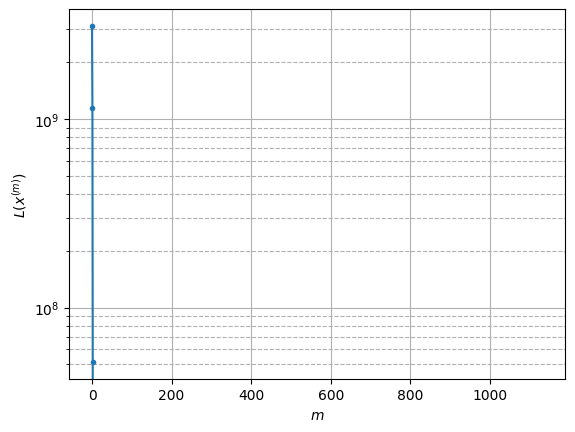

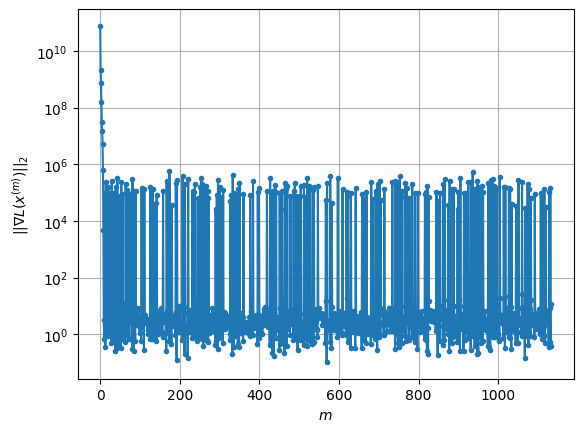

Windows:  59%|█████▉    | 175/296 [31:35<16:21,  8.11s/it]

Before applying the algorithm
Cost function: -23635213.443552956
Gradient norm: 176069.90032978627
Global relative error: 1.12225175007123
Position relative errors: 0.029678551797981376 m, 0.5853790418577897 m, 0.654836218317827 m, 0.6979110117614177 m

Iteration 1
Cost function: -23635214.431341257 (-0.00%)
Gradient norm: 14.337246254942444 (-99.99%)
Global relative error: 1.044845562765892 (-6.90%)
Position relative errors: 0.02703109599550278 m, 0.48398608967582696 m, 0.432475293547989 m, 0.8183415105769034 m

Iteration 2
Cost function: -23635214.431341823 (-0.00%)
Gradient norm: 2.692565284459134 (-81.22%)
Global relative error: 1.0448223105697863 (-0.00%)
Position relative errors: 0.027031098878948407 m, 0.4839658571817095 m, 0.43246351994081256 m, 0.8183300103723548 m

STOP on Iteration 3
Cost function = -23635214.431341585 (0.00%)
Gradient norm = 0.5171246609878214 (-80.79%)
Global relative error = 1.0448223669543446 (0.00%)
Final position relative errors: 0.027031098228171836 m

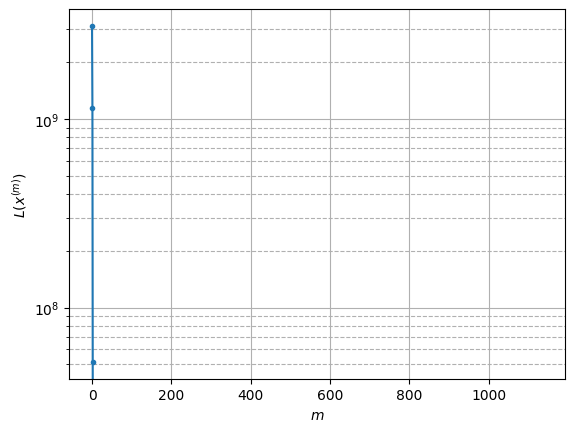

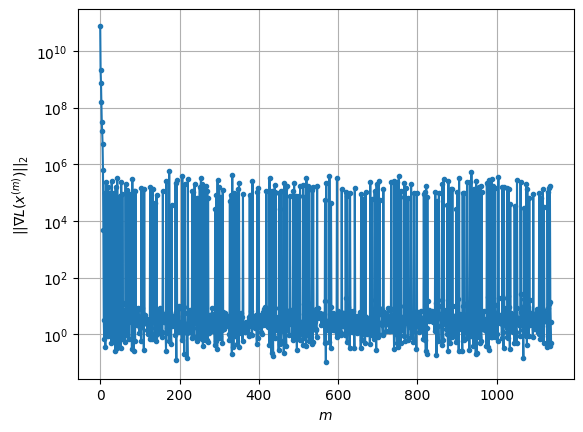

Windows:  59%|█████▉    | 176/296 [31:42<15:26,  7.72s/it]

Before applying the algorithm
Cost function: -23635217.4080576
Gradient norm: 121742.00303585637
Global relative error: 0.867603879173706
Position relative errors: 0.028194090287787625 m, 0.3804591021627661 m, 0.4113423255621391 m, 0.6617992226989261 m

Iteration 1
Cost function: -23635217.94936172 (-0.00%)
Gradient norm: 5.089332199320419 (-100.00%)
Global relative error: 0.7201769260227258 (-16.99%)
Position relative errors: 0.02988189877257787 m, 0.1882559027302023 m, 0.3225818529912472 m, 0.615022643013897 m

Iteration 2
Cost function: -23635217.94936201 (-0.00%)
Gradient norm: 3.885898765550971 (-23.65%)
Global relative error: 0.7201382101993025 (-0.01%)
Position relative errors: 0.029881894262794806 m, 0.18821099777544825 m, 0.32257560583107453 m, 0.6149943288536246 m

Iteration 3
Cost function: -23635217.949361764 (0.00%)
Gradient norm: 3.625339372944996 (-6.71%)
Global relative error: 0.720138223470384 (0.00%)
Position relative errors: 0.029881894711629307 m, 0.1882110054392473

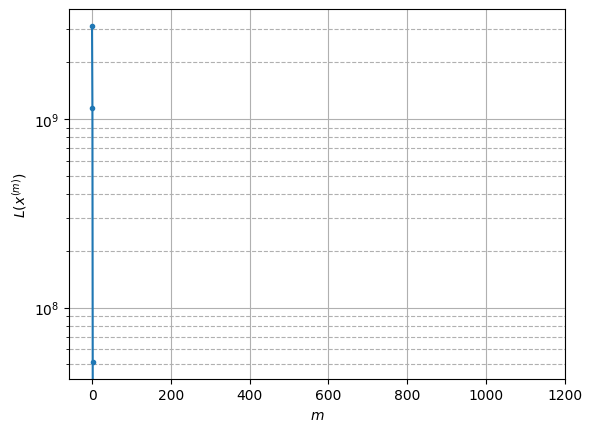

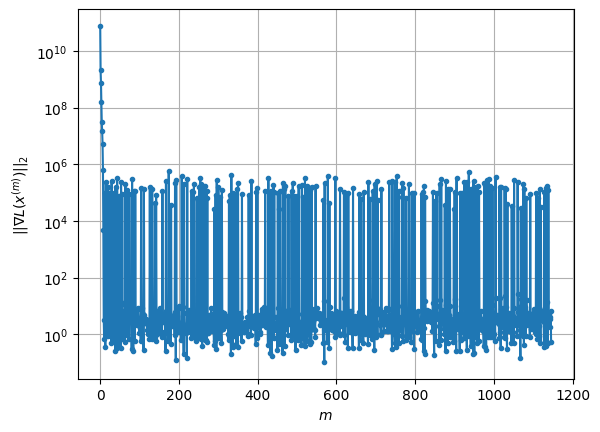

Windows:  60%|█████▉    | 177/296 [31:55<18:34,  9.36s/it]

Before applying the algorithm
Cost function: -23635215.661427207
Gradient norm: 194444.65246870444
Global relative error: 0.5608906722294216
Position relative errors: 0.030818498035709536 m, 0.10099702213727446 m, 0.30139156889701413 m, 0.4610871423838062 m

Iteration 1
Cost function: -23635216.29349311 (-0.00%)
Gradient norm: 8.479938339355256 (-100.00%)
Global relative error: 0.9252843346732776 (64.97%)
Position relative errors: 0.03725020957282913 m, 0.18612920717874418 m, 0.3299596036455234 m, 0.8433467989159096 m

Iteration 2
Cost function: -23635216.293493446 (-0.00%)
Gradient norm: 7.178021119979008 (-15.35%)
Global relative error: 0.9253247188674955 (0.00%)
Position relative errors: 0.037250214833070845 m, 0.18611664301119643 m, 0.32995749950793296 m, 0.8433947022076024 m

Iteration 3
Cost function: -23635216.293493286 (0.00%)
Gradient norm: 3.8076214033734987 (-46.95%)
Global relative error: 0.9253246993324175 (-0.00%)
Position relative errors: 0.03725021389396045 m, 0.1861166

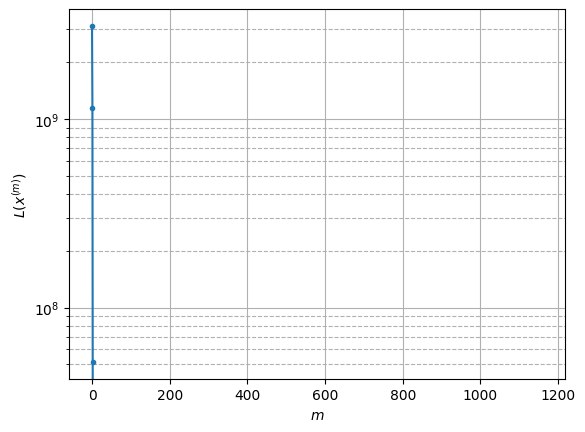

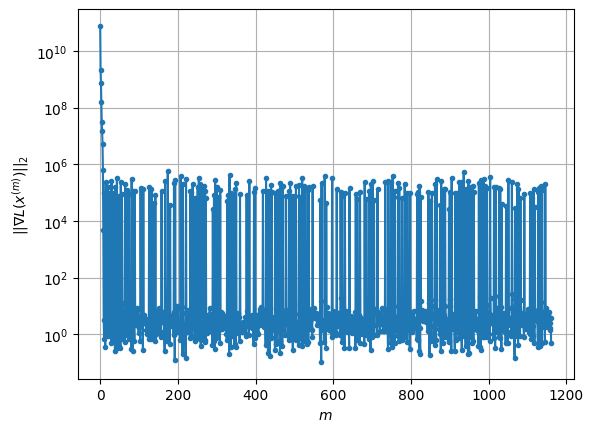

Windows:  60%|██████    | 178/296 [32:21<28:12, 14.35s/it]

Before applying the algorithm
Cost function: -23635211.275333863
Gradient norm: 311413.3375693936
Global relative error: 0.7502488264327167
Position relative errors: 0.03786923800094314 m, 0.12061333953471395 m, 0.3071523438609909 m, 0.6727082958966782 m

Iteration 1
Cost function: -23635211.789195802 (-0.00%)
Gradient norm: 6.507728605711641 (-100.00%)
Global relative error: 0.990241946298622 (31.99%)
Position relative errors: 0.03572593761126255 m, 0.08923461635956877 m, 0.3537252820623373 m, 0.9198942879063218 m

Iteration 2
Cost function: -23635211.78919555 (0.00%)
Gradient norm: 4.008384513844551 (-38.41%)
Global relative error: 0.9902492771493152 (0.00%)
Position relative errors: 0.03572594163142026 m, 0.08923268263233251 m, 0.3537240240615695 m, 0.9199028505728651 m

Iteration 3
Cost function: -23635211.789195962 (-0.00%)
Gradient norm: 4.738351645738042 (18.21%)
Global relative error: 0.9902492727228507 (-0.00%)
Position relative errors: 0.03572594541957088 m, 0.089232684973869

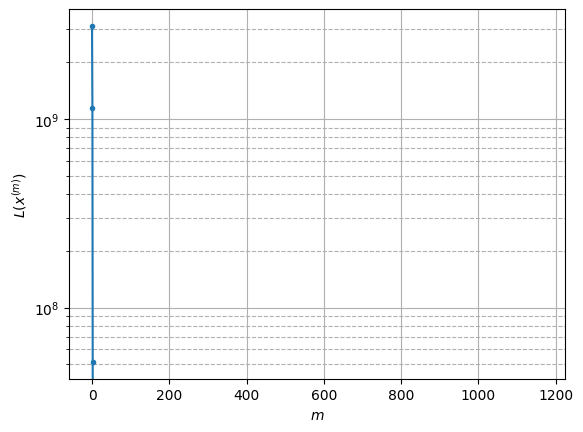

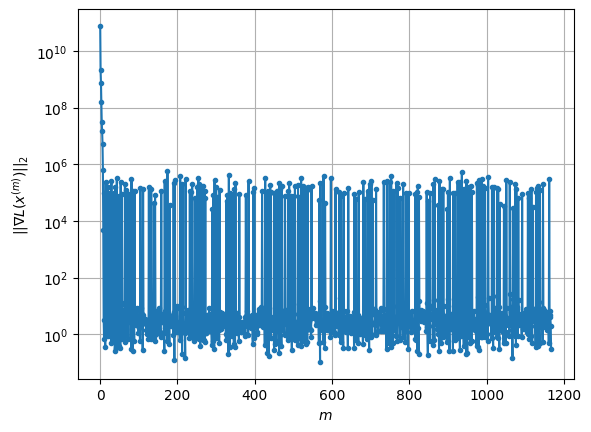

Windows:  60%|██████    | 179/296 [32:31<25:26, 13.05s/it]

Before applying the algorithm
Cost function: -23635210.270398743
Gradient norm: 205248.65605283974
Global relative error: 0.8158882789103834
Position relative errors: 0.03625315195957862 m, 0.12539774517534522 m, 0.3209073836542066 m, 0.738674486670901 m

Iteration 1
Cost function: -23635210.915108033 (-0.00%)
Gradient norm: 9.194057863738033 (-100.00%)
Global relative error: 0.9363358705971396 (14.76%)
Position relative errors: 0.03629137509927442 m, 0.195967201780567 m, 0.3479204048425581 m, 0.8461332855270979 m

Iteration 2
Cost function: -23635210.915107504 (0.00%)
Gradient norm: 4.624933167180001 (-49.70%)
Global relative error: 0.9363253487517716 (-0.00%)
Position relative errors: 0.036291371557507626 m, 0.19597977238661612 m, 0.347919878779847 m, 0.8461189469155966 m

Iteration 3
Cost function: -23635210.91510749 (0.00%)
Gradient norm: 1.5622765520972182 (-66.22%)
Global relative error: 0.9363253419510207 (-0.00%)
Position relative errors: 0.036291375813849204 m, 0.1959797761402

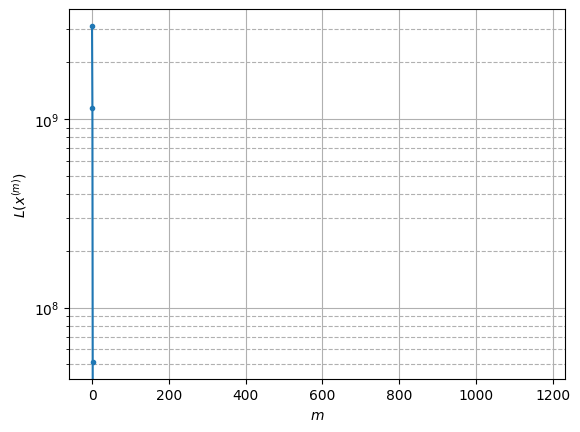

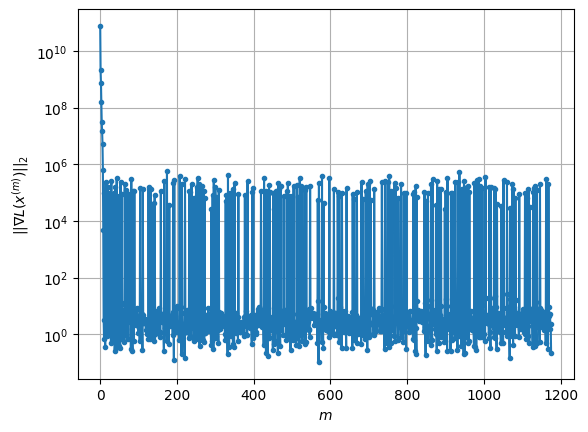

Windows:  61%|██████    | 180/296 [32:44<25:23, 13.13s/it]

Before applying the algorithm
Cost function: -23635206.205811374
Gradient norm: 161542.48509678218
Global relative error: 0.7857820941061475
Position relative errors: 0.03683651683575279 m, 0.2575949239774063 m, 0.32592236439659705 m, 0.6659588778777565 m

Iteration 1
Cost function: -23635206.441354815 (-0.00%)
Gradient norm: 3.188318074520577 (-100.00%)
Global relative error: 0.7304703647623092 (-7.04%)
Position relative errors: 0.03150260059553562 m, 0.2513267832681267 m, 0.3256418997344005 m, 0.6028047107836049 m

Iteration 2
Cost function: -23635206.441354584 (0.00%)
Gradient norm: 1.5374375508945006 (-51.78%)
Global relative error: 0.7304689680864315 (-0.00%)
Position relative errors: 0.03150260109232921 m, 0.25132873109156373 m, 0.3256417579113908 m, 0.6028022827627656 m

Iteration 3
Cost function: -23635206.44135498 (-0.00%)
Gradient norm: 3.158041376987604 (105.41%)
Global relative error: 0.7304689848975625 (0.00%)
Position relative errors: 0.03150260044701355 m, 0.251328725038

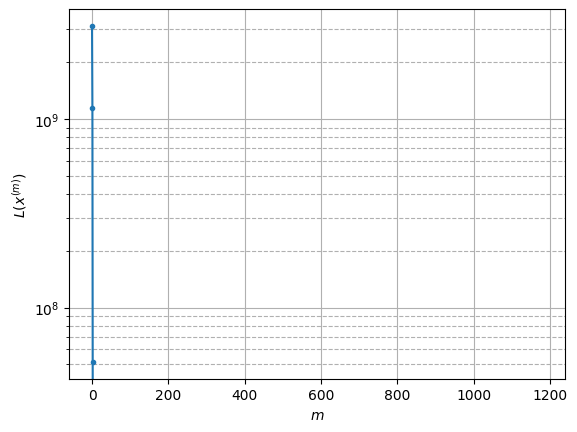

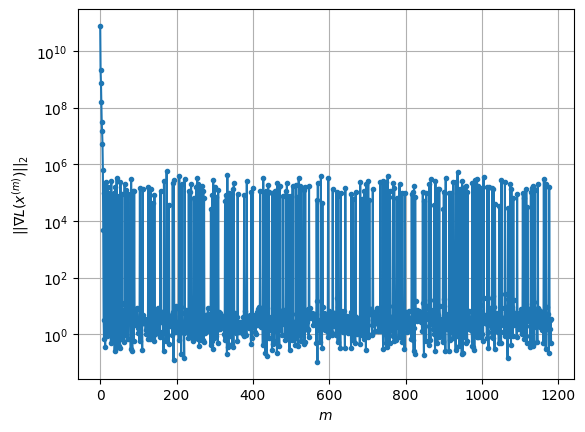

Windows:  61%|██████    | 181/296 [32:55<23:24, 12.21s/it]

Before applying the algorithm
Cost function: -23635216.49082923
Gradient norm: 45479.57225110364
Global relative error: 0.6430545366259648
Position relative errors: 0.03229319365874988 m, 0.3524453140697374 m, 0.3033908253393931 m, 0.44294382903179635 m

Iteration 1
Cost function: -23635216.766123816 (-0.00%)
Gradient norm: 7.7215847589119395 (-99.98%)
Global relative error: 0.8355365492899618 (29.93%)
Position relative errors: 0.03409143117455102 m, 0.6434514354199248 m, 0.3533544969834748 m, 0.397564188726413 m

Iteration 2
Cost function: -23635216.766124606 (-0.00%)
Gradient norm: 2.1533164070855473 (-72.11%)
Global relative error: 0.8355430625910515 (0.00%)
Position relative errors: 0.034091431636320405 m, 0.6434430221267808 m, 0.3533524214965309 m, 0.39759333780265915 m

STOP on Iteration 3
Cost function = -23635216.766124245 (0.00%)
Gradient norm = 0.13081931554563062 (-93.92%)
Global relative error = 0.8355430478936604 (-0.00%)
Final position relative errors: 0.0340914329617244 

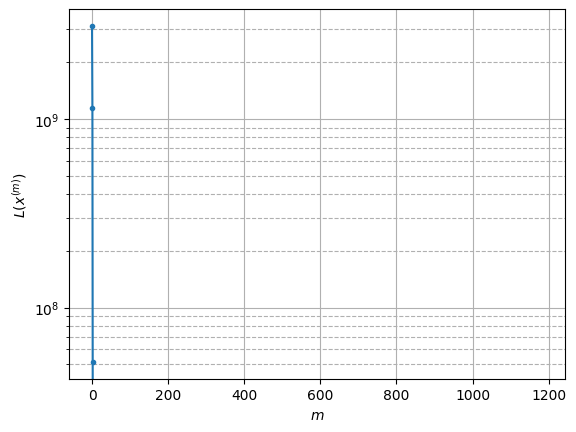

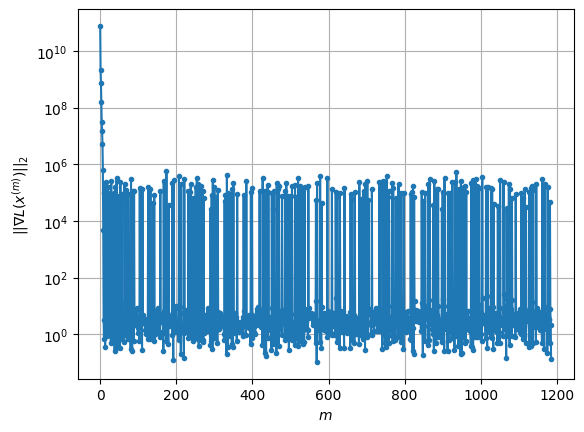

Windows:  61%|██████▏   | 182/296 [33:01<20:11, 10.63s/it]

Before applying the algorithm
Cost function: -23635216.042996515
Gradient norm: 33885.55671090815
Global relative error: 0.8724781921733982
Position relative errors: 0.034903214799856724 m, 0.7508653505510188 m, 0.3305951068279577 m, 0.29478040263986055 m

Iteration 1
Cost function: -23635216.27717322 (-0.00%)
Gradient norm: 3.6133246787206605 (-99.99%)
Global relative error: 0.7753922806279057 (-11.13%)
Position relative errors: 0.03967072188357988 m, 0.6867721035607561 m, 0.27685922671152347 m, 0.22658313185510426 m

Iteration 2
Cost function: -23635216.27717328 (-0.00%)
Gradient norm: 1.8460488945198705 (-48.91%)
Global relative error: 0.775399622506538 (0.00%)
Position relative errors: 0.03967072264958607 m, 0.6867807767515878 m, 0.27685893287920904 m, 0.226582327091447 m

Iteration 3
Cost function: -23635216.277173765 (-0.00%)
Gradient norm: 2.452722669135198 (32.86%)
Global relative error: 0.7753996165107963 (-0.00%)
Position relative errors: 0.039670723247484815 m, 0.68678077288

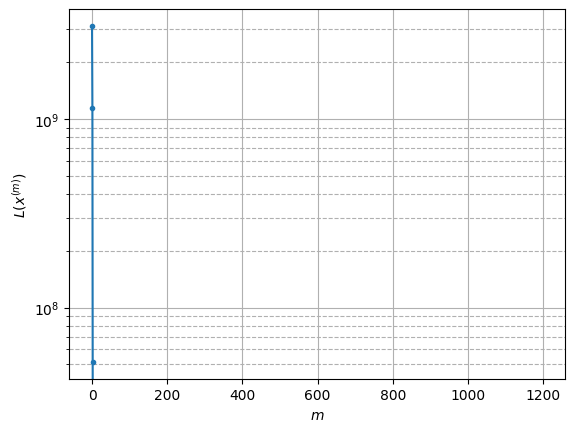

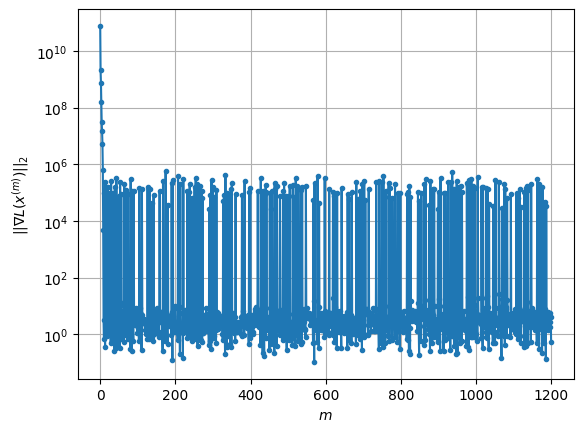

Windows:  62%|██████▏   | 183/296 [33:24<26:41, 14.17s/it]

Before applying the algorithm
Cost function: -23635223.92382127
Gradient norm: 97923.62029878203
Global relative error: 0.8858579747746658
Position relative errors: 0.04037111571890041 m, 0.7934206611080533 m, 0.2588328781086326 m, 0.2942641643707588 m

Iteration 1
Cost function: -23635224.245059412 (-0.00%)
Gradient norm: 6.883347929380525 (-99.99%)
Global relative error: 0.7078021812293108 (-20.10%)
Position relative errors: 0.04814756216207866 m, 0.6089437888051887 m, 0.24076795145484506 m, 0.26433149821298213 m

Iteration 2
Cost function: -23635224.245059583 (-0.00%)
Gradient norm: 5.198827871205344 (-24.47%)
Global relative error: 0.7078157221132361 (0.00%)
Position relative errors: 0.048147555482710186 m, 0.608957873641102 m, 0.24076749671643066 m, 0.26433572515332 m

Iteration 3
Cost function: -23635224.245058987 (0.00%)
Gradient norm: 4.373236446017372 (-15.88%)
Global relative error: 0.7078157132539072 (-0.00%)
Position relative errors: 0.04814756107922109 m, 0.608957859415290

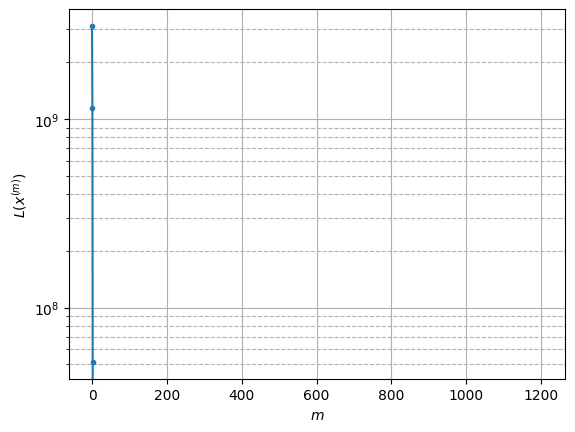

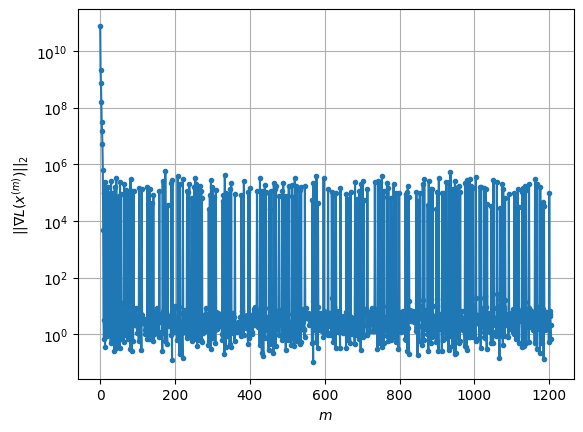

Windows:  62%|██████▏   | 184/296 [33:34<24:08, 12.93s/it]

Before applying the algorithm
Cost function: -23635225.395536296
Gradient norm: 276488.86355190404
Global relative error: 0.8485089693752493
Position relative errors: 0.04841900783583602 m, 0.7223572091871345 m, 0.22790391038750737 m, 0.3793024686517385 m

Iteration 1
Cost function: -23635225.894189596 (-0.00%)
Gradient norm: 5.410681628254024 (-100.00%)
Global relative error: 1.1309073409443433 (33.28%)
Position relative errors: 0.059385966338382876 m, 0.9900112650336303 m, 0.3090234523119332 m, 0.44698197051226407 m

Iteration 2
Cost function: -23635225.894189 (0.00%)
Gradient norm: 2.097984787949882 (-61.23%)
Global relative error: 1.1308707194574057 (-0.00%)
Position relative errors: 0.05938596960762059 m, 0.9899826116251531 m, 0.3090229908145487 m, 0.4469530969449112 m

Iteration 3
Cost function: -23635225.89418859 (0.00%)
Gradient norm: 1.3581799250006208 (-35.26%)
Global relative error: 1.1308707047301243 (-0.00%)
Position relative errors: 0.059385966694253244 m, 0.9899825979149

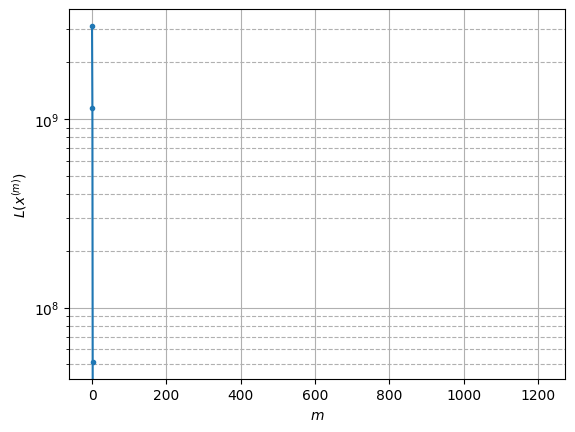

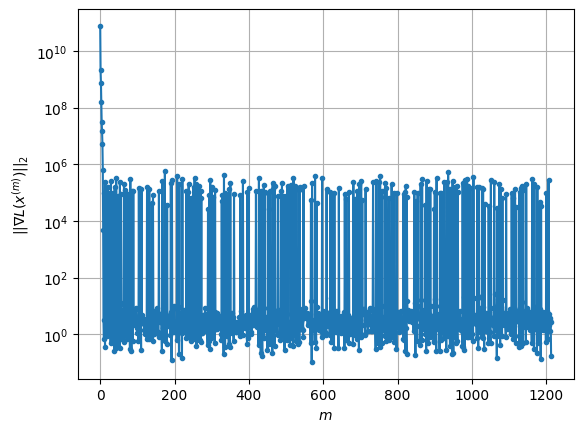

Windows:  62%|██████▎   | 185/296 [33:47<24:06, 13.03s/it]

Before applying the algorithm
Cost function: -23635231.819757815
Gradient norm: 89159.78744933898
Global relative error: 1.2978511110793132
Position relative errors: 0.05953438799312402 m, 1.1076386821372046 m, 0.2930651232623773 m, 0.6067198841055605 m

Iteration 1
Cost function: -23635232.5938267 (-0.00%)
Gradient norm: 10.268259830961227 (-99.99%)
Global relative error: 1.5656080564708366 (20.63%)
Position relative errors: 0.0586157887259707 m, 1.4133309826827727 m, 0.34222290931789245 m, 0.5771112951033109 m

Iteration 2
Cost function: -23635232.59382707 (-0.00%)
Gradient norm: 2.915712265545917 (-71.60%)
Global relative error: 1.5655982790164618 (-0.00%)
Position relative errors: 0.05861578449737846 m, 1.413329412740878 m, 0.3422215167838045 m, 0.5770894413967171 m

Iteration 3
Cost function: -23635232.59382614 (0.00%)
Gradient norm: 1.7875533122978045 (-38.69%)
Global relative error: 1.5655982801394828 (0.00%)
Position relative errors: 0.05861578735777909 m, 1.4133294153178473 m,

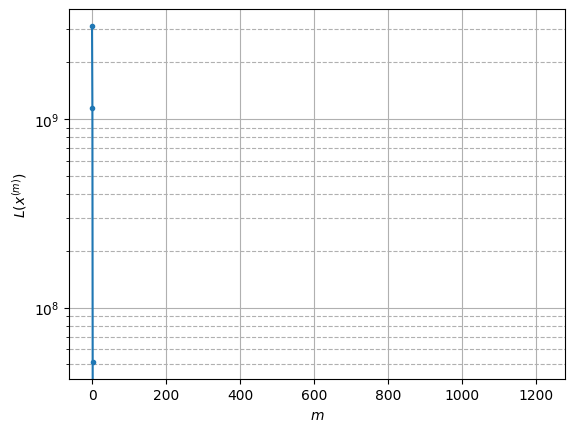

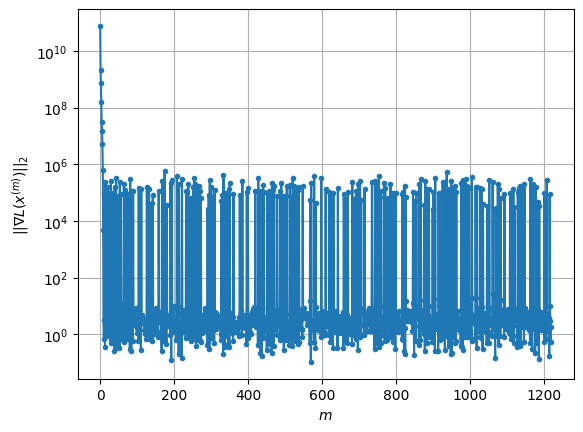

Windows:  63%|██████▎   | 186/296 [33:55<21:12, 11.56s/it]

Before applying the algorithm
Cost function: -23635234.66006789
Gradient norm: 23500.771173372028
Global relative error: 1.73556749048264
Position relative errors: 0.05855175479455609 m, 1.5273115036544396 m, 0.33133720721118304 m, 0.7525209545921365 m

Iteration 1
Cost function: -23635234.86945372 (-0.00%)
Gradient norm: 6.826243787578059 (-99.97%)
Global relative error: 1.451879901745199 (-16.35%)
Position relative errors: 0.052704069088682276 m, 1.334882581751528 m, 0.258008370118347 m, 0.5066402549676013 m

STOP on Iteration 2
Cost function = -23635234.869454194 (-0.00%)
Gradient norm = 0.6369141801443087 (-90.67%)
Global relative error = 1.4518604861483253 (-0.00%)
Final position relative errors: 0.05270406873177971 m, 1.3348666426019027 m, 0.2580077104518449 m, 0.5066269476891739 m



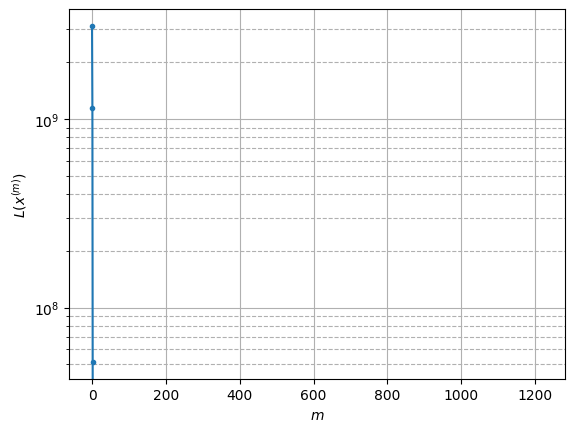

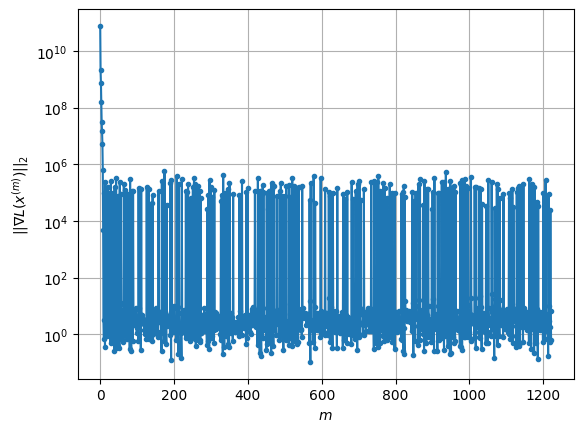

Windows:  63%|██████▎   | 187/296 [34:00<17:30,  9.64s/it]

Before applying the algorithm
Cost function: -23635243.227151934
Gradient norm: 85482.9905378194
Global relative error: 1.609775123382058
Position relative errors: 0.052682127095405484 m, 1.4388175904496139 m, 0.2533472082340591 m, 0.6739487507558505 m

Iteration 1
Cost function: -23635243.576298743 (-0.00%)
Gradient norm: 2.9704066501290964 (-100.00%)
Global relative error: 1.7989692287148662 (11.75%)
Position relative errors: 0.04499250092296717 m, 1.581726832023309 m, 0.34095692590830246 m, 0.7849478327723852 m

Iteration 2
Cost function: -23635243.576297358 (0.00%)
Gradient norm: 4.508472792163357 (51.78%)
Global relative error: 1.7989663498339175 (-0.00%)
Position relative errors: 0.04499250242254176 m, 1.5817240239369244 m, 0.34095618495860164 m, 0.7849472151354336 m

Iteration 3
Cost function: -23635243.576298866 (-0.00%)
Gradient norm: 3.28577273194021 (-27.12%)
Global relative error: 1.798966353309685 (0.00%)
Position relative errors: 0.044992495757370556 m, 1.5817240312481613

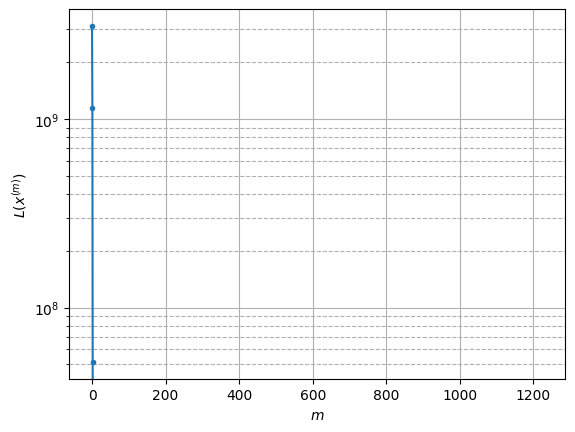

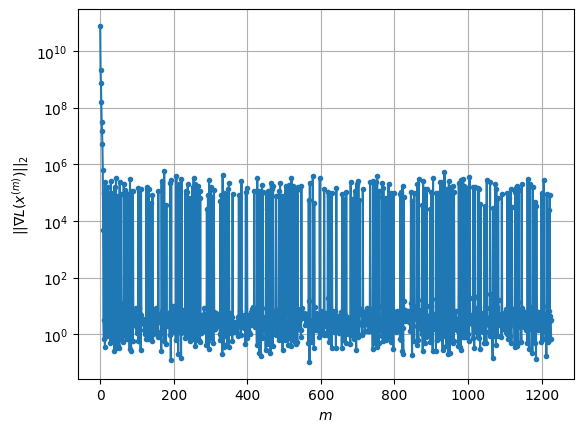

Windows:  64%|██████▎   | 188/296 [34:09<16:38,  9.24s/it]

Before applying the algorithm
Cost function: -23635244.06270934
Gradient norm: 210373.54653933903
Global relative error: 1.9543792818990655
Position relative errors: 0.045028902024270775 m, 1.6773047628167685 m, 0.3312878450517451 m, 0.9457574406185052 m

Iteration 1
Cost function: -23635244.51684567 (-0.00%)
Gradient norm: 4.588136249178887 (-100.00%)
Global relative error: 1.8356795491745461 (-6.07%)
Position relative errors: 0.043800022053314396 m, 1.5191218141830396 m, 0.23894398980605303 m, 1.0014811582394558 m

Iteration 2
Cost function: -23635244.516845513 (0.00%)
Gradient norm: 4.2400138143735395 (-7.59%)
Global relative error: 1.8356628793390282 (-0.00%)
Position relative errors: 0.043800024334865975 m, 1.519114836187603 m, 0.23894389449214384 m, 1.0014612103499876 m

Iteration 3
Cost function: -23635244.516845513 (0.00%)
Gradient norm: 1.3487667313924339 (-68.19%)
Global relative error: 1.8356628900499476 (0.00%)
Position relative errors: 0.04380002375890792 m, 1.519114846091

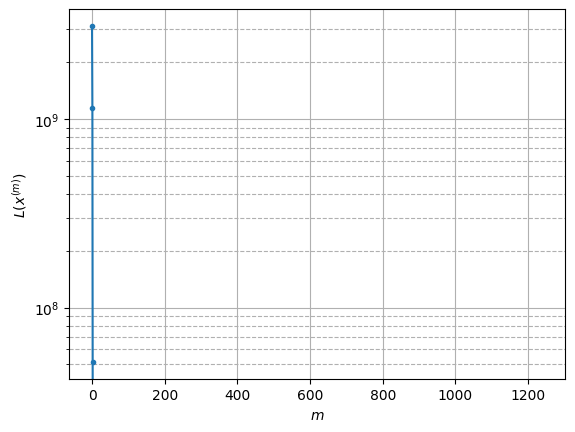

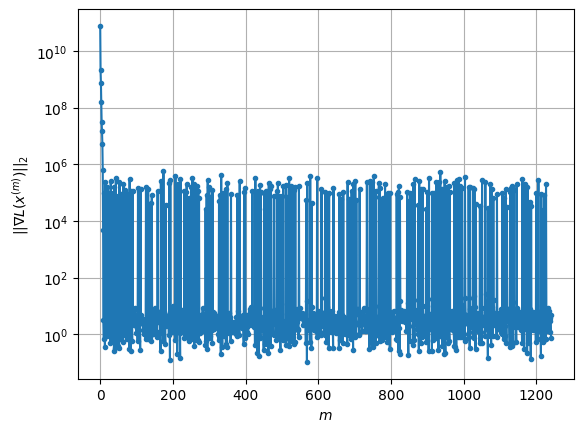

Windows:  64%|██████▍   | 189/296 [34:33<24:33, 13.77s/it]

Before applying the algorithm
Cost function: -23635237.283362698
Gradient norm: 91008.14960039308
Global relative error: 2.0048531260392917
Position relative errors: 0.043553967437363894 m, 1.6076200689721531 m, 0.2415615838368658 m, 1.1724907165177987 m

Iteration 1
Cost function: -23635237.817276597 (-0.00%)
Gradient norm: 7.847154200674475 (-99.99%)
Global relative error: 1.9628496507222546 (-2.10%)
Position relative errors: 0.04599875715361612 m, 1.3887266573281976 m, 0.24145604186137992 m, 1.365206699153145 m

STOP on Iteration 2
Cost function = -23635237.817276042 (0.00%)
Gradient norm = 0.44832140001144416 (-94.29%)
Global relative error = 1.9628285918277395 (-0.00%)
Final position relative errors: 0.04599876145966572 m, 1.3887129102715938 m, 0.24145586475775474 m, 1.365190436528598 m



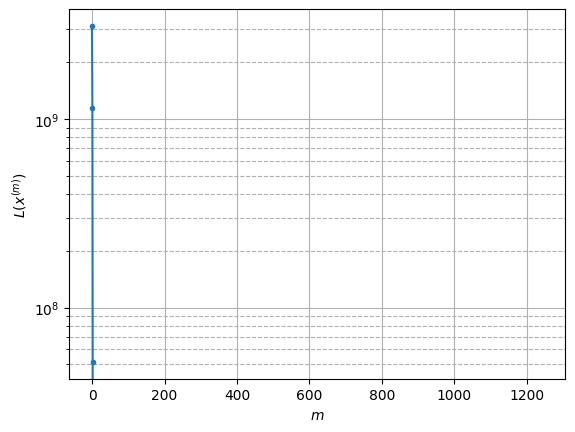

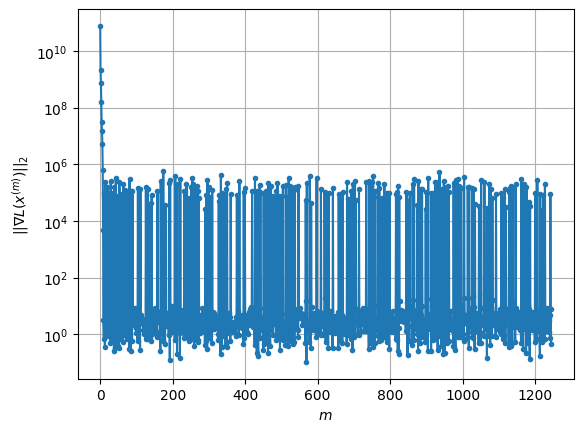

Windows:  64%|██████▍   | 190/296 [34:38<19:43, 11.16s/it]

Before applying the algorithm
Cost function: -23635231.349248085
Gradient norm: 128222.2842998646
Global relative error: 2.141749756968025
Position relative errors: 0.04571684179934393 m, 1.4707715980277447 m, 0.24611757276369212 m, 1.5366356601232487 m

Iteration 1
Cost function: -23635231.605297893 (-0.00%)
Gradient norm: 6.314663519202002 (-100.00%)
Global relative error: 2.4424158799478244 (14.04%)
Position relative errors: 0.04483006378843425 m, 1.5703435943733006 m, 0.2784935885578588 m, 1.8492804932143638 m

Iteration 2
Cost function: -23635231.60529714 (0.00%)
Gradient norm: 1.8064759180370915 (-71.39%)
Global relative error: 2.4424165247858567 (0.00%)
Position relative errors: 0.044830068419445326 m, 1.5703409233613237 m, 0.27849373951402323 m, 1.8492835901646871 m

Iteration 3
Cost function: -23635231.60529816 (-0.00%)
Gradient norm: 6.141208392934222 (239.96%)
Global relative error: 2.4424165251943712 (0.00%)
Position relative errors: 0.04483006185799692 m, 1.570340916874991

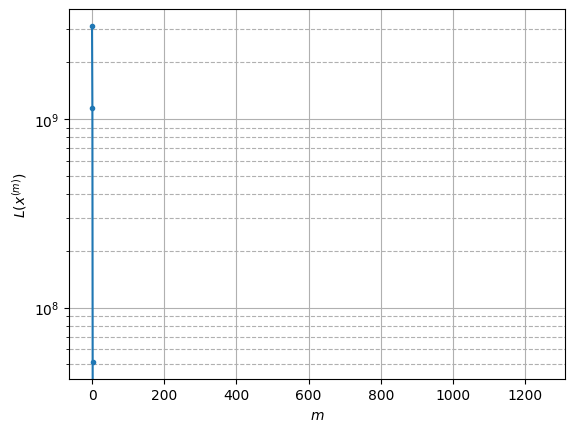

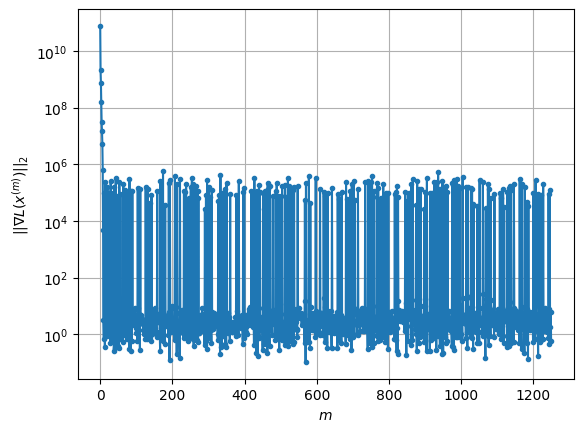

Windows:  65%|██████▍   | 191/296 [34:47<18:04, 10.33s/it]

Before applying the algorithm
Cost function: -23635229.994432084
Gradient norm: 72239.99501390425
Global relative error: 2.6119301646162243
Position relative errors: 0.044612980308294976 m, 1.641455803582791 m, 0.2808833721889892 m, 2.011692750788349 m

Iteration 1
Cost function: -23635230.463195343 (-0.00%)
Gradient norm: 4.996436975412279 (-99.99%)
Global relative error: 2.9260613529838104 (12.03%)
Position relative errors: 0.043390379134271316 m, 1.815429409935832 m, 0.2563665485361808 m, 2.2800076692713964 m

Iteration 2
Cost function: -23635230.463195562 (-0.00%)
Gradient norm: 2.7829499247854317 (-44.30%)
Global relative error: 2.9260202160624704 (-0.00%)
Position relative errors: 0.043390376588944166 m, 1.8153937642326003 m, 0.2563649187585954 m, 2.279983441745631 m

Iteration 3
Cost function: -23635230.463195454 (0.00%)
Gradient norm: 4.480069554788954 (60.98%)
Global relative error: 2.9260202254296064 (0.00%)
Position relative errors: 0.04339037899627283 m, 1.8153937709950838 

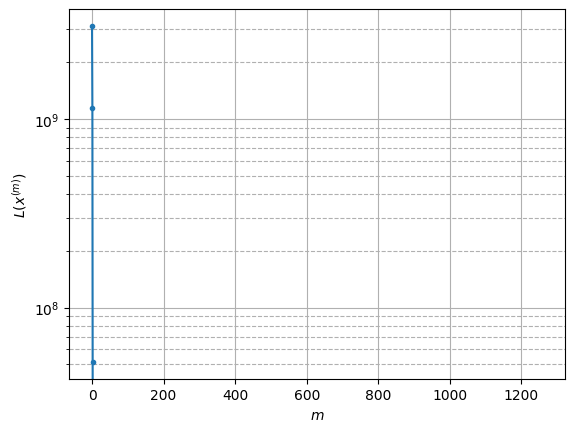

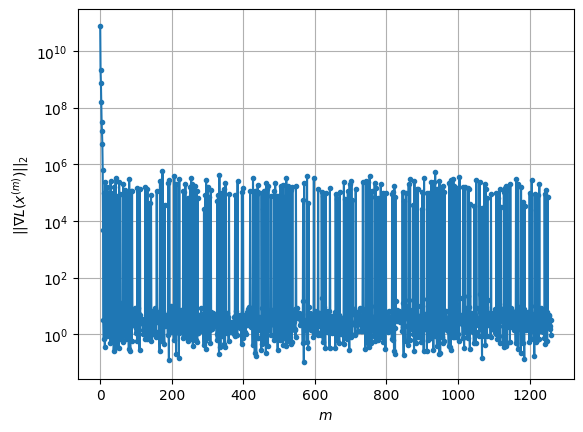

Windows:  65%|██████▍   | 192/296 [35:04<21:35, 12.46s/it]

Before applying the algorithm
Cost function: -23635235.894451153
Gradient norm: 258428.51974860032
Global relative error: 3.098646295464476
Position relative errors: 0.0428633833694707 m, 1.8904151931207887 m, 0.26333549128288236 m, 2.440645013884164 m

Iteration 1
Cost function: -23635236.439678714 (-0.00%)
Gradient norm: 6.519395618127571 (-100.00%)
Global relative error: 3.3114929970514715 (6.87%)
Position relative errors: 0.05592807953394292 m, 2.103676513390864 m, 0.3898600178328715 m, 2.5269356738009914 m

Iteration 2
Cost function: -23635236.43967825 (0.00%)
Gradient norm: 6.111292660378777 (-6.26%)
Global relative error: 3.3114914671639673 (-0.00%)
Position relative errors: 0.05592808804065864 m, 2.103671349119462 m, 0.38985755549355877 m, 2.52693834787504 m

Iteration 3
Cost function: -23635236.43967907 (-0.00%)
Gradient norm: 2.1751172256255322 (-64.41%)
Global relative error: 3.311491475498011 (0.00%)
Position relative errors: 0.05592808360101209 m, 2.103671357252316 m, 0.38

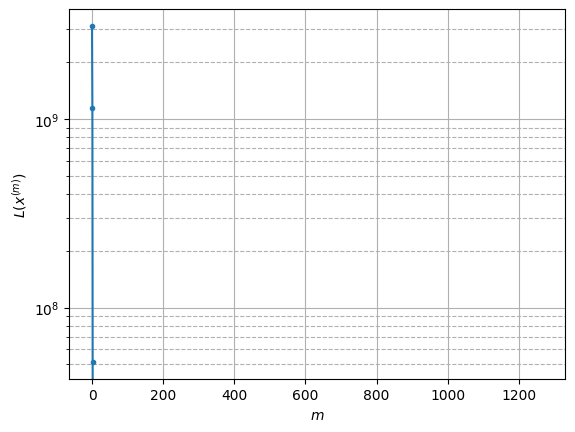

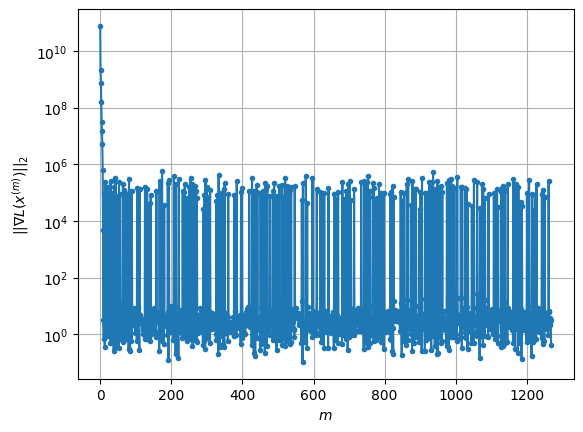

Windows:  65%|██████▌   | 193/296 [35:17<21:41, 12.64s/it]

Before applying the algorithm
Cost function: -23635234.05935322
Gradient norm: 324064.95289095613
Global relative error: 3.4670392960244047
Position relative errors: 0.055088691033994074 m, 2.1697258278964338 m, 0.3781171405425857 m, 2.6770575189457513 m

Iteration 1
Cost function: -23635234.436756846 (-0.00%)
Gradient norm: 5.896532616875806 (-100.00%)
Global relative error: 3.7559275032874586 (8.33%)
Position relative errors: 0.053195110167144864 m, 2.215556641212311 m, 0.4358223660826515 m, 3.000920153347199 m

Iteration 2
Cost function: -23635234.436757155 (-0.00%)
Gradient norm: 1.3718067636759972 (-76.74%)
Global relative error: 3.7559252078182785 (-0.00%)
Position relative errors: 0.053195114876921336 m, 2.215545486378908 m, 0.43582210049266795 m, 3.0009255543577216 m

STOP on Iteration 3
Cost function = -23635234.436756868 (0.00%)
Gradient norm = 0.19543950537466812 (-85.75%)
Global relative error = 3.7559251596243537 (-0.00%)
Final position relative errors: 0.05319511815286967

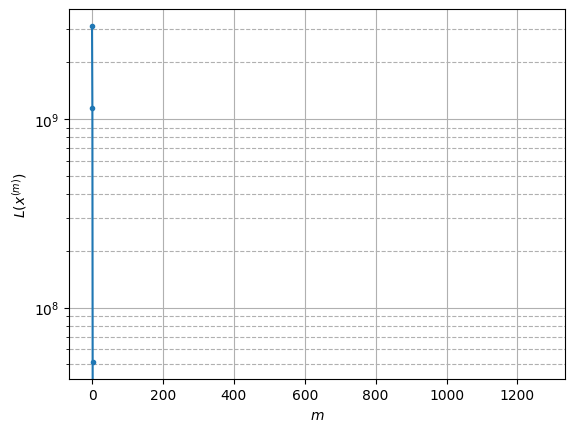

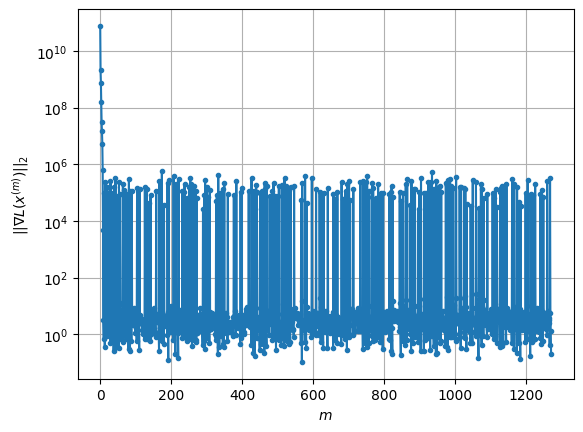

Windows:  66%|██████▌   | 194/296 [35:24<18:26, 10.84s/it]

Before applying the algorithm
Cost function: -23635238.4508071
Gradient norm: 340761.4169777339
Global relative error: 3.9007700596519723
Position relative errors: 0.05223594327542736 m, 2.266066023751598 m, 0.42098500538139305 m, 3.14658365214201 m

Iteration 1
Cost function: -23635238.70817677 (-0.00%)
Gradient norm: 6.499315578159184 (-100.00%)
Global relative error: 3.89217420132771 (-0.22%)
Position relative errors: 0.041404482244714116 m, 2.2312633253760836 m, 0.41395574225812154 m, 3.161867082262681 m

Iteration 2
Cost function: -23635238.70817695 (-0.00%)
Gradient norm: 3.332830525080368 (-48.72%)
Global relative error: 3.892169655012209 (-0.00%)
Position relative errors: 0.04140448399060538 m, 2.231260943358131 m, 0.4139556557077415 m, 3.1618631781195954 m

Iteration 3
Cost function: -23635238.70817678 (0.00%)
Gradient norm: 1.6965887448336359 (-49.09%)
Global relative error: 3.8921696796861354 (0.00%)
Position relative errors: 0.041404482374855764 m, 2.231260952345933 m, 0.41

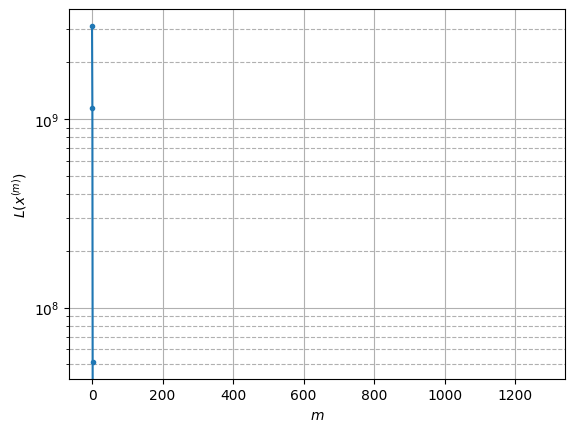

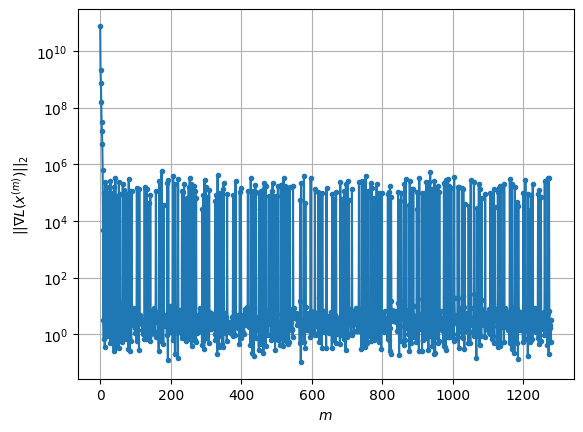

Windows:  66%|██████▌   | 195/296 [35:35<18:36, 11.05s/it]

Before applying the algorithm
Cost function: -23635242.670070935
Gradient norm: 97655.0948530584
Global relative error: 4.0272064512163
Position relative errors: 0.04051327947764055 m, 2.2703454784368624 m, 0.39877245024575675 m, 3.302008008497513 m

Iteration 1
Cost function: -23635242.91530649 (-0.00%)
Gradient norm: 7.88223987091295 (-99.99%)
Global relative error: 4.104819527461436 (1.93%)
Position relative errors: 0.04101846733616956 m, 2.250071007864339 m, 0.35575686840803694 m, 3.4144506541529416 m

Iteration 2
Cost function: -23635242.915306542 (-0.00%)
Gradient norm: 4.574269796520229 (-41.97%)
Global relative error: 4.1048145170879895 (-0.00%)
Position relative errors: 0.0410184732860797 m, 2.25005821570875 m, 0.3557559422200339 m, 3.4144531569721037 m

Iteration 3
Cost function: -23635242.915306572 (-0.00%)
Gradient norm: 1.997988242864294 (-56.32%)
Global relative error: 4.1048145014996775 (-0.00%)
Position relative errors: 0.04101846845171241 m, 2.2500581937514785 m, 0.355

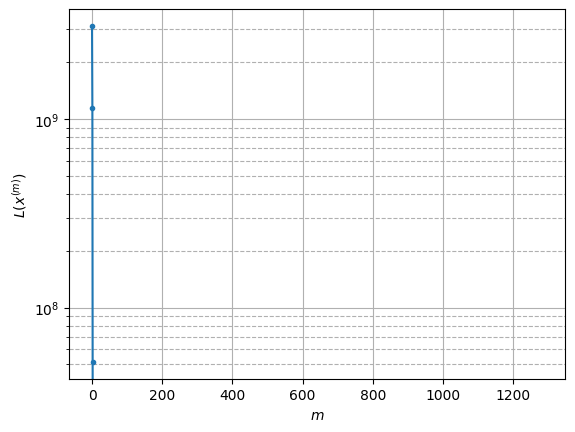

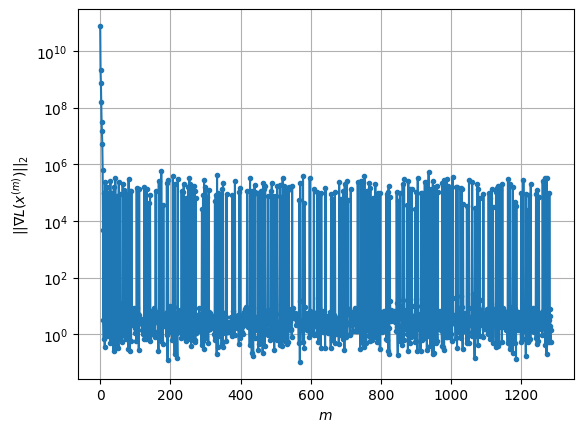

Windows:  66%|██████▌   | 196/296 [35:45<17:54, 10.75s/it]

Before applying the algorithm
Cost function: -23635242.47055797
Gradient norm: 78803.4366762378
Global relative error: 4.2175139748124115
Position relative errors: 0.04038981667770822 m, 2.274239621906447 m, 0.34916093178563773 m, 3.534361279752471 m

Iteration 1
Cost function: -23635242.590439815 (-0.00%)
Gradient norm: 2.0707030950774303 (-100.00%)
Global relative error: 4.111451828543235 (-2.51%)
Position relative errors: 0.04917295060652006 m, 2.1615317201861357 m, 0.3461483606527322 m, 3.4798816122797813 m

STOP on Iteration 2
Cost function = -23635242.59043955 (0.00%)
Gradient norm = 0.6873868397464505 (-66.80%)
Global relative error = 4.111455193750667 (0.00%)
Final position relative errors: 0.04917295138003657 m, 2.161533095985286 m, 0.3461484511272977 m, 3.4798847246557574 m



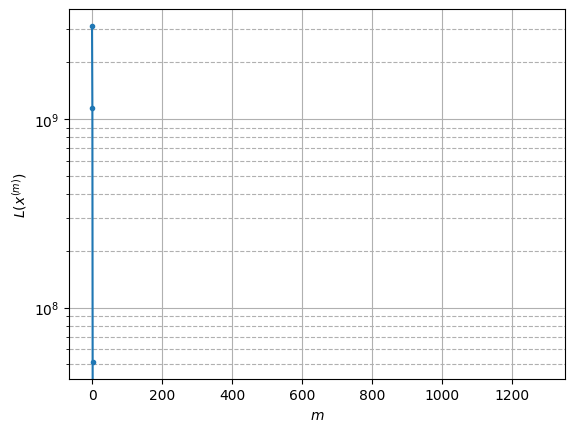

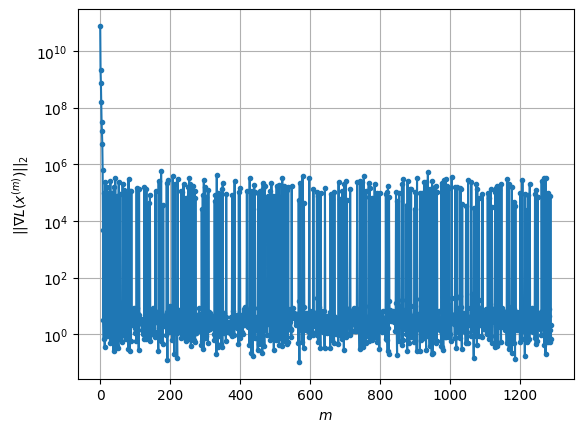

Windows:  67%|██████▋   | 197/296 [35:51<14:59,  9.08s/it]

Before applying the algorithm
Cost function: -23635239.881195847
Gradient norm: 225684.58746092353
Global relative error: 4.209872160518688
Position relative errors: 0.04816048880342593 m, 2.1773755776403125 m, 0.34144178774469514 m, 3.586523975545731 m

Iteration 1
Cost function: -23635240.536240116 (-0.00%)
Gradient norm: 13.888798961391613 (-99.99%)
Global relative error: 3.897968047463496 (-7.41%)
Position relative errors: 0.052688291481492594 m, 2.136960258390744 m, 0.3134713853834944 m, 3.244458521486358 m

STOP on Iteration 2
Cost function = -23635240.536240213 (-0.00%)
Gradient norm = 0.35844217638038806 (-97.42%)
Global relative error = 3.8980446368094475 (0.00%)
Final position relative errors: 0.05268829377962453 m, 2.136971743559627 m, 0.3134743247956396 m, 3.2445426887521513 m



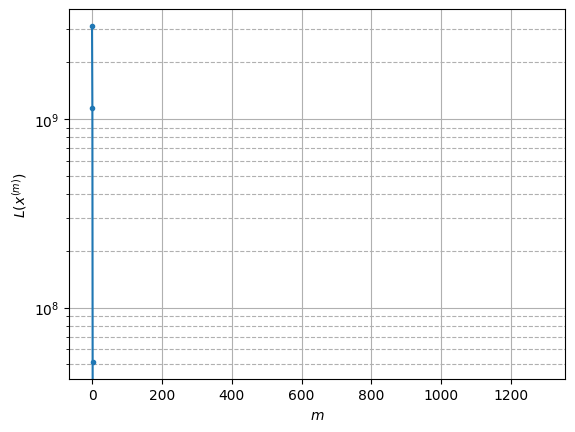

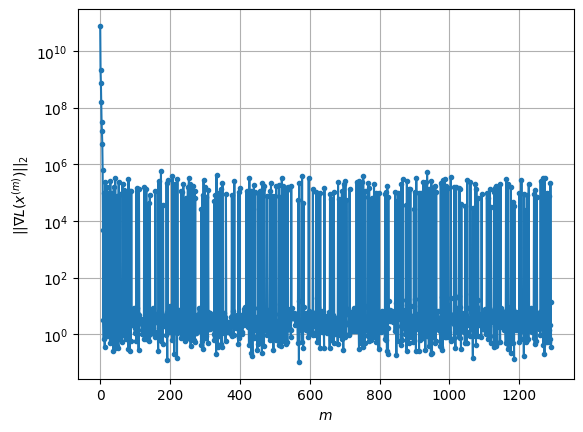

Windows:  67%|██████▋   | 198/296 [35:56<12:57,  7.94s/it]

Before applying the algorithm
Cost function: -23635227.748167098
Gradient norm: 166020.3704652592
Global relative error: 3.9965228456758917
Position relative errors: 0.05135900483616412 m, 2.1451627384175533 m, 0.3290892752699729 m, 3.355522439276044 m

Iteration 1
Cost function: -23635228.506681025 (-0.00%)
Gradient norm: 11.342872546373538 (-99.99%)
Global relative error: 3.7106629275820353 (-7.15%)
Position relative errors: 0.05611740306392595 m, 2.0133306256640533 m, 0.48428106054555636 m, 3.078610024984222 m

Iteration 2
Cost function: -23635228.50668089 (0.00%)
Gradient norm: 3.1246883790231523 (-72.45%)
Global relative error: 3.7106167554069454 (-0.00%)
Position relative errors: 0.056117403543823496 m, 2.0132873257973904 m, 0.48426509604768103 m, 3.078585201623255 m

Iteration 3
Cost function: -23635228.506680943 (-0.00%)
Gradient norm: 2.5468833905877815 (-18.49%)
Global relative error: 3.7106167381137283 (-0.00%)
Position relative errors: 0.05611739876221384 m, 2.0132873160286

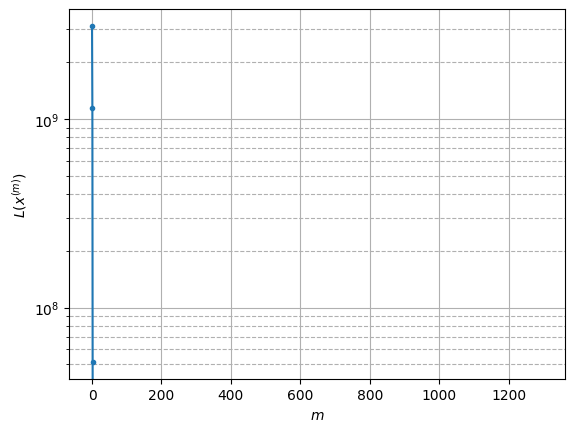

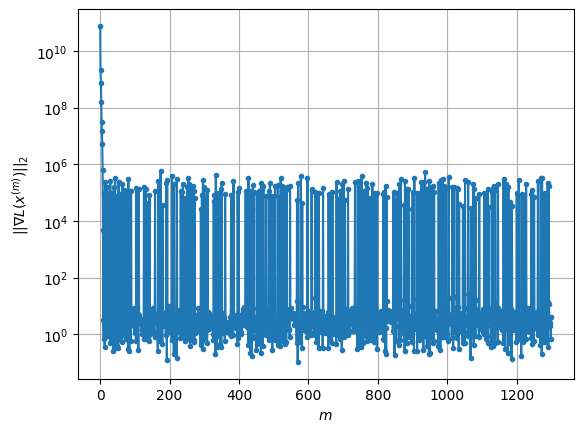

Windows:  67%|██████▋   | 199/296 [36:09<15:17,  9.46s/it]

Before applying the algorithm
Cost function: -23635228.084665254
Gradient norm: 92369.11645280458
Global relative error: 3.767093630679327
Position relative errors: 0.05443330395405999 m, 1.9972757996037978 m, 0.5133230720788312 m, 3.152049902970127 m

Iteration 1
Cost function: -23635228.41488131 (-0.00%)
Gradient norm: 7.040626199911657 (-99.99%)
Global relative error: 3.4063364094690067 (-9.58%)
Position relative errors: 0.060901125679395436 m, 1.6497402119919224 m, 0.4816196009228331 m, 2.940377067297082 m

Iteration 2
Cost function: -23635228.414881427 (-0.00%)
Gradient norm: 2.0943418603315163 (-70.25%)
Global relative error: 3.4063600567129515 (0.00%)
Position relative errors: 0.060901126180622815 m, 1.6497531219096426 m, 0.4816120061313341 m, 2.9403984625688104 m

Iteration 3
Cost function: -23635228.41488111 (0.00%)
Gradient norm: 1.6248461447133464 (-22.42%)
Global relative error: 3.4063600992499383 (0.00%)
Position relative errors: 0.06090112595530884 m, 1.649753134211328 m,

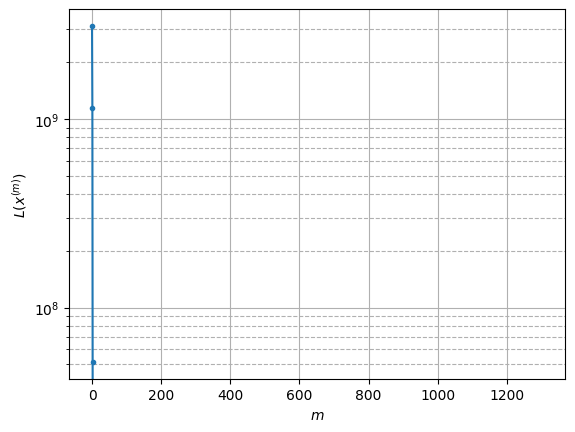

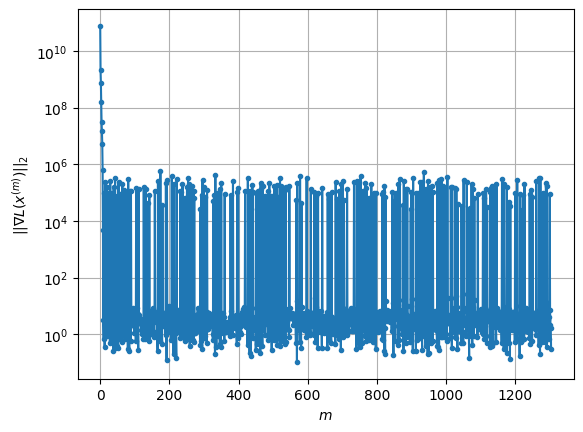

Windows:  68%|██████▊   | 200/296 [36:17<14:31,  9.08s/it]

Before applying the algorithm
Cost function: -23635228.84245371
Gradient norm: 102327.29366777369
Global relative error: 3.448390252404343
Position relative errors: 0.058911451267878674 m, 1.6332014766665786 m, 0.5061482991576629 m, 2.9940592300835798 m

Iteration 1
Cost function: -23635229.371634535 (-0.00%)
Gradient norm: 6.54671612539667 (-99.99%)
Global relative error: 3.6822774253394397 (6.78%)
Position relative errors: 0.06549877979472378 m, 1.654905983614957 m, 0.45910057868912535 m, 3.256591490640648 m

STOP on Iteration 2
Cost function = -23635229.37163498 (-0.00%)
Gradient norm = 0.958802823790532 (-85.35%)
Global relative error = 3.6822702585961586 (-0.00%)
Final position relative errors: 0.0654987808983249 m, 1.6548913797979956 m, 0.4590946925501492 m, 3.2565916380844326 m



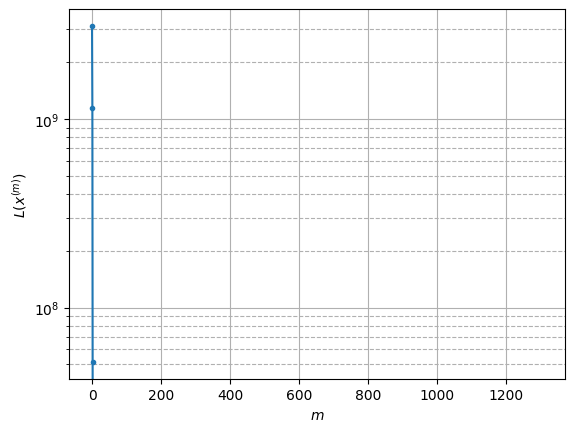

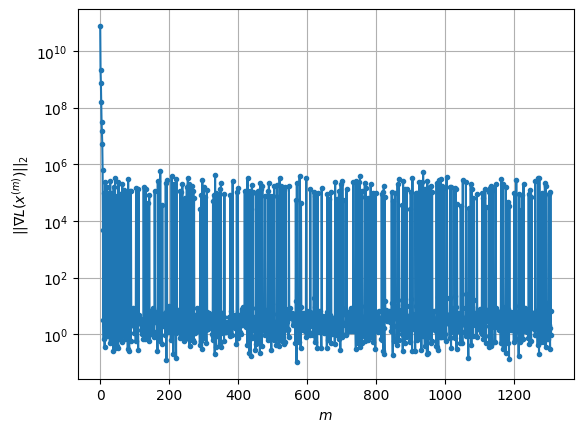

Windows:  68%|██████▊   | 201/296 [36:22<12:29,  7.89s/it]

Before applying the algorithm
Cost function: -23635234.40388546
Gradient norm: 105227.59960663349
Global relative error: 3.7293954936757294
Position relative errors: 0.0635499615529234 m, 1.6357405107333611 m, 0.48406542494889626 m, 3.315778122952315 m

Iteration 1
Cost function: -23635234.83685197 (-0.00%)
Gradient norm: 9.563125779431322 (-99.99%)
Global relative error: 3.4627162253421555 (-7.15%)
Position relative errors: 0.06415129774488983 m, 1.3976718714455674 m, 0.6076484366430068 m, 3.108627401559052 m

STOP on Iteration 2
Cost function = -23635234.83685178 (0.00%)
Gradient norm = 0.8603290200482416 (-91.00%)
Global relative error = 3.462730141356151 (0.00%)
Final position relative errors: 0.0641512965356491 m, 1.3976993218050853 m, 0.6076338314276892 m, 3.1086334155038475 m



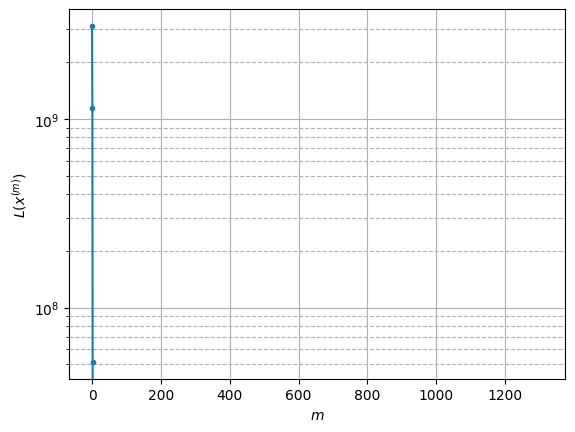

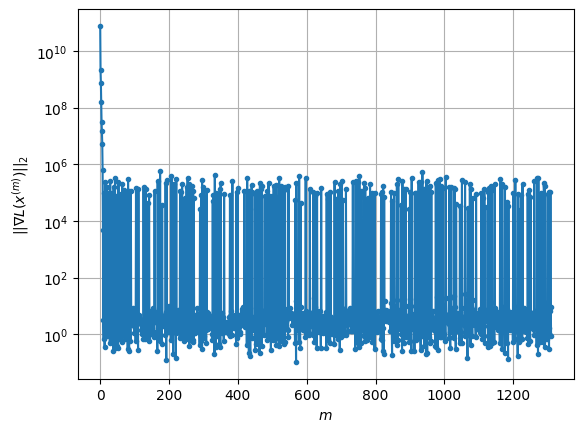

Windows:  68%|██████▊   | 202/296 [36:27<11:09,  7.12s/it]

Before applying the algorithm
Cost function: -23635237.973052643
Gradient norm: 443786.164667115
Global relative error: 3.4767349443225157
Position relative errors: 0.06222943225124864 m, 1.372792969360322 m, 0.6320865449902386 m, 3.1304502677494286 m

Iteration 1
Cost function: -23635238.36213247 (-0.00%)
Gradient norm: 4.494028072216028 (-100.00%)
Global relative error: 3.474671885612042 (-0.06%)
Position relative errors: 0.060904020517557916 m, 1.4912608961335272 m, 0.6758050064364928 m, 3.0641578299900645 m

STOP on Iteration 2
Cost function = -23635238.36213228 (0.00%)
Gradient norm = 0.6119286172449016 (-86.38%)
Global relative error = 3.4746768823329677 (0.00%)
Final position relative errors: 0.06090401764681058 m, 1.4912532045726485 m, 0.6758045205108437 m, 3.064167346663435 m



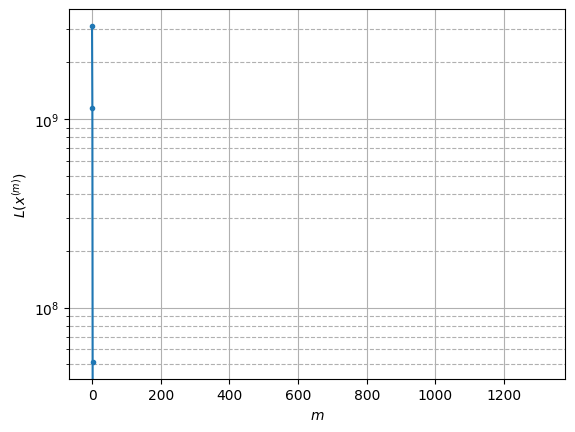

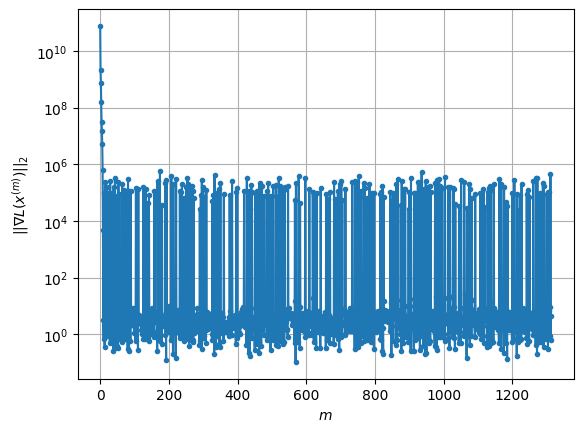

Windows:  69%|██████▊   | 203/296 [36:33<10:06,  6.52s/it]

Before applying the algorithm
Cost function: -23635244.017771207
Gradient norm: 161403.30544364516
Global relative error: 3.4798309587092318
Position relative errors: 0.05943509709752667 m, 1.4597486610327135 m, 0.6977912307415188 m, 3.0802453662859155 m

Iteration 1
Cost function: -23635244.57994911 (-0.00%)
Gradient norm: 4.378153992521266 (-100.00%)
Global relative error: 3.486339600335822 (0.19%)
Position relative errors: 0.04745032891381121 m, 1.4993891607900374 m, 0.7703868913419964 m, 3.051335370366546 m

Iteration 2
Cost function: -23635244.57994836 (0.00%)
Gradient norm: 1.5665586371841878 (-64.22%)
Global relative error: 3.4863242172129363 (-0.00%)
Position relative errors: 0.04745033856336146 m, 1.4993766823030372 m, 0.7703843715587487 m, 3.0513245619996447 m

STOP on Iteration 3
Cost function = -23635244.57994881 (-0.00%)
Gradient norm = 0.534113283860294 (-65.91%)
Global relative error = 3.486324212609474 (-0.00%)
Final position relative errors: 0.04745032884927644 m, 1.49

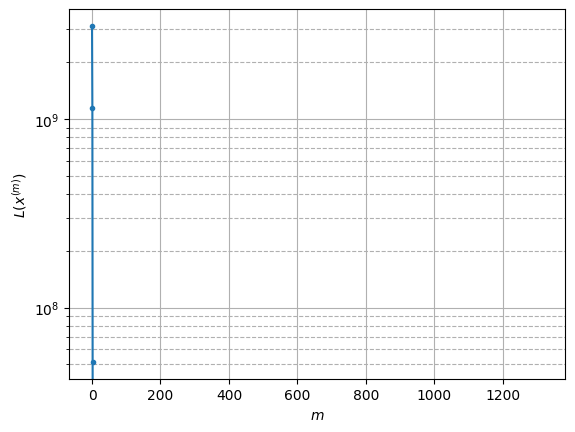

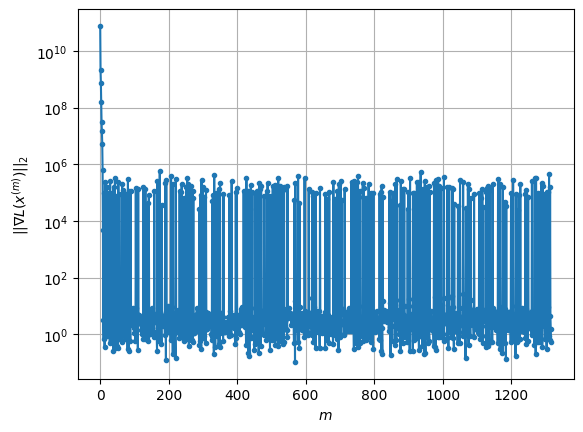

Windows:  69%|██████▉   | 204/296 [36:39<10:06,  6.59s/it]

Before applying the algorithm
Cost function: -23635250.223997705
Gradient norm: 103630.58962144265
Global relative error: 3.4532467652341827
Position relative errors: 0.04707417972969697 m, 1.4500900457265624 m, 0.7908028128949758 m, 3.03225424602813 m

Iteration 1
Cost function: -23635250.35970888 (-0.00%)
Gradient norm: 1.4983411131042916 (-100.00%)
Global relative error: 3.520618627711061 (1.95%)
Position relative errors: 0.04371120181633751 m, 1.4993009079175117 m, 0.8400220310916057 m, 3.0723449397878007 m

Iteration 2
Cost function: -23635250.359708883 (-0.00%)
Gradient norm: 1.0619142885863515 (-29.13%)
Global relative error: 3.520619907990491 (0.00%)
Position relative errors: 0.043711200981666 m, 1.4993019863401291 m, 0.8400214647357054 m, 3.072346035459678 m

Iteration 3
Cost function: -23635250.359708775 (0.00%)
Gradient norm: 2.879848976444701 (171.19%)
Global relative error: 3.5206199120765795 (0.00%)
Position relative errors: 0.0437112014901499 m, 1.4993019844420483 m, 0.8

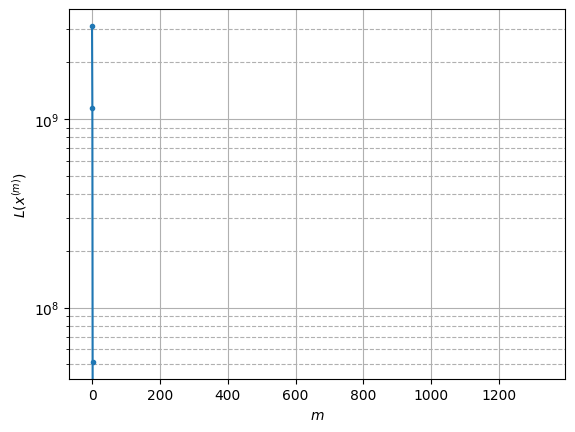

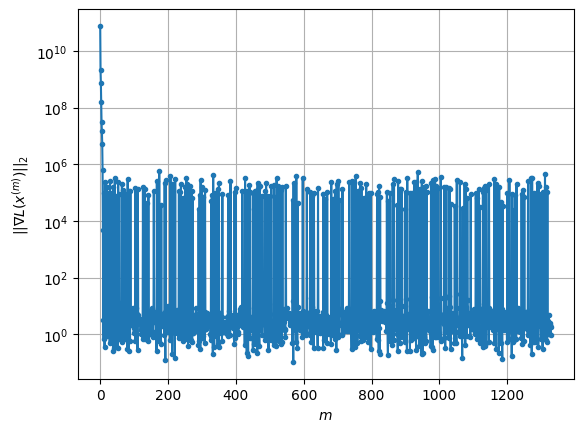

Windows:  69%|██████▉   | 205/296 [36:59<15:47, 10.41s/it]

Before applying the algorithm
Cost function: -23635256.201353777
Gradient norm: 287894.67647044885
Global relative error: 3.474358655672156
Position relative errors: 0.043203459698176676 m, 1.4437229951157617 m, 0.8563343781751975 m, 3.0416533795256013 m

Iteration 1
Cost function: -23635256.95102282 (-0.00%)
Gradient norm: 8.444505073911598 (-100.00%)
Global relative error: 3.237017798340135 (-6.83%)
Position relative errors: 0.03342206949962574 m, 1.3873503399942841 m, 0.7398815981389425 m, 2.829310804030533 m

Iteration 2
Cost function: -23635256.95102269 (0.00%)
Gradient norm: 3.6648617601259783 (-56.60%)
Global relative error: 3.237000632460261 (-0.00%)
Position relative errors: 0.03342207845685313 m, 1.387333664452226 m, 0.7398725255632451 m, 2.8293017137694068 m

Iteration 3
Cost function: -23635256.951022394 (0.00%)
Gradient norm: 3.1528897529263693 (-13.97%)
Global relative error: 3.2370006272416645 (-0.00%)
Position relative errors: 0.03342207510497185 m, 1.387333678894043 m,

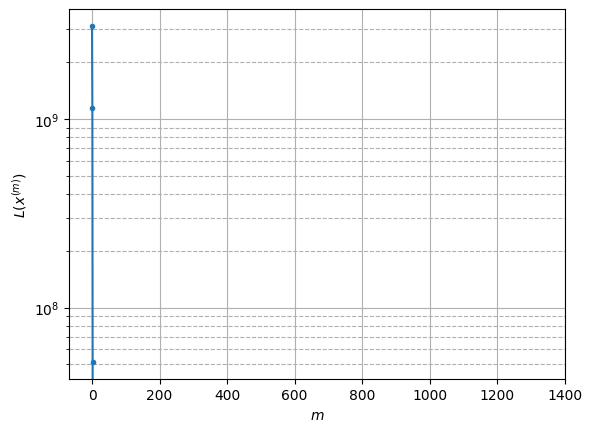

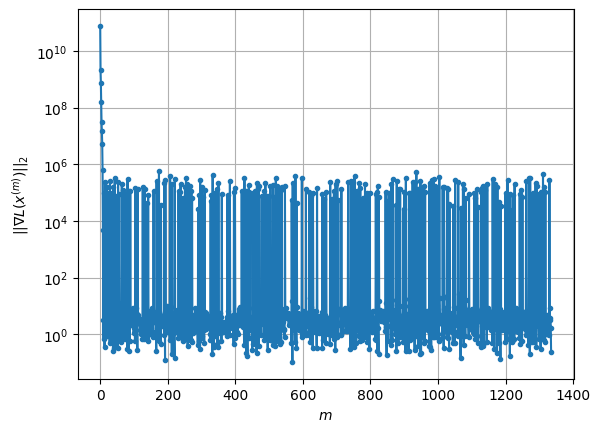

Windows:  70%|██████▉   | 206/296 [37:08<15:17, 10.19s/it]

Before applying the algorithm
Cost function: -23635269.34436032
Gradient norm: 69511.53410351824
Global relative error: 3.1819676027833617
Position relative errors: 0.03357731883161426 m, 1.3134726827118917 m, 0.7548111885309845 m, 2.7980060241307187 m

Iteration 1
Cost function: -23635270.12659605 (-0.00%)
Gradient norm: 9.40999836968809 (-99.99%)
Global relative error: 3.0794923146013216 (-3.22%)
Position relative errors: 0.02936756334146076 m, 1.2690526509697935 m, 0.8858479316342892 m, 2.662176721077985 m

Iteration 2
Cost function: -23635270.12659621 (-0.00%)
Gradient norm: 4.437127393590226 (-52.85%)
Global relative error: 3.0795116875310207 (0.00%)
Position relative errors: 0.0293675628780056 m, 1.2690500612019857 m, 0.8858867285709251 m, 2.662187455372102 m

Iteration 3
Cost function: -23635270.12659622 (-0.00%)
Gradient norm: 2.459927397924587 (-44.56%)
Global relative error: 3.079511655900183 (-0.00%)
Position relative errors: 0.02936756366644464 m, 1.2690500776342029 m, 0.88

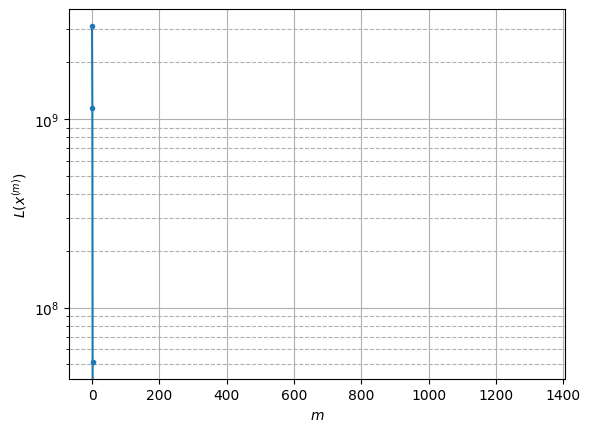

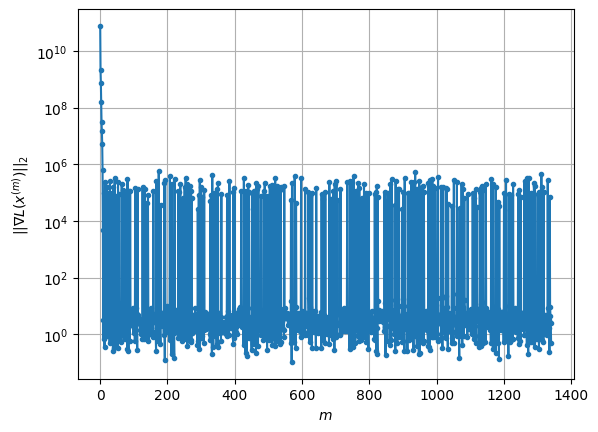

Windows:  70%|██████▉   | 207/296 [37:16<14:12,  9.58s/it]

Before applying the algorithm
Cost function: -23635273.68988088
Gradient norm: 87501.04962539863
Global relative error: 2.9801030499335157
Position relative errors: 0.02966756762314932 m, 1.1701544365624583 m, 0.9007950182611805 m, 2.5883268423238457 m

Iteration 1
Cost function: -23635274.258145254 (-0.00%)
Gradient norm: 7.991921135433204 (-99.99%)
Global relative error: 3.1086008929218667 (4.31%)
Position relative errors: 0.03596372902218219 m, 1.1494517799646018 m, 0.8654996810375749 m, 2.755317245446066 m

Iteration 2
Cost function: -23635274.25814528 (-0.00%)
Gradient norm: 1.9858975404989956 (-75.15%)
Global relative error: 3.108557920983059 (-0.00%)
Position relative errors: 0.03596372896757419 m, 1.1493949255976204 m, 0.8655008261655904 m, 2.755292121919034 m

STOP on Iteration 3
Cost function = -23635274.258145057 (0.00%)
Gradient norm = 0.917055563301465 (-53.82%)
Global relative error = 3.108557834718085 (-0.00%)
Final position relative errors: 0.03596372586433931 m, 1.1493

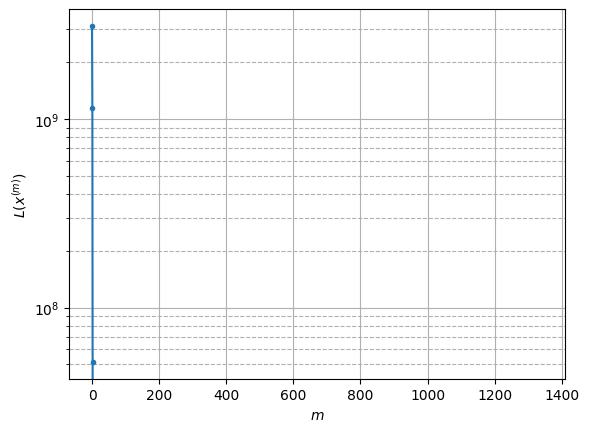

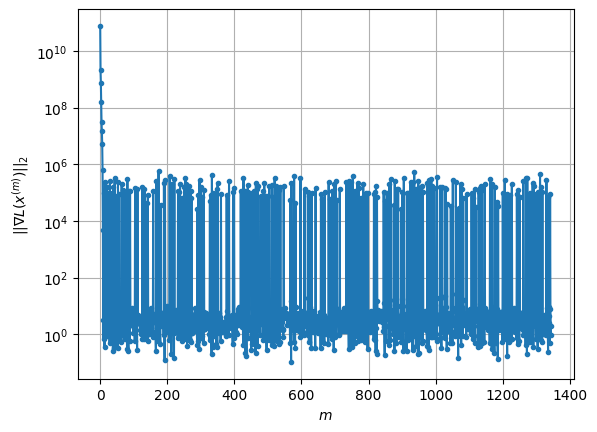

Windows:  70%|███████   | 208/296 [37:23<12:43,  8.67s/it]

Before applying the algorithm
Cost function: -23635275.11502146
Gradient norm: 34538.38610289895
Global relative error: 3.0057660503113013
Position relative errors: 0.035735273179813176 m, 1.0697337167873917 m, 0.8762770804951429 m, 2.668549441515976 m

Iteration 1
Cost function: -23635275.36230772 (-0.00%)
Gradient norm: 2.300395031975618 (-99.99%)
Global relative error: 2.8583126570804356 (-4.91%)
Position relative errors: 0.0423549352720912 m, 0.9688922238849489 m, 0.7006964527982127 m, 2.5958476835527615 m

Iteration 2
Cost function: -23635275.362307824 (-0.00%)
Gradient norm: 6.572289714123004 (185.70%)
Global relative error: 2.858282487043141 (-0.00%)
Position relative errors: 0.04235494017904351 m, 0.9688696500469073 m, 0.7006773990543514 m, 2.595828031687381 m

Iteration 3
Cost function: -23635275.36230763 (0.00%)
Gradient norm: 5.329453279889547 (-18.91%)
Global relative error: 2.858282506008411 (0.00%)
Position relative errors: 0.04235494340952375 m, 0.9688696388619763 m, 0.7

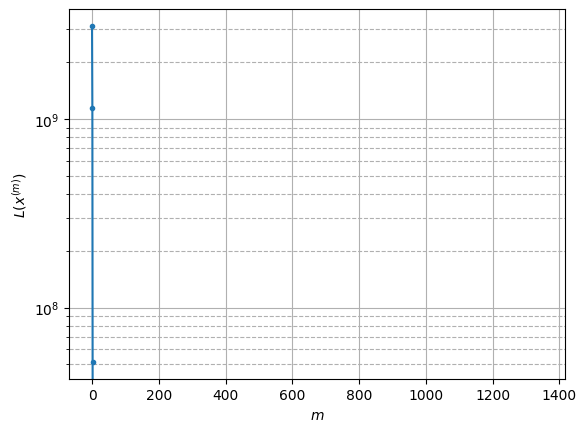

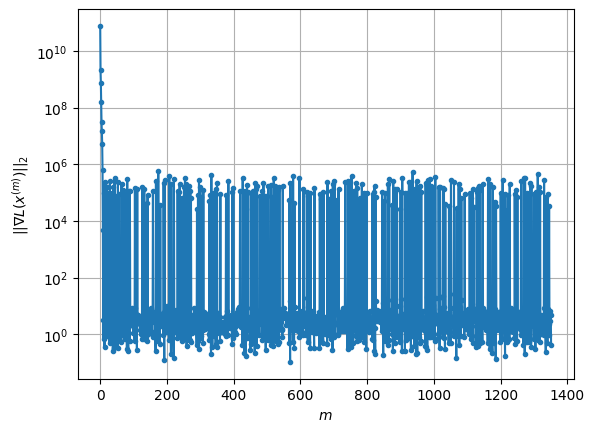

Windows:  71%|███████   | 209/296 [37:34<13:39,  9.42s/it]

Before applying the algorithm
Cost function: -23635276.6799021
Gradient norm: 38214.244429308455
Global relative error: 2.7430113217952123
Position relative errors: 0.04164070106061889 m, 0.8967311423572701 m, 0.7093431433591249 m, 2.4930057147835423 m

Iteration 1
Cost function: -23635276.807710487 (-0.00%)
Gradient norm: 5.597545057486554 (-99.99%)
Global relative error: 2.8111630437280586 (2.48%)
Position relative errors: 0.044165867276823624 m, 0.8793286631965439 m, 0.7071984180585796 m, 2.5743607758141893 m

STOP on Iteration 2
Cost function = -23635276.807710618 (-0.00%)
Gradient norm = 0.3346169681679337 (-94.02%)
Global relative error = 2.8111669092987577 (0.00%)
Final position relative errors: 0.0441658691879925 m, 0.8793269866377654 m, 0.7071993932360852 m, 2.574365301700449 m



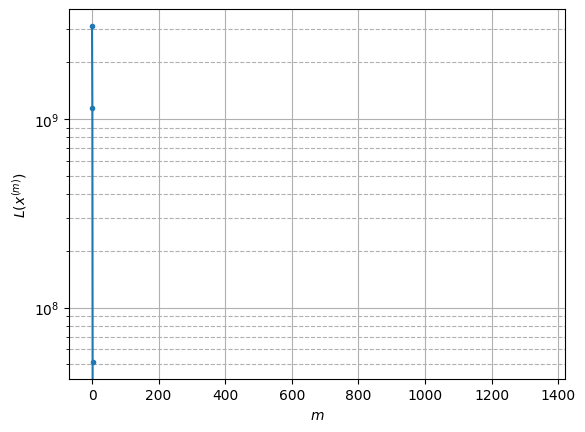

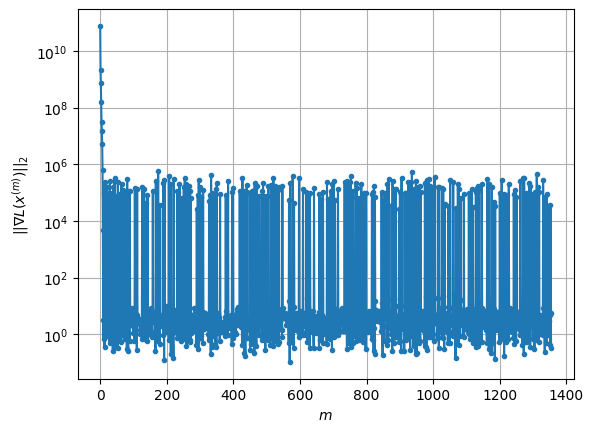

Windows:  71%|███████   | 210/296 [37:39<11:36,  8.10s/it]

Before applying the algorithm
Cost function: -23635272.327127986
Gradient norm: 50397.41028763699
Global relative error: 2.6835490366490733
Position relative errors: 0.04319805325506017 m, 0.8093509500275784 m, 0.7120873540389688 m, 2.4571214905771037 m

Iteration 1
Cost function: -23635272.78154956 (-0.00%)
Gradient norm: 3.1507568497275455 (-99.99%)
Global relative error: 2.6883653772200624 (0.18%)
Position relative errors: 0.03685969729760753 m, 0.8690743997876474 m, 0.6762935769716613 m, 2.4521991834099786 m

STOP on Iteration 2
Cost function = -23635272.78154953 (0.00%)
Gradient norm = 0.6697939407058269 (-78.74%)
Global relative error = 2.6883612953835296 (-0.00%)
Final position relative errors: 0.0368597009377268 m, 0.8690698284131111 m, 0.6762902794250407 m, 2.4521972379530483 m



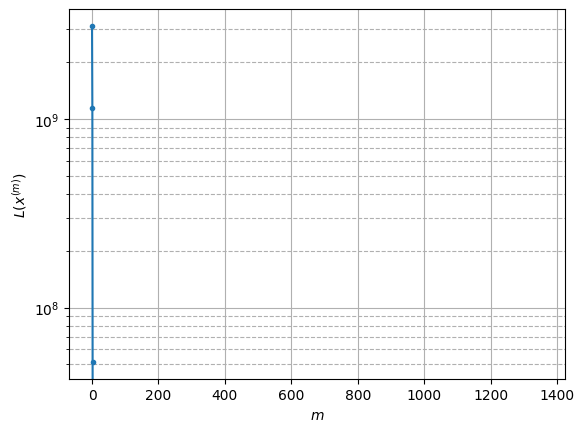

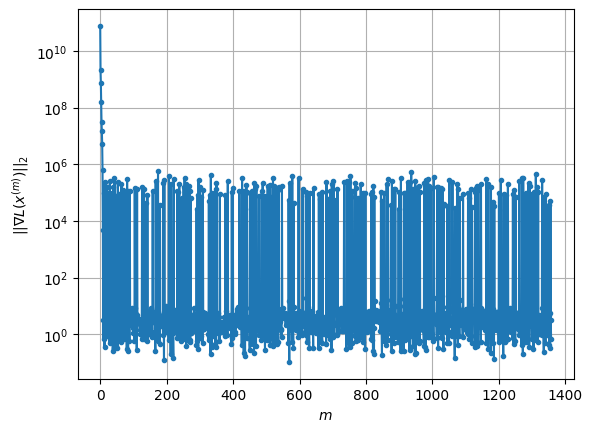

Windows:  71%|███████▏  | 211/296 [37:44<10:09,  7.17s/it]

Before applying the algorithm
Cost function: -23635271.56089531
Gradient norm: 290566.63564371795
Global relative error: 2.5546614887290353
Position relative errors: 0.036676513990465 m, 0.7999883738565724 m, 0.6807470471715551 m, 2.328421299048666 m

Iteration 1
Cost function: -23635272.36354822 (-0.00%)
Gradient norm: 15.860915107930282 (-99.99%)
Global relative error: 2.9445161578361936 (15.26%)
Position relative errors: 0.03902534355193869 m, 0.9291342531556597 m, 0.7911640345174282 m, 2.6794433766885306 m

Iteration 2
Cost function: -23635272.363548364 (-0.00%)
Gradient norm: 4.855685896098552 (-69.39%)
Global relative error: 2.9445588582811326 (0.00%)
Position relative errors: 0.039025343587997585 m, 0.9291485987240115 m, 0.791156995582163 m, 2.679487405252516 m

Iteration 3
Cost function: -23635272.363548346 (0.00%)
Gradient norm: 2.0922273340926743 (-56.91%)
Global relative error: 2.9445588488907664 (-0.00%)
Position relative errors: 0.03902534479938114 m, 0.92914857506834 m, 0

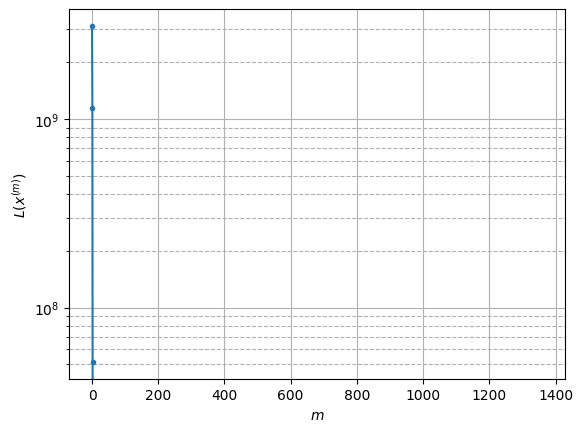

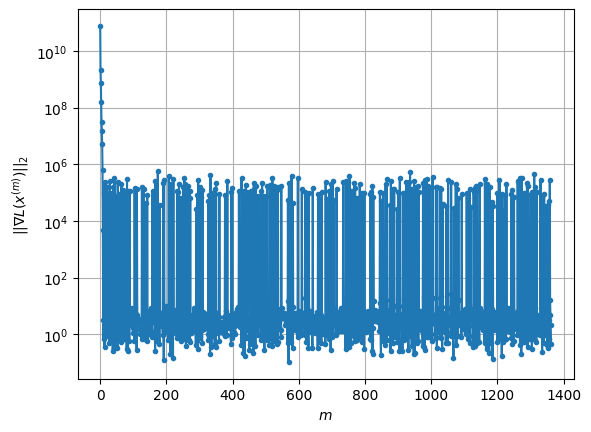

Windows:  72%|███████▏  | 212/296 [37:53<10:30,  7.51s/it]

Before applying the algorithm
Cost function: -23635272.996654727
Gradient norm: 80141.5708701584
Global relative error: 2.823070519425882
Position relative errors: 0.03861277077261102 m, 0.856325979952082 m, 0.7879958584346819 m, 2.571769639123962 m

Iteration 1
Cost function: -23635273.402562447 (-0.00%)
Gradient norm: 5.011075040366648 (-99.99%)
Global relative error: 2.4408272754906046 (-13.54%)
Position relative errors: 0.02915125795173788 m, 0.5340692005569587 m, 0.692599844956794 m, 2.2785649159803634 m

Iteration 2
Cost function: -23635273.402562704 (-0.00%)
Gradient norm: 1.439893275168537 (-71.27%)
Global relative error: 2.4408203035485134 (-0.00%)
Position relative errors: 0.029151258569818254 m, 0.5340563695092363 m, 0.692583377584442 m, 2.278565460397071 m

Iteration 3
Cost function: -23635273.402562566 (0.00%)
Gradient norm: 4.06022529162938 (181.98%)
Global relative error: 2.4408202703006543 (-0.00%)
Position relative errors: 0.029151262157126098 m, 0.5340563334240186 m, 

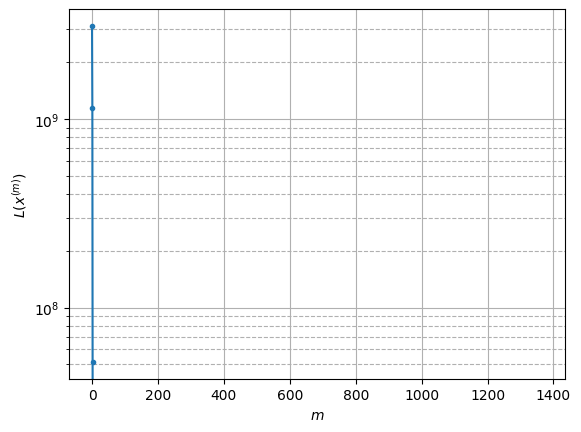

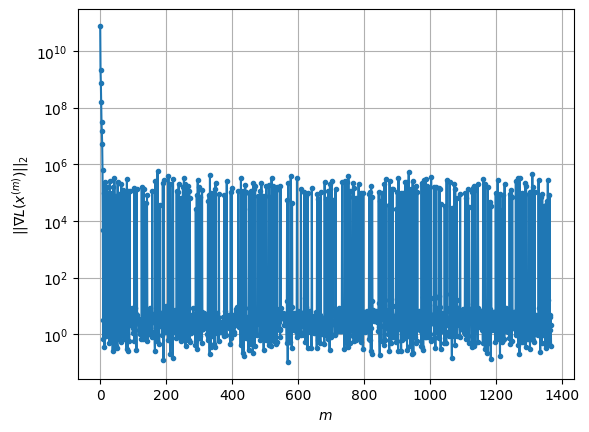

Windows:  72%|███████▏  | 213/296 [38:04<11:55,  8.62s/it]

Before applying the algorithm
Cost function: -23635277.96816445
Gradient norm: 183141.1706184734
Global relative error: 2.3188813383427194
Position relative errors: 0.028814506314173857 m, 0.4617693204285322 m, 0.6927086058303005 m, 2.164092906378333 m

Iteration 1
Cost function: -23635278.722229317 (-0.00%)
Gradient norm: 17.15670213715986 (-99.99%)
Global relative error: 2.1347908467746417 (-7.94%)
Position relative errors: 0.026118468903296162 m, 0.40273790100823553 m, 0.7123340534678196 m, 1.971554708384838 m

STOP on Iteration 2
Cost function = -23635278.722229354 (-0.00%)
Gradient norm = 0.9796596885831883 (-94.29%)
Global relative error = 2.1347968287803774 (0.00%)
Final position relative errors: 0.026118469418573643 m, 0.4027476941328751 m, 0.7123381247422235 m, 1.9715577141444542 m



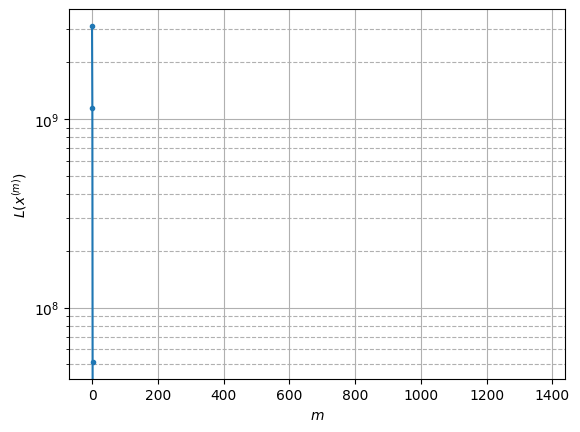

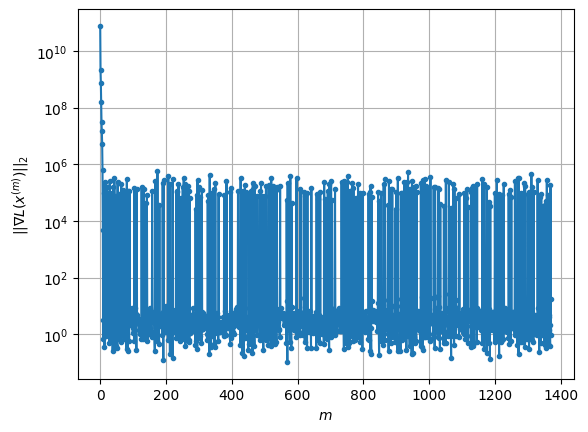

Windows:  72%|███████▏  | 214/296 [38:10<10:45,  7.88s/it]

Before applying the algorithm
Cost function: -23635267.912408236
Gradient norm: 176523.0506078733
Global relative error: 2.035656412140744
Position relative errors: 0.025716513962365718 m, 0.3317612147528502 m, 0.7068933661693925 m, 1.8797519130289693 m

Iteration 1
Cost function: -23635268.531291075 (-0.00%)
Gradient norm: 11.301097856613787 (-99.99%)
Global relative error: 2.106854866266816 (3.50%)
Position relative errors: 0.026071677568793174 m, 0.4701578475883858 m, 0.9630783645732002 m, 1.8137215263205668 m

Iteration 2
Cost function: -23635268.531290885 (0.00%)
Gradient norm: 2.455959912439597 (-78.27%)
Global relative error: 2.106814581528338 (-0.00%)
Position relative errors: 0.02607167745497292 m, 0.47013882711086535 m, 0.9630318875198189 m, 1.8137043400595068 m

Iteration 3
Cost function: -23635268.53129099 (-0.00%)
Gradient norm: 3.4635036353340944 (41.02%)
Global relative error: 2.1068145975574164 (0.00%)
Position relative errors: 0.02607167892499695 m, 0.47013880566495553

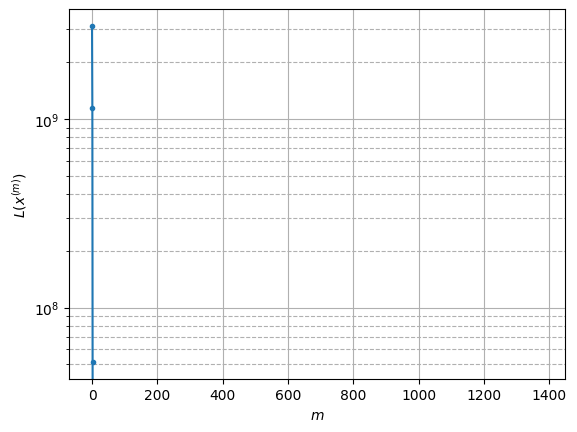

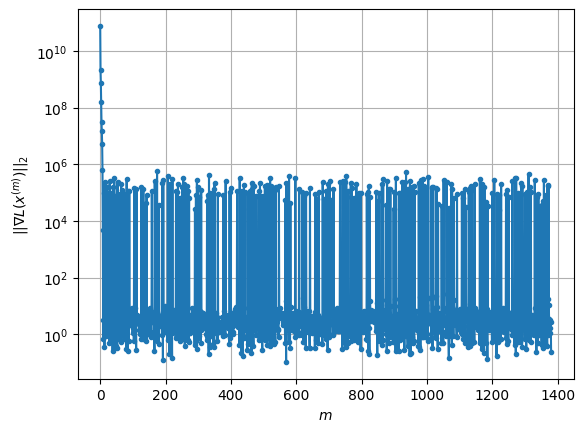

Windows:  73%|███████▎  | 215/296 [38:27<14:21, 10.63s/it]

Before applying the algorithm
Cost function: -23635265.005226832
Gradient norm: 135931.42881534758
Global relative error: 2.0218150881019072
Position relative errors: 0.025583417185734782 m, 0.40812934773274984 m, 0.949208688223701 m, 1.7376740341142944 m

Iteration 1
Cost function: -23635265.457194384 (-0.00%)
Gradient norm: 4.563394513997922 (-100.00%)
Global relative error: 1.89592950776321 (-6.23%)
Position relative errors: 0.023405283456180006 m, 0.45681122611436425 m, 0.7675347794064082 m, 1.67218760677477 m

Iteration 2
Cost function: -23635265.45719456 (-0.00%)
Gradient norm: 4.85579636387764 (6.41%)
Global relative error: 1.8959156617609272 (-0.00%)
Position relative errors: 0.023405281114790344 m, 0.45681892129977597 m, 0.7674890028080273 m, 1.6721908169416977 m

Iteration 3
Cost function: -23635265.457194764 (-0.00%)
Gradient norm: 2.379991630781838 (-50.99%)
Global relative error: 1.8959156493331413 (-0.00%)
Position relative errors: 0.02340528060761869 m, 0.456818914546273

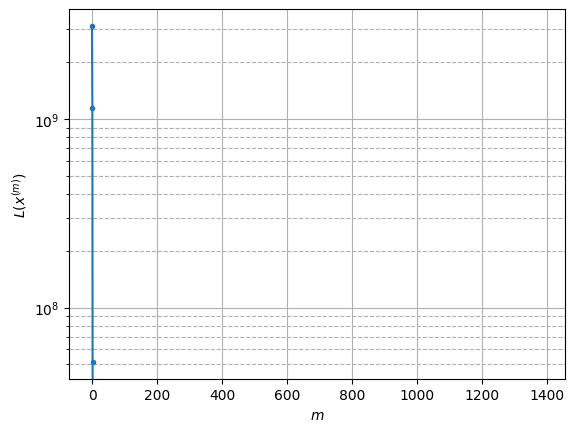

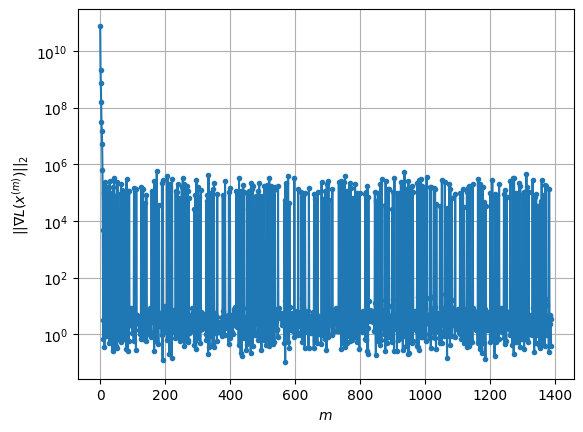

Windows:  73%|███████▎  | 216/296 [38:40<15:10, 11.38s/it]

Before applying the algorithm
Cost function: -23635264.595483635
Gradient norm: 263521.6604927648
Global relative error: 1.8146902537051148
Position relative errors: 0.02277858460355092 m, 0.40579851965029146 m, 0.7597302999994611 m, 1.5970959862123946 m

Iteration 1
Cost function: -23635264.988520153 (-0.00%)
Gradient norm: 3.6572877253608183 (-100.00%)
Global relative error: 1.6623511452414201 (-8.39%)
Position relative errors: 0.02306524841259058 m, 0.30633316437958497 m, 0.6376717183063855 m, 1.504131053607174 m

Iteration 2
Cost function: -23635264.98852035 (-0.00%)
Gradient norm: 1.324686482162838 (-63.78%)
Global relative error: 1.6623383832686716 (-0.00%)
Position relative errors: 0.02306525135434166 m, 0.30632969662919984 m, 0.6376487531508003 m, 1.5041273913098074 m

Iteration 3
Cost function: -23635264.98852005 (0.00%)
Gradient norm: 5.146046105863635 (288.47%)
Global relative error: 1.6623383622103143 (-0.00%)
Position relative errors: 0.023065252608353678 m, 0.306329698020

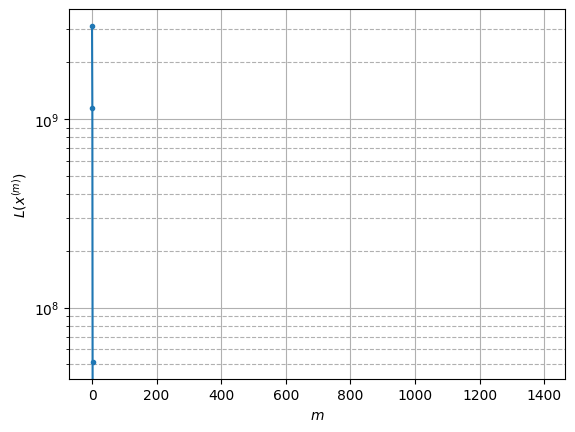

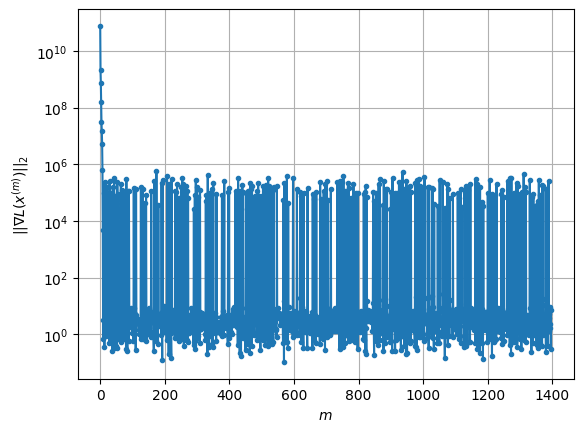

Windows:  73%|███████▎  | 217/296 [38:57<17:03, 12.95s/it]

Before applying the algorithm
Cost function: -23635258.948054735
Gradient norm: 125570.7121095386
Global relative error: 1.58800000891227
Position relative errors: 0.022082200702752377 m, 0.31425960260561014 m, 0.6337563921156678 m, 1.421564633712324 m

Iteration 1
Cost function: -23635259.774454083 (-0.00%)
Gradient norm: 6.248044253782482 (-100.00%)
Global relative error: 1.3759281980464941 (-13.35%)
Position relative errors: 0.018905298137372194 m, 0.26107897587966417 m, 0.49110424739951014 m, 1.2583606913763368 m

Iteration 2
Cost function: -23635259.774453368 (0.00%)
Gradient norm: 9.073521158118306 (45.22%)
Global relative error: 1.375932098883375 (0.00%)
Position relative errors: 0.018905290488806407 m, 0.26108719047932516 m, 0.49111294012073525 m, 1.2583598598751244 m

Iteration 3
Cost function: -23635259.774454027 (-0.00%)
Gradient norm: 8.620345483758191 (-4.99%)
Global relative error: 1.3759321417528558 (0.00%)
Position relative errors: 0.018905299075616524 m, 0.261087190021

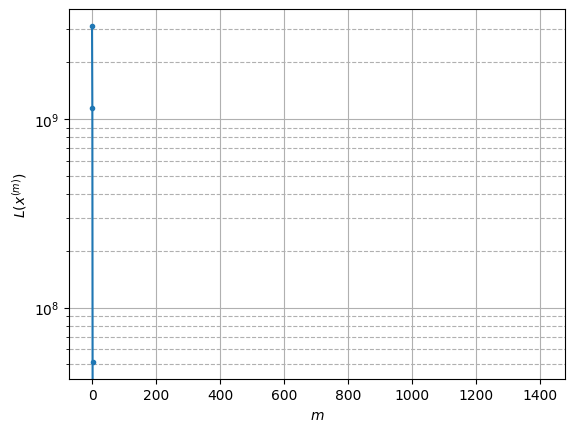

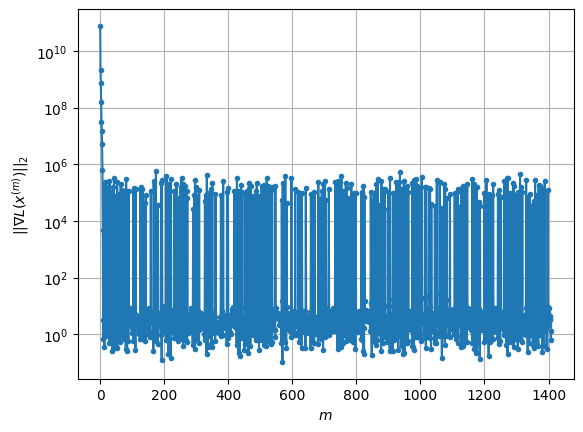

Windows:  74%|███████▎  | 218/296 [39:18<20:00, 15.39s/it]

Before applying the algorithm
Cost function: -23635261.852676105
Gradient norm: 135717.341557828
Global relative error: 1.2941823407205755
Position relative errors: 0.017894605239820876 m, 0.29650279204274893 m, 0.4842609775163479 m, 1.1628246173498162 m

Iteration 1
Cost function: -23635261.98108482 (-0.00%)
Gradient norm: 4.807326256719172 (-100.00%)
Global relative error: 1.169125727502189 (-9.66%)
Position relative errors: 0.01773351361052834 m, 0.32935792564675626 m, 0.43340790360949794 m, 1.034513276978345 m

Iteration 2
Cost function: -23635261.981084716 (0.00%)
Gradient norm: 1.4163020687459997 (-70.54%)
Global relative error: 1.169127705303067 (0.00%)
Position relative errors: 0.017733512033311315 m, 0.3293630962447189 m, 0.4334051466123318 m, 1.0345150210594058 m

Iteration 3
Cost function: -23635261.981084786 (-0.00%)
Gradient norm: 1.7627479845705738 (24.46%)
Global relative error: 1.1691276752860702 (-0.00%)
Position relative errors: 0.017733508889752083 m, 0.3293631238820

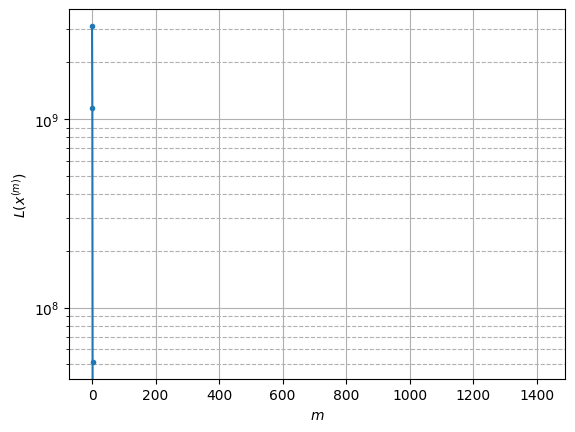

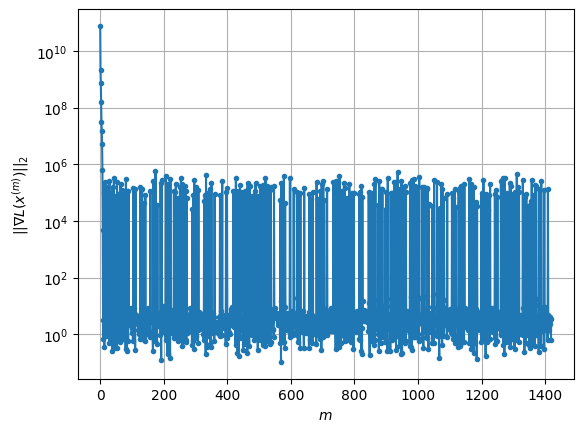

Windows:  74%|███████▍  | 219/296 [39:36<20:56, 16.31s/it]

Before applying the algorithm
Cost function: -23635263.034251157
Gradient norm: 234195.07899777824
Global relative error: 1.0919709425588227
Position relative errors: 0.016744234343740148 m, 0.3632135585418084 m, 0.4257203458895927 m, 0.9375256447553119 m

Iteration 1
Cost function: -23635263.44966986 (-0.00%)
Gradient norm: 6.040122738365384 (-100.00%)
Global relative error: 1.1849974325141743 (8.52%)
Position relative errors: 0.019709608863879843 m, 0.5132067715763384 m, 0.3941360062226022 m, 0.9925228277733801 m

Iteration 2
Cost function: -23635263.44966983 (0.00%)
Gradient norm: 1.0434086293747333 (-82.73%)
Global relative error: 1.1849936483137624 (-0.00%)
Position relative errors: 0.019709608955290465 m, 0.5132261049878079 m, 0.39413030068156485 m, 0.9925105783959433 m

Iteration 3
Cost function: -23635263.449669782 (0.00%)
Gradient norm: 2.4658139679161595 (136.32%)
Global relative error: 1.1849936581357732 (0.00%)
Position relative errors: 0.01970960996517255 m, 0.513226093715

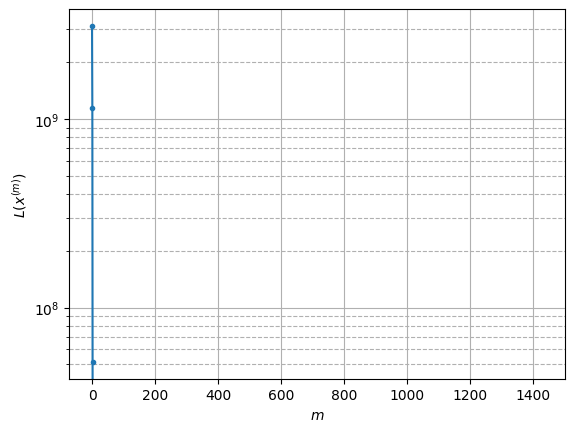

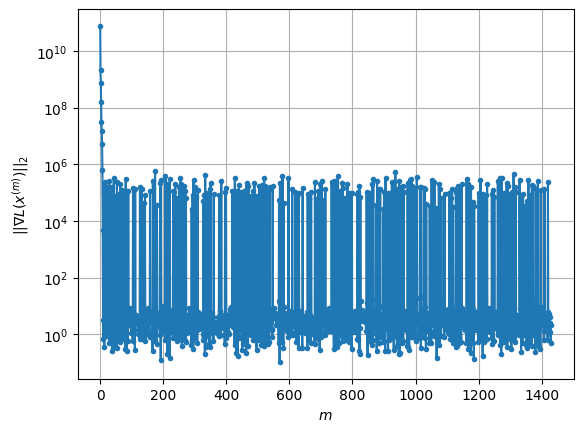

Windows:  74%|███████▍  | 220/296 [39:54<21:17, 16.81s/it]

Before applying the algorithm
Cost function: -23635261.44545277
Gradient norm: 182345.2655916749
Global relative error: 1.103315049127343
Position relative errors: 0.01862241121683831 m, 0.5367565055432214 m, 0.38983769646828687 m, 0.8814031972768676 m

Iteration 1
Cost function: -23635261.699361257 (-0.00%)
Gradient norm: 2.6092543170328013 (-100.00%)
Global relative error: 1.191919522130809 (8.03%)
Position relative errors: 0.019257478059046613 m, 0.43168346993566 m, 0.5799802736976314 m, 0.9474005234068197 m

STOP on Iteration 2
Cost function = -23635261.69936114 (0.00%)
Gradient norm = 0.6301484816637424 (-75.85%)
Global relative error = 1.1918928028543883 (-0.00%)
Final position relative errors: 0.019257478272884095 m, 0.4316984412251557 m, 0.5799449203000538 m, 0.9473817285526543 m



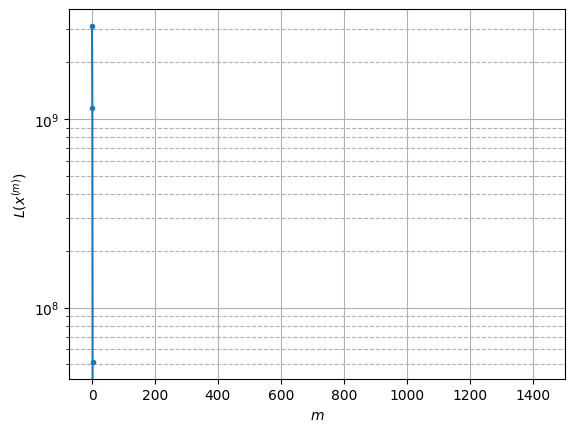

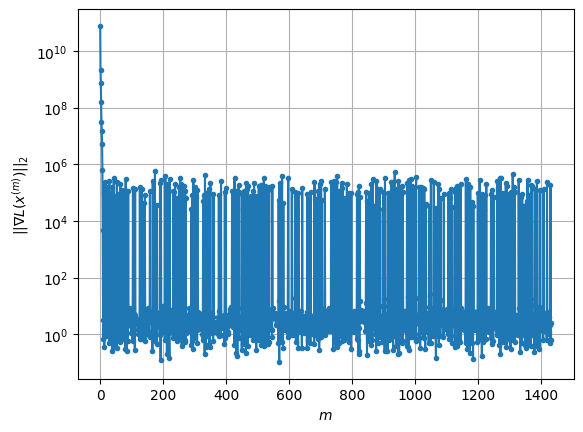

Windows:  75%|███████▍  | 221/296 [39:59<16:40, 13.34s/it]

Before applying the algorithm
Cost function: -23635266.959158603
Gradient norm: 69095.04426687994
Global relative error: 1.0950200128576928
Position relative errors: 0.018131172902422152 m, 0.4583429527411514 m, 0.5583716523750059 m, 0.8227252505971939 m

Iteration 1
Cost function: -23635267.46610336 (-0.00%)
Gradient norm: 5.572896787956654 (-99.99%)
Global relative error: 1.0650441551358256 (-2.74%)
Position relative errors: 0.01970077043757828 m, 0.7143998305309048 m, 0.3789869167577513 m, 0.6927685000685833 m

Iteration 2
Cost function: -23635267.46610355 (-0.00%)
Gradient norm: 3.6835065673129344 (-33.90%)
Global relative error: 1.0650554840077242 (0.00%)
Position relative errors: 0.01970077139956224 m, 0.714487457415006 m, 0.3789582844314696 m, 0.6927112091321651 m

Iteration 3
Cost function: -23635267.466103513 (0.00%)
Gradient norm: 4.199680848988724 (14.01%)
Global relative error: 1.0650554909009542 (0.00%)
Position relative errors: 0.019700771998150998 m, 0.7144874585284539 m

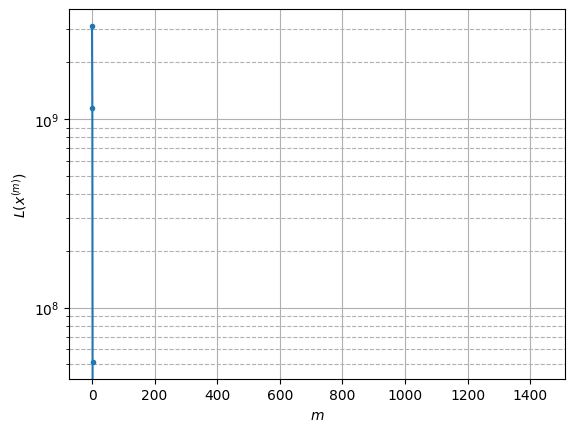

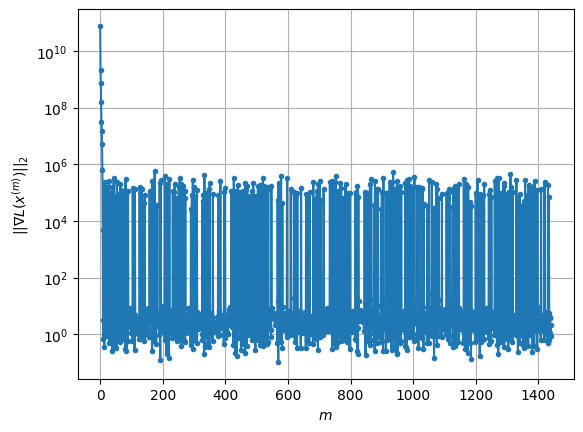

Windows:  75%|███████▌  | 222/296 [40:13<16:24, 13.30s/it]

Before applying the algorithm
Cost function: -23635268.892792434
Gradient norm: 247265.86126335562
Global relative error: 1.02040647139271
Position relative errors: 0.018495464977330154 m, 0.7412561519663421 m, 0.3737757463269549 m, 0.5930545022602217 m

Iteration 1
Cost function: -23635269.122735582 (-0.00%)
Gradient norm: 9.46976211894161 (-100.00%)
Global relative error: 1.204182888278508 (18.01%)
Position relative errors: 0.02177004486979589 m, 1.0853405887160192 m, 0.2976510429269139 m, 0.42780676364274334 m

Iteration 2
Cost function: -23635269.12273573 (-0.00%)
Gradient norm: 2.329920063970711 (-75.40%)
Global relative error: 1.2042103374788216 (0.00%)
Position relative errors: 0.021770044140154952 m, 1.0853817080518093 m, 0.29763211595382033 m, 0.4277928751279256 m

Iteration 3
Cost function: -23635269.122735742 (-0.00%)
Gradient norm: 2.547287382773149 (9.33%)
Global relative error: 1.204210301335879 (-0.00%)
Position relative errors: 0.021770045558295585 m, 1.085381661630817 

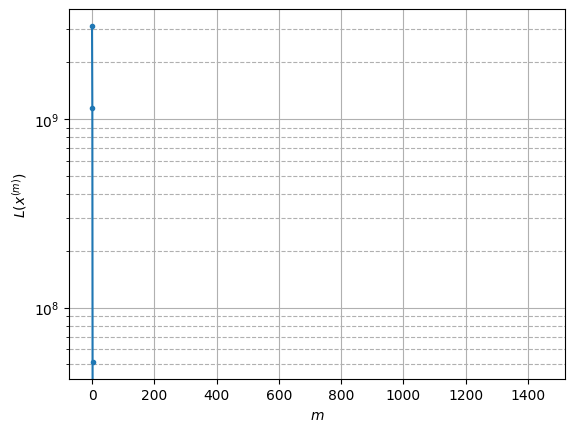

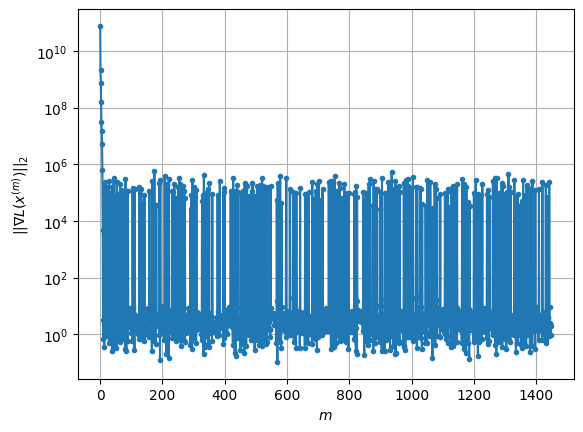

Windows:  75%|███████▌  | 223/296 [40:24<15:37, 12.85s/it]

Before applying the algorithm
Cost function: -23635259.72753893
Gradient norm: 139022.41685703516
Global relative error: 1.1937151754473259
Position relative errors: 0.020565749848303356 m, 1.0883670073556173 m, 0.29802857213766626 m, 0.3888002620261138 m

Iteration 1
Cost function: -23635261.17075567 (-0.00%)
Gradient norm: 28.30099448594886 (-99.98%)
Global relative error: 1.4485628571476332 (21.35%)
Position relative errors: 0.025478214146679137 m, 1.2725858817315587 m, 0.48515966855660075 m, 0.4927764504955022 m

Iteration 2
Cost function: -23635261.170755636 (0.00%)
Gradient norm: 5.9531104950953795 (-78.97%)
Global relative error: 1.4485099128962917 (-0.00%)
Position relative errors: 0.02547821404426695 m, 1.2725512324219779 m, 0.48509891517407083 m, 0.49277010926013143 m

Iteration 3
Cost function: -23635261.170755543 (0.00%)
Gradient norm: 5.058941983276647 (-15.02%)
Global relative error: 1.448509886116158 (-0.00%)
Position relative errors: 0.025478214319672118 m, 1.2725512079

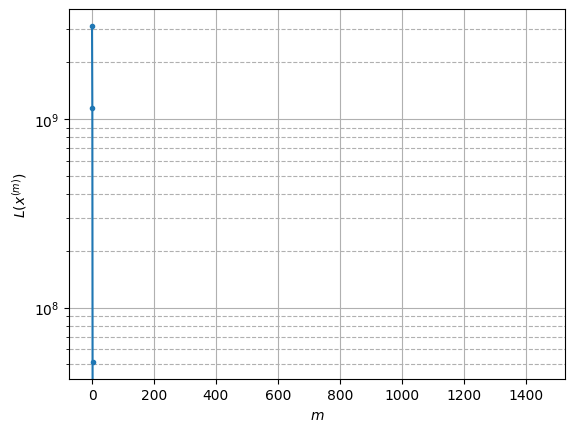

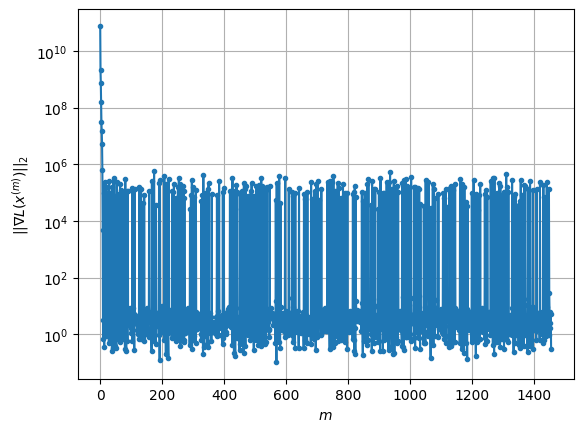

Windows:  76%|███████▌  | 224/296 [40:38<15:30, 12.92s/it]

Before applying the algorithm
Cost function: -23635255.02005445
Gradient norm: 382242.015297525
Global relative error: 1.4259497893046882
Position relative errors: 0.024242983871064782 m, 1.2507103538550084 m, 0.4692548451774149 m, 0.4982636757674138 m

Iteration 1
Cost function: -23635255.42472053 (-0.00%)
Gradient norm: 6.91434973446876 (-100.00%)
Global relative error: 1.6189033671292679 (13.53%)
Position relative errors: 0.0232971080750117 m, 1.4766899676001657 m, 0.5237092177490201 m, 0.4067160170466716 m

Iteration 2
Cost function: -23635255.424720634 (-0.00%)
Gradient norm: 1.1147776915470393 (-83.88%)
Global relative error: 1.618884551860483 (-0.00%)
Position relative errors: 0.023297107959353035 m, 1.476674326333996 m, 0.5236993756242334 m, 0.4067105872585734 m

Iteration 3
Cost function: -23635255.424720697 (-0.00%)
Gradient norm: 3.030492112451798 (171.85%)
Global relative error: 1.618884546873978 (-0.00%)
Position relative errors: 0.02329710814348301 m, 1.476674323218344 m,

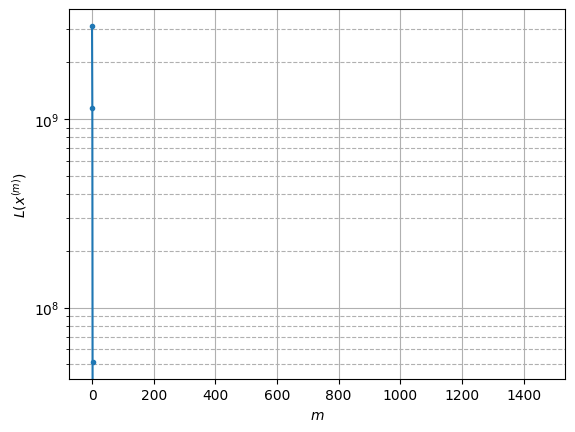

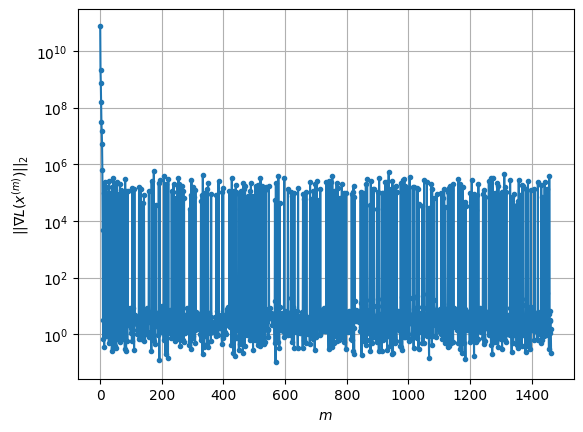

Windows:  76%|███████▌  | 225/296 [40:49<14:50, 12.54s/it]

Before applying the algorithm
Cost function: -23635252.042143382
Gradient norm: 84825.36201934442
Global relative error: 1.5972919507666727
Position relative errors: 0.021872009993065798 m, 1.4584993277224914 m, 0.49832945424303027 m, 0.41869769710040944 m

Iteration 1
Cost function: -23635252.47490649 (-0.00%)
Gradient norm: 6.442724444479974 (-99.99%)
Global relative error: 1.783722351411078 (11.67%)
Position relative errors: 0.02233401973941879 m, 1.6210470726566397 m, 0.5458256209783647 m, 0.5054149998942822 m

Iteration 2
Cost function: -23635252.474906646 (-0.00%)
Gradient norm: 1.0557776374361305 (-83.61%)
Global relative error: 1.7836829690754255 (-0.00%)
Position relative errors: 0.022334020240647727 m, 1.621014501176849 m, 0.5458155461208052 m, 0.5053913594387984 m

Iteration 3
Cost function: -23635252.474906333 (0.00%)
Gradient norm: 6.019900935517208 (470.19%)
Global relative error: 1.7836829200327156 (-0.00%)
Position relative errors: 0.022334020718167848 m, 1.621014456355

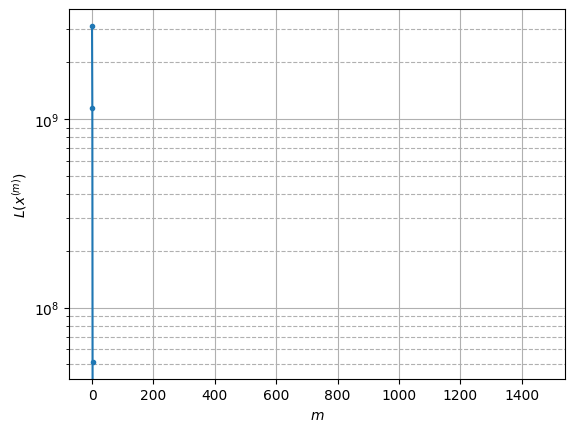

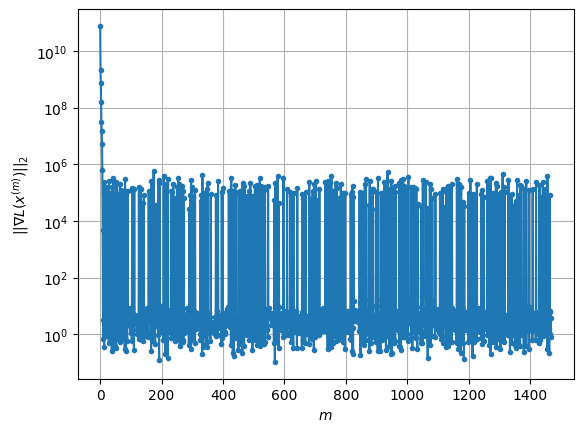

Windows:  76%|███████▋  | 226/296 [40:59<13:47, 11.83s/it]

Before applying the algorithm
Cost function: -23635248.990495287
Gradient norm: 191915.99639777007
Global relative error: 1.780865626412654
Position relative errors: 0.020768001611994488 m, 1.6085746243980321 m, 0.504050919552543 m, 0.5739933189408476 m

Iteration 1
Cost function: -23635249.7183342 (-0.00%)
Gradient norm: 7.9870444123814766 (-100.00%)
Global relative error: 1.844933820077289 (3.60%)
Position relative errors: 0.025231019528571885 m, 1.7258708892534746 m, 0.31770458389312484 m, 0.5688371456653123 m

Iteration 2
Cost function: -23635249.718333602 (0.00%)
Gradient norm: 2.1345683441047436 (-73.27%)
Global relative error: 1.844996071328212 (0.00%)
Position relative errors: 0.02523102017045632 m, 1.7259357800486148 m, 0.3176647223737916 m, 0.5688644279836543 m

Iteration 3
Cost function: -23635249.718333963 (-0.00%)
Gradient norm: 1.3452231196732676 (-36.98%)
Global relative error: 1.8449960420097251 (-0.00%)
Position relative errors: 0.025231019984055407 m, 1.72593575550592

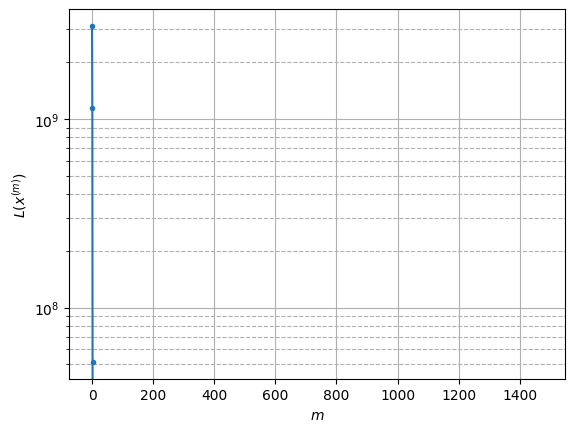

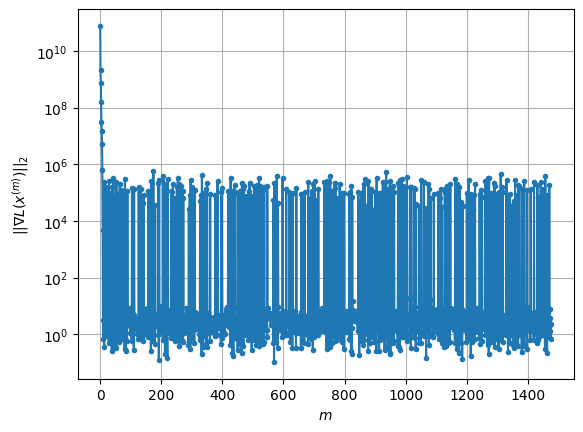

Windows:  77%|███████▋  | 227/296 [41:11<13:41, 11.90s/it]

Before applying the algorithm
Cost function: -23635240.516928643
Gradient norm: 230647.51897343213
Global relative error: 1.8066966656201395
Position relative errors: 0.023609266111201694 m, 1.6738405911698953 m, 0.30712978546950614 m, 0.6062361750064093 m

Iteration 1
Cost function: -23635240.776423797 (-0.00%)
Gradient norm: 3.4643795824740593 (-100.00%)
Global relative error: 1.7282778326504922 (-4.34%)
Position relative errors: 0.021887301163281025 m, 1.6389946013422425 m, 0.2794798017519161 m, 0.471223203389749 m

STOP on Iteration 2
Cost function = -23635240.77642381 (-0.00%)
Gradient norm = 0.9158080181958561 (-73.57%)
Global relative error = 1.7282840877634689 (0.00%)
Final position relative errors: 0.02188730166084508 m, 1.6390018662275425 m, 0.27948044253776866 m, 0.4712204962881655 m



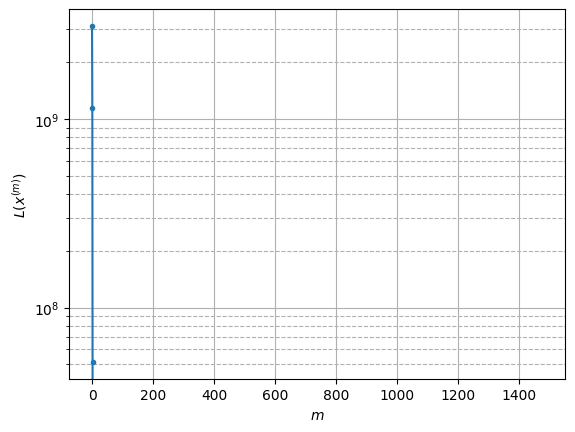

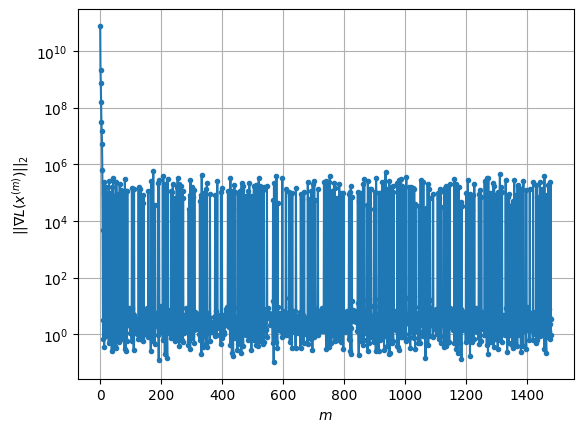

Windows:  77%|███████▋  | 228/296 [41:17<11:16,  9.95s/it]

Before applying the algorithm
Cost function: -23635237.201011002
Gradient norm: 75429.83367955132
Global relative error: 1.6901447747322746
Position relative errors: 0.020203227951269925 m, 1.589494259830663 m, 0.2750050838633282 m, 0.5040432655625471 m

Iteration 1
Cost function: -23635237.70890367 (-0.00%)
Gradient norm: 12.898255384901999 (-99.98%)
Global relative error: 1.900720967724162 (12.46%)
Position relative errors: 0.015563401172406758 m, 1.6217631499358285 m, 0.3837432898952292 m, 0.9138498662618577 m

Iteration 2
Cost function: -23635237.70890386 (-0.00%)
Gradient norm: 4.0662638681136745 (-68.47%)
Global relative error: 1.9007134926539144 (-0.00%)
Position relative errors: 0.015563401737307763 m, 1.6217681407523261 m, 0.383736911845766 m, 0.9138281398712297 m

STOP on Iteration 3
Cost function = -23635237.708903536 (0.00%)
Gradient norm = 0.22213989990133298 (-94.54%)
Global relative error = 1.9007134841931157 (-0.00%)
Final position relative errors: 0.015563400993295038 

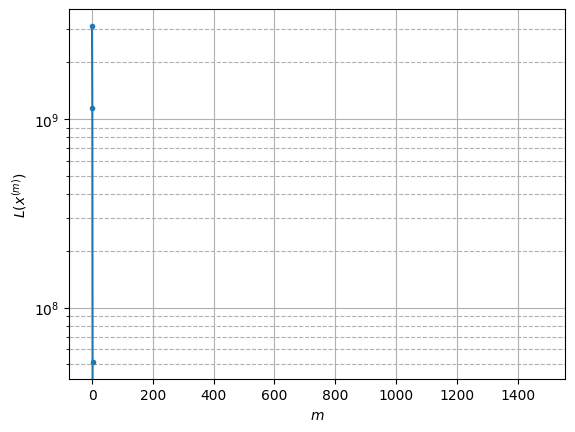

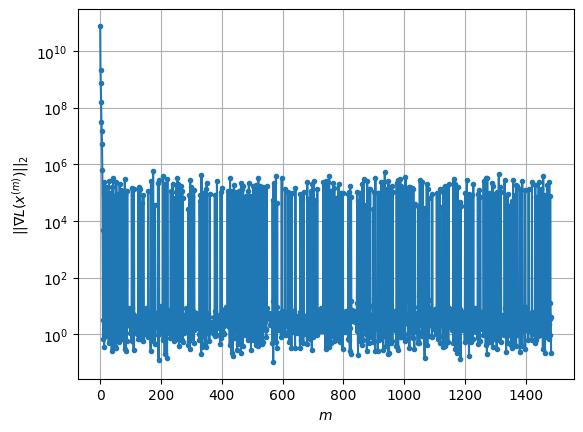

Windows:  77%|███████▋  | 229/296 [41:24<10:09,  9.10s/it]

Before applying the algorithm
Cost function: -23635231.70364828
Gradient norm: 458058.22690512787
Global relative error: 1.859583446157591
Position relative errors: 0.013804306570217355 m, 1.5629764951354663 m, 0.37166957526703903 m, 0.9363889805456023 m

Iteration 1
Cost function: -23635232.531000987 (-0.00%)
Gradient norm: 7.479127283617049 (-100.00%)
Global relative error: 1.5371387705700386 (-17.34%)
Position relative errors: 0.022310935409102218 m, 1.2249809921924073 m, 0.6177965308510447 m, 0.6928521236369881 m

Iteration 2
Cost function: -23635232.531001233 (-0.00%)
Gradient norm: 3.8432100867849996 (-48.61%)
Global relative error: 1.537125455898758 (-0.00%)
Position relative errors: 0.022310935360197966 m, 1.2249823539216087 m, 0.6177576173459368 m, 0.6928548737089625 m

STOP on Iteration 3
Cost function = -23635232.531000752 (0.00%)
Gradient norm = 0.41897454695332204 (-89.10%)
Global relative error = 1.5371254633307883 (0.00%)
Final position relative errors: 0.022310930105201

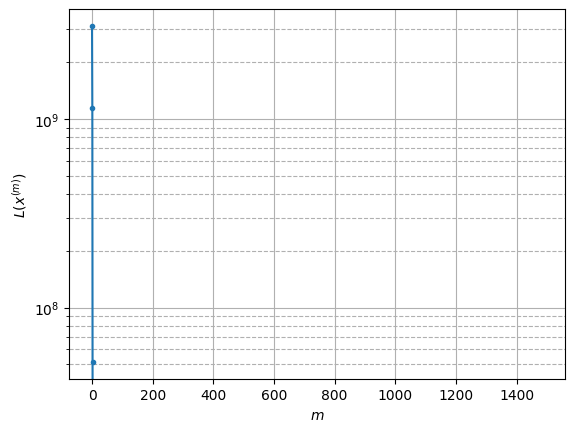

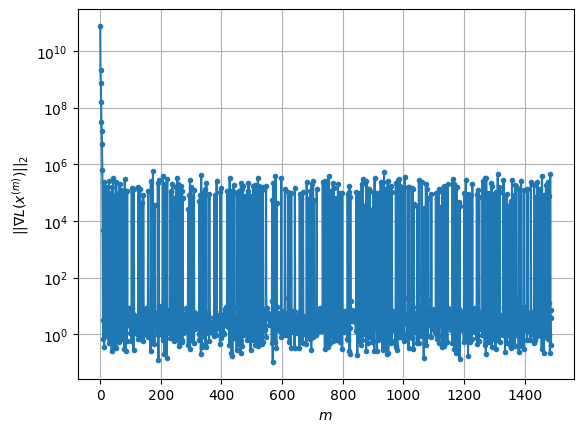

Windows:  78%|███████▊  | 230/296 [41:31<09:15,  8.42s/it]

Before applying the algorithm
Cost function: -23635227.298996527
Gradient norm: 122440.66399384718
Global relative error: 1.4944388717649597
Position relative errors: 0.02073282219071133 m, 1.1678069461344651 m, 0.5903551894242023 m, 0.7215417627319776 m

Iteration 1
Cost function: -23635228.00951382 (-0.00%)
Gradient norm: 12.85623413902578 (-99.99%)
Global relative error: 2.0330877208907108 (36.04%)
Position relative errors: 0.01690652970602143 m, 1.4641326107996078 m, 0.5356397878676321 m, 1.304823034111465 m

Iteration 2
Cost function: -23635228.009513773 (0.00%)
Gradient norm: 4.136036397978633 (-67.83%)
Global relative error: 2.032956917848258 (-0.01%)
Position relative errors: 0.01690652023722351 m, 1.4640316340002024 m, 0.5356343611159827 m, 1.3047347584398938 m

STOP on Iteration 3
Cost function = -23635228.00951378 (-0.00%)
Gradient norm = 0.9892147738907818 (-76.08%)
Global relative error = 2.0329569071826867 (-0.00%)
Final position relative errors: 0.016906522491124194 m, 1

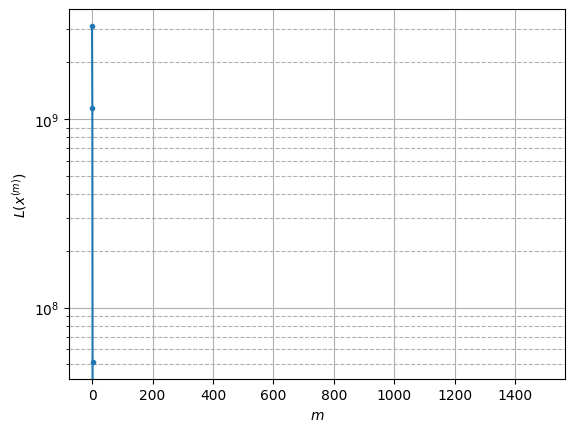

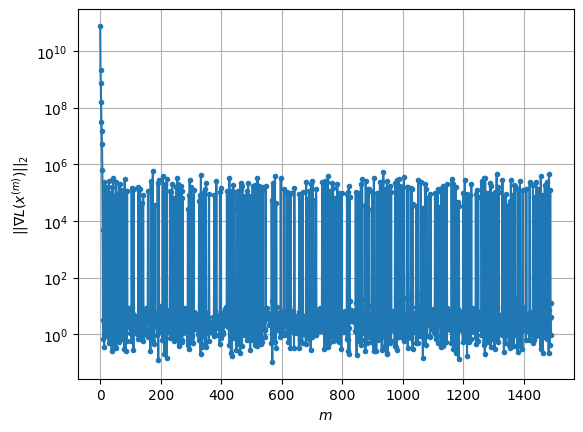

Windows:  78%|███████▊  | 231/296 [41:38<08:37,  7.96s/it]

Before applying the algorithm
Cost function: -23635224.135977298
Gradient norm: 383523.24065970356
Global relative error: 2.015713463134959
Position relative errors: 0.015127561407663647 m, 1.4145457926033669 m, 0.5181539465043723 m, 1.3391961049637544 m

Iteration 1
Cost function: -23635224.49792873 (-0.00%)
Gradient norm: 1.7130924152317621 (-100.00%)
Global relative error: 2.074216403219432 (2.90%)
Position relative errors: 0.012345308464040089 m, 1.4489481976276553 m, 0.4290627392779664 m, 1.4208002266999378 m

Iteration 2
Cost function: -23635224.49792887 (-0.00%)
Gradient norm: 1.8797669724186428 (9.73%)
Global relative error: 2.0742218711684344 (0.00%)
Position relative errors: 0.012345312537882376 m, 1.4489532184485354 m, 0.4290596415022829 m, 1.4208040244769111 m

Iteration 3
Cost function: -23635224.497928556 (0.00%)
Gradient norm: 3.570077648606378 (89.92%)
Global relative error: 2.0742218263825 (-0.00%)
Position relative errors: 0.012345309850194993 m, 1.44895318587363 m, 0

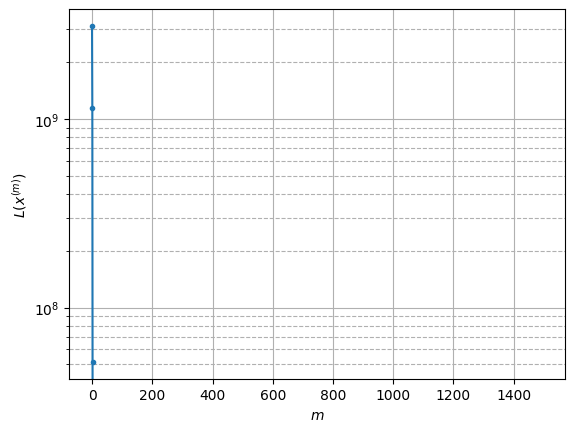

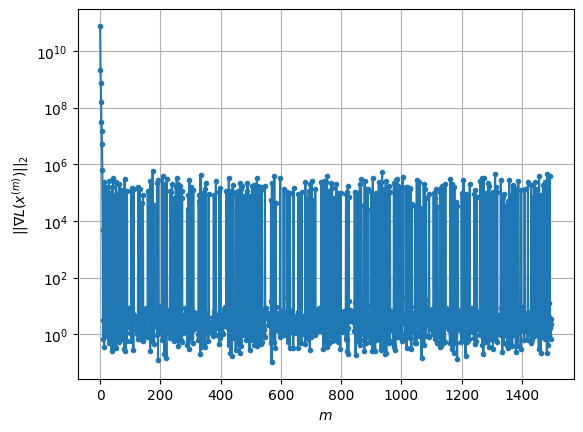

Windows:  78%|███████▊  | 232/296 [41:48<09:07,  8.56s/it]

Before applying the algorithm
Cost function: -23635231.75344954
Gradient norm: 256504.64089662294
Global relative error: 2.0596366612610693
Position relative errors: 0.010684077849158431 m, 1.3965837793380058 m, 0.41235559339753075 m, 1.4565381367467605 m

Iteration 1
Cost function: -23635232.855137665 (-0.00%)
Gradient norm: 16.226662302987524 (-99.99%)
Global relative error: 1.7768770304192754 (-13.73%)
Position relative errors: 0.008658023872080317 m, 1.1537068058484887 m, 0.88669464518161 m, 1.019777701936704 m

Iteration 2
Cost function: -23635232.855137497 (0.00%)
Gradient norm: 5.009842320713521 (-69.13%)
Global relative error: 1.7769222005712737 (0.00%)
Position relative errors: 0.008658023560313524 m, 1.1538179615875204 m, 0.8865261106971102 m, 1.0198771700257185 m

STOP on Iteration 3
Cost function = -23635232.855137695 (-0.00%)
Gradient norm = 0.8172777733871966 (-83.69%)
Global relative error = 1.7769222158989448 (0.00%)
Final position relative errors: 0.008658023948363614 

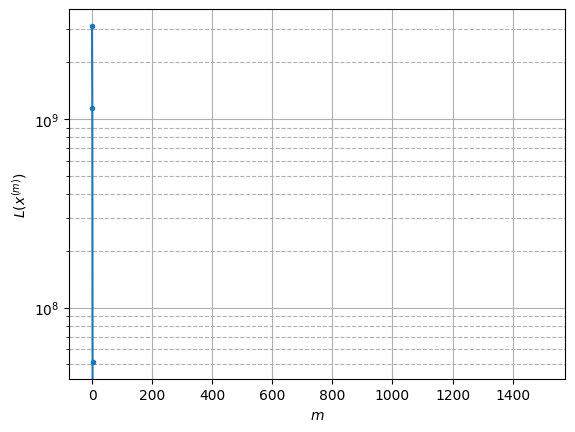

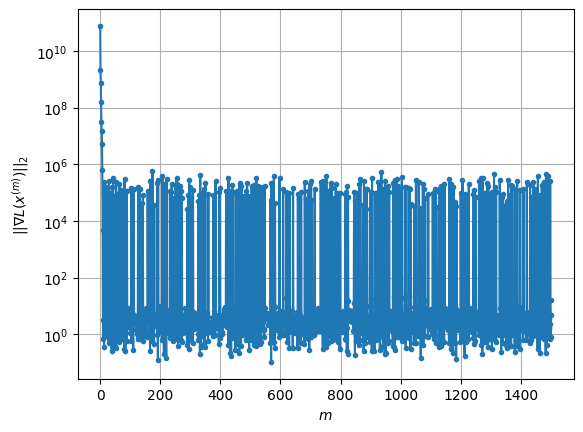

Windows:  79%|███████▊  | 233/296 [41:54<08:23,  8.00s/it]

Before applying the algorithm
Cost function: -23635225.88748263
Gradient norm: 113585.01376794718
Global relative error: 1.763486701145961
Position relative errors: 0.006751149362497104 m, 1.1213292286433483 m, 0.8294637592290569 m, 1.079095325324767 m

Iteration 1
Cost function: -23635226.64353297 (-0.00%)
Gradient norm: 21.90434315252017 (-99.98%)
Global relative error: 1.7246570552720404 (-2.20%)
Position relative errors: 0.007931826560532939 m, 1.1006841008814041 m, 0.4891812815788412 m, 1.2343306959394318 m

Iteration 2
Cost function: -23635226.643532865 (0.00%)
Gradient norm: 2.1775825997904223 (-90.06%)
Global relative error: 1.7246974091395164 (0.00%)
Position relative errors: 0.007931826743384393 m, 1.1007131489550441 m, 0.48914324786281355 m, 1.2343762493108268 m

Iteration 3
Cost function: -23635226.643532947 (-0.00%)
Gradient norm: 1.6400729337474207 (-24.68%)
Global relative error: 1.7246974111116742 (0.00%)
Position relative errors: 0.007931826367139502 m, 1.1007131523611

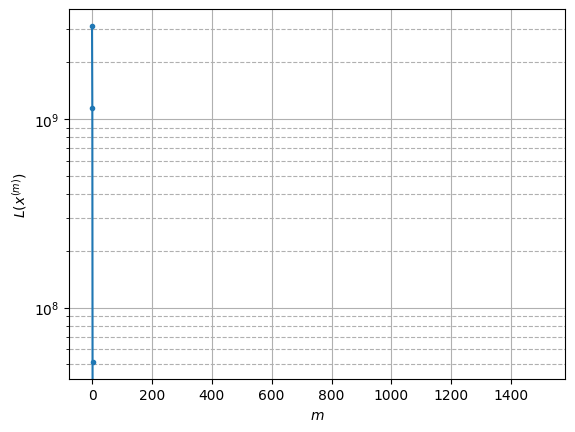

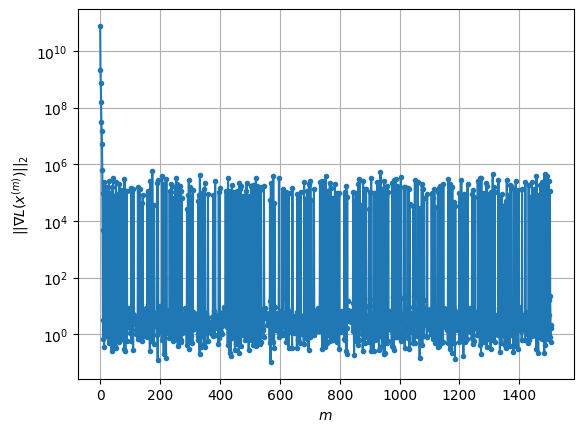

Windows:  79%|███████▉  | 234/296 [42:03<08:27,  8.18s/it]

Before applying the algorithm
Cost function: -23635227.573992345
Gradient norm: 34706.300703386005
Global relative error: 1.7273519545066796
Position relative errors: 0.0059694857930040705 m, 1.0586725753301023 m, 0.47372325816828914 m, 1.280040979753538 m

Iteration 1
Cost function: -23635228.228206992 (-0.00%)
Gradient norm: 23.352217560691525 (-99.93%)
Global relative error: 1.112676816136803 (-35.58%)
Position relative errors: 0.009959828640972418 m, 0.4608390965279333 m, 0.8693616493489861 m, 0.5194081917753937 m

Iteration 2
Cost function: -23635228.228207115 (-0.00%)
Gradient norm: 3.647661241872853 (-84.38%)
Global relative error: 1.1125446424826129 (-0.01%)
Position relative errors: 0.009959821840804066 m, 0.46096588206630706 m, 0.8690893797419117 m, 0.5194681998089199 m

Iteration 3
Cost function: -23635228.228207145 (-0.00%)
Gradient norm: 7.012955722667027 (92.26%)
Global relative error: 1.1125446413283504 (-0.00%)
Position relative errors: 0.009959820569930628 m, 0.4609658

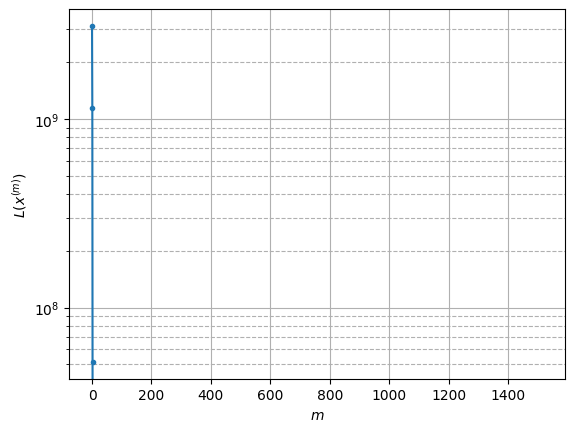

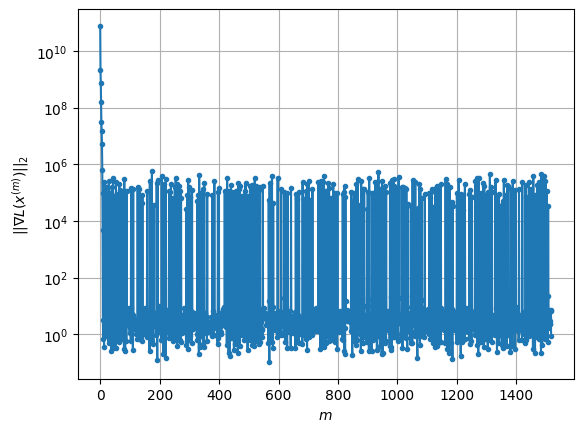

Windows:  79%|███████▉  | 235/296 [42:21<11:16, 11.09s/it]

Before applying the algorithm
Cost function: -23635231.638613332
Gradient norm: 303003.5894708715
Global relative error: 1.0611199838371808
Position relative errors: 0.00827313549630147 m, 0.42684206651564843 m, 0.8136887670406822 m, 0.5306790527474119 m

Iteration 1
Cost function: -23635231.868697766 (-0.00%)
Gradient norm: 7.000075225981442 (-100.00%)
Global relative error: 1.1055974619231776 (4.19%)
Position relative errors: 0.008305615671249588 m, 0.3914922346768927 m, 0.9102608883982111 m, 0.49033934001630813 m

Iteration 2
Cost function: -23635231.86869722 (0.00%)
Gradient norm: 2.357383140995351 (-66.32%)
Global relative error: 1.105586772756772 (-0.00%)
Position relative errors: 0.008305615557548001 m, 0.3914875831968545 m, 0.9102520921280192 m, 0.4903352816447009 m

Iteration 3
Cost function: -23635231.86869739 (-0.00%)
Gradient norm: 1.2343060250464568 (-47.64%)
Global relative error: 1.1055867594095263 (-0.00%)
Position relative errors: 0.008305615277198935 m, 0.391487570050

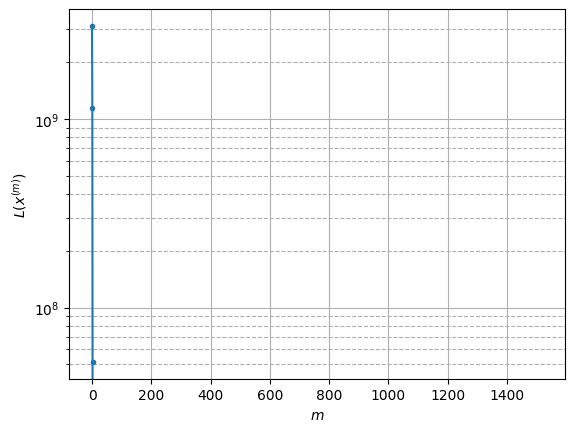

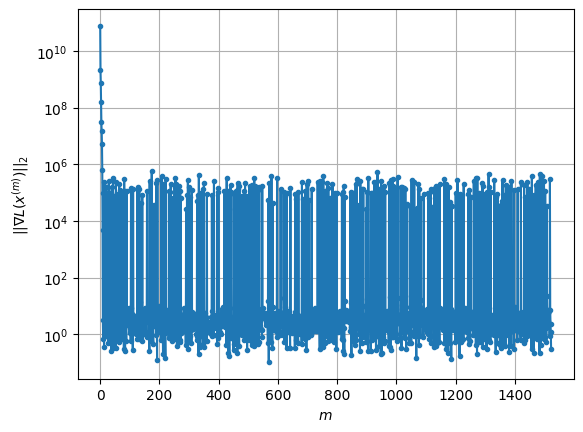

Windows:  80%|███████▉  | 236/296 [42:29<10:17, 10.29s/it]

Before applying the algorithm
Cost function: -23635229.214488093
Gradient norm: 29045.30989294687
Global relative error: 1.060818506007519
Position relative errors: 0.006450917650082761 m, 0.4022693481020163 m, 0.8547466580958095 m, 0.48257508605688554 m

Iteration 1
Cost function: -23635229.781982232 (-0.00%)
Gradient norm: 16.93380092214449 (-99.94%)
Global relative error: 1.0592842741603858 (-0.14%)
Position relative errors: 0.009131390488754674 m, 0.5900506776390896 m, 0.6750317044726415 m, 0.5640643054333365 m

Iteration 2
Cost function: -23635229.781982742 (-0.00%)
Gradient norm: 1.0486281145367713 (-93.81%)
Global relative error: 1.0593977259940455 (0.01%)
Position relative errors: 0.009131395160909907 m, 0.590303753040574 m, 0.6750498475092838 m, 0.5639908648437325 m

Iteration 3
Cost function: -23635229.7819824 (0.00%)
Gradient norm: 1.7203400003037745 (64.06%)
Global relative error: 1.0593977352195691 (0.00%)
Position relative errors: 0.00913138964990956 m, 0.5903037464866157

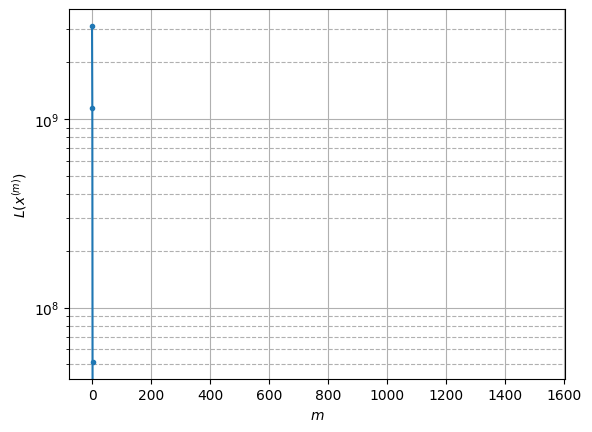

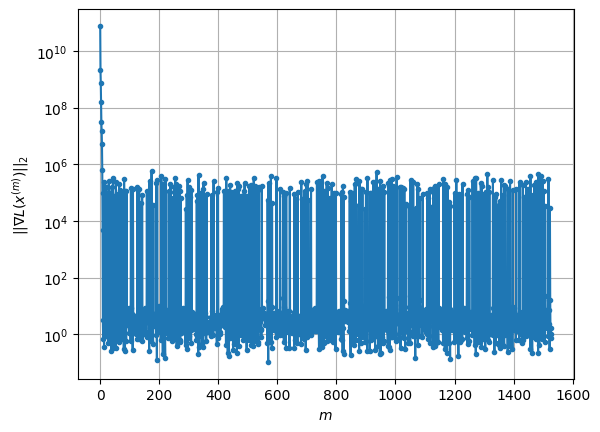

Windows:  80%|████████  | 237/296 [42:38<09:35,  9.75s/it]

Before applying the algorithm
Cost function: -23635230.133466132
Gradient norm: 88149.88533105089
Global relative error: 1.0665941496247238
Position relative errors: 0.007253986402502894 m, 0.6413447469384881 m, 0.6395911058610065 m, 0.5631758533038423 m

Iteration 1
Cost function: -23635230.384824738 (-0.00%)
Gradient norm: 2.6166714760733707 (-100.00%)
Global relative error: 1.031844093252886 (-3.26%)
Position relative errors: 0.0164416275056831 m, 0.6286629981355373 m, 0.6373749057984425 m, 0.5128001609377382 m

Iteration 2
Cost function: -23635230.384824578 (0.00%)
Gradient norm: 2.1300240704465176 (-18.60%)
Global relative error: 1.031840934068615 (-0.00%)
Position relative errors: 0.01644162322506729 m, 0.6286567746803765 m, 0.6373743416351029 m, 0.5128021350226347 m

STOP on Iteration 3
Cost function = -23635230.384824667 (-0.00%)
Gradient norm = 0.8380042653704937 (-60.66%)
Global relative error = 1.031840924695064 (-0.00%)
Final position relative errors: 0.01644162866479976 m,

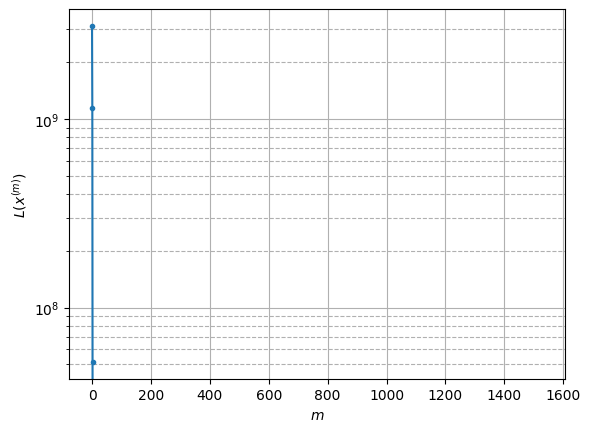

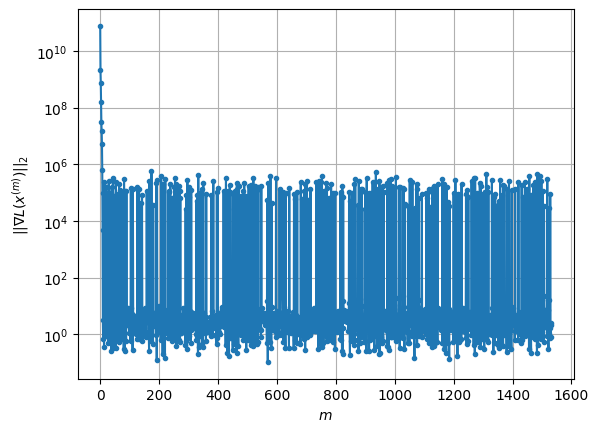

Windows:  80%|████████  | 238/296 [42:45<08:35,  8.89s/it]

Before applying the algorithm
Cost function: -23635226.088171616
Gradient norm: 76907.9402248228
Global relative error: 1.0457157303067195
Position relative errors: 0.014886298988910472 m, 0.6759488430064136 m, 0.6108786038205739 m, 0.5130462132571962 m

Iteration 1
Cost function: -23635226.695293587 (-0.00%)
Gradient norm: 5.740513671009346 (-99.99%)
Global relative error: 1.230762758161619 (17.70%)
Position relative errors: 0.019339309658363057 m, 0.9859725024430591 m, 0.5840335209448969 m, 0.4485118254442698 m

Iteration 2
Cost function: -23635226.695293803 (-0.00%)
Gradient norm: 3.32069097351106 (-42.15%)
Global relative error: 1.2308986593248827 (0.01%)
Position relative errors: 0.019339310426926184 m, 0.9861246202960959 m, 0.5841115814252762 m, 0.448448685101434 m

Iteration 3
Cost function: -23635226.69529394 (-0.00%)
Gradient norm: 2.523352923851314 (-24.01%)
Global relative error: 1.2308986862366524 (0.00%)
Position relative errors: 0.019339310898583432 m, 0.9861246464038077 

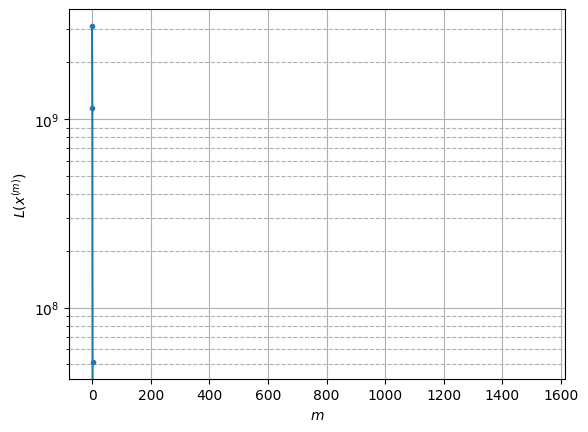

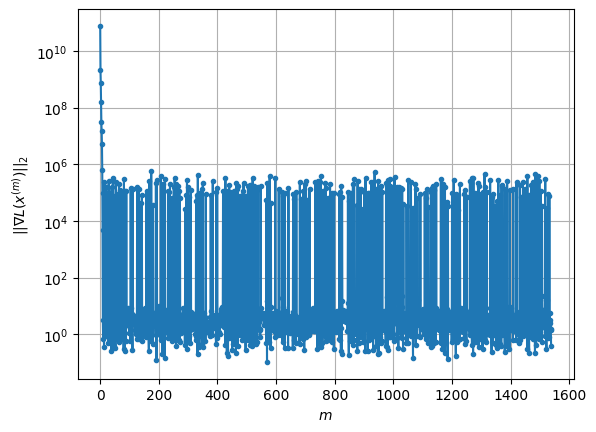

Windows:  81%|████████  | 239/296 [42:57<09:21,  9.84s/it]

Before applying the algorithm
Cost function: -23635230.74306051
Gradient norm: 137391.6864801606
Global relative error: 1.2565032028273484
Position relative errors: 0.018206506460323894 m, 1.0377175029054475 m, 0.5368762227231785 m, 0.4619221444822126 m

Iteration 1
Cost function: -23635230.819727186 (-0.00%)
Gradient norm: 2.805229130118116 (-100.00%)
Global relative error: 1.355658180994851 (7.89%)
Position relative errors: 0.017206903453205545 m, 1.1340282678788551 m, 0.5760604361222976 m, 0.4686621735857781 m

Iteration 2
Cost function: -23635230.8197269 (0.00%)
Gradient norm: 1.030742790887357 (-63.26%)
Global relative error: 1.3556745334358862 (0.00%)
Position relative errors: 0.017206893262319046 m, 1.1340479328803608 m, 0.5760679948087134 m, 0.4686526004639261 m

Iteration 3
Cost function: -23635230.819726955 (-0.00%)
Gradient norm: 2.191137792965423 (112.58%)
Global relative error: 1.3556745216065502 (-0.00%)
Position relative errors: 0.017206898964821353 m, 1.1340479143548683

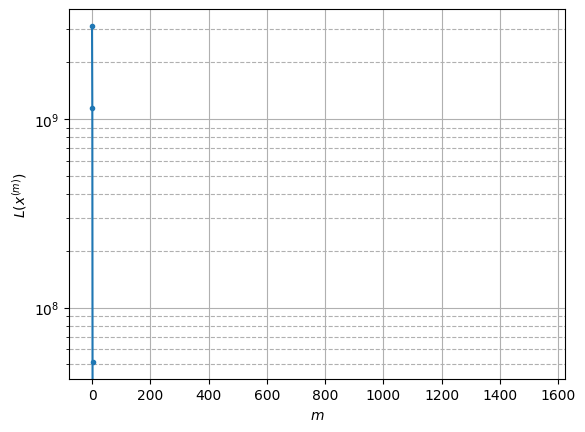

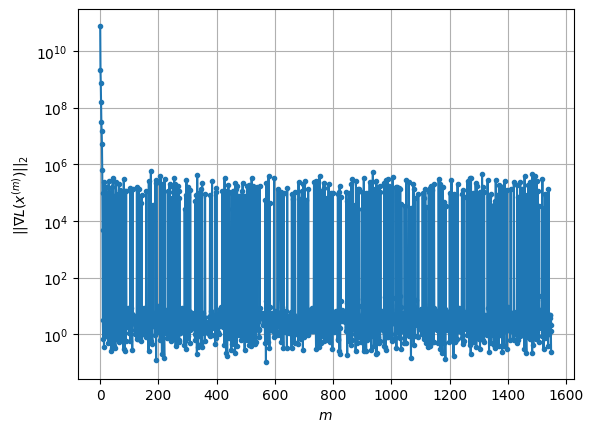

Windows:  81%|████████  | 240/296 [43:14<11:09, 11.95s/it]

Before applying the algorithm
Cost function: -23635219.989598267
Gradient norm: 109740.04709625135
Global relative error: 1.3849235766272165
Position relative errors: 0.016227989387059463 m, 1.1828614421105492 m, 0.5274834172259536 m, 0.4902520719873995 m

Iteration 1
Cost function: -23635220.452769436 (-0.00%)
Gradient norm: 11.572227692682972 (-99.99%)
Global relative error: 1.617082652553088 (16.76%)
Position relative errors: 0.029779069186516332 m, 1.5271483419203526 m, 0.44241518454538814 m, 0.2935190830622034 m

Iteration 2
Cost function: -23635220.452769715 (-0.00%)
Gradient norm: 2.0520384046687097 (-82.27%)
Global relative error: 1.6169667673960844 (-0.01%)
Position relative errors: 0.02977906900673502 m, 1.527030929331928 m, 0.4424113467502389 m, 0.29349730622007136 m

STOP on Iteration 3
Cost function = -23635220.452769596 (0.00%)
Gradient norm = 0.8713292492231426 (-57.54%)
Global relative error = 1.6169667846507805 (0.00%)
Final position relative errors: 0.0297790695230222

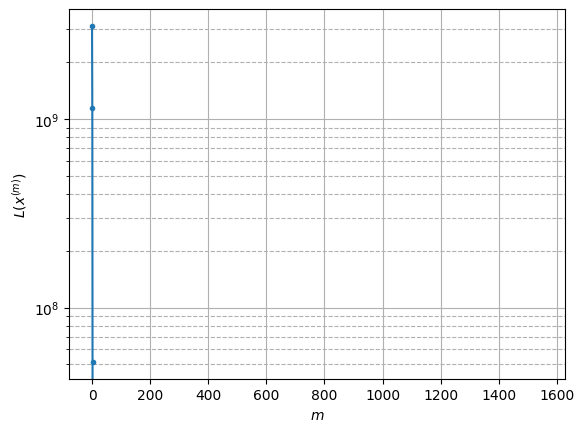

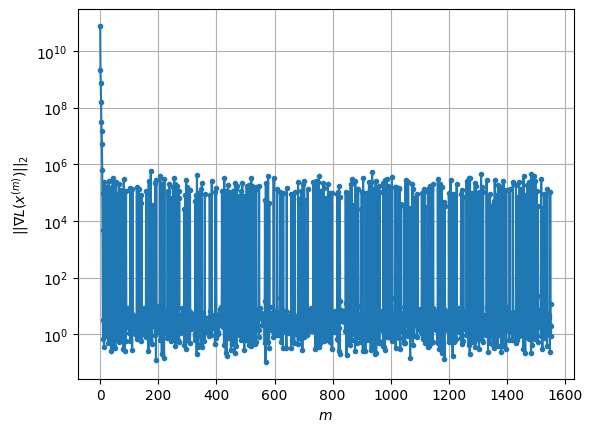

Windows:  81%|████████▏ | 241/296 [43:20<09:32, 10.41s/it]

Before applying the algorithm
Cost function: -23635223.061872885
Gradient norm: 238619.80021222524
Global relative error: 1.6398959221300542
Position relative errors: 0.028612590247923408 m, 1.5656698728449583 m, 0.40004649764778216 m, 0.27762908046454915 m

Iteration 1
Cost function: -23635224.545032952 (-0.00%)
Gradient norm: 37.990862540557295 (-99.98%)
Global relative error: 1.9012130936065677 (15.93%)
Position relative errors: 0.019747618311343054 m, 1.6634130897929877 m, 0.378729226823656 m, 0.8389520658434162 m

Iteration 2
Cost function: -23635224.545032766 (0.00%)
Gradient norm: 9.341361156258229 (-75.41%)
Global relative error: 1.901166278839485 (-0.00%)
Position relative errors: 0.019747619162630816 m, 1.663409807925032 m, 0.3787260586223505 m, 0.838853908184959 m

Iteration 3
Cost function: -23635224.545032825 (-0.00%)
Gradient norm: 6.973112145736928 (-25.35%)
Global relative error: 1.9011662853328677 (0.00%)
Position relative errors: 0.019747621241612657 m, 1.663409820185

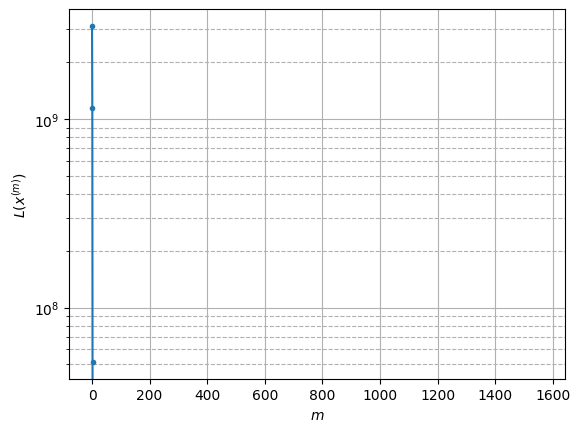

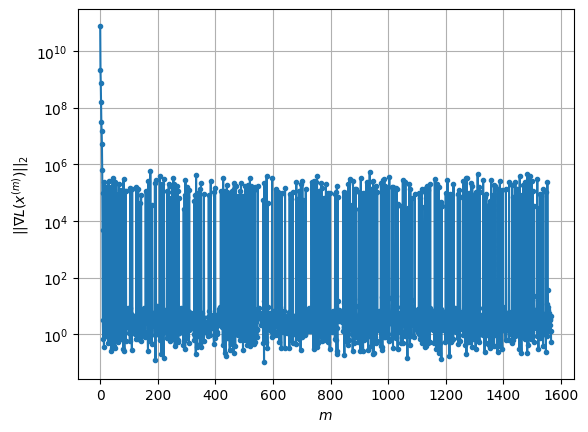

Windows:  82%|████████▏ | 242/296 [43:44<13:01, 14.48s/it]

Before applying the algorithm
Cost function: -23635229.119673233
Gradient norm: 164601.89870426845
Global relative error: 1.8947050878136182
Position relative errors: 0.019030416527086622 m, 1.6866862021495264 m, 0.34677948288217747 m, 0.7901753458190068 m

Iteration 1
Cost function: -23635229.60085327 (-0.00%)
Gradient norm: 3.8201788327926156 (-100.00%)
Global relative error: 1.7706208861712034 (-6.55%)
Position relative errors: 0.005144459003685551 m, 1.584290312988888 m, 0.33611937404419573 m, 0.7156239635576052 m

Iteration 2
Cost function: -23635229.600853026 (0.00%)
Gradient norm: 1.9540848805401763 (-48.85%)
Global relative error: 1.770635860590946 (0.00%)
Position relative errors: 0.0051444624083132025 m, 1.5843020309156992 m, 0.3361194182757603 m, 0.7156350511259729 m

Iteration 3
Cost function: -23635229.600853104 (-0.00%)
Gradient norm: 5.993199655738567 (206.70%)
Global relative error: 1.770635855795378 (-0.00%)
Position relative errors: 0.0051444585705857715 m, 1.58430202

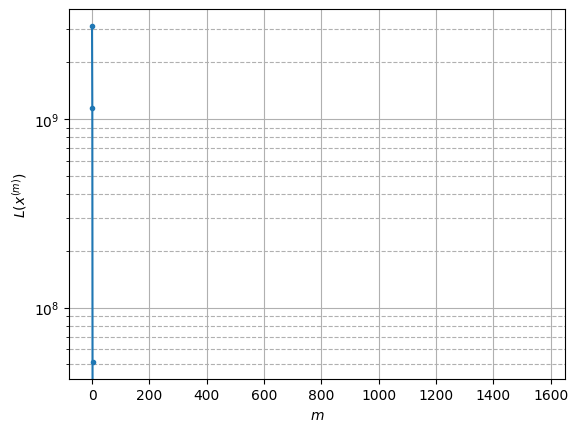

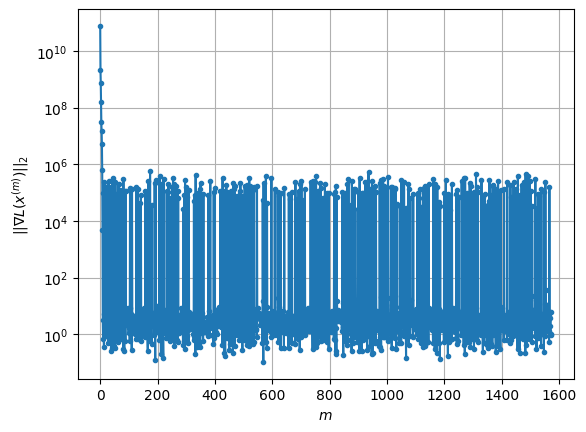

Windows:  82%|████████▏ | 243/296 [43:56<12:08, 13.75s/it]

Before applying the algorithm
Cost function: -23635232.77784694
Gradient norm: 92927.20831613902
Global relative error: 1.7567800969808962
Position relative errors: 0.006651554194212714 m, 1.5973143936991636 m, 0.32770846885261057 m, 0.6537765114587932 m

Iteration 1
Cost function: -23635233.036438446 (-0.00%)
Gradient norm: 5.540803883421287 (-99.99%)
Global relative error: 1.9919482144702703 (13.39%)
Position relative errors: 0.004742485276629619 m, 1.6930012935773016 m, 0.46527923157285506 m, 0.9407945615464288 m

Iteration 2
Cost function: -23635233.036438547 (-0.00%)
Gradient norm: 2.0151382445499317 (-63.63%)
Global relative error: 1.9919383537296285 (-0.00%)
Position relative errors: 0.004742485733183088 m, 1.6929925021508474 m, 0.46528655627371457 m, 0.9407858814051941 m

STOP on Iteration 3
Cost function = -23635233.036438618 (-0.00%)
Gradient norm = 0.23092971383697947 (-88.54%)
Global relative error = 1.991938336186886 (-0.00%)
Final position relative errors: 0.0047424853340

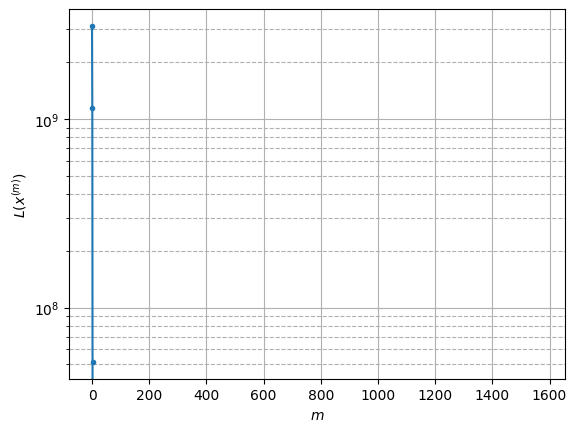

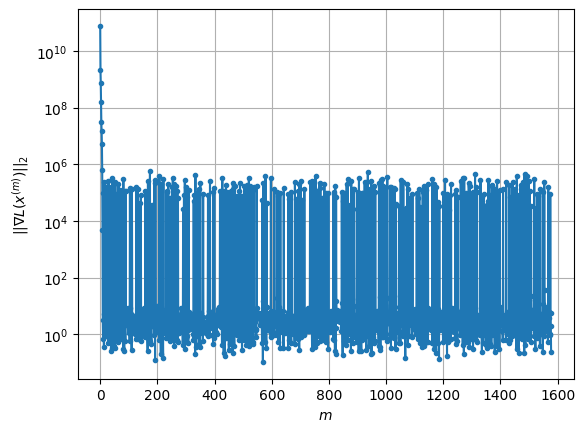

Windows:  82%|████████▏ | 244/296 [44:03<10:10, 11.75s/it]

Before applying the algorithm
Cost function: -23635225.83390118
Gradient norm: 180210.67730102726
Global relative error: 1.9603791776261137
Position relative errors: 0.006810557452307486 m, 1.6995556577872177 m, 0.4277236971453451 m, 0.8784078490738039 m

Iteration 1
Cost function: -23635226.340278942 (-0.00%)
Gradient norm: 7.462317215682981 (-100.00%)
Global relative error: 2.04034291159668 (4.08%)
Position relative errors: 0.009587406081618274 m, 1.6474149578414499 m, 0.5823255398419033 m, 1.053482088245392 m

STOP on Iteration 2
Cost function = -23635226.34027898 (-0.00%)
Gradient norm = 0.3479404589136224 (-95.34%)
Global relative error = 2.040355045225459 (0.00%)
Final position relative errors: 0.009587406565644916 m, 1.6474292879352501 m, 0.5823288063724139 m, 1.053481373449134 m



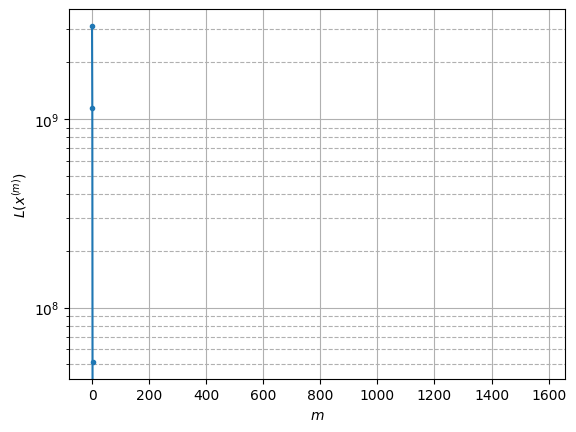

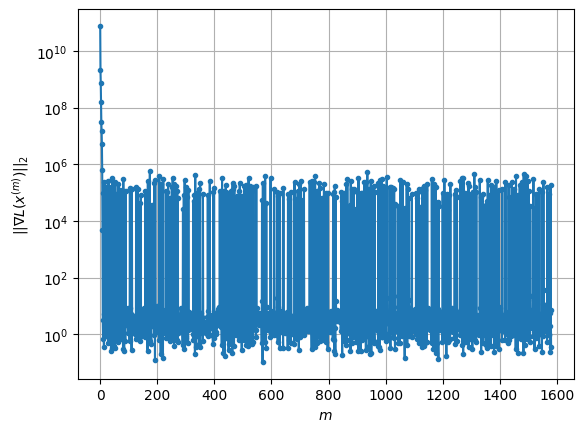

Windows:  83%|████████▎ | 245/296 [44:09<08:25,  9.91s/it]

Before applying the algorithm
Cost function: -23635235.95921816
Gradient norm: 88652.34558240192
Global relative error: 2.014929717357755
Position relative errors: 0.011675896844515872 m, 1.6588791473219153 m, 0.5676200360340182 m, 0.9928389216364456 m

Iteration 1
Cost function: -23635236.206354577 (-0.00%)
Gradient norm: 7.003573975178191 (-99.99%)
Global relative error: 1.610344611595537 (-20.08%)
Position relative errors: 0.012964451703400826 m, 1.3793668042802718 m, 0.573121967411999 m, 0.6015951291323632 m

Iteration 2
Cost function: -23635236.20635454 (0.00%)
Gradient norm: 5.725032028867675 (-18.26%)
Global relative error: 1.6102419077425238 (-0.01%)
Position relative errors: 0.012964450438794487 m, 1.379282976939814 m, 0.5731180701042848 m, 0.6015161264845368 m

Iteration 3
Cost function: -23635236.206354395 (0.00%)
Gradient norm: 2.302514334707887 (-59.78%)
Global relative error: 1.6102419586839705 (0.00%)
Position relative errors: 0.012964448573774403 m, 1.3792830094893551 m

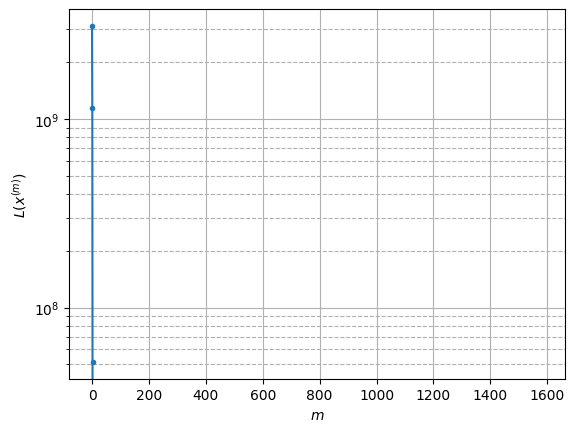

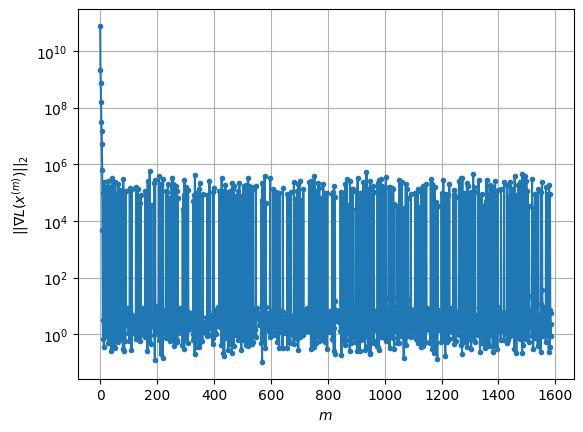

Windows:  83%|████████▎ | 246/296 [44:18<07:57,  9.56s/it]

Before applying the algorithm
Cost function: -23635230.664500903
Gradient norm: 240353.79940004586
Global relative error: 1.6116912444103841
Position relative errors: 0.014918446974267738 m, 1.397946037316517 m, 0.580942904862007 m, 0.5527883336422231 m

Iteration 1
Cost function: -23635231.112304136 (-0.00%)
Gradient norm: 6.65569630800767 (-100.00%)
Global relative error: 1.3326325947073474 (-17.31%)
Position relative errors: 0.015609712403860101 m, 1.0070313998912506 m, 0.8107728684586076 m, 0.3227974739572881 m

Iteration 2
Cost function: -23635231.112304036 (0.00%)
Gradient norm: 2.3659954983248954 (-64.45%)
Global relative error: 1.332701283458859 (0.01%)
Position relative errors: 0.015609711794717311 m, 1.0071578398828318 m, 0.8106985445836997 m, 0.32287323806848034 m

Iteration 3
Cost function: -23635231.11230401 (0.00%)
Gradient norm: 1.3075402364505577 (-44.74%)
Global relative error: 1.3327013010352733 (0.00%)
Position relative errors: 0.015609710147990473 m, 1.0071578638775

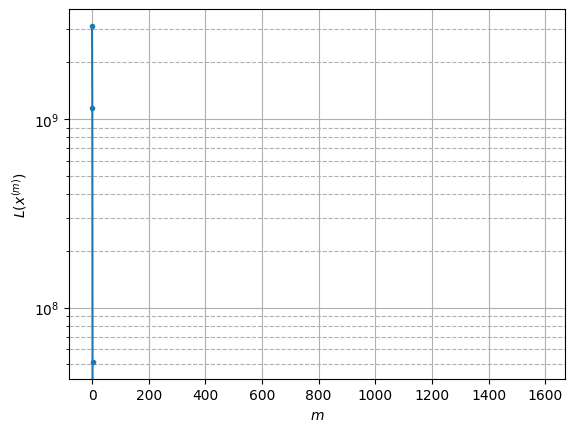

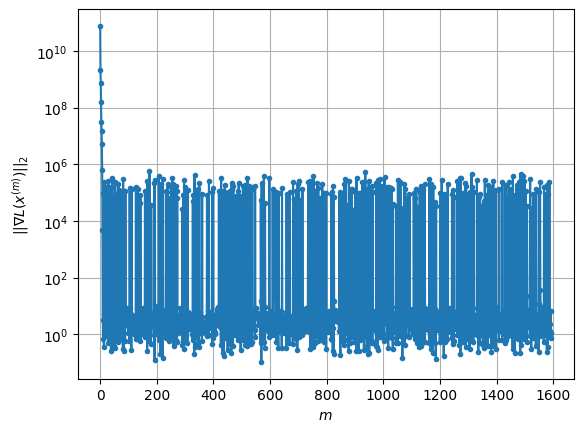

Windows:  83%|████████▎ | 247/296 [44:30<08:26, 10.35s/it]

Before applying the algorithm
Cost function: -23635233.338225592
Gradient norm: 169391.35669664323
Global relative error: 1.3543750255931042
Position relative errors: 0.016687665579266705 m, 1.0113886108664418 m, 0.8531273139919211 m, 0.288647438005492 m

Iteration 1
Cost function: -23635233.57624597 (-0.00%)
Gradient norm: 11.99940298742459 (-99.99%)
Global relative error: 1.8471491836426341 (36.38%)
Position relative errors: 0.020621849888802692 m, 1.5486884635648779 m, 0.5497151446209746 m, 0.84315438458427 m

STOP on Iteration 2
Cost function = -23635233.576245856 (0.00%)
Gradient norm = 0.45729023517785794 (-96.19%)
Global relative error = 1.8473132320937913 (0.01%)
Final position relative errors: 0.020621850007079383 m, 1.5488411030932312 m, 0.5496566066037091 m, 0.8432715677085626 m



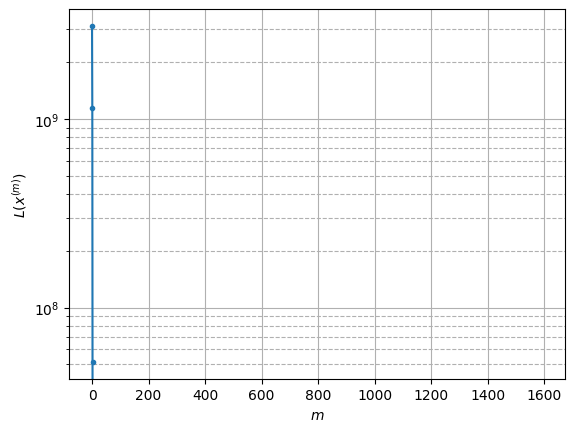

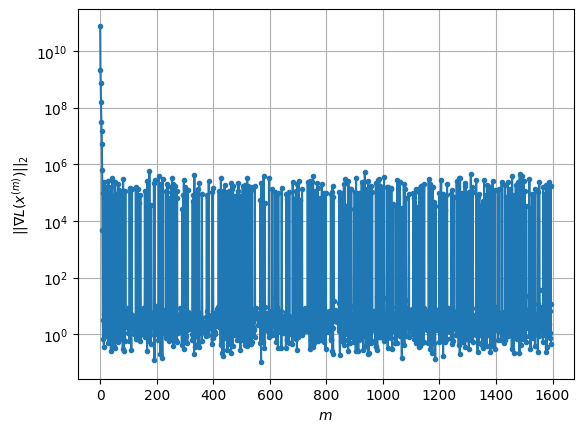

Windows:  84%|████████▍ | 248/296 [44:35<07:05,  8.86s/it]

Before applying the algorithm
Cost function: -23635222.864501454
Gradient norm: 221711.40982277362
Global relative error: 1.8206300444089056
Position relative errors: 0.021142347167292238 m, 1.5414984757562045 m, 0.5599317433076638 m, 0.7902548585026858 m

Iteration 1
Cost function: -23635223.068296984 (-0.00%)
Gradient norm: 10.622651733999133 (-100.00%)
Global relative error: 1.364581294585188 (-25.05%)
Position relative errors: 0.02261131626894255 m, 1.14448996344218 m, 0.5341247907304221 m, 0.516159459215264 m

Iteration 2
Cost function: -23635223.06829698 (0.00%)
Gradient norm: 5.552914741461071 (-47.73%)
Global relative error: 1.3645627315074529 (-0.00%)
Position relative errors: 0.022611317627345594 m, 1.1444845236577033 m, 0.534101865541718 m, 0.5161461682713179 m

Iteration 3
Cost function: -23635223.068297178 (-0.00%)
Gradient norm: 2.6941642640173162 (-51.48%)
Global relative error: 1.3645627556615747 (0.00%)
Position relative errors: 0.02261132763601323 m, 1.144484549743069

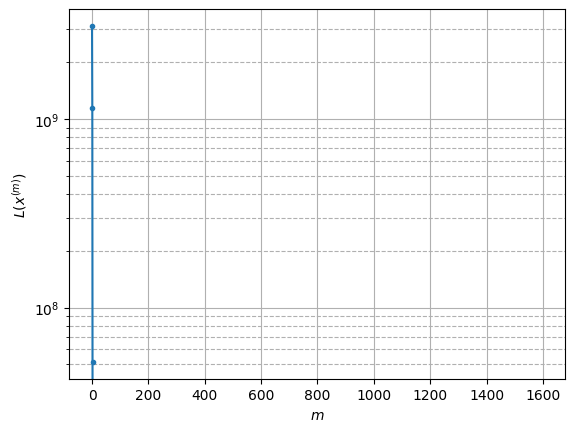

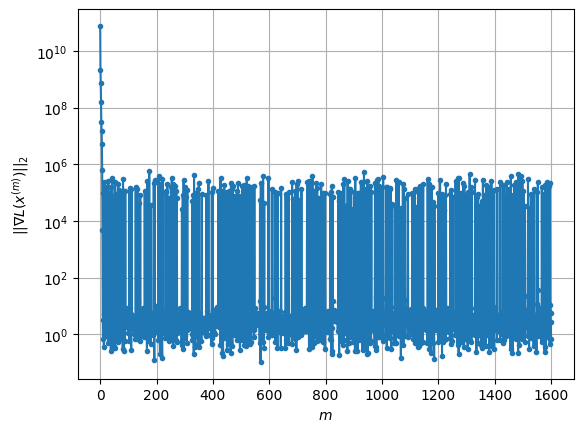

Windows:  84%|████████▍ | 249/296 [44:44<06:54,  8.81s/it]

Before applying the algorithm
Cost function: -23635229.12237828
Gradient norm: 80439.6776075788
Global relative error: 1.3264346458961278
Position relative errors: 0.023181061069720094 m, 1.1185100882934553 m, 0.5509190305480384 m, 0.4520079096974473 m

Iteration 1
Cost function: -23635229.226940382 (-0.00%)
Gradient norm: 4.887495654959708 (-99.99%)
Global relative error: 1.4193189583525767 (7.00%)
Position relative errors: 0.021486278110640338 m, 1.2036495935985474 m, 0.49019102047469104 m, 0.5700365289405797 m

Iteration 2
Cost function: -23635229.2269404 (-0.00%)
Gradient norm: 7.409568138227817 (51.60%)
Global relative error: 1.4193326451269763 (0.00%)
Position relative errors: 0.021486274830116336 m, 1.2036633786217603 m, 0.4901872722973065 m, 0.5700447230529251 m

Iteration 3
Cost function: -23635229.226940263 (0.00%)
Gradient norm: 1.358000023771869 (-81.67%)
Global relative error: 1.4193326929977934 (0.00%)
Position relative errors: 0.02148627933754529 m, 1.2036634144363088 m,

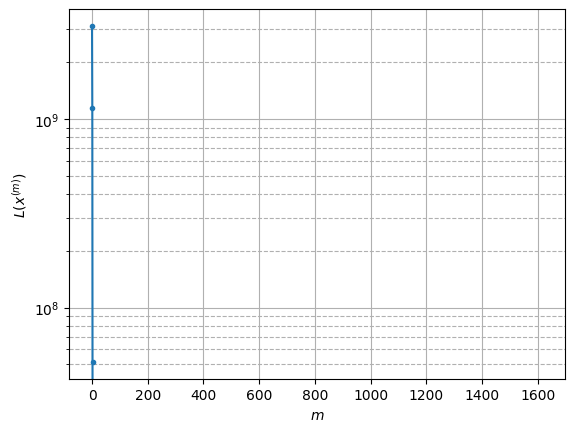

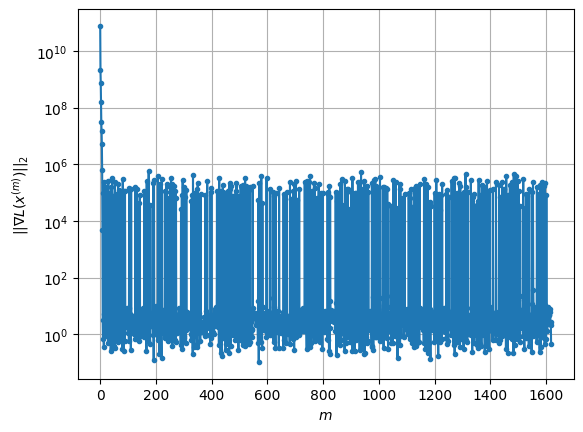

Windows:  84%|████████▍ | 250/296 [45:15<11:57, 15.60s/it]

Before applying the algorithm
Cost function: -23635232.516847882
Gradient norm: 312148.64909495634
Global relative error: 1.3812026088171772
Position relative errors: 0.022810014886076174 m, 1.1812074061926812 m, 0.5080656394866508 m, 0.5038007580462801 m

Iteration 1
Cost function: -23635232.812047057 (-0.00%)
Gradient norm: 6.186233998633157 (-100.00%)
Global relative error: 1.084576396362249 (-21.48%)
Position relative errors: 0.021045331613261817 m, 0.871567848451112 m, 0.5933746869009834 m, 0.25324993732812867 m

Iteration 2
Cost function: -23635232.812046863 (0.00%)
Gradient norm: 4.58837574934015 (-25.83%)
Global relative error: 1.0845778618117041 (0.00%)
Position relative errors: 0.021045328714226593 m, 0.8715791217489037 m, 0.5933619370650391 m, 0.25324728906883215 m

Iteration 3
Cost function: -23635232.812047105 (-0.00%)
Gradient norm: 1.3276599567824288 (-71.06%)
Global relative error: 1.0845778680784002 (0.00%)
Position relative errors: 0.021045326600045395 m, 0.8715791359

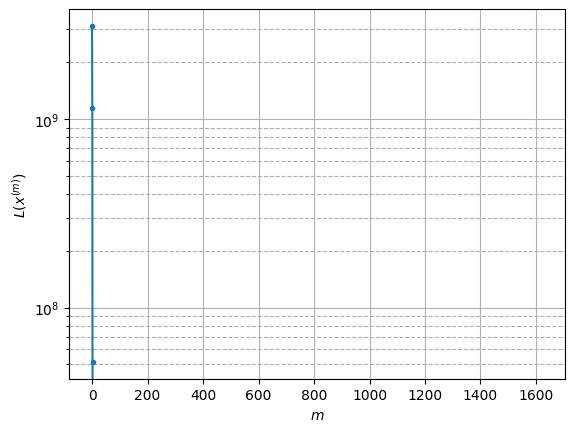

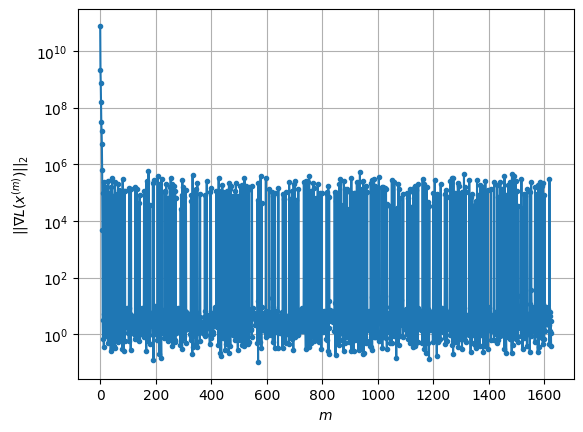

Windows:  85%|████████▍ | 251/296 [45:28<10:56, 14.58s/it]

Before applying the algorithm
Cost function: -23635228.759108
Gradient norm: 100543.29937996069
Global relative error: 1.0850203139949217
Position relative errors: 0.022288218307203875 m, 0.8416321473281613 m, 0.6343336237898407 m, 0.25699229506316157 m

Iteration 1
Cost function: -23635229.168244697 (-0.00%)
Gradient norm: 9.267449491711863 (-99.99%)
Global relative error: 1.1362803366153942 (4.72%)
Position relative errors: 0.014988442875310351 m, 0.5661002941209622 m, 0.9125552505910057 m, 0.37105231425873136 m

Iteration 2
Cost function: -23635229.16824487 (-0.00%)
Gradient norm: 3.6637419866127905 (-60.47%)
Global relative error: 1.1362609289729533 (-0.00%)
Position relative errors: 0.014988447368754236 m, 0.5661352402099349 m, 0.9125222524715263 m, 0.3710207167434046 m

Iteration 3
Cost function: -23635229.168244775 (0.00%)
Gradient norm: 1.6265247456599459 (-55.60%)
Global relative error: 1.1362609824907015 (0.00%)
Position relative errors: 0.014988447244700755 m, 0.566135248878

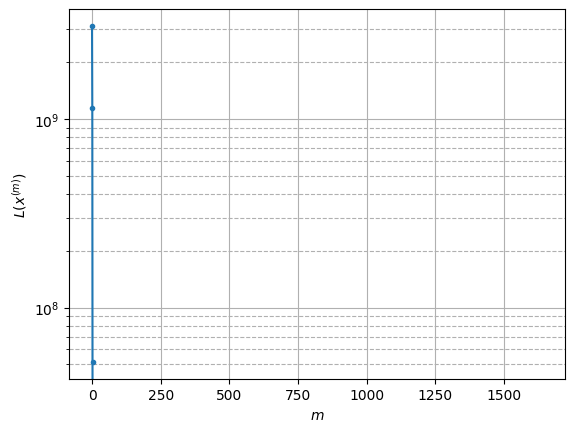

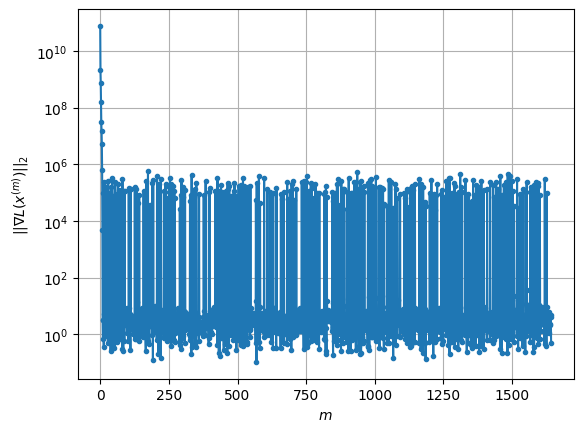

Windows:  85%|████████▌ | 252/296 [45:56<13:48, 18.84s/it]

Before applying the algorithm
Cost function: -23635218.801994927
Gradient norm: 419629.2151279085
Global relative error: 1.1661989037210152
Position relative errors: 0.01611719448410932 m, 0.5377057190113327 m, 0.9424629202155204 m, 0.42707671564931393 m

Iteration 1
Cost function: -23635219.359867714 (-0.00%)
Gradient norm: 5.279041752950645 (-100.00%)
Global relative error: 1.278798363605479 (9.66%)
Position relative errors: 0.02938848120270889 m, 0.2179024247413426 m, 1.0942417573898047 m, 0.6241908031247955 m

STOP on Iteration 2
Cost function = -23635219.359867666 (0.00%)
Gradient norm = 0.7127732738404051 (-86.50%)
Global relative error = 1.2787841386525287 (-0.00%)
Final position relative errors: 0.029388477776016306 m, 0.21792887487401047 m, 1.094229842963625 m, 0.6241733124752741 m



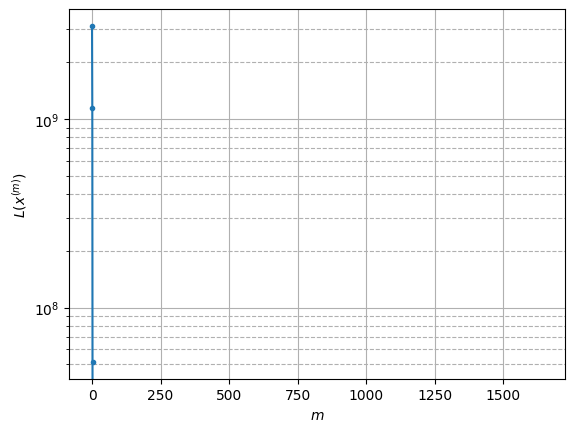

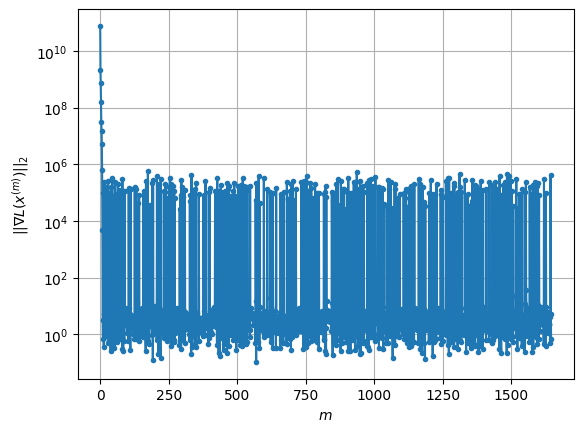

Windows:  85%|████████▌ | 253/296 [46:02<10:37, 14.82s/it]

Before applying the algorithm
Cost function: -23635215.90739905
Gradient norm: 198526.6225734563
Global relative error: 1.306104155793868
Position relative errors: 0.029145719413792452 m, 0.1975784273507901 m, 1.1028270313447475 m, 0.6706661341957652 m

Iteration 1
Cost function: -23635216.138359513 (-0.00%)
Gradient norm: 5.501835566886871 (-100.00%)
Global relative error: 1.0399480711754399 (-20.38%)
Position relative errors: 0.031507070311187484 m, 0.31573271252568497 m, 0.8877546887421394 m, 0.4389794553674898 m

Iteration 2
Cost function: -23635216.138359696 (-0.00%)
Gradient norm: 4.579347571978091 (-16.77%)
Global relative error: 1.0399237587452848 (-0.00%)
Position relative errors: 0.031507068566040713 m, 0.31575275966507843 m, 0.8877282301182964 m, 0.43896094704066285 m

Iteration 3
Cost function: -23635216.138359644 (0.00%)
Gradient norm: 3.2249052361434756 (-29.58%)
Global relative error: 1.0399237956248957 (0.00%)
Position relative errors: 0.031507063347660895 m, 0.31575276

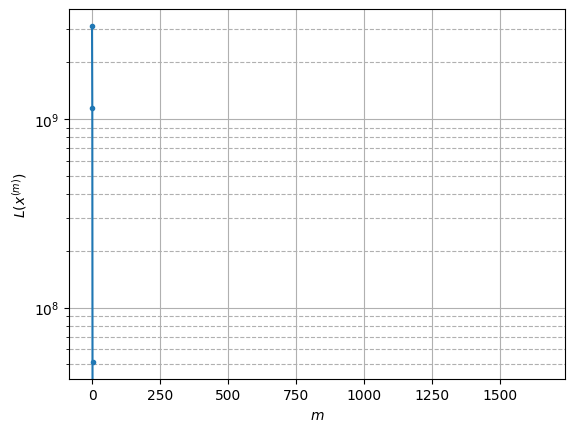

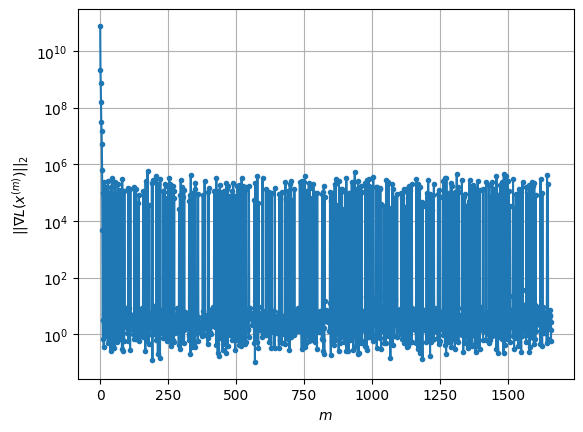

Windows:  86%|████████▌ | 254/296 [46:24<11:59, 17.14s/it]

Before applying the algorithm
Cost function: -23635221.09307947
Gradient norm: 124933.655056325
Global relative error: 1.0415043316673815
Position relative errors: 0.031259561661793035 m, 0.2876984168189084 m, 0.8776559685497217 m, 0.4803154562855973 m

Iteration 1
Cost function: -23635222.191728298 (-0.00%)
Gradient norm: 48.881503307063234 (-99.96%)
Global relative error: 1.0012463332760326 (-3.87%)
Position relative errors: 0.026965530688716603 m, 0.4928791820627264 m, 0.6278511846112059 m, 0.6038513420776725 m

Iteration 2
Cost function: -23635222.191728253 (0.00%)
Gradient norm: 5.678246167316802 (-88.38%)
Global relative error: 1.0012626715499147 (0.00%)
Position relative errors: 0.02696552660346343 m, 0.49299336351805406 m, 0.6278292790802068 m, 0.6038079985232151 m

Iteration 3
Cost function: -23635222.1917282 (0.00%)
Gradient norm: 4.931821347921534 (-13.15%)
Global relative error: 1.0012626255690735 (-0.00%)
Position relative errors: 0.026965530693994943 m, 0.4929933574256843

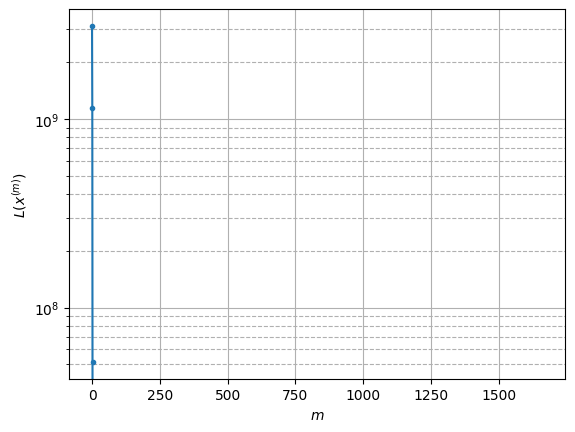

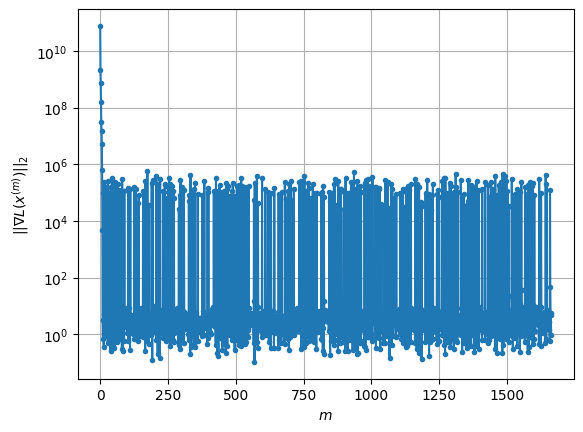

Windows:  86%|████████▌ | 255/296 [46:33<10:01, 14.67s/it]

Before applying the algorithm
Cost function: -23635219.762641363
Gradient norm: 122113.77014084533
Global relative error: 0.9900585472788828
Position relative errors: 0.02742506481506566 m, 0.4252565931440305 m, 0.5833050211208162 m, 0.6770319152299457 m

Iteration 1
Cost function: -23635220.534063343 (-0.00%)
Gradient norm: 10.352200033557947 (-99.99%)
Global relative error: 1.161025743754871 (17.27%)
Position relative errors: 0.024441609347045586 m, 0.5476789663712978 m, 0.8898187969692766 m, 0.5056182014019291 m

Iteration 2
Cost function: -23635220.534063246 (0.00%)
Gradient norm: 4.15623593390653 (-59.85%)
Global relative error: 1.160921064828696 (-0.01%)
Position relative errors: 0.024441608607987293 m, 0.5476899708484932 m, 0.8896901290376656 m, 0.5055923444747084 m

Iteration 3
Cost function: -23635220.53406357 (-0.00%)
Gradient norm: 2.067136290141624 (-50.26%)
Global relative error: 1.1609210264320764 (-0.00%)
Position relative errors: 0.02444160937451565 m, 0.547689977566032

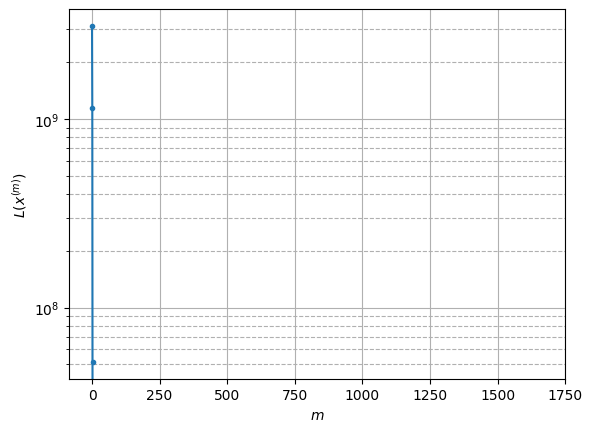

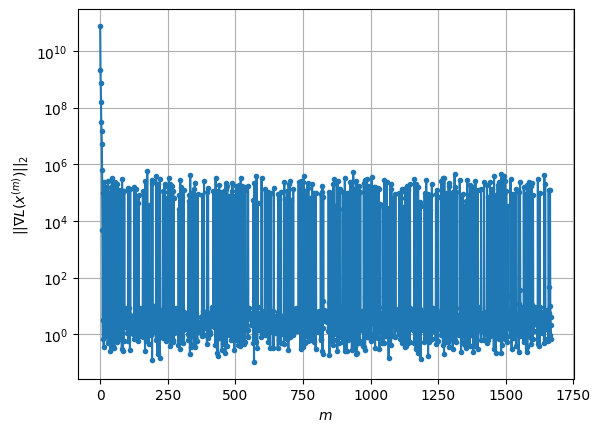

Windows:  86%|████████▋ | 256/296 [46:42<08:38, 12.96s/it]

Before applying the algorithm
Cost function: -23635221.377040286
Gradient norm: 306436.2899888923
Global relative error: 1.14170770217902
Position relative errors: 0.025569016652087356 m, 0.46702276926273134 m, 0.8690928205566788 m, 0.5739391797600834 m

Iteration 1
Cost function: -23635222.034909878 (-0.00%)
Gradient norm: 34.7619649666143 (-99.99%)
Global relative error: 1.0830810996006854 (-5.13%)
Position relative errors: 0.02755560172856792 m, 0.23844136769371127 m, 0.9264895043062112 m, 0.5070181467960216 m

Iteration 2
Cost function: -23635222.0349107 (-0.00%)
Gradient norm: 1.1442600729862804 (-96.71%)
Global relative error: 1.0830153829548872 (-0.01%)
Position relative errors: 0.027555602862644957 m, 0.2385708902294638 m, 0.926438119981925 m, 0.5069107218519161 m

Iteration 3
Cost function: -23635222.03491046 (0.00%)
Gradient norm: 3.2015570811071368 (179.79%)
Global relative error: 1.083015434778 (0.00%)
Position relative errors: 0.027555600699790416 m, 0.23857086468218497 m,

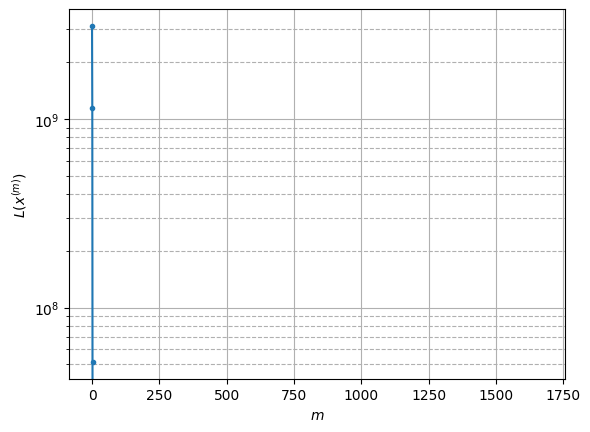

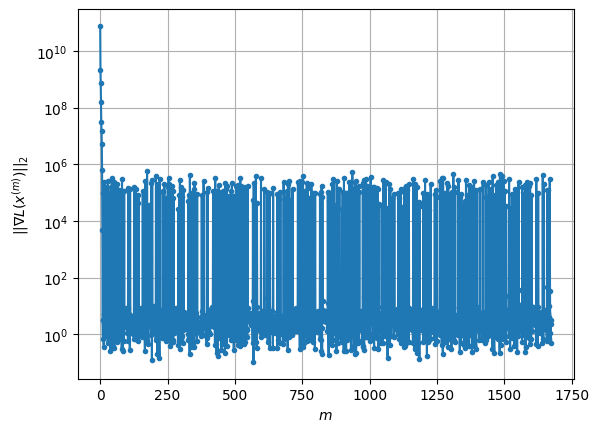

Windows:  87%|████████▋ | 257/296 [46:53<07:59, 12.28s/it]

Before applying the algorithm
Cost function: -23635220.597182415
Gradient norm: 30145.183322452416
Global relative error: 1.0693497352699661
Position relative errors: 0.028483992709693283 m, 0.20746843553397834 m, 0.9044321974958737 m, 0.5307125982113178 m

Iteration 1
Cost function: -23635221.036537137 (-0.00%)
Gradient norm: 12.31413191866561 (-99.96%)
Global relative error: 0.936786370879548 (-12.40%)
Position relative errors: 0.03065585152803389 m, 0.2545329784980775 m, 0.6933793082788394 m, 0.5753837687569889 m

Iteration 2
Cost function: -23635221.036536727 (0.00%)
Gradient norm: 3.806586960245526 (-69.09%)
Global relative error: 0.9367972324272156 (0.00%)
Position relative errors: 0.030655850394373445 m, 0.25452995202892026 m, 0.6933889719504492 m, 0.5753911460172785 m

STOP on Iteration 3
Cost function = -23635221.036536798 (-0.00%)
Gradient norm = 0.8353314401948196 (-78.06%)
Global relative error = 0.9367972190393449 (-0.00%)
Final position relative errors: 0.0306558519541210

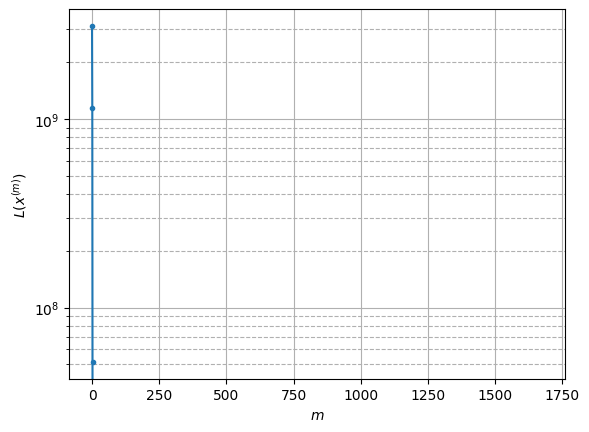

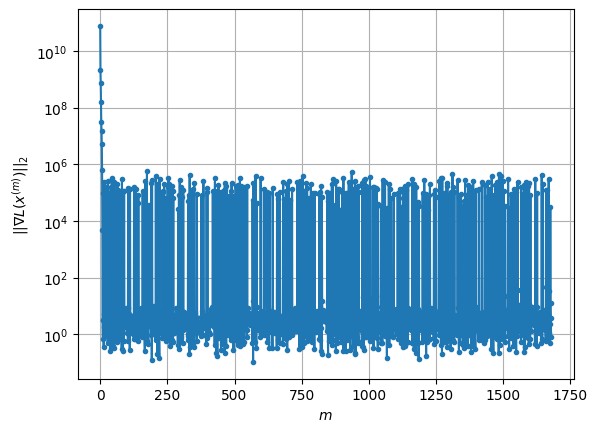

Windows:  87%|████████▋ | 258/296 [47:00<06:48, 10.74s/it]

Before applying the algorithm
Cost function: -23635216.661071043
Gradient norm: 194770.98169094857
Global relative error: 0.9285007707865404
Position relative errors: 0.03151716997067787 m, 0.22212490840691476 m, 0.6901708259095533 m, 0.5791757528193989 m

Iteration 1
Cost function: -23635217.06467351 (-0.00%)
Gradient norm: 21.882712043206723 (-99.99%)
Global relative error: 0.8766113765476954 (-5.59%)
Position relative errors: 0.03097485900861614 m, 0.1893231665167307 m, 0.6239978229657646 m, 0.5850394782617663 m

Iteration 2
Cost function: -23635217.06467349 (0.00%)
Gradient norm: 1.8669274194931467 (-91.47%)
Global relative error: 0.8765644088958893 (-0.01%)
Position relative errors: 0.030974860080461436 m, 0.1892479020660029 m, 0.6239793463747731 m, 0.5850131620878415 m

Iteration 3
Cost function: -23635217.064673536 (-0.00%)
Gradient norm: 4.892362258691826 (162.05%)
Global relative error: 0.8765644125024006 (0.00%)
Position relative errors: 0.030974859671629634 m, 0.189247904161

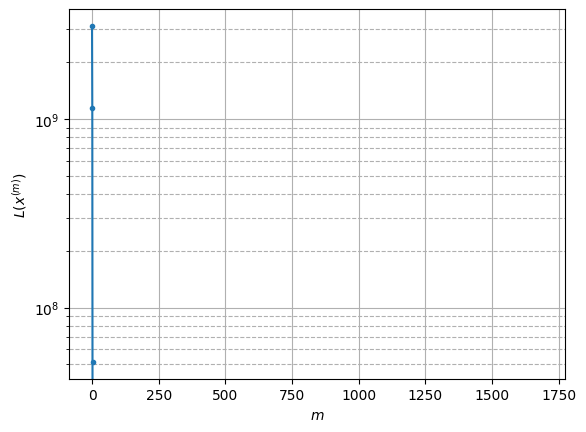

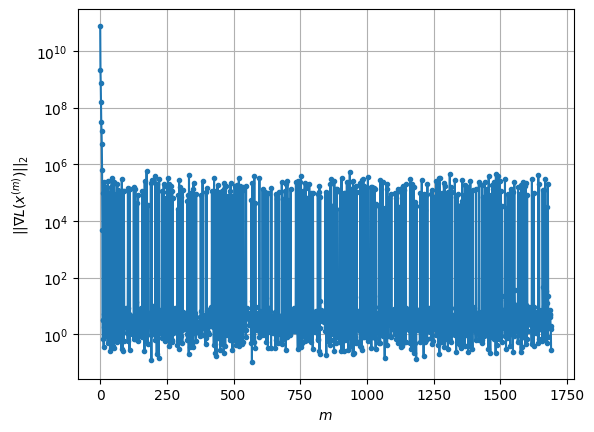

Windows:  88%|████████▊ | 259/296 [47:22<08:45, 14.20s/it]

Before applying the algorithm
Cost function: -23635217.432559863
Gradient norm: 281445.1625957681
Global relative error: 0.8671127108569915
Position relative errors: 0.0317489918687577 m, 0.19990076265517273 m, 0.6294441997289053 m, 0.5609953647319192 m

Iteration 1
Cost function: -23635218.171531145 (-0.00%)
Gradient norm: 13.310546533569187 (-100.00%)
Global relative error: 0.8052894554124242 (-7.13%)
Position relative errors: 0.03602001686630103 m, 0.09281619475199154 m, 0.5243463602257149 m, 0.6030252418299283 m

Iteration 2
Cost function: -23635218.171531294 (-0.00%)
Gradient norm: 7.041415054957682 (-47.10%)
Global relative error: 0.8052845862527388 (-0.00%)
Position relative errors: 0.03602001456062413 m, 0.09286636565157295 m, 0.5243467801433744 m, 0.6030106499599286 m

STOP on Iteration 3
Cost function = -23635218.171531327 (-0.00%)
Gradient norm = 0.6326317375024447 (-91.02%)
Global relative error = 0.8052845632885217 (-0.00%)
Final position relative errors: 0.036020013534680

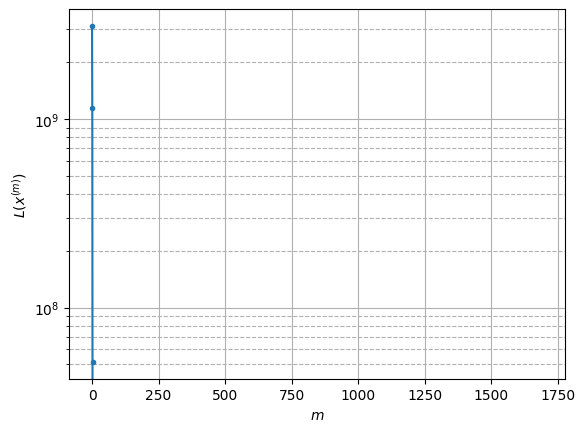

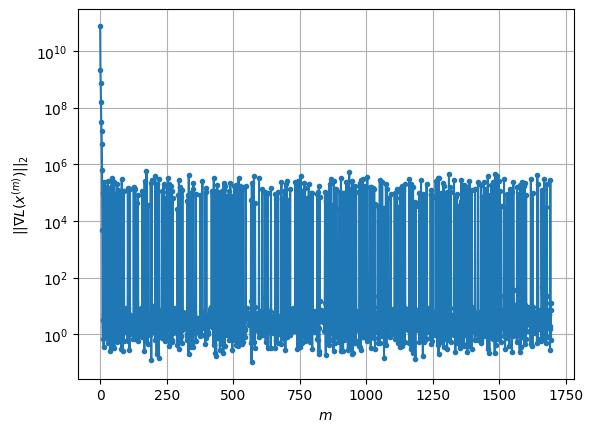

Windows:  88%|████████▊ | 260/296 [47:30<07:15, 12.11s/it]

Before applying the algorithm
Cost function: -23635219.7801873
Gradient norm: 88537.48921687265
Global relative error: 0.7775018244200053
Position relative errors: 0.03639829642108055 m, 0.09044912831741292 m, 0.4991108232753108 m, 0.5881252130464955 m

Iteration 1
Cost function: -23635220.173092548 (-0.00%)
Gradient norm: 7.21611635930496 (-99.99%)
Global relative error: 0.7950375946645373 (2.26%)
Position relative errors: 0.029919244105660426 m, 0.1471508863990432 m, 0.5510572540194476 m, 0.5530556871376053 m

Iteration 2
Cost function: -23635220.173092753 (-0.00%)
Gradient norm: 3.07271613141348 (-57.42%)
Global relative error: 0.7950106213298088 (-0.00%)
Position relative errors: 0.02991924849672222 m, 0.14717427241736838 m, 0.5510390294189114 m, 0.5530288473929531 m

Iteration 3
Cost function: -23635220.17309269 (0.00%)
Gradient norm: 2.196128578710741 (-28.53%)
Global relative error: 0.7950106511961289 (0.00%)
Position relative errors: 0.02991924451962839 m, 0.14717423888496337 m

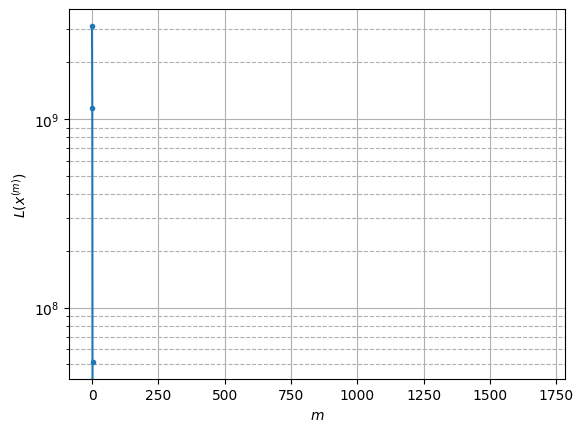

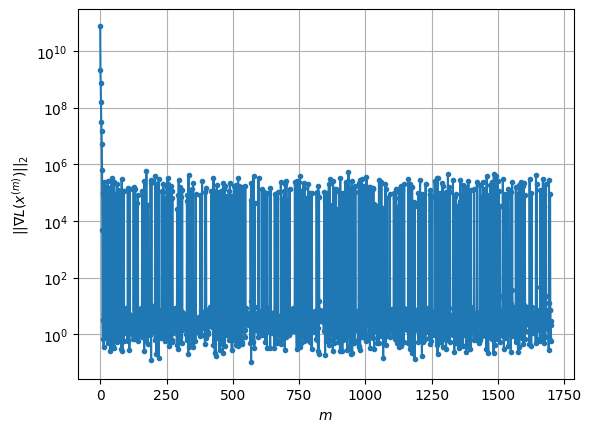

Windows:  88%|████████▊ | 261/296 [47:39<06:32, 11.23s/it]

Before applying the algorithm
Cost function: -23635217.68584628
Gradient norm: 133897.6150448126
Global relative error: 0.7255019938598717
Position relative errors: 0.03005376695692438 m, 0.15821230919046103 m, 0.5007073278906427 m, 0.4997092043040997 m

Iteration 1
Cost function: -23635217.956530478 (-0.00%)
Gradient norm: 2.44259225551511 (-100.00%)
Global relative error: 0.8269274218611884 (13.98%)
Position relative errors: 0.024084602612228608 m, 0.14872007677285087 m, 0.5526669620160451 m, 0.5963798969774222 m

Iteration 2
Cost function: -23635217.95653027 (0.00%)
Gradient norm: 1.7818439605695597 (-27.05%)
Global relative error: 0.826925093884286 (-0.00%)
Position relative errors: 0.024084604569329118 m, 0.14872719736579626 m, 0.5526644630051627 m, 0.5963772090469277 m

Iteration 3
Cost function: -23635217.95653038 (-0.00%)
Gradient norm: 3.6257926459642857 (103.49%)
Global relative error: 0.8269250879140855 (-0.00%)
Position relative errors: 0.024084602259307253 m, 0.14872716470

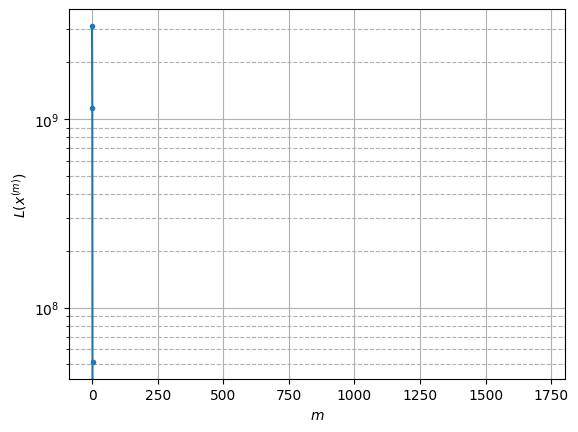

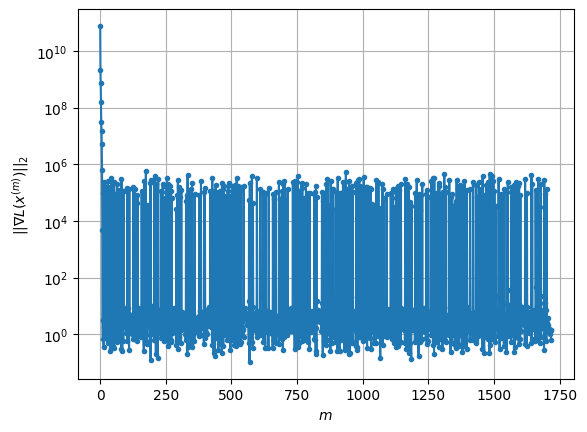

Windows:  89%|████████▊ | 262/296 [48:10<09:41, 17.11s/it]

Before applying the algorithm
Cost function: -23635214.127561603
Gradient norm: 177675.55246132272
Global relative error: 0.7585008238514834
Position relative errors: 0.023978182510379028 m, 0.15607221007686453 m, 0.5131830886022825 m, 0.535753231721185 m

Iteration 1
Cost function: -23635215.228382133 (-0.00%)
Gradient norm: 13.641304565751497 (-99.99%)
Global relative error: 0.8062412909730351 (6.29%)
Position relative errors: 0.029280735427699385 m, 0.26935835182410456 m, 0.5223788000559912 m, 0.551119901632567 m

Iteration 2
Cost function: -23635215.22838196 (0.00%)
Gradient norm: 9.302910705717306 (-31.80%)
Global relative error: 0.80620748798233 (-0.00%)
Position relative errors: 0.029280738515880766 m, 0.26945801072674497 m, 0.522360849246661 m, 0.5510387428276321 m

Iteration 3
Cost function: -23635215.228382044 (-0.00%)
Gradient norm: 5.131114381475373 (-44.84%)
Global relative error: 0.8062075338803864 (0.00%)
Position relative errors: 0.029280734463111958 m, 0.26945799856389

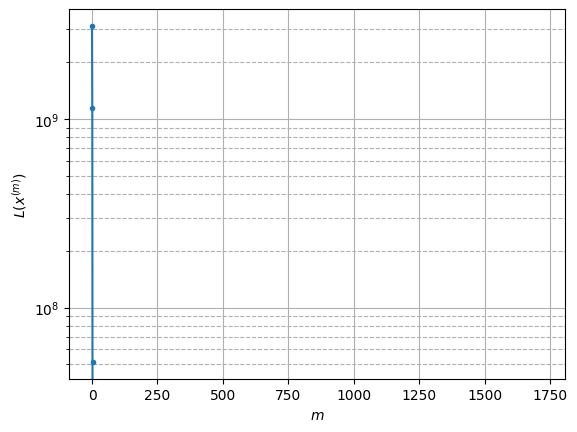

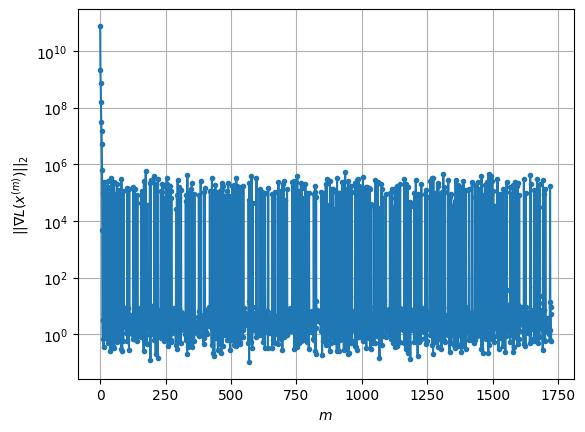

Windows:  89%|████████▉ | 263/296 [48:19<08:03, 14.66s/it]

Before applying the algorithm
Cost function: -23635205.23448924
Gradient norm: 471600.5657270371
Global relative error: 0.7685116553454302
Position relative errors: 0.029024073959345982 m, 0.2932477852099761 m, 0.48897216627911455 m, 0.5144693156532917 m

Iteration 1
Cost function: -23635205.91209072 (-0.00%)
Gradient norm: 17.126142475528457 (-100.00%)
Global relative error: 0.49877097983309215 (-35.10%)
Position relative errors: 0.027048212919927286 m, 0.3351344821142876 m, 0.2477466057343073 m, 0.27266632337638236 m

Iteration 2
Cost function: -23635205.91209088 (-0.00%)
Gradient norm: 2.7874634063975297 (-83.72%)
Global relative error: 0.4987928641699567 (0.00%)
Position relative errors: 0.02704821428381138 m, 0.33518445511854855 m, 0.24774666405934143 m, 0.272644875603907 m

Iteration 3
Cost function: -23635205.91209089 (-0.00%)
Gradient norm: 4.257880653609473 (52.75%)
Global relative error: 0.49879287515916704 (0.00%)
Position relative errors: 0.027048213477259737 m, 0.335184475

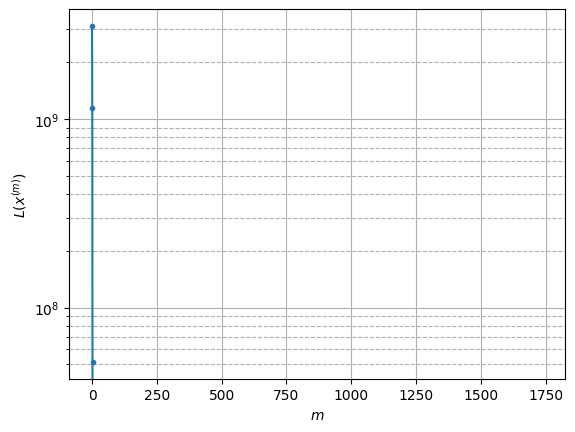

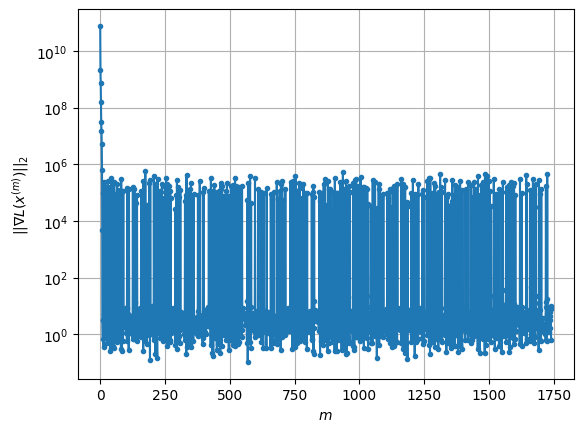

Windows:  89%|████████▉ | 264/296 [48:46<09:48, 18.40s/it]

Before applying the algorithm
Cost function: -23635207.736177407
Gradient norm: 236810.050114084
Global relative error: 0.5058659063387857
Position relative errors: 0.027238735989862334 m, 0.36112620821940544 m, 0.24627868145662177 m, 0.25316514989912764 m

Iteration 1
Cost function: -23635207.929275908 (-0.00%)
Gradient norm: 6.165105836709723 (-100.00%)
Global relative error: 0.5847844598957366 (15.60%)
Position relative errors: 0.027260511768744406 m, 0.503870199469154 m, 0.2761506541073224 m, 0.10528476452574456 m

Iteration 2
Cost function: -23635207.929276142 (-0.00%)
Gradient norm: 5.435315090774045 (-11.84%)
Global relative error: 0.5848381516454176 (0.01%)
Position relative errors: 0.02726051229473042 m, 0.5039040271835291 m, 0.2761979099793464 m, 0.1052971429186341 m

STOP on Iteration 3
Cost function = -23635207.929275922 (0.00%)
Gradient norm = 0.10917171407125065 (-97.99%)
Global relative error = 0.5848381568462677 (0.00%)
Final position relative errors: 0.0272605128340731

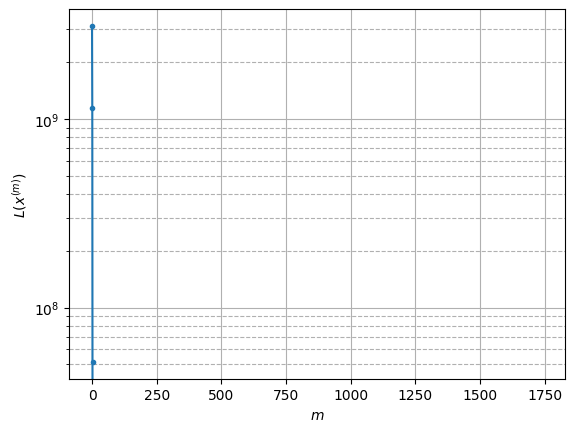

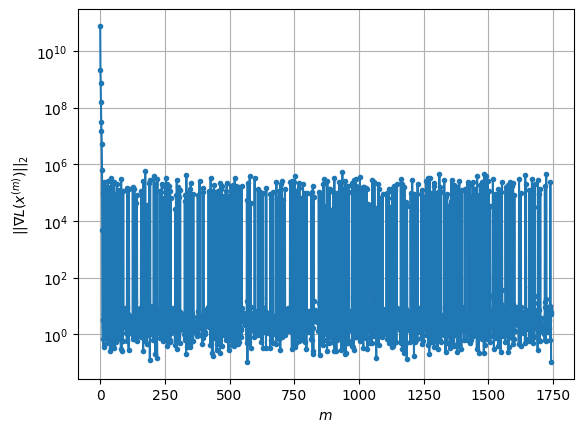

Windows:  90%|████████▉ | 265/296 [48:53<07:44, 15.00s/it]

Before applying the algorithm
Cost function: -23635202.13808652
Gradient norm: 133971.10786338974
Global relative error: 0.6102283408055891
Position relative errors: 0.027242244303285965 m, 0.5304482497569408 m, 0.2740574852577706 m, 0.12309829529439437 m

Iteration 1
Cost function: -23635203.109015968 (-0.00%)
Gradient norm: 15.94101370255793 (-99.99%)
Global relative error: 0.6522124340801903 (6.88%)
Position relative errors: 0.02539241826642101 m, 0.595644827887343 m, 0.23812444581521156 m, 0.1150620168565124 m

Iteration 2
Cost function: -23635203.10901626 (-0.00%)
Gradient norm: 1.399308670761039 (-91.22%)
Global relative error: 0.6522921445742734 (0.01%)
Position relative errors: 0.02539241937451914 m, 0.595748197198664 m, 0.23809597744265026 m, 0.11503762008151902 m

Iteration 3
Cost function: -23635203.109016437 (-0.00%)
Gradient norm: 2.034333892505269 (45.38%)
Global relative error: 0.6522921711910329 (0.00%)
Position relative errors: 0.025392419455923992 m, 0.595748215966391

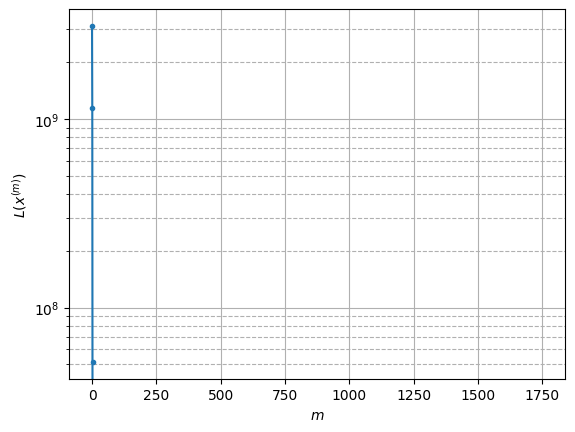

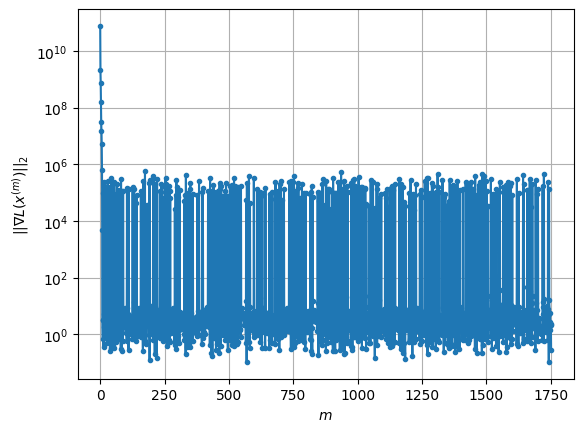

Windows:  90%|████████▉ | 266/296 [49:08<07:31, 15.03s/it]

Before applying the algorithm
Cost function: -23635205.6103495
Gradient norm: 159256.96351962796
Global relative error: 0.6955937738513213
Position relative errors: 0.025244303344312147 m, 0.6411662305715091 m, 0.24153655234095248 m, 0.11738168691844965 m

Iteration 1
Cost function: -23635206.24362579 (-0.00%)
Gradient norm: 16.056714812339933 (-99.99%)
Global relative error: 0.8835044139776421 (27.01%)
Position relative errors: 0.03122762926612674 m, 0.7798446389165673 m, 0.39667577114808505 m, 0.1187203042773517 m

Iteration 2
Cost function: -23635206.243625473 (0.00%)
Gradient norm: 4.743892842587202 (-70.46%)
Global relative error: 0.8835096020333142 (0.00%)
Position relative errors: 0.031227628488260786 m, 0.7798650002182277 m, 0.396643181228474 m, 0.11873405024794538 m

Iteration 3
Cost function: -23635206.243626043 (-0.00%)
Gradient norm: 1.0107119122874841 (-78.69%)
Global relative error: 0.8835096114961982 (0.00%)
Position relative errors: 0.03122762581054732 m, 0.779865027889

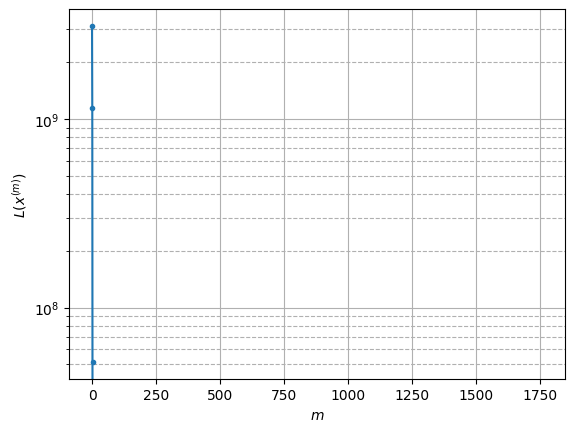

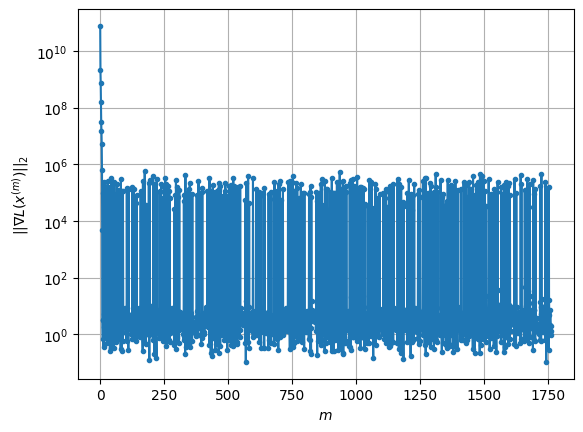

Windows:  90%|█████████ | 267/296 [49:26<07:40, 15.89s/it]

Before applying the algorithm
Cost function: -23635206.70653314
Gradient norm: 325900.9558900259
Global relative error: 0.9194142508518939
Position relative errors: 0.030934373422242728 m, 0.8268166908037039 m, 0.38237843862202453 m, 0.12052205295973467 m

Iteration 1
Cost function: -23635207.06305923 (-0.00%)
Gradient norm: 6.9242873499576625 (-100.00%)
Global relative error: 0.7889220473920459 (-14.19%)
Position relative errors: 0.03615258047000767 m, 0.74422188175598 m, 0.20807545894592164 m, 0.1546887043367589 m

Iteration 2
Cost function: -23635207.063059535 (-0.00%)
Gradient norm: 3.1622357619287245 (-54.33%)
Global relative error: 0.788928595019165 (0.00%)
Position relative errors: 0.036152573571551126 m, 0.7442336786671345 m, 0.20805492090232552 m, 0.15469296779262026 m

STOP on Iteration 3
Cost function = -23635207.063059404 (0.00%)
Gradient norm = 0.3418064601500252 (-89.19%)
Global relative error = 0.7889285999021518 (0.00%)
Final position relative errors: 0.0361525786232391

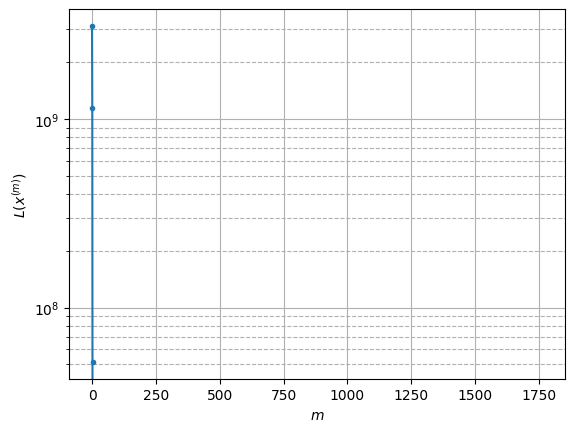

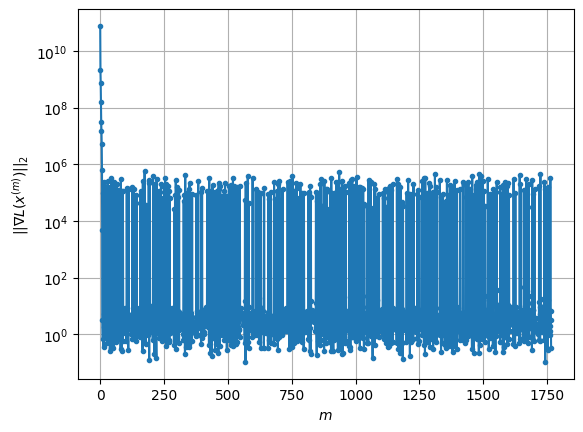

Windows:  91%|█████████ | 268/296 [49:33<06:12, 13.30s/it]

Before applying the algorithm
Cost function: -23635208.189108986
Gradient norm: 140556.1776066204
Global relative error: 0.8274325132393837
Position relative errors: 0.03553803512809206 m, 0.7848181597510947 m, 0.21043777417521892 m, 0.15217526980328977 m

Iteration 1
Cost function: -23635208.842388198 (-0.00%)
Gradient norm: 11.256238369306915 (-99.99%)
Global relative error: 0.9694519240535053 (17.16%)
Position relative errors: 0.034833037928476196 m, 0.9452017893202135 m, 0.1723538598372985 m, 0.12454257216969668 m

STOP on Iteration 2
Cost function = -23635208.842388276 (-0.00%)
Gradient norm = 0.38319362101261845 (-96.60%)
Global relative error = 0.969548060707137 (0.01%)
Final position relative errors: 0.03483303568469935 m, 0.945294333525627 m, 0.17237619550454128 m, 0.12455764636738824 m



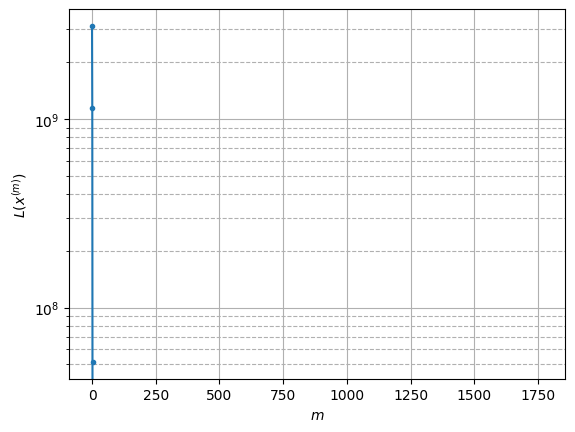

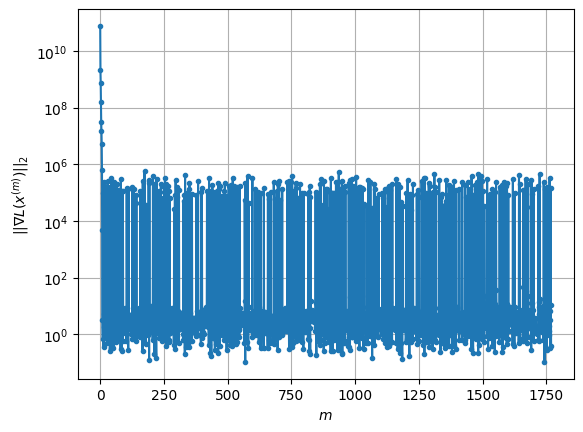

Windows:  91%|█████████ | 269/296 [49:38<04:54, 10.91s/it]

Before applying the algorithm
Cost function: -23635208.7357623
Gradient norm: 320418.6144414286
Global relative error: 1.003511953375417
Position relative errors: 0.033999732937689445 m, 0.9774858903953969 m, 0.1811391276385822 m, 0.1326262758838236 m

Iteration 1
Cost function: -23635209.21595471 (-0.00%)
Gradient norm: 12.498517349386303 (-100.00%)
Global relative error: 1.113554725778532 (10.97%)
Position relative errors: 0.028381797032240894 m, 1.0589937735342687 m, 0.2942406583560283 m, 0.17649737612136265 m

Iteration 2
Cost function: -23635209.215953805 (0.00%)
Gradient norm: 4.341295603055763 (-65.27%)
Global relative error: 1.1136515256332147 (0.01%)
Position relative errors: 0.028381799345506477 m, 1.0590758620706144 m, 0.29427812668595016 m, 0.1765530986344268 m

Iteration 3
Cost function: -23635209.215954762 (-0.00%)
Gradient norm: 4.324584631070929 (-0.38%)
Global relative error: 1.1136515605404316 (0.00%)
Position relative errors: 0.028381794136768324 m, 1.059075889094120

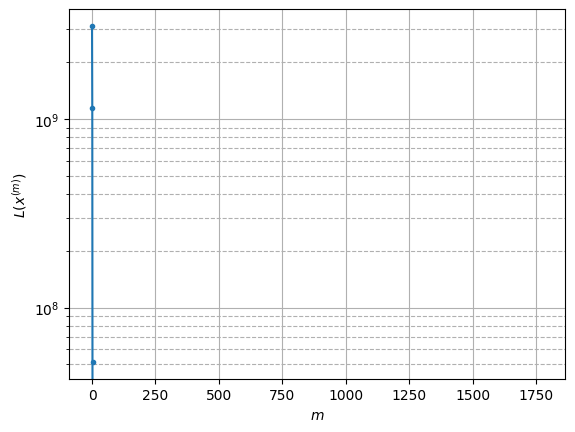

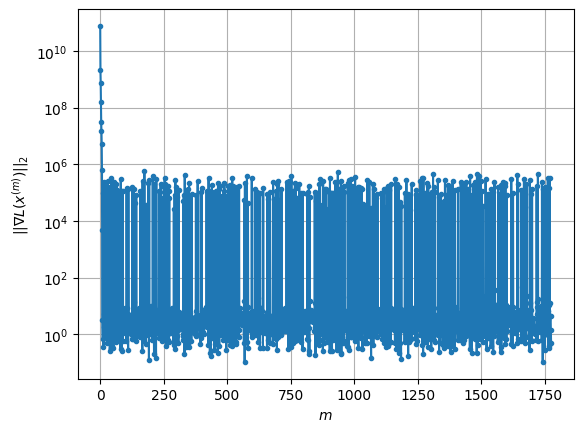

Windows:  91%|█████████ | 270/296 [49:51<04:55, 11.37s/it]

Before applying the algorithm
Cost function: -23635211.01581754
Gradient norm: 253902.5149558614
Global relative error: 1.1768952359837925
Position relative errors: 0.0275845720355828 m, 1.112460141190477 m, 0.3138149119497613 m, 0.21970983370815678 m

Iteration 1
Cost function: -23635211.268930264 (-0.00%)
Gradient norm: 3.812813379334621 (-100.00%)
Global relative error: 1.529574622073685 (29.97%)
Position relative errors: 0.02552539474785324 m, 1.3017829719293974 m, 0.6334949018933704 m, 0.49294109566248934 m

Iteration 2
Cost function: -23635211.268930472 (-0.00%)
Gradient norm: 4.999775049043672 (31.13%)
Global relative error: 1.5296621489176094 (0.01%)
Position relative errors: 0.025525389264524787 m, 1.3018398225038343 m, 0.633556265430257 m, 0.4929836928287819 m

Iteration 3
Cost function: -23635211.268930655 (-0.00%)
Gradient norm: 2.457857471393826 (-50.84%)
Global relative error: 1.5296621563680333 (0.00%)
Position relative errors: 0.025525388520100157 m, 1.3018398340185857 

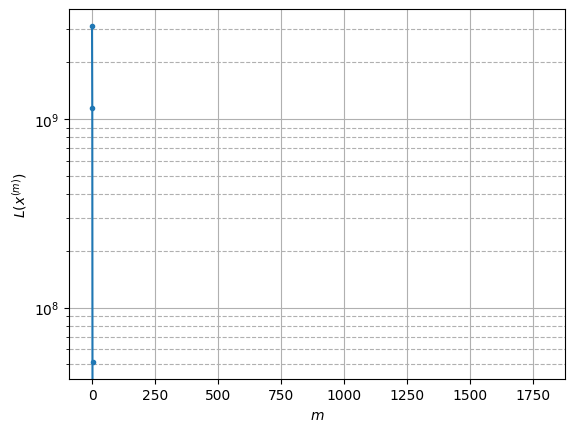

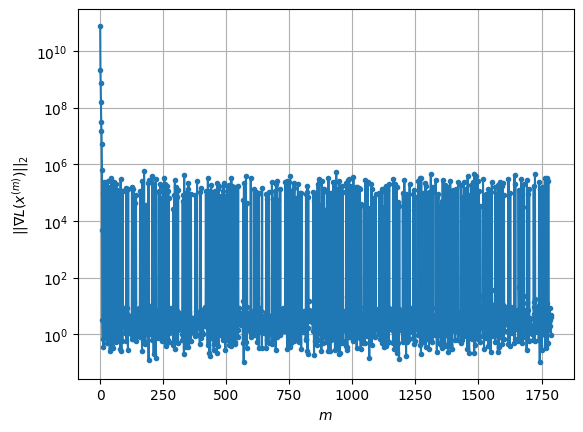

Windows:  92%|█████████▏| 271/296 [50:11<05:53, 14.15s/it]

Before applying the algorithm
Cost function: -23635206.851270106
Gradient norm: 205062.83586064936
Global relative error: 1.5849886675406242
Position relative errors: 0.02459678511457215 m, 1.343901027340866 m, 0.6431385369025943 m, 0.5402645475321006 m

Iteration 1
Cost function: -23635207.32812454 (-0.00%)
Gradient norm: 10.591305693012984 (-99.99%)
Global relative error: 1.4284104185840352 (-9.88%)
Position relative errors: 0.023643273070875572 m, 1.3781885255438269 m, 0.32458858134899155 m, 0.1871764376392526 m

Iteration 2
Cost function: -23635207.328124683 (-0.00%)
Gradient norm: 2.9872835258073747 (-71.79%)
Global relative error: 1.4284767018642959 (0.00%)
Position relative errors: 0.02364327104247686 m, 1.3782587450180335 m, 0.32460165316291906 m, 0.18714256714920954 m

Iteration 3
Cost function: -23635207.328124948 (-0.00%)
Gradient norm: 1.8641392360325744 (-37.60%)
Global relative error: 1.4284767180509397 (0.00%)
Position relative errors: 0.023643269871331318 m, 1.378258758

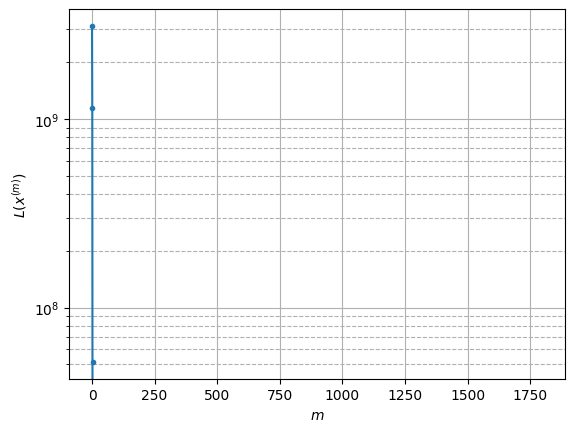

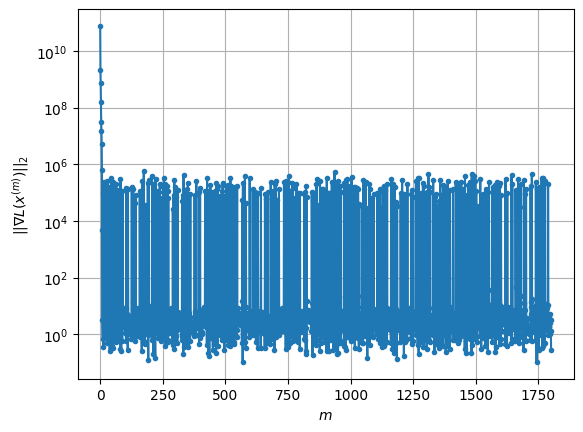

Windows:  92%|█████████▏| 272/296 [50:34<06:40, 16.70s/it]

Before applying the algorithm
Cost function: -23635202.933870442
Gradient norm: 168994.84854844652
Global relative error: 1.462762360818289
Position relative errors: 0.02285669371865618 m, 1.4029404238995966 m, 0.3471507376143511 m, 0.22448832536789132 m

Iteration 1
Cost function: -23635203.04631616 (-0.00%)
Gradient norm: 3.110048742644668 (-100.00%)
Global relative error: 1.3129004713806747 (-10.25%)
Position relative errors: 0.025539017097557154 m, 1.2514131740288947 m, 0.3456460190700219 m, 0.19377373845044246 m

Iteration 2
Cost function: -23635203.046316296 (-0.00%)
Gradient norm: 1.6130193054873756 (-48.14%)
Global relative error: 1.3129138862068779 (0.00%)
Position relative errors: 0.025539016770370244 m, 1.2514261444997083 m, 0.3456485950318496 m, 0.19377627003715708 m

Iteration 3
Cost function: -23635203.04631657 (-0.00%)
Gradient norm: 2.3867340237762047 (47.97%)
Global relative error: 1.3129138548279493 (-0.00%)
Position relative errors: 0.025539019473334264 m, 1.25142611

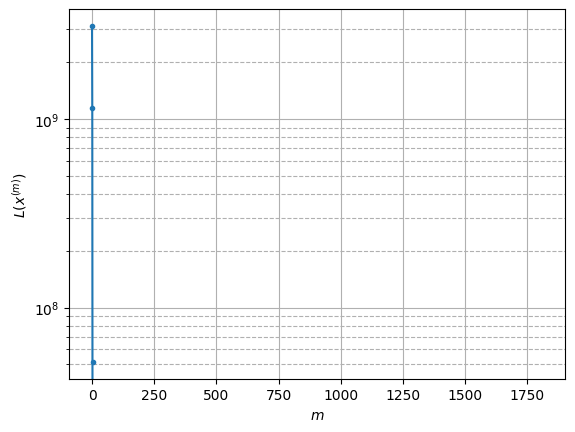

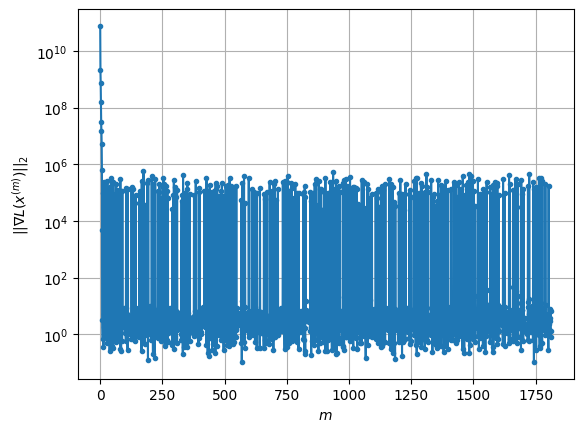

Windows:  92%|█████████▏| 273/296 [50:53<06:42, 17.49s/it]

Before applying the algorithm
Cost function: -23635206.552204713
Gradient norm: 301979.7594375602
Global relative error: 1.3475117716094318
Position relative errors: 0.024586756991677165 m, 1.2770657422054572 m, 0.3596090091431422 m, 0.23445039080044974 m

Iteration 1
Cost function: -23635207.019290242 (-0.00%)
Gradient norm: 7.759045132749841 (-100.00%)
Global relative error: 1.5648143154389582 (16.13%)
Position relative errors: 0.019559645064335135 m, 1.4511135594875089 m, 0.3036963577920836 m, 0.5002986369074741 m

Iteration 2
Cost function: -23635207.019290604 (-0.00%)
Gradient norm: 2.9278657008152904 (-62.27%)
Global relative error: 1.5647930831623387 (-0.00%)
Position relative errors: 0.019559639225563683 m, 1.4510950023543177 m, 0.3037143125709605 m, 0.5002751527627465 m

Iteration 3
Cost function: -23635207.0192901 (0.00%)
Gradient norm: 2.9174038204423516 (-0.36%)
Global relative error: 1.5647930875364517 (0.00%)
Position relative errors: 0.019559643391131618 m, 1.45109500845

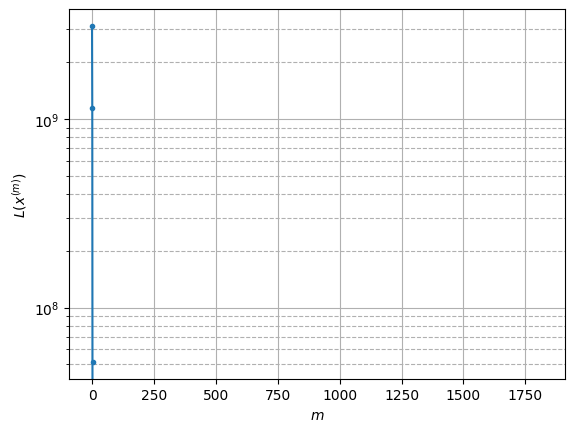

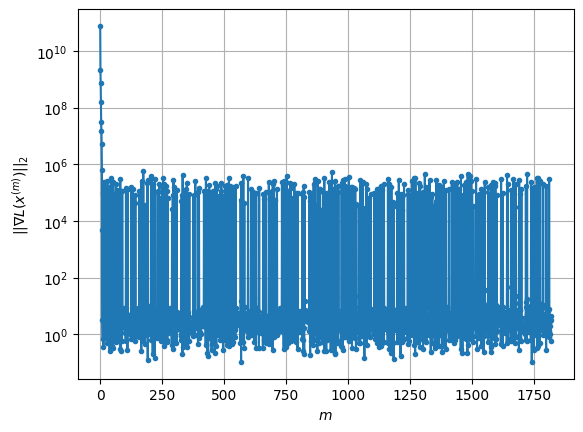

Windows:  93%|█████████▎| 274/296 [51:09<06:09, 16.82s/it]

Before applying the algorithm
Cost function: -23635214.14548673
Gradient norm: 128993.40963993872
Global relative error: 1.5842303439449696
Position relative errors: 0.01871517420893489 m, 1.461648526789963 m, 0.298745542912065 m, 0.5327004680097648 m

Iteration 1
Cost function: -23635214.67982522 (-0.00%)
Gradient norm: 12.451382560602063 (-99.99%)
Global relative error: 1.3477184309170216 (-14.93%)
Position relative errors: 0.018933380120195797 m, 1.218587229619261 m, 0.514294769205787 m, 0.25793841513154375 m

Iteration 2
Cost function: -23635214.679824747 (0.00%)
Gradient norm: 4.8788837243906755 (-60.82%)
Global relative error: 1.3477725817552093 (0.00%)
Position relative errors: 0.018933379035231 m, 1.2187480289644634 m, 0.5139868790648364 m, 0.2580753088132934 m

Iteration 3
Cost function: -23635214.679825366 (-0.00%)
Gradient norm: 1.5278862511241162 (-68.68%)
Global relative error: 1.3477725779822745 (-0.00%)
Position relative errors: 0.01893337734852901 m, 1.218748026493325 m

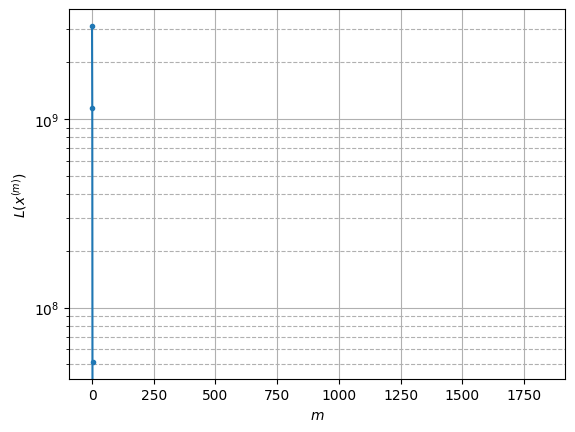

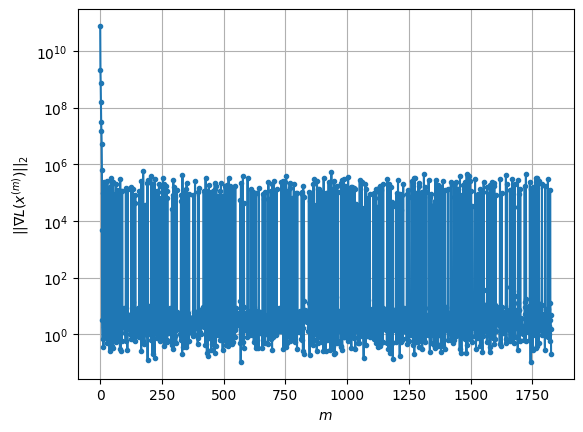

Windows:  93%|█████████▎| 275/296 [51:17<05:01, 14.34s/it]

Before applying the algorithm
Cost function: -23635213.870540332
Gradient norm: 211064.95862842258
Global relative error: 1.3576410308478541
Position relative errors: 0.018107868333335757 m, 1.2230134823395846 m, 0.5140690513038433 m, 0.2878055087293429 m

Iteration 1
Cost function: -23635214.389894344 (-0.00%)
Gradient norm: 15.35350104413143 (-99.99%)
Global relative error: 1.3332078953749995 (-1.80%)
Position relative errors: 0.019620898236936295 m, 1.3149143269627872 m, 0.16365905235868436 m, 0.1458548078427966 m

Iteration 2
Cost function: -23635214.38989383 (0.00%)
Gradient norm: 7.828087407656985 (-49.01%)
Global relative error: 1.3332707738831118 (0.00%)
Position relative errors: 0.019620898515523663 m, 1.3149722221320552 m, 0.16370163029413687 m, 0.14585984036636102 m

Iteration 3
Cost function: -23635214.389893606 (0.00%)
Gradient norm: 2.747742319484744 (-64.90%)
Global relative error: 1.333270795296347 (0.00%)
Position relative errors: 0.01962089762284621 m, 1.3149722423974

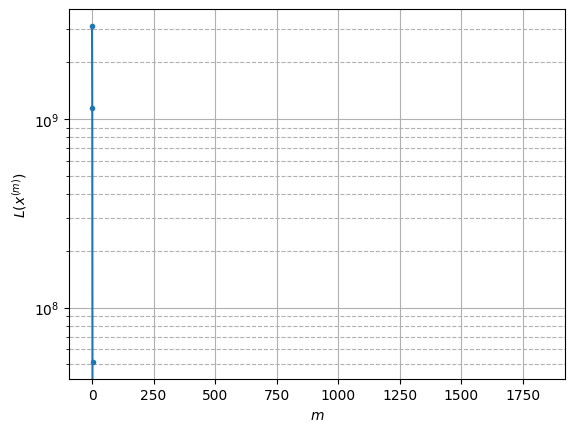

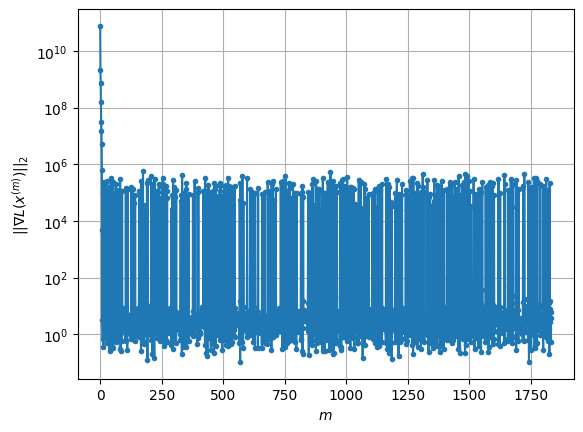

Windows:  93%|█████████▎| 276/296 [51:29<04:31, 13.58s/it]

Before applying the algorithm
Cost function: -23635217.113084592
Gradient norm: 438303.79132307146
Global relative error: 1.3473664684885913
Position relative errors: 0.01869635702204025 m, 1.3262139962164867 m, 0.16311044014732615 m, 0.17203951837949918 m

Iteration 1
Cost function: -23635217.73988795 (-0.00%)
Gradient norm: 14.565943198235567 (-100.00%)
Global relative error: 2.0018104723904093 (48.57%)
Position relative errors: 0.018311971036326282 m, 1.881904974888946 m, 0.21094218205260548 m, 0.6487265401277565 m

Iteration 2
Cost function: -23635217.739888288 (-0.00%)
Gradient norm: 5.983113403286946 (-58.92%)
Global relative error: 2.0017632429268506 (-0.00%)
Position relative errors: 0.018311972462472046 m, 1.8818715266779058 m, 0.21093833618676985 m, 0.6486790820263898 m

Iteration 3
Cost function: -23635217.739888005 (0.00%)
Gradient norm: 4.8900638080093835 (-18.27%)
Global relative error: 2.0017632666787595 (0.00%)
Position relative errors: 0.018311970949819456 m, 1.8818715

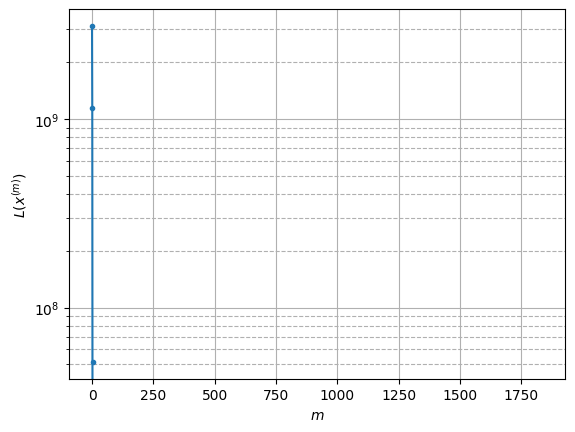

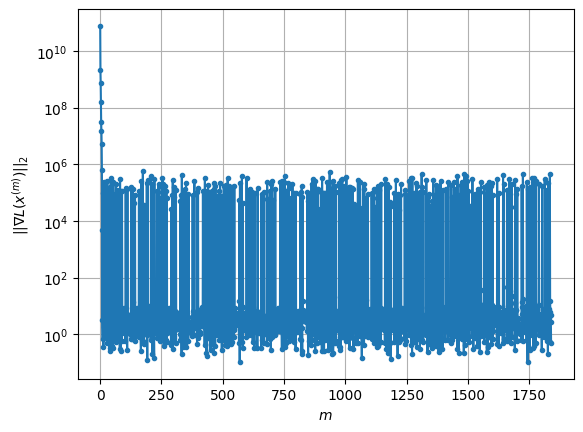

Windows:  94%|█████████▎| 277/296 [51:39<03:58, 12.54s/it]

Before applying the algorithm
Cost function: -23635222.81522807
Gradient norm: 229468.47080964863
Global relative error: 2.021295006631591
Position relative errors: 0.01725179860244995 m, 1.8854284549178626 m, 0.22591260213543998 m, 0.6924292256604625 m

Iteration 1
Cost function: -23635223.319674708 (-0.00%)
Gradient norm: 8.5433622380875 (-100.00%)
Global relative error: 1.5124974333817895 (-25.17%)
Position relative errors: 0.027771915427754576 m, 1.4722131120974273 m, 0.21445338262215127 m, 0.27106169010960895 m

Iteration 2
Cost function: -23635223.319674637 (0.00%)
Gradient norm: 2.5711381167605594 (-69.90%)
Global relative error: 1.5125847504081578 (0.01%)
Position relative errors: 0.027771914624978744 m, 1.472301729981284 m, 0.21437072529201112 m, 0.2711329748397943 m

Iteration 3
Cost function: -23635223.319674633 (0.00%)
Gradient norm: 3.4483652817733694 (34.12%)
Global relative error: 1.512584755624018 (0.00%)
Position relative errors: 0.027771914841393703 m, 1.4723017341541

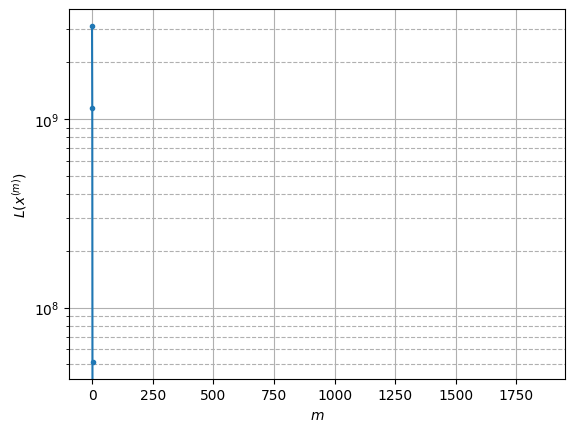

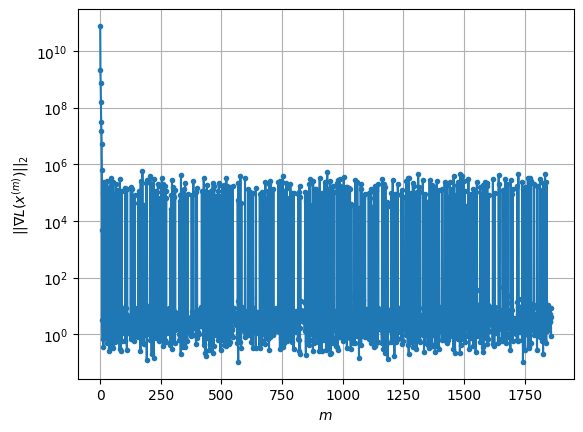

Windows:  94%|█████████▍| 278/296 [52:12<05:37, 18.74s/it]

Before applying the algorithm
Cost function: -23635227.041929018
Gradient norm: 234321.4215333931
Global relative error: 1.5158729279748258
Position relative errors: 0.026333971702342765 m, 1.4692571670527983 m, 0.18891452738222614 m, 0.32057896971352423 m

Iteration 1
Cost function: -23635227.65901436 (-0.00%)
Gradient norm: 11.100797272557795 (-100.00%)
Global relative error: 1.8021983648080209 (18.89%)
Position relative errors: 0.032091148210055875 m, 1.6866364607075528 m, 0.544566519155264 m, 0.32495090020905043 m

Iteration 2
Cost function: -23635227.659014244 (0.00%)
Gradient norm: 2.8837854961945757 (-74.02%)
Global relative error: 1.8021832823311323 (-0.00%)
Position relative errors: 0.03209115194479981 m, 1.686649994853095 m, 0.5444839902813684 m, 0.32493529796228177 m

Iteration 3
Cost function: -23635227.659014158 (0.00%)
Gradient norm: 1.1325810002728058 (-60.73%)
Global relative error: 1.8021833160764567 (0.00%)
Position relative errors: 0.03209115244356066 m, 1.6866500312

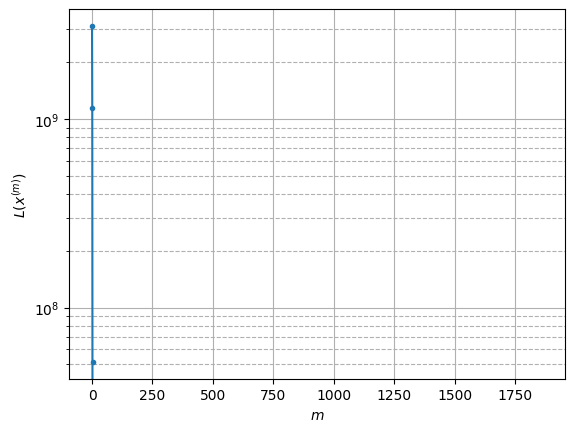

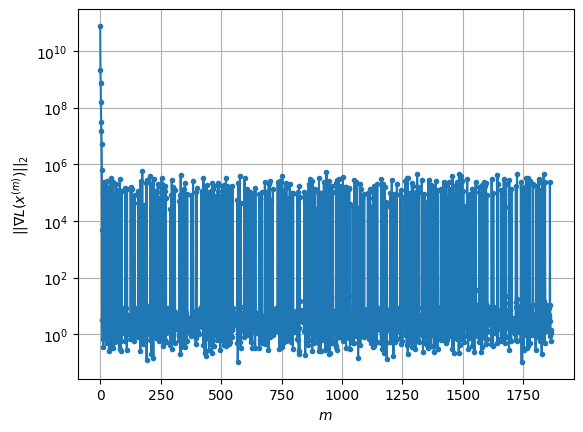

Windows:  94%|█████████▍| 279/296 [52:22<04:33, 16.07s/it]

Before applying the algorithm
Cost function: -23635227.919929188
Gradient norm: 152501.65135418996
Global relative error: 1.7882682708969813
Position relative errors: 0.030821595677369196 m, 1.6707428122505275 m, 0.5205038003219766 m, 0.3669425739431496 m

Iteration 1
Cost function: -23635228.588634845 (-0.00%)
Gradient norm: 14.994481243812157 (-99.99%)
Global relative error: 1.5955212881120602 (-10.78%)
Position relative errors: 0.020692304394266135 m, 1.464795925597239 m, 0.1437932388953162 m, 0.615593781698318 m

Iteration 2
Cost function: -23635228.588635165 (-0.00%)
Gradient norm: 3.87623213582725 (-74.15%)
Global relative error: 1.5955335556031112 (0.00%)
Position relative errors: 0.020692305488832087 m, 1.4648242046196889 m, 0.1437209277970617 m, 0.6155751731947462 m

STOP on Iteration 3
Cost function = -23635228.588635225 (-0.00%)
Gradient norm = 0.6594844815402477 (-82.99%)
Global relative error = 1.5955335337933128 (-0.00%)
Final position relative errors: 0.02069230354445180

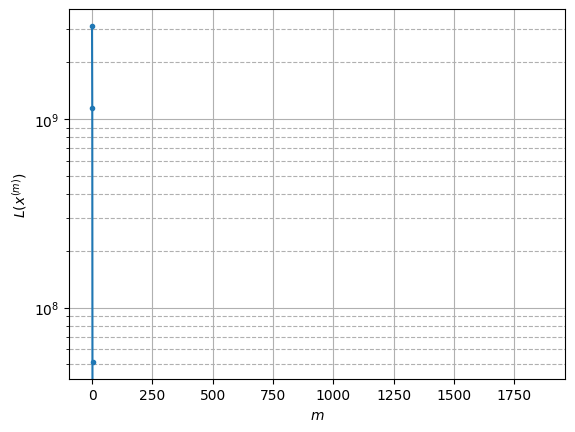

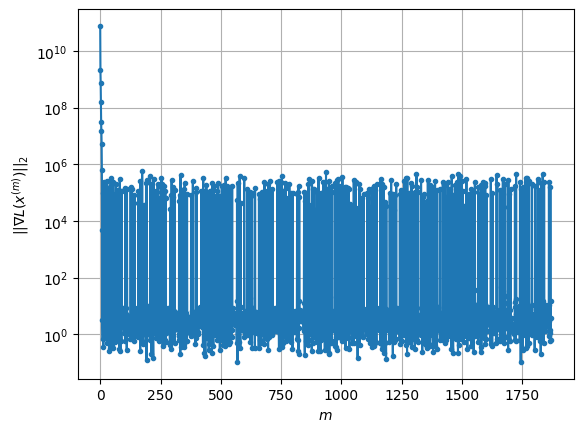

Windows:  95%|█████████▍| 280/296 [52:29<03:32, 13.27s/it]

Before applying the algorithm
Cost function: -23635227.18631417
Gradient norm: 150372.81164219743
Global relative error: 1.5625358703007812
Position relative errors: 0.01989393257057526 m, 1.424309971342963 m, 0.12759816324342801 m, 0.6294295474836116 m

Iteration 1
Cost function: -23635227.911636334 (-0.00%)
Gradient norm: 32.53883105565835 (-99.98%)
Global relative error: 2.49118015771369 (59.43%)
Position relative errors: 0.01750743223621831 m, 1.9266745269963808 m, 0.08938466933509569 m, 1.576580714529128 m

Iteration 2
Cost function: -23635227.911636177 (0.00%)
Gradient norm: 1.9705576300057384 (-93.94%)
Global relative error: 2.4911816240285214 (0.00%)
Position relative errors: 0.017507432584627995 m, 1.9266746870606781 m, 0.08938455114002009 m, 1.576582842544533 m

Iteration 3
Cost function: -23635227.91163631 (-0.00%)
Gradient norm: 1.7079701663069602 (-13.33%)
Global relative error: 2.4911816355388496 (0.00%)
Position relative errors: 0.017507433993667297 m, 1.9266746907889771

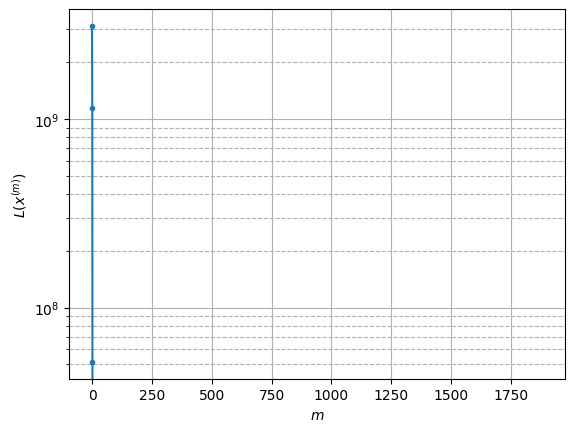

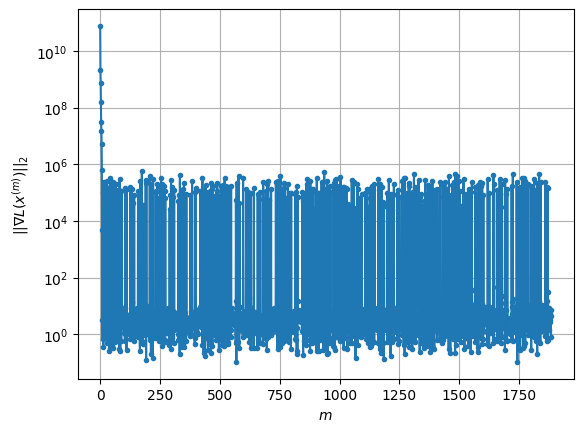

Windows:  95%|█████████▍| 281/296 [52:54<04:10, 16.71s/it]

Before applying the algorithm
Cost function: -23635226.24623133
Gradient norm: 131218.92052741305
Global relative error: 2.440704276901922
Position relative errors: 0.016755789330280282 m, 1.87453764467526 m, 0.09924147986523547 m, 1.5598125174724955 m

Iteration 1
Cost function: -23635226.625763908 (-0.00%)
Gradient norm: 17.056707155227528 (-99.99%)
Global relative error: 3.0295100564174287 (24.12%)
Position relative errors: 0.02151098791577763 m, 2.3174991947811274 m, 0.22545897766504774 m, 1.9379970841364542 m

Iteration 2
Cost function: -23635226.625763264 (0.00%)
Gradient norm: 1.498168240700704 (-91.22%)
Global relative error: 3.029515212726735 (0.00%)
Position relative errors: 0.02151098500674921 m, 2.317512782426638 m, 0.2254351615788676 m, 1.9379916666320385 m

STOP on Iteration 3
Cost function = -23635226.625763766 (-0.00%)
Gradient norm = 0.5001557561757133 (-66.62%)
Global relative error = 3.0295151723635616 (-0.00%)
Final position relative errors: 0.021510971767366216 m, 

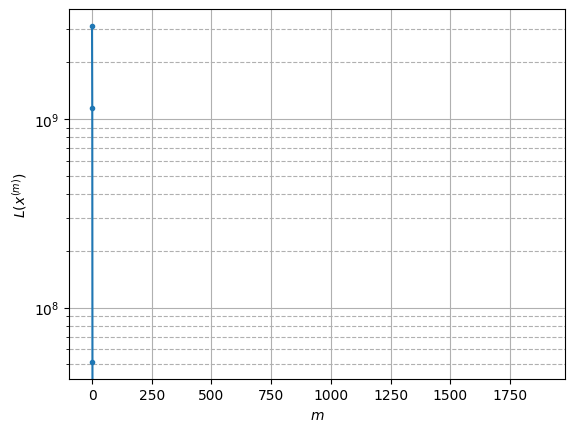

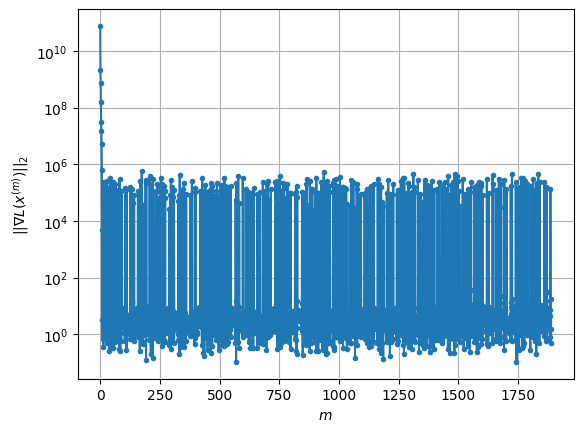

Windows:  95%|█████████▌| 282/296 [53:01<03:12, 13.77s/it]

Before applying the algorithm
Cost function: -23635220.97060234
Gradient norm: 192727.16649276408
Global relative error: 2.965517783609395
Position relative errors: 0.020825183586207413 m, 2.2527145576589613 m, 0.19471245955751107 m, 1.9186516784239465 m

Iteration 1
Cost function: -23635221.416212417 (-0.00%)
Gradient norm: 8.612324217960568 (-100.00%)
Global relative error: 2.7865394697879013 (-6.04%)
Position relative errors: 0.024818501361342712 m, 2.2274660143626575 m, 0.09969316953532371 m, 1.6711196092181888 m

STOP on Iteration 2
Cost function = -23635221.416212477 (-0.00%)
Gradient norm = 0.9190987680473911 (-89.33%)
Global relative error = 2.786549534999425 (0.00%)
Final position relative errors: 0.02481850371895639 m, 2.2274647336292452 m, 0.09969440153530164 m, 1.671138026136438 m



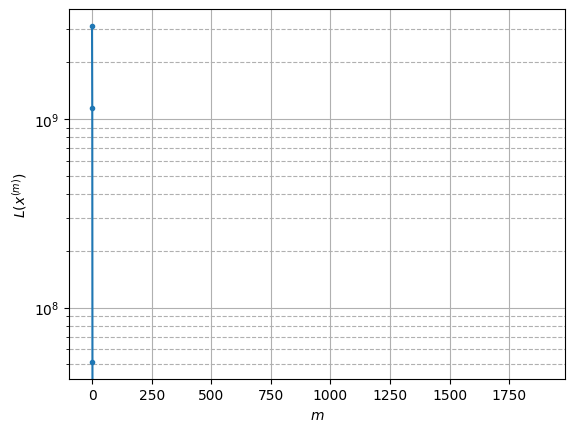

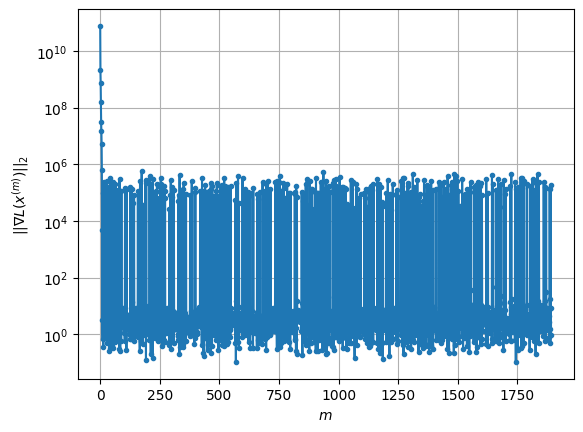

Windows:  96%|█████████▌| 283/296 [53:06<02:26, 11.28s/it]

Before applying the algorithm
Cost function: -23635222.96546352
Gradient norm: 62736.81607728287
Global relative error: 2.7094511612785093
Position relative errors: 0.023888808430976766 m, 2.1462321567109433 m, 0.09865238266987522 m, 1.6506082872077168 m

Iteration 1
Cost function: -23635223.415970884 (-0.00%)
Gradient norm: 8.079456852981973 (-99.99%)
Global relative error: 2.312897592501264 (-14.64%)
Position relative errors: 0.02304423373745329 m, 1.7151895377194675 m, 0.34373726176963026 m, 1.512921335769596 m

STOP on Iteration 2
Cost function = -23635223.415970907 (-0.00%)
Gradient norm = 0.30297855026595444 (-96.25%)
Global relative error = 2.312903393623254 (0.00%)
Final position relative errors: 0.02304423095324567 m, 1.7151995073018103 m, 0.3437188958932652 m, 1.5129230743833144 m



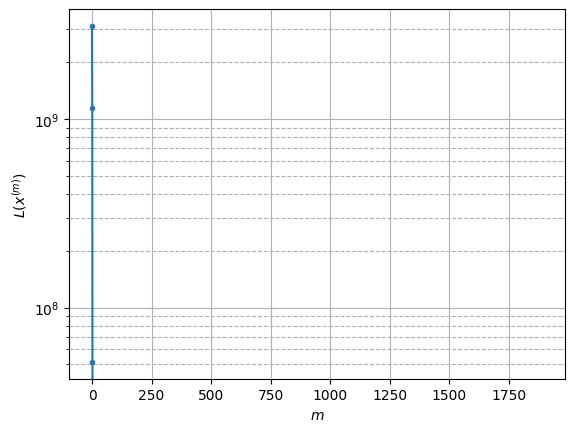

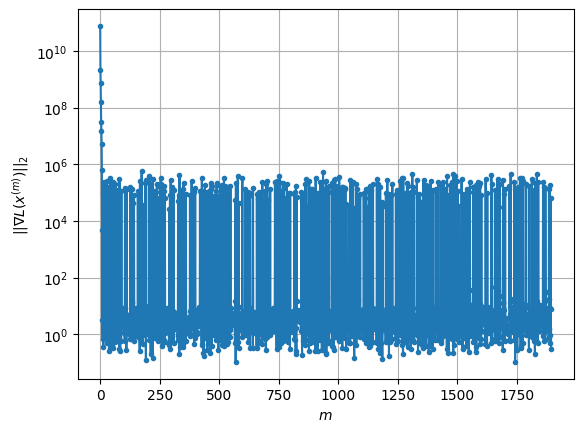

Windows:  96%|█████████▌| 284/296 [53:12<01:54,  9.55s/it]

Before applying the algorithm
Cost function: -23635226.733958676
Gradient norm: 89099.48378988716
Global relative error: 2.2201930581558478
Position relative errors: 0.022163817921522 m, 1.62048248416147 m, 0.3123121694428538 m, 1.4850118807116588 m

Iteration 1
Cost function: -23635227.314236242 (-0.00%)
Gradient norm: 14.885043164397606 (-99.98%)
Global relative error: 1.397383353872074 (-37.06%)
Position relative errors: 0.00787690826081308 m, 1.0753016880797492 m, 0.5341194267285705 m, 0.7148830166074887 m

Iteration 2
Cost function: -23635227.31423574 (0.00%)
Gradient norm: 1.2568196096988296 (-91.56%)
Global relative error: 1.3973396519423351 (-0.00%)
Position relative errors: 0.00787690943589172 m, 1.0752493142924537 m, 0.5341652182559519 m, 0.714842154777028 m

Iteration 3
Cost function: -23635227.314235985 (-0.00%)
Gradient norm: 3.663115470361974 (191.46%)
Global relative error: 1.39733962378897 (-0.00%)
Position relative errors: 0.007876900103245101 m, 1.0752492834092324 m, 

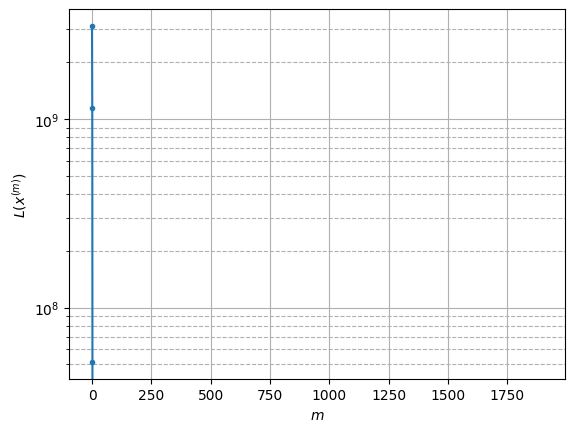

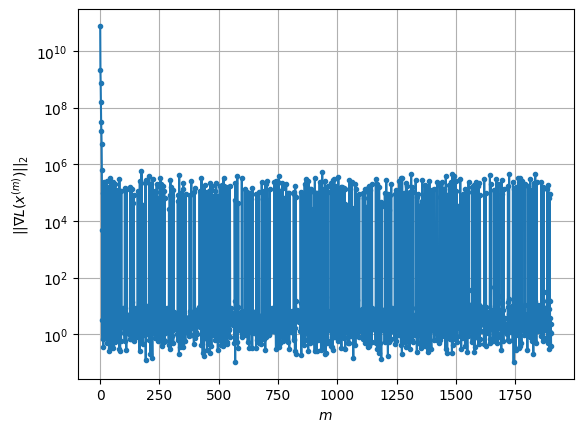

Windows:  96%|█████████▋| 285/296 [53:24<01:52, 10.26s/it]

Before applying the algorithm
Cost function: -23635232.540869635
Gradient norm: 31717.155098173196
Global relative error: 1.2949545440421317
Position relative errors: 0.008167471364778064 m, 0.9728043920831184 m, 0.5172549493089613 m, 0.6803939895900969 m

Iteration 1
Cost function: -23635232.957261942 (-0.00%)
Gradient norm: 7.003727381328311 (-99.98%)
Global relative error: 1.25820458745139 (-2.84%)
Position relative errors: 0.00301940256616329 m, 1.0815497436336603 m, 0.34309545071757247 m, 0.5436926488377477 m

STOP on Iteration 2
Cost function = -23635232.95726158 (0.00%)
Gradient norm = 0.901912741439305 (-87.12%)
Global relative error = 1.258156267584454 (-0.00%)
Final position relative errors: 0.0030194051394867127 m, 1.0815222842942667 m, 0.3430951575795812 m, 0.5436356350554291 m



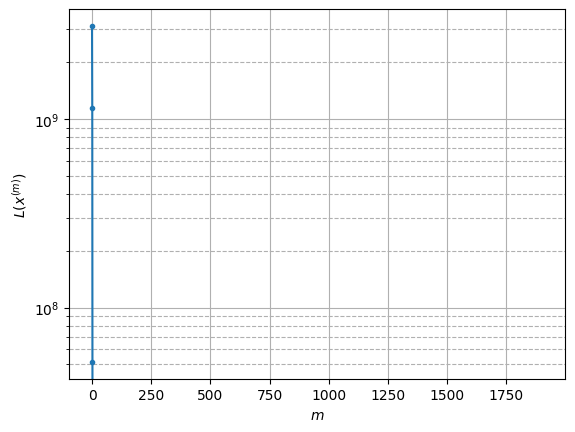

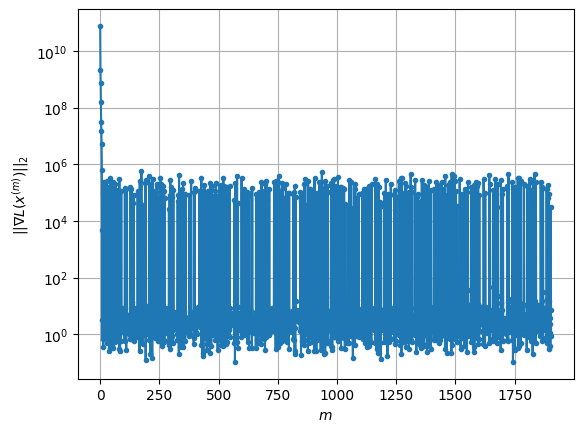

Windows:  97%|█████████▋| 286/296 [53:29<01:27,  8.76s/it]

Before applying the algorithm
Cost function: -23635223.746565
Gradient norm: 61206.84556969028
Global relative error: 1.143428131764382
Position relative errors: 0.00429021063035124 m, 0.9813147573795555 m, 0.31290379556402015 m, 0.49650586848336165 m

Iteration 1
Cost function: -23635223.91812838 (-0.00%)
Gradient norm: 1.802151349558444 (-100.00%)
Global relative error: 1.1334700406063878 (-0.87%)
Position relative errors: 0.002031727202576529 m, 0.9593003074321961 m, 0.46234972322100454 m, 0.38822794982526976 m

STOP on Iteration 2
Cost function = -23635223.918128334 (0.00%)
Gradient norm = 0.7739081538001124 (-57.06%)
Global relative error = 1.1334627308597418 (-0.00%)
Final position relative errors: 0.00203173837083995 m, 0.9592944656945079 m, 0.46235670609922175 m, 0.3882127264897694 m



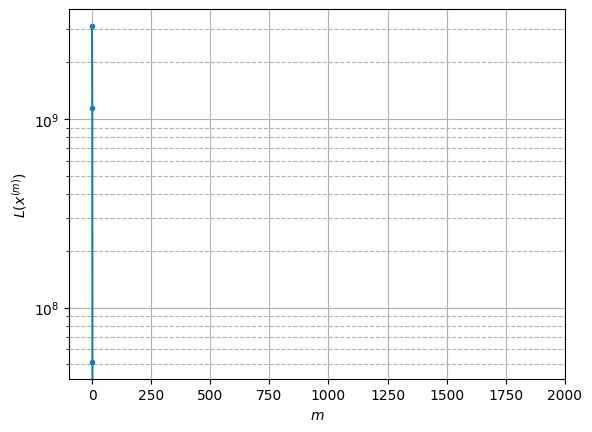

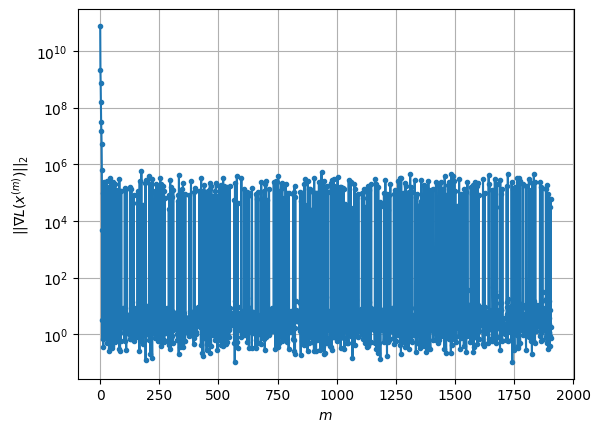

Windows:  97%|█████████▋| 287/296 [53:34<01:09,  7.74s/it]

Before applying the algorithm
Cost function: -23635216.84962509
Gradient norm: 307661.25635879254
Global relative error: 1.0064617588321931
Position relative errors: 0.002724585377220825 m, 0.8477848886592332 m, 0.4368002844489537 m, 0.321588083912452 m

Iteration 1
Cost function: -23635217.332149014 (-0.00%)
Gradient norm: 13.250180996570522 (-100.00%)
Global relative error: 0.9914360780351588 (-1.49%)
Position relative errors: 0.0031627414007279414 m, 0.7007833204885799 m, 0.6376128867322366 m, 0.2920327551993653 m

Iteration 2
Cost function: -23635217.332148995 (0.00%)
Gradient norm: 1.422945466066234 (-89.26%)
Global relative error: 0.9913955592675096 (-0.00%)
Position relative errors: 0.0031627411970388797 m, 0.7007927317021345 m, 0.6375881027992957 m, 0.29192670679587074 m

Iteration 3
Cost function: -23635217.3321491 (-0.00%)
Gradient norm: 1.457736578207603 (2.45%)
Global relative error: 0.991395570285911 (0.00%)
Position relative errors: 0.003162741257565435 m, 0.7007927339437

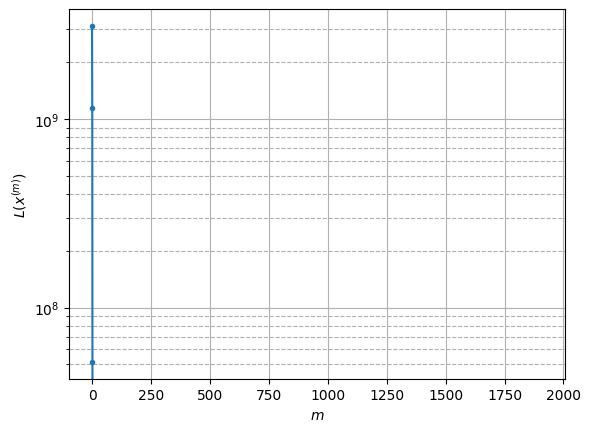

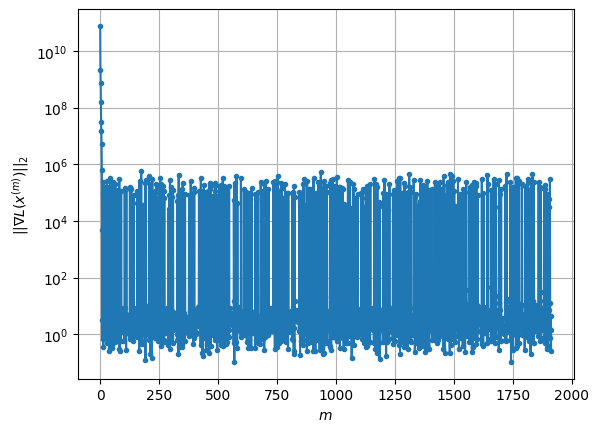

Windows:  97%|█████████▋| 288/296 [53:44<01:07,  8.48s/it]

Before applying the algorithm
Cost function: -23635214.15158589
Gradient norm: 97384.33784343208
Global relative error: 0.9171584572636724
Position relative errors: 0.004356474979901704 m, 0.5912750962311222 m, 0.6096903712993174 m, 0.34616035924180644 m

Iteration 1
Cost function: -23635214.502793137 (-0.00%)
Gradient norm: 6.007031702666462 (-99.99%)
Global relative error: 0.9809141985474973 (6.95%)
Position relative errors: 0.011640010445520616 m, 0.7696932052716218 m, 0.35884580476441086 m, 0.49076859678757867 m

STOP on Iteration 2
Cost function = -23635214.502793144 (-0.00%)
Gradient norm = 0.5690065016940471 (-90.53%)
Global relative error = 0.9808976593212051 (-0.00%)
Final position relative errors: 0.011640012871534008 m, 0.769629845999606 m, 0.35886153019681694 m, 0.4908234026631159 m



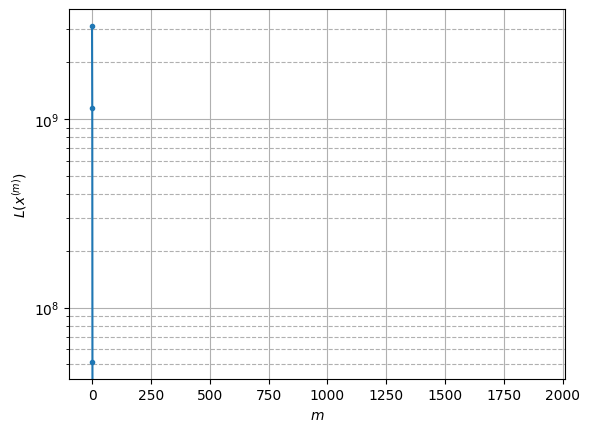

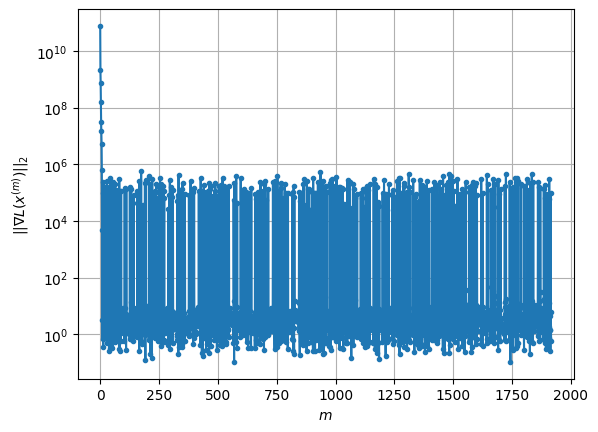

Windows:  98%|█████████▊| 289/296 [53:50<00:52,  7.55s/it]

Before applying the algorithm
Cost function: -23635216.89601337
Gradient norm: 225909.95607953484
Global relative error: 0.923620993136846
Position relative errors: 0.01269684313901586 m, 0.6656267898224517 m, 0.32081495761950934 m, 0.5540105843205425 m

Iteration 1
Cost function: -23635217.467647076 (-0.00%)
Gradient norm: 14.280505690100938 (-99.99%)
Global relative error: 0.9990791447993871 (8.17%)
Position relative errors: 0.008117553255823704 m, 0.17745912564739413 m, 0.4983365548668085 m, 0.8474997583109266 m

STOP on Iteration 2
Cost function = -23635217.467647195 (-0.00%)
Gradient norm = 0.6441583369286101 (-95.49%)
Global relative error = 0.9991593737767773 (0.01%)
Final position relative errors: 0.008117555650363175 m, 0.17751006363625033 m, 0.49838692903023096 m, 0.8475540486344461 m



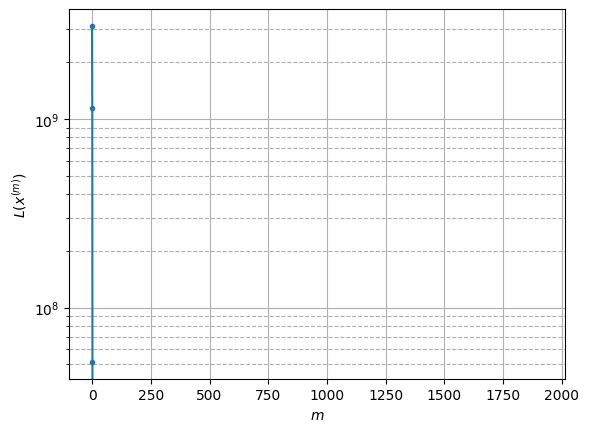

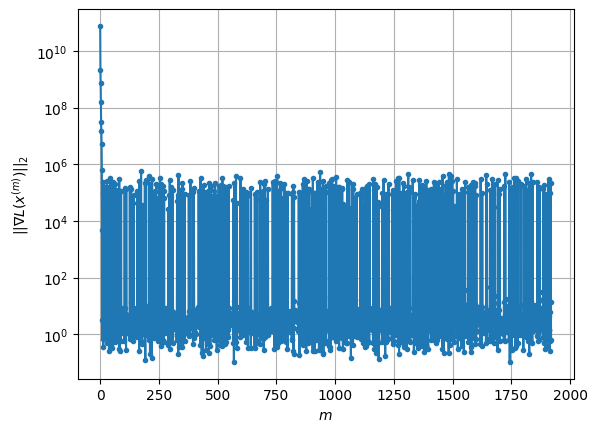

Windows:  98%|█████████▊| 290/296 [53:55<00:41,  6.89s/it]

Before applying the algorithm
Cost function: -23635219.28770961
Gradient norm: 253197.3605092431
Global relative error: 1.0487076672039357
Position relative errors: 0.009547313793598132 m, 0.25573087874196604 m, 0.4501782962341723 m, 0.9119383895497362 m

Iteration 1
Cost function: -23635219.55548227 (-0.00%)
Gradient norm: 3.5257691985111768 (-100.00%)
Global relative error: 0.9070929326760238 (-13.50%)
Position relative errors: 0.006156334218966892 m, 0.1604296263038262 m, 0.3647091664448884 m, 0.814876232688117 m

STOP on Iteration 2
Cost function = -23635219.555482537 (-0.00%)
Gradient norm = 0.23423090726231777 (-93.36%)
Global relative error = 0.9070462006003256 (-0.01%)
Final position relative errors: 0.006156334875661272 m, 0.1604253396126895 m, 0.36467317620827594 m, 0.8148411636451844 m



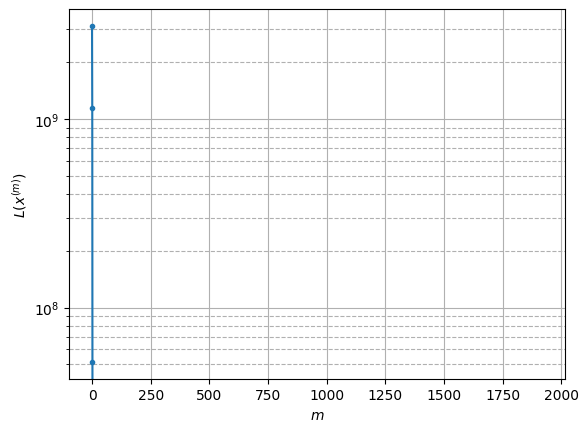

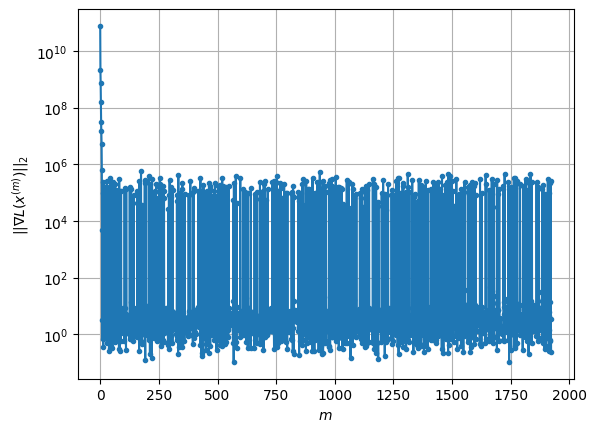

Windows:  98%|█████████▊| 291/296 [54:00<00:31,  6.38s/it]

Before applying the algorithm
Cost function: -23635227.215820536
Gradient norm: 163452.1720394739
Global relative error: 0.9638834102610825
Position relative errors: 0.007565724760199497 m, 0.21233501069126343 m, 0.3335228475134488 m, 0.8790247457956268 m

Iteration 1
Cost function: -23635227.57715735 (-0.00%)
Gradient norm: 6.525461964685911 (-100.00%)
Global relative error: 1.064471654532542 (10.44%)
Position relative errors: 0.00568634099017334 m, 0.24691178373748435 m, 0.5642200372759213 m, 0.8681887793152531 m

Iteration 2
Cost function: -23635227.577157523 (-0.00%)
Gradient norm: 3.6866933086098492 (-43.50%)
Global relative error: 1.0644573653668294 (-0.00%)
Position relative errors: 0.005686344660122473 m, 0.24691193884073154 m, 0.5642396877852601 m, 0.8681584441882257 m

Iteration 3
Cost function: -23635227.57715754 (-0.00%)
Gradient norm: 8.874943834261101 (140.73%)
Global relative error: 1.0644574125860071 (0.00%)
Position relative errors: 0.0056863391467689 m, 0.246911941046

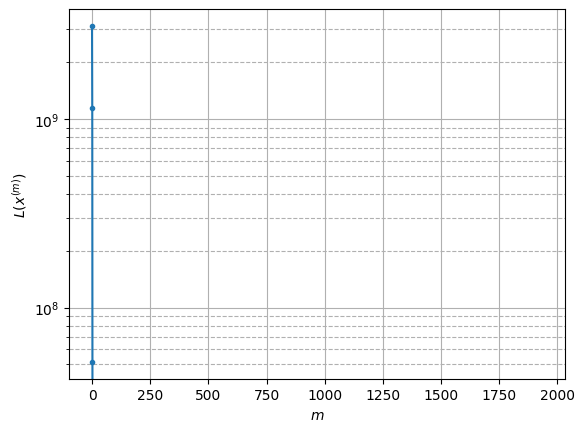

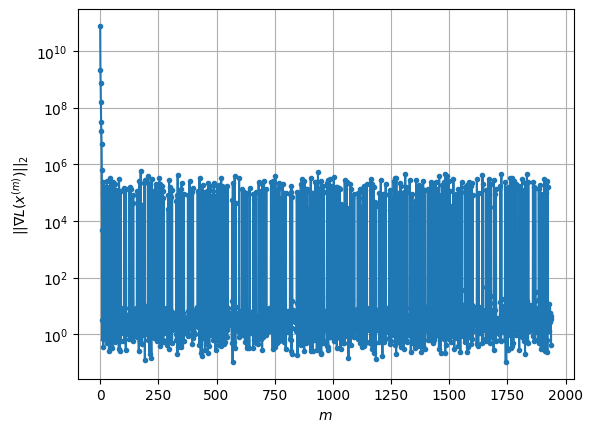

Windows:  99%|█████████▊| 292/296 [54:27<00:49, 12.34s/it]

Before applying the algorithm
Cost function: -23635220.73864551
Gradient norm: 54054.62444001354
Global relative error: 1.0901580906411814
Position relative errors: 0.006944905222395921 m, 0.25235949011965947 m, 0.5149533270234491 m, 0.9271073991103386 m

Iteration 1
Cost function: -23635221.124772627 (-0.00%)
Gradient norm: 6.855595722475449 (-99.99%)
Global relative error: 1.50269315414225 (37.84%)
Position relative errors: 0.01620889517082729 m, 0.4961577086836636 m, 0.6352154335706233 m, 1.2681274747207878 m

STOP on Iteration 2
Cost function = -23635221.124772586 (0.00%)
Gradient norm = 0.4850879017111841 (-92.92%)
Global relative error = 1.5026607211388792 (-0.00%)
Final position relative errors: 0.01620889882572344 m, 0.496128681695967 m, 0.6352169710430225 m, 1.2680996289351083 m



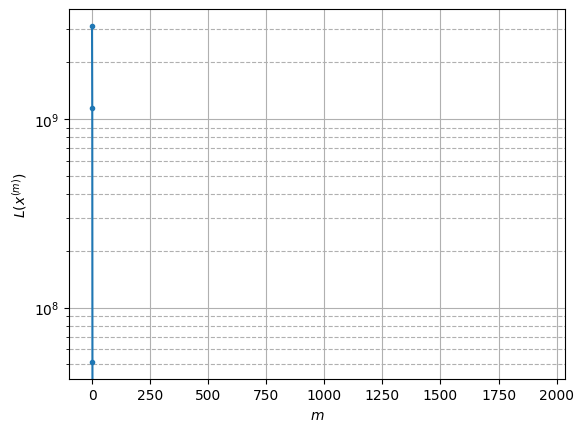

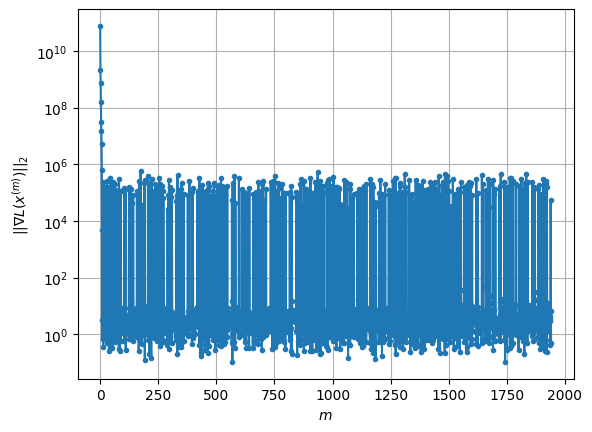

Windows:  99%|█████████▉| 293/296 [54:32<00:30, 10.21s/it]

Before applying the algorithm
Cost function: -23635217.001921564
Gradient norm: 377546.03971565433
Global relative error: 1.5738653024743166
Position relative errors: 0.015567254480611881 m, 0.6069983611664992 m, 0.5921358431691777 m, 1.3257950385205353 m

Iteration 1
Cost function: -23635217.694415934 (-0.00%)
Gradient norm: 21.89503350521693 (-99.99%)
Global relative error: 1.116123897174377 (-29.08%)
Position relative errors: 0.012827374757028597 m, 0.27174213051100504 m, 0.6445596612694267 m, 0.8696336037312569 m

STOP on Iteration 2
Cost function = -23635217.694416102 (-0.00%)
Gradient norm = 0.2979815129220296 (-98.64%)
Global relative error = 1.1160355998271676 (-0.01%)
Final position relative errors: 0.012827388043394396 m, 0.271747684510198 m, 0.6445559917849235 m, 0.869521260168788 m



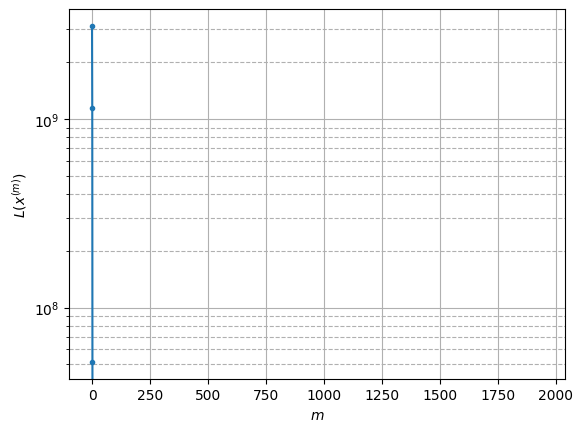

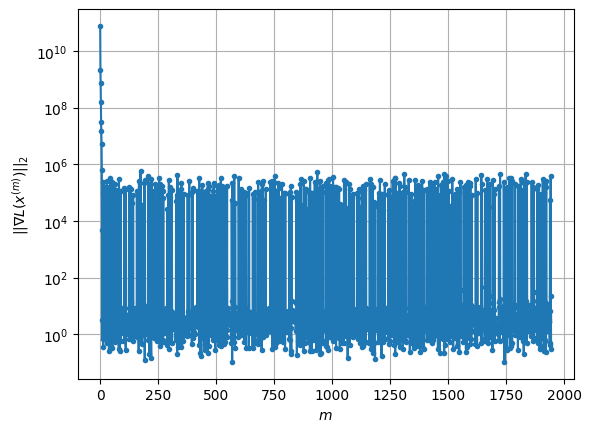

Windows:  99%|█████████▉| 294/296 [54:37<00:17,  8.71s/it]

Before applying the algorithm
Cost function: -23635210.67324672
Gradient norm: 22586.80093605792
Global relative error: 1.1256992677714686
Position relative errors: 0.012699559630545585 m, 0.2669872173948308 m, 0.6063218648392786 m, 0.9100136016495713 m

Iteration 1
Cost function: -23635210.99353618 (-0.00%)
Gradient norm: 7.575170063337047 (-99.97%)
Global relative error: 1.3967034061885282 (24.07%)
Position relative errors: 0.013082061703189523 m, 0.24690564073116464 m, 0.9369273392885737 m, 1.0058874255343775 m

Iteration 2
Cost function: -23635210.993536234 (-0.00%)
Gradient norm: 1.2593645140318523 (-83.38%)
Global relative error: 1.3967040652716343 (0.00%)
Position relative errors: 0.013082059574564991 m, 0.24689836794423015 m, 0.9369290912804478 m, 1.005888493854218 m

Iteration 3
Cost function: -23635210.993536204 (0.00%)
Gradient norm: 2.212884900200368 (75.71%)
Global relative error: 1.3967040269334856 (-0.00%)
Position relative errors: 0.013082060864319395 m, 0.2468983664902

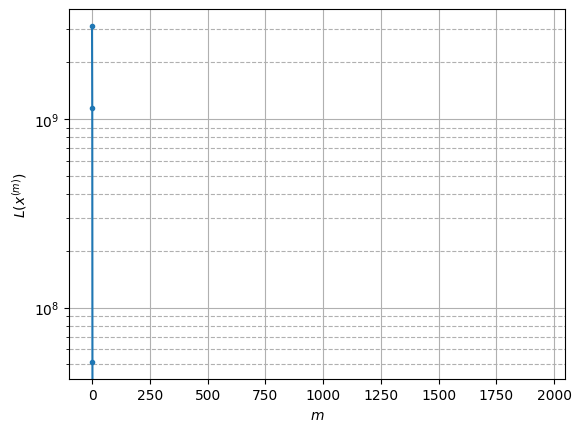

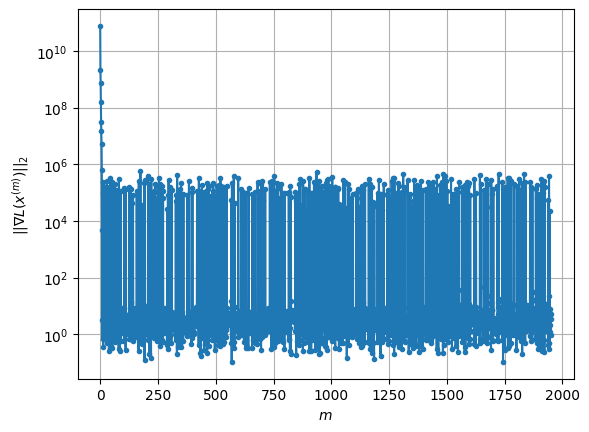

Windows: 100%|█████████▉| 295/296 [54:49<00:09,  9.65s/it]

Before applying the algorithm
Cost function: -23635207.448094953
Gradient norm: 76665.350413578
Global relative error: 1.4193527634733183
Position relative errors: 0.014404151751257732 m, 0.24521755154318992 m, 0.9198452124952882 m, 1.0526649519530304 m

Iteration 1
Cost function: -23635208.15565363 (-0.00%)
Gradient norm: 16.628152851323957 (-99.98%)
Global relative error: 1.44263399428594 (1.64%)
Position relative errors: 0.012365636928753695 m, 0.2418964094816131 m, 1.2039632755528757 m, 0.7569641082809999 m

STOP on Iteration 2
Cost function = -23635208.155653715 (-0.00%)
Gradient norm = 0.2962842625975466 (-98.22%)
Global relative error = 1.4425981462050426 (-0.00%)
Final position relative errors: 0.012365630113523044 m, 0.24195342361429634 m, 1.2039340631201956 m, 0.7569240290501641 m



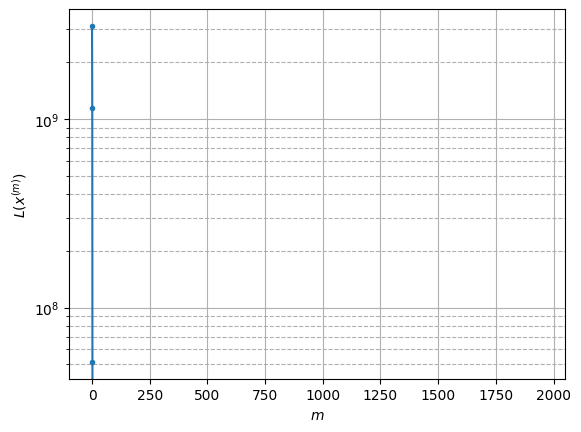

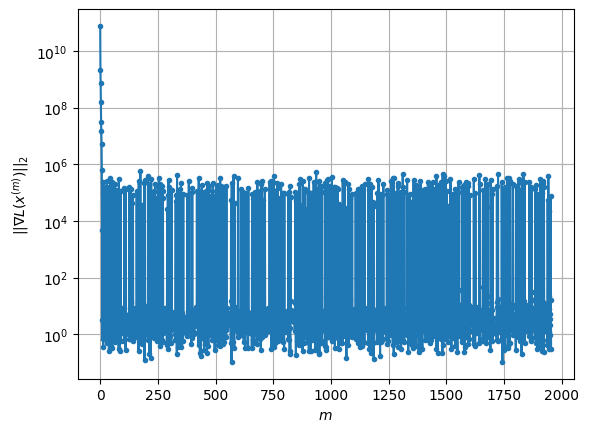

RMSE after convergence:
Chief: nan m
Deputy 1: nan m
Deputy 2: nan m
Deputy 3: nan m


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [39]:
# Main execution loop
def run_estimation():
    # Initialize storage for results
    X_est_mm = np.zeros_like(X_true)
    X_est_mm[:, :, 0] = X_est[:, :, 0]  # Use same initial conditions
    
    # Storage for errors
    errors_chief_mm = []
    errors_deputy1_mm = []
    errors_deputy2_mm = []
    errors_deputy3_mm = []
    
    # Initialize solver
    solver = approxH_Newton()
    
    # Sliding window estimation
    for t in tqdm(range(T - W + 1), desc="Windows", leave=False):
        # Get measurements for current window
        Y_window = Y[:, :, t:t + W]
        
        # Initial guess is the previous estimate propagated forward
        if t == 0:
            x_init = X_est[:, :, t]
        else:
            x_init = X_est_mm[:, :, t]
        
        # Solve the optimization problem
        x_sol = solver.solve(x_init, Y_window, X_true[:, :, t])
        
        # Store the solution
        X_est_mm[:, :, t] = x_sol
        
        # Plot the results
        give_me_the_plots(solver.cost_function_values, solver.grad_norm_values)
        
        # Propagate solution to next timestep if not at the end
        if t < T - W:
            X_est_mm[:, :, t + 1] = SatelliteDynamics().x_new(dt, x_sol)
        
        # Calculate and store errors
        error_chief = np.linalg.norm(X_est_mm[:3, :, t] - X_true[:3, :, t])
        error_deputy1 = np.linalg.norm(X_est_mm[6:9, :, t] - X_true[6:9, :, t])
        error_deputy2 = np.linalg.norm(X_est_mm[12:15, :, t] - X_true[12:15, :, t])
        error_deputy3 = np.linalg.norm(X_est_mm[18:21, :, t] - X_true[18:21, :, t])
        
        errors_chief_mm.append(error_chief)
        errors_deputy1_mm.append(error_deputy1)
        errors_deputy2_mm.append(error_deputy2)
        errors_deputy3_mm.append(error_deputy3)
    
    return X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm

# Run the estimation
X_est_mm, errors_chief_mm, errors_deputy1_mm, errors_deputy2_mm, errors_deputy3_mm = run_estimation()

# Print RMSE for each satellite
print("RMSE after convergence:")
print(f"Chief: {np.sqrt(np.mean(np.array(errors_chief_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 1: {np.sqrt(np.mean(np.array(errors_deputy1_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 2: {np.sqrt(np.mean(np.array(errors_deputy2_mm[T_RMSE:])**2)):.2f} m")
print(f"Deputy 3: {np.sqrt(np.mean(np.array(errors_deputy3_mm[T_RMSE:])**2)):.2f} m")

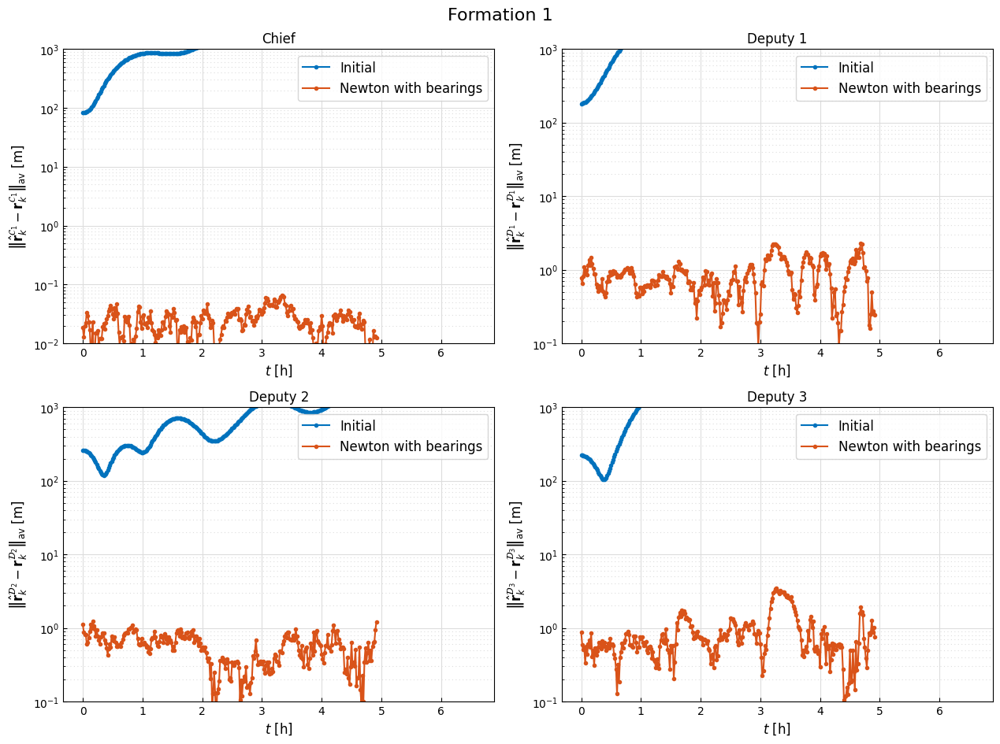

In [41]:
dev_chief = errors_chief_mm
dev_deputy1 = errors_deputy1_mm
dev_deputy2 = errors_deputy2_mm
dev_deputy3 = errors_deputy3_mm

# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, T) / dt
algorithm = "Newton with bearings"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, dev_chief_initial, ".-", label="Initial")
axs[0, 0].plot(time[:K - W + 1], dev_chief, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, dev_deputy1_initial, ".-", label="Initial")
axs[0, 1].plot(time[:K - W + 1], dev_deputy1, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, dev_deputy2_initial, ".-", label="Initial")
axs[1, 0].plot(time[:K - W + 1], dev_deputy2, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, dev_deputy3_initial, ".-", label="Initial")
axs[1, 1].plot(time[:K - W + 1], dev_deputy3, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [42]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est

# Save to pickle file
with open(
    f'newton_bearings_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)